## Builds off of the disproportionation work done on 2020 Feb 11. Goal of the work is to fit a kinetic model to the NMR data taken on BD_pH10_D2O_002 (performed 2020 Jan 20).

In [1]:
import os
notebook_wd = os.getcwd()
notebook_wd

'C:\\Users\\joh3146\\Documents\\pyrosolchem\\notebooks'

In [2]:
os.chdir(os.path.join(notebook_wd, '..'))

In [3]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

sns.set_style("ticks")
sns.set_context("talk")

%matplotlib inline

from src.d00_utils.conf_utils import *
from src.d00_utils.data_utils import *
from src.d00_utils.plotting_utils import *

In [4]:
bd_decay_params = load_experiments(['bd_decay'])

# 2020 Feb 20
starting out looking at the raw data collected (in signal and as a function of time) and begin figuring out what calculations need to be performed on it.

In [5]:
csv_file_dir = os.path.join(notebook_wd, '..', 'data', '20200220_bd_high_ph_nmr.csv')
df = pd.read_csv(csv_file_dir)
df['SAMPLE_ID'].unique()

array(['bd_ph9.6_d2o_001', 'bd_ph10_d2o_001', 'bd_ph10.4_d2o_001',
       'bd_ph9.2_d2o_002', 'bd_ph10.6_d2o_001', 'bd_ph10.2_d2o_001',
       'bd_ph10_d2o_002'], dtype=object)

look at the particular experiment (bd_ph10_d2o_002)

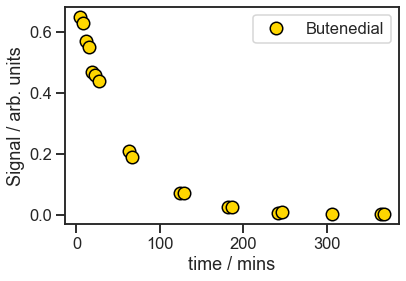

In [6]:
df = df[df.SAMPLE_ID == 'bd_ph10_d2o_002']

fig, ax = plt.subplots(1,1)

ax.plot(df.MINS_ELAPSED[df.SIG_BUTENEDIAL_ALKENE > 0], df.SIG_BUTENEDIAL_ALKENE[df.SIG_BUTENEDIAL_ALKENE > 0], 
        '.', label='Butenedial',
        markersize=25, color='Gold', markeredgecolor='black', markeredgewidth=1.5)

ax.set_xlabel('time / mins')
ax.set_ylabel('Signal / arb. units')
ax.legend()

want the units in molarity, not signal. use internal standard (DMS) to get an estimate of molarity.

In [7]:
df.columns

Index(['SAMPLE_ID', 'T_MIX', 'T_NMR', 'MINS_ELAPSED', 'SIG_BUTENEDIAL_TOTAL',
       'SIG_BUTENEDIAL_ALKENE', 'SIG_THCA_MONOMER', 'SIG_THCA_DIMER',
       'SIG_MONOSUB_ALCOHOL_PROTON_TOTAL', 'G_DMS_ADDED', 'G_SOLUTION',
       'PPM_ACIDIC_PROTON_1', 'PPM_ACIDIC_PROTON_2', 'pH_INDICATOR'],
      dtype='object')

In [8]:
def calculate_M_from_sig(dataframe):
    conversion_factor = dataframe.G_DMS_ADDED * 6 / 94.13  # sig / mol 
    alkene_factor = np.nanmean(df.SIG_BUTENEDIAL_TOTAL[df.MINS_ELAPSED < 60] / df.SIG_BUTENEDIAL_ALKENE[df.MINS_ELAPSED < 60])
    
    dataframe['M_BUTENEDIAL'] = conversion_factor * (dataframe.SIG_BUTENEDIAL_ALKENE / 2 / alkene_factor) / dataframe.G_SOLUTION * 1000
    dataframe['M_THCA_MONOMER'] = conversion_factor * (dataframe.SIG_THCA_MONOMER / 2) / dataframe.G_SOLUTION * 1000
    dataframe['M_THCA_NMER'] = conversion_factor * ((dataframe.SIG_MONOSUB_ALCOHOL_PROTON_TOTAL - dataframe.SIG_THCA_MONOMER) / 2) / dataframe.G_SOLUTION * 1000
    
    return dataframe

(code below to show alkene factor calculation)

In [9]:
df.SIG_BUTENEDIAL_TOTAL[df.MINS_ELAPSED < 60] / df.SIG_BUTENEDIAL_ALKENE[df.MINS_ELAPSED < 60]

40    1.800000
41    1.714286
42    1.701754
43    1.672727
44    1.808511
45    1.717391
46    1.727273
dtype: float64

In [10]:
df_processed = df.apply(calculate_M_from_sig, axis=1)
# df_processed = df_processed.dropna(subset=['M_BUTENEDIAL', 'M_THCA_MONOMER', 'M_THCA_NMER'])

save_data_frame(df_to_save=df_processed, experiment_label='bd_decay', level_of_cleaning='PROCESSED')

now plot in molarity / time space

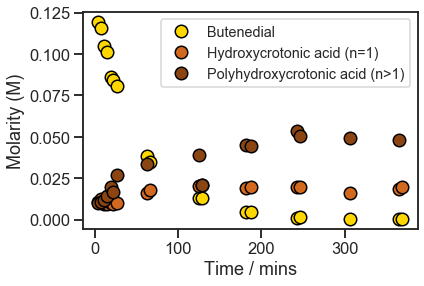

In [11]:
fig, ax = plt.subplots(1,1)

ax.plot(df_processed.MINS_ELAPSED[df_processed.M_BUTENEDIAL > 0], df_processed.M_BUTENEDIAL[df_processed.M_BUTENEDIAL > 0], 
        '.', label='Butenedial',
        markersize=25, color='Gold', markeredgecolor='black', markeredgewidth=1.5)

ax.plot(df_processed.MINS_ELAPSED[df_processed.M_BUTENEDIAL > 0], df_processed.M_THCA_MONOMER[df_processed.M_BUTENEDIAL > 0], 
        '.', label='Hydroxycrotonic acid (n=1)',
        markersize=25, color='Chocolate', markeredgecolor='black', markeredgewidth=1.5)

ax.plot(df_processed.MINS_ELAPSED[df_processed.M_BUTENEDIAL > 0], df_processed.M_THCA_NMER[df_processed.M_BUTENEDIAL > 0], 
        '.', label='Polyhydroxycrotonic acid (n>1)',
        markersize=25, color='SaddleBrown', markeredgecolor='black', markeredgewidth=1.5)

ax.set_xlabel('Time / mins')
ax.set_ylabel('Molarity (M)')
ax.legend(fontsize='x-large');

In [12]:
df_processed.MINS_ELAPSED

40       4.0
41       8.0
42      11.5
43      15.0
44      19.0
45      22.5
46      26.5
47      62.5
48      66.5
49     124.5
50     128.5
51     182.0
52     187.0
53     242.0
54     246.5
55     306.0
56     365.0
57     369.0
58    1700.0
59    3141.0
60    4661.0
Name: MINS_ELAPSED, dtype: float64

starting concentrations were 0.2 M butenedial, so this could make sense. it seems like there is usually fast removal of butenedial initially. now do work up of the kinetics.

$$ \frac{d[BD]}{dt} = - k_{1} [BD] $$ 
$$ \frac{d[HCA_{n=1}]}{dt} = k_{1} [BD] - k_{2} [HCA_{n=1}]^2 - k_{3} [HCA_{n=1}][HCA_{n>1}] $$ 
$$ \frac{d[HCA_{n>1}]}{dt} = \frac{1}{2} k_{2} [HCA_{n=1}]^2 - \frac{1}{2} k_{4} [HCA_{n>1}]^2 - k_{5} [HCA_{n>1}] $$ 

*assume there is no degradation of the polymer, though this might have been observed

In [13]:
from src.d02_extraction.extract_least_sq_fit import *


def g(t, y0, coefs):
    """
    Solution to the ODE y'(t) = f(t,y,k) with initial condition y0
    """

    y = odeint(f, y0, t, args=(coefs,))

    return y


def f_residual(coefs, t, data):
    """
    compute the residual between actual data and fitted data
    """

    y0 = coefs['BD_0'].value, coefs['HCA_0'].value, coefs['PHCA_0'].value
    model = g(t, y0, coefs).T

    return (model - data).ravel()


def f(y, t, coefs):
    """
    Your system of differential equations
    """

    BD = y[0]
    HCA = y[1]
    PHCA = y[2]

    k1 = coefs['k1'].value
    k2 = coefs['k2'].value
    k3 = coefs['k3'].value
    k4 = coefs['k4'].value
    k5 = coefs['k5'].value
    k6 = coefs['k6'].value

    # the model equations
    dBDdt = - k1 * BD
    dHCAdt = k1 * BD - k2 * HCA * HCA - k3 * HCA * PHCA + 2 * k5 * PHCA
    dPHCAdt = 0.5 * k2 * HCA * HCA - 0.5 * k4 * PHCA * PHCA - k5 * PHCA - k6 * PHCA

    return [dBDdt, dHCAdt, dPHCAdt]

In [14]:
BD_0 = df_processed.M_BUTENEDIAL[df_processed.MINS_ELAPSED == df_processed.MINS_ELAPSED.min()].values[0]
HCA_0 = df_processed.M_THCA_MONOMER[df_processed.MINS_ELAPSED == df_processed.MINS_ELAPSED.min()].values[0]
PHCA_0 = df_processed.M_THCA_NMER[df_processed.MINS_ELAPSED == df_processed.MINS_ELAPSED.min()].values[0]
X_0 = [BD_0, HCA_0, PHCA_0]

params = Parameters()
params.add('BD_0', value=BD_0, vary=False)
params.add('HCA_0', value=HCA_0, vary=False)
params.add('PHCA_0', value=PHCA_0, vary=False)
params.add('k1', value=0.001, min=0, max=10.)
params.add('k2', value=0.001, min=0, max=10.)
params.add('k3', value=0.001, min=0, max=10.)
params.add('k4', value=0.001, min=0, max=10.)
params.add('k5', value=0.001, min=0, max=10.)
params.add('k6', value=0.001, min=0, max=10.)

t_max = int(np.max(df_processed.MINS_ELAPSED) + 5)
ts = np.linspace(0, t_max, t_max + 1)
df_modeled = model_data_with_odes(g_function=g, residual_function=f_residual, params=params,
                                  experiments_dict=bd_decay_params, x_col_name='MINS_ELAPSED',
                                  y_col_names=['M_BUTENEDIAL', 'M_THCA_MONOMER', 'M_THCA_NMER'], ts=ts,
                                  vars_init=X_0, save_data=False)

df_modeled.head()

,MINS_ELAPSED,M_BUTENEDIAL,M_THCA_MONOMER,M_THCA_NMER
0,0.0,0.119431,0.010717,0.009999
1,1.0,0.117437,0.012197,0.000031
2,2.0,0.115476,0.013630,0.000035
3,3.0,0.113548,0.014914,0.000042
4,4.0,0.111652,0.016051,0.000049


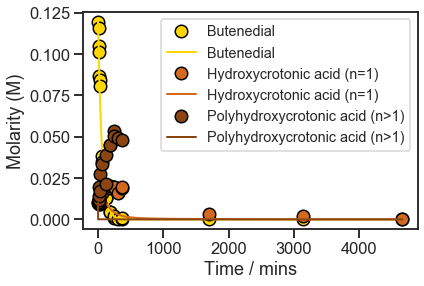

In [15]:
fig, ax = plt.subplots(1,1)

ax.plot(df_processed.MINS_ELAPSED, df_processed.M_BUTENEDIAL, 
        '.', label='Butenedial',
        markersize=25, color='Gold', markeredgecolor='black', markeredgewidth=1.5)

ax.plot(df_modeled.MINS_ELAPSED, df_modeled.M_BUTENEDIAL, 
        label='Butenedial', lw=2, color='Gold')

ax.plot(df_processed.MINS_ELAPSED, df_processed.M_THCA_MONOMER, 
        '.', label='Hydroxycrotonic acid (n=1)',
        markersize=25, color='Chocolate', markeredgecolor='black', markeredgewidth=1.5)

ax.plot(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_MONOMER, 
        label='Hydroxycrotonic acid (n=1)', lw=2, color='Chocolate')

ax.plot(df_processed.MINS_ELAPSED, df_processed.M_THCA_NMER, 
        '.', label='Polyhydroxycrotonic acid (n>1)',
        markersize=25, color='SaddleBrown', markeredgecolor='black', markeredgewidth=1.5)

ax.plot(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_NMER, 
        label='Polyhydroxycrotonic acid (n>1)', lw=2, color='SaddleBrown')

ax.set_xlabel('Time / mins')
ax.set_ylabel('Molarity (M)')
ax.legend(fontsize='x-large');

Doesn't seem to be quite a perfect fit, though some of the trends are captured. It is expected that butenedial should be captured well with a first order decay, as seen before. The nmer trend also looks like it's captured -- Appears that there is a rapid build up in the beginning (as seen), a sort of plateau (meaning, near steady state of formation of n=2 with removal and/or formation of higher order). The monomer shows a major departure. The model estimates that the increase should be more rapid in the beginning from the buildup of butenedial, with a steady decay. Presumably, what is happening is that the model (1) overestimates the removal rate of the monomer and (2) overestimates the formation of hydroxycrotonic acid? (Or perhaps, there is something else that it is doing?)

Try just using the butenedial and hydroxycrotonic acid to see what is necessary to capture the fit.

In [36]:
from src.d02_extraction.extract_least_sq_fit import *


def g(t, y0, coefs):
    """
    Solution to the ODE y'(t) = f(t,y,k) with initial condition y0
    """

    y = odeint(f, y0, t, args=(coefs,))

    return y


def f_residual(coefs, t, data):
    """
    compute the residual between actual data and fitted data
    """

    y0 = coefs['BD_0'].value, coefs['HCA_0'].value
    model = g(t, y0, coefs).T

    return (model - data).ravel()


def f(y, t, coefs):
    """
    Your system of differential equations
    """

    BD = y[0]
    HCA = y[1]

    k1 = coefs['k1'].value
    k2 = coefs['k2'].value
    k3 = coefs['k3'].value
    alpha = coefs['alpha'].value

    # the model equations
    dBDdt = - k1 * BD
    dHCAdt = (1-alpha) * k1 * BD - 2 * k2 * HCA * HCA + k3
    
    print(k1, k2, k3, alpha)

    return [dBDdt, dHCAdt]

In [17]:
from scipy.optimize import fsolve

a = [1.54011328e+01, 1.90106500e-01, 1.69667618e+04]

def estimate_ph(k):

    def disproportionation_root_fn(OH):
    
        return (a[0]*OH + a[1]*OH*OH)/(1 + a[2]*OH) - k

    OH_est = fsolve(disproportionation_root_fn, 0.0001)
    pOH_est = -np.log10(OH_est)
    return 14-pOH_est

In [18]:
ph = estimate_ph(0.01839884523303137/60)
print('estimated ph is %.2f' % ph)

estimated ph is 9.48


In [32]:
BD_0 = df_processed.M_BUTENEDIAL[df_processed.MINS_ELAPSED == df_processed.MINS_ELAPSED.min()].values[0]
HCA_0 = df_processed.M_THCA_MONOMER[df_processed.MINS_ELAPSED == df_processed.MINS_ELAPSED.min()].values[0]
X_0 = [BD_0, HCA_0]

params = Parameters()
params.add('BD_0', value=BD_0, vary=False)
params.add('HCA_0', value=HCA_0, vary=True)
params.add('k1', value=0.001, min=0, max=10.)
params.add('k2', value=0.001, min=0, max=10.)
params.add('k3', value=0.001, min=0, max=10.)
params.add('alpha', value=0.001, min=0, max=1.)

t_max = int(np.max(df_processed.MINS_ELAPSED) + 5)
ts = np.linspace(0, t_max, t_max + 1)
df_modeled = model_data_with_odes(g_function=g, residual_function=f_residual, params=params,
                                  experiments_dict=bd_decay_params, x_col_name='MINS_ELAPSED',
                                  y_col_names=['M_BUTENEDIAL', 'M_THCA_MONOMER'], ts=ts,
                                  vars_init=X_0, save_data=False)

df_modeled.head()

0.0010000000000000009 0.0009999999999998899 0.0009999999999998899 0.0009999999999998899
0.0010000000000000009 0.0009999999999998899 0.0009999999999998899 0.0009999999999998899
0.0010000000000000009 0.0009999999999998899 0.0009999999999998899 0.0009999999999998899
0.0010000000000000009 0.0009999999999998899 0.0009999999999998899 0.0009999999999998899
0.0010000000000000009 0.0009999999999998899 0.0009999999999998899 0.0009999999999998899
0.0010000000000000009 0.0009999999999998899 0.0009999999999998899 0.0009999999999998899
0.0010000000000000009 0.0009999999999998899 0.0009999999999998899 0.0009999999999998899
0.0010000000000000009 0.0009999999999998899 0.0009999999999998899 0.0009999999999998899
0.0010000000000000009 0.0009999999999998899 0.0009999999999998899 0.0009999999999998899
0.0010000000000000009 0.0009999999999998899 0.0009999999999998899 0.0009999999999998899
0.0010000000000000009 0.0009999999999998899 0.0009999999999998899 0.0009999999999998899
0.0010000000000000009 0.00099999

0.0010000000000000009 0.001000002310752035 0.0009999999999998899 0.0009999999999998899
0.0010000000000000009 0.001000002310752035 0.0009999999999998899 0.0009999999999998899
0.0010000000000000009 0.001000002310752035 0.0009999999999998899 0.0009999999999998899
0.0010000000000000009 0.001000002310752035 0.0009999999999998899 0.0009999999999998899
0.0010000000000000009 0.001000002310752035 0.0009999999999998899 0.0009999999999998899
0.0010000000000000009 0.001000002310752035 0.0009999999999998899 0.0009999999999998899
0.0010000000000000009 0.001000002310752035 0.0009999999999998899 0.0009999999999998899
0.0010000000000000009 0.001000002310752035 0.0009999999999998899 0.0009999999999998899
0.0010000000000000009 0.001000002310752035 0.0009999999999998899 0.0009999999999998899
0.0010000000000000009 0.001000002310752035 0.0009999999999998899 0.0009999999999998899
0.0010000000000000009 0.001000002310752035 0.0009999999999998899 0.0009999999999998899
0.0010000000000000009 0.001000002310752035 

0.6789109290246048 0.0064681739303884545 0.0024519535265193904 0.0003211592370810923
0.6789109290246048 0.0064681739303884545 0.0024519535265193904 0.0003211592370810923
0.6789109290246048 0.0064681739303884545 0.0024519535265193904 0.0003211592370810923
0.6789109290246048 0.0064681739303884545 0.0024519535265193904 0.0003211592370810923
0.6789109290246048 0.0064681739303884545 0.0024519535265193904 0.0003211592370810923
0.6789109290246048 0.0064681739303884545 0.0024519535265193904 0.0003211592370810923
0.6789109290246048 0.0064681739303884545 0.0024519535265193904 0.0003211592370810923
0.6789109290246048 0.0064681739303884545 0.0024519535265193904 0.0003211592370810923
0.6789109290246048 0.0064681739303884545 0.0024519535265193904 0.0003211592370810923
0.6789109290246048 0.0064681739303884545 0.0024519535265193904 0.0003211592370810923
0.6789109290246048 0.0064681739303884545 0.0024519535265193904 0.0003211592370810923
0.6789109290246048 0.0064681739303884545 0.0024519535265193904 0.

0.6789109290246048 0.0064681739303884545 0.00245195711819024 0.0003211592370810923
0.6789109290246048 0.0064681739303884545 0.00245195711819024 0.0003211592370810923
0.6789109290246048 0.0064681739303884545 0.00245195711819024 0.0003211592370810923
0.6789109290246048 0.0064681739303884545 0.00245195711819024 0.0003211592370810923
0.6789109290246048 0.0064681739303884545 0.00245195711819024 0.0003211592370810923
0.6789109290246048 0.0064681739303884545 0.00245195711819024 0.0003211592370810923
0.6789109290246048 0.0064681739303884545 0.00245195711819024 0.0003211592370810923
0.6789109290246048 0.0064681739303884545 0.00245195711819024 0.0003211592370810923
0.6789109290246048 0.0064681739303884545 0.00245195711819024 0.0003211592370810923
0.6789109290246048 0.0064681739303884545 0.00245195711819024 0.0003211592370810923
0.6789109290246048 0.0064681739303884545 0.00245195711819024 0.0003211592370810923
0.6789109290246048 0.0064681739303884545 0.00245195711819024 0.0003211592370810923
0.67

0.004683674458259901 0.01293807066154451 0.006649418289123021 0.00013186006681320528
0.004683674458259901 0.01293807066154451 0.006649418289123021 0.00013186006681320528
0.004683674458259901 0.01293807066154451 0.006649418289123021 0.00013186006681320528
0.004683674458259901 0.01293807066154451 0.006649418289123021 0.00013186006681320528
0.004683674458259901 0.01293807066154451 0.006649418289123021 0.00013186006681320528
0.004683674458259901 0.01293807066154451 0.006649418289123021 0.00013186006681320528
0.004683674458259901 0.01293807066154451 0.006649418289123021 0.00013186006681320528
0.004683674458259901 0.01293807066154451 0.006649418289123021 0.00013186006681320528
0.004683674458259901 0.01293807066154451 0.006649418289123021 0.00013186006681320528
0.004683674458259901 0.01293807066154451 0.006649418289123021 0.00013186006681320528
0.004683674458259901 0.01293807066154451 0.006649418289123021 0.00013186006681320528
0.004683674458259901 0.01293807066154451 0.006649418289123021 0.0

0.004683674458259901 0.01293807066154451 0.006649424124751113 0.00013186006681320528
0.004683674458259901 0.01293807066154451 0.006649424124751113 0.00013186006681320528
0.004683674458259901 0.01293807066154451 0.006649424124751113 0.00013186006681320528
0.004683674458259901 0.01293807066154451 0.006649424124751113 0.00013186006681320528
0.004683674458259901 0.01293807066154451 0.006649424124751113 0.00013186006681320528
0.004683674458259901 0.01293807066154451 0.006649424124751113 0.00013186006681320528
0.004683674458259901 0.01293807066154451 0.006649424124751113 0.00013186006681320528
0.004683674458259901 0.01293807066154451 0.006649424124751113 0.00013186006681320528
0.004683674458259901 0.01293807066154451 0.006649424124751113 0.00013186006681320528
0.004683674458259901 0.01293807066154451 0.006649424124751113 0.00013186006681320528
0.004683674458259901 0.01293807066154451 0.006649424124751113 0.00013186006681320528
0.004683674458259901 0.01293807066154451 0.006649424124751113 0.0

0.6050127590300634 0.01778065761386005 0.014486373584401413 3.091375032404642e-05
0.6050127590300634 0.01778065761386005 0.014486373584401413 3.091375032404642e-05
0.6050127590300634 0.01778065761386005 0.014486373584401413 3.091375032404642e-05
0.6050127590300634 0.01778065761386005 0.014486373584401413 3.091375032404642e-05
0.6050127590300634 0.01778065761386005 0.014486373584401413 3.091375032404642e-05
0.6050127590300634 0.01778065761386005 0.014486373584401413 3.091375032404642e-05
0.6050127590300634 0.01778065761386005 0.014486373584401413 3.091375032404642e-05
0.6050127590300634 0.01778065761386005 0.014486373584401413 3.091375032404642e-05
0.6050127590300634 0.01778065761386005 0.014486373584401413 3.091375032404642e-05
0.6050127590300634 0.01778065761386005 0.014486373584401413 3.091375032404642e-05
0.6050127590300634 0.01778065761386005 0.014486373584401413 3.091375032404642e-05
0.6050127590300634 0.01778065761386005 0.014486373584401413 3.091375032404642e-05
0.60501275903006

0.6050127590300634 0.01778065761386005 0.014486382055240998 3.091375032404642e-05
0.6050127590300634 0.01778065761386005 0.014486382055240998 3.091375032404642e-05
0.6050127590300634 0.01778065761386005 0.014486382055240998 3.091375032404642e-05
0.6050127590300634 0.01778065761386005 0.014486382055240998 3.091375032404642e-05
0.6050127590300634 0.01778065761386005 0.014486382055240998 3.091375032404642e-05
0.6050127590300634 0.01778065761386005 0.014486382055240998 3.091375032404642e-05
0.6050127590300634 0.01778065761386005 0.014486382055240998 3.091375032404642e-05
0.6050127590300634 0.01778065761386005 0.014486382055240998 3.091375032404642e-05
0.6050127590300634 0.01778065761386005 0.014486382055240998 3.091375032404642e-05
0.6050127590300634 0.01778065761386005 0.014486382055240998 3.091375032404642e-05
0.6050127590300634 0.01778065761386005 0.014486382055240998 3.091375032404642e-05
0.6050127590300634 0.01778065761386005 0.014486382055240998 3.091375032404642e-05
0.60501275903006

0.14984304131001408 0.018487052089755096 0.018783492338229624 4.828177579963011e-07
0.14984304131001408 0.018487052089755096 0.018783492338229624 4.828177579963011e-07
0.14984304131001408 0.018487052089755096 0.018783492338229624 4.828177579963011e-07
0.14984304131001408 0.018487052089755096 0.018783492338229624 4.828177579963011e-07
0.14984304131001408 0.018487052089755096 0.018783492338229624 4.828177579963011e-07
0.14984304131001408 0.018487052089755096 0.018783492338229624 4.828177579963011e-07
0.14984304131001408 0.018487052089755096 0.018783492338229624 4.828177579963011e-07
0.14984304131001408 0.018487052089755096 0.018783492338229624 4.828177579963011e-07
0.14984304131001408 0.018487052089755096 0.018783492338229624 4.828177579963011e-07
0.14984304131001408 0.018487052089755096 0.018783492338229624 4.828177579963011e-07
0.14984304131001408 0.018487052089755096 0.018783492338229624 4.828177579963011e-07
0.14984304131001408 0.018487052089755096 0.018783492338229624 4.828177579963

0.14984304131001408 0.018487061593905896 0.018783492338229624 4.828177579963011e-07
0.14984304131001408 0.018487061593905896 0.018783492338229624 4.828177579963011e-07
0.14984304131001408 0.018487061593905896 0.018783492338229624 4.828177579963011e-07
0.14984304131001408 0.018487061593905896 0.018783492338229624 4.828177579963011e-07
0.14984304131001408 0.018487061593905896 0.018783492338229624 4.828177579963011e-07
0.14984304131001408 0.018487061593905896 0.018783492338229624 4.828177579963011e-07
0.14984304131001408 0.018487061593905896 0.018783492338229624 4.828177579963011e-07
0.14984304131001408 0.018487061593905896 0.018783492338229624 4.828177579963011e-07
0.14984304131001408 0.018487061593905896 0.018783492338229624 4.828177579963011e-07
0.14984304131001408 0.018487061593905896 0.018783492338229624 4.828177579963011e-07
0.14984304131001408 0.018487061593905896 0.018783492338229624 4.828177579963011e-07
0.14984304131001408 0.018487061593905896 0.018783492338229624 4.828177579963

0.14984286164268085 0.018487052089755096 0.018783492338229624 4.828177579963011e-07
0.14984286164268085 0.018487052089755096 0.018783492338229624 4.828177579963011e-07
0.14984286164268085 0.018487052089755096 0.018783492338229624 4.828177579963011e-07
0.14984286164268085 0.018487052089755096 0.018783492338229624 4.828177579963011e-07
0.14984286164268085 0.018487052089755096 0.018783492338229624 4.828177579963011e-07
0.14984286164268085 0.018487052089755096 0.018783492338229624 4.828177579963011e-07
0.14984286164268085 0.018487052089755096 0.018783492338229624 4.828177579963011e-07
0.14984286164268085 0.018487052089755096 0.018783492338229624 4.828177579963011e-07
0.14984286164268085 0.018487052089755096 0.018783492338229624 4.828177579963011e-07
0.14984286164268085 0.018487052089755096 0.018783492338229624 4.828177579963011e-07
0.14984286164268085 0.018487052089755096 0.018783492338229624 4.828177579963011e-07
0.14984286164268085 0.018487052089755096 0.018783492338229624 4.828177579963

0.12346236609358863 0.01862690405342482 0.0302098922106131 2.9225707298685677e-06
0.12346236609358863 0.01862690405342482 0.0302098922106131 2.9225707298685677e-06
0.12346236609358863 0.01862690405342482 0.0302098922106131 2.9225707298685677e-06
0.12346236609358863 0.01862690405342482 0.0302098922106131 2.9225707298685677e-06
0.12346236609358863 0.01862690405342482 0.0302098922106131 2.9225707298685677e-06
0.12346236609358863 0.01862690405342482 0.0302098922106131 2.9225707298685677e-06
0.12346236609358863 0.01862690405342482 0.0302098922106131 2.9225707298685677e-06
0.12346236609358863 0.01862690405342482 0.0302098922106131 2.9225707298685677e-06
0.12346236609358863 0.01862690405342482 0.0302098922106131 2.9225707298685677e-06
0.12346236609358863 0.01862690405342482 0.0302098922106131 2.9225707298685677e-06
0.12346236609358863 0.01862690405342482 0.0302098922106131 2.9225707298685677e-06
0.12346236609358863 0.01862690405342482 0.0302098922106131 2.9225707298685677e-06
0.12346236609358

0.12346236609358863 0.01862690405342482 0.0302098922106131 2.92244410560194e-06
0.12346236609358863 0.01862690405342482 0.0302098922106131 2.92244410560194e-06
0.12346236609358863 0.01862690405342482 0.0302098922106131 2.92244410560194e-06
0.12346236609358863 0.01862690405342482 0.0302098922106131 2.92244410560194e-06
0.12346236609358863 0.01862690405342482 0.0302098922106131 2.92244410560194e-06
0.12346236609358863 0.01862690405342482 0.0302098922106131 2.92244410560194e-06
0.12346236609358863 0.01862690405342482 0.0302098922106131 2.92244410560194e-06
0.12346236609358863 0.01862690405342482 0.0302098922106131 2.92244410560194e-06
0.12346236609358863 0.01862690405342482 0.0302098922106131 2.92244410560194e-06
0.12346236609358863 0.01862690405342482 0.0302098922106131 2.92244410560194e-06
0.12346236609358863 0.01862690405342482 0.0302098922106131 2.92244410560194e-06
0.12346236609358863 0.01862690405342482 0.0302098922106131 2.92244410560194e-06
0.12346236609358863 0.01862690405342482 

0.12889836186454007 0.018625344438213398 0.036190558684859875 1.1002171007579165e-07
0.12889836186454007 0.018625344438213398 0.036190558684859875 1.1002171007579165e-07
0.12889836186454007 0.018625344438213398 0.036190558684859875 1.1002171007579165e-07
0.12889836186454007 0.018625344438213398 0.036190558684859875 1.1002171007579165e-07
0.12889836186454007 0.018625344438213398 0.036190558684859875 1.1002171007579165e-07
0.12889836186454007 0.018625344438213398 0.036190558684859875 1.1002171007579165e-07
0.12889836186454007 0.018625344438213398 0.036190558684859875 1.1002171007579165e-07
0.12889836186454007 0.018625344438213398 0.036190558684859875 1.1002171007579165e-07
0.12889836186454007 0.018625344438213398 0.036190558684859875 1.1002171007579165e-07
0.12889836186454007 0.018625344438213398 0.036190558684859875 1.1002171007579165e-07
0.12889836186454007 0.018625344438213398 0.036190558684859875 1.1002171007579165e-07
0.12889836186454007 0.018625344438213398 0.036190558684859875 1.1

0.12889836186454007 0.018625353975715297 0.036190558684859875 1.1002171007579165e-07
0.12889836186454007 0.018625353975715297 0.036190558684859875 1.1002171007579165e-07
0.12889836186454007 0.018625353975715297 0.036190558684859875 1.1002171007579165e-07
0.12889836186454007 0.018625353975715297 0.036190558684859875 1.1002171007579165e-07
0.12889836186454007 0.018625353975715297 0.036190558684859875 1.1002171007579165e-07
0.12889836186454007 0.018625353975715297 0.036190558684859875 1.1002171007579165e-07
0.12889836186454007 0.018625353975715297 0.036190558684859875 1.1002171007579165e-07
0.12889836186454007 0.018625353975715297 0.036190558684859875 1.1002171007579165e-07
0.12889836186454007 0.018625353975715297 0.036190558684859875 1.1002171007579165e-07
0.12889836186454007 0.018625353975715297 0.036190558684859875 1.1002171007579165e-07
0.12889836186454007 0.018625353975715297 0.036190558684859875 1.1002171007579165e-07
0.12889836186454007 0.018625353975715297 0.036190558684859875 1.1

0.1288981934883403 0.018625344438213398 0.036190558684859875 1.1002171007579165e-07
0.1288981934883403 0.018625344438213398 0.036190558684859875 1.1002171007579165e-07
0.1288981934883403 0.018625344438213398 0.036190558684859875 1.1002171007579165e-07
0.1288981934883403 0.018625344438213398 0.036190558684859875 1.1002171007579165e-07
0.1288981934883403 0.018625344438213398 0.036190558684859875 1.1002171007579165e-07
0.1288981934883403 0.018625344438213398 0.036190558684859875 1.1002171007579165e-07
0.1288981934883403 0.018625344438213398 0.036190558684859875 1.1002171007579165e-07
0.1288981934883403 0.018625344438213398 0.036190558684859875 1.1002171007579165e-07
0.1288981934883403 0.018625344438213398 0.036190558684859875 1.1002171007579165e-07
0.1288981934883403 0.018625344438213398 0.036190558684859875 1.1002171007579165e-07
0.1288981934883403 0.018625344438213398 0.036190558684859875 1.1002171007579165e-07
0.1288981934883403 0.018625344438213398 0.036190558684859875 1.1002171007579

0.11779644747816859 0.018642283854922725 0.03620430656747442 5.92303983637521e-12
0.11779644747816859 0.018642283854922725 0.03620430656747442 5.92303983637521e-12
0.11779644747816859 0.018642283854922725 0.03620430656747442 5.92303983637521e-12
0.11779644747816859 0.018642283854922725 0.03620430656747442 5.92303983637521e-12
0.11779644747816859 0.018642283854922725 0.03620430656747442 5.92303983637521e-12
0.11779644747816859 0.018642283854922725 0.03620430656747442 5.92303983637521e-12
0.11779644747816859 0.018642283854922725 0.03620430656747442 5.92303983637521e-12
0.11779644747816859 0.018642283854922725 0.03620430656747442 5.92303983637521e-12
0.11779644747816859 0.018642283854922725 0.03620430656747442 5.92303983637521e-12
0.11779644747816859 0.018642283854922725 0.03620430656747442 5.92303983637521e-12
0.11779644747816859 0.018642283854922725 0.03620430656747442 5.92303983637521e-12
0.11779644747816859 0.018642283854922725 0.03620430656747442 5.92303983637521e-12
0.11779644747816

0.11779644747816859 0.018642283854922725 0.03620431954809766 5.92303983637521e-12
0.11779644747816859 0.018642283854922725 0.03620431954809766 5.92303983637521e-12
0.11779644747816859 0.018642283854922725 0.03620431954809766 5.92303983637521e-12
0.11779644747816859 0.018642283854922725 0.03620431954809766 5.92303983637521e-12
0.11779644747816859 0.018642283854922725 0.03620431954809766 5.92303983637521e-12
0.11779644747816859 0.018642283854922725 0.03620431954809766 5.92303983637521e-12
0.11779644747816859 0.018642283854922725 0.03620431954809766 5.92303983637521e-12
0.11779644747816859 0.018642283854922725 0.03620431954809766 5.92303983637521e-12
0.11779644747816859 0.018642283854922725 0.03620431954809766 5.92303983637521e-12
0.11779644747816859 0.018642283854922725 0.03620431954809766 5.92303983637521e-12
0.11779644747816859 0.018642283854922725 0.03620431954809766 5.92303983637521e-12
0.11779644747816859 0.018642283854922725 0.03620431954809766 5.92303983637521e-12
0.11779644747816

0.11779628565602557 0.018642283854922725 0.03620430656747442 5.92303983637521e-12
0.11779628565602557 0.018642283854922725 0.03620430656747442 5.92303983637521e-12
0.11779628565602557 0.018642283854922725 0.03620430656747442 5.92303983637521e-12
0.11779628565602557 0.018642283854922725 0.03620430656747442 5.92303983637521e-12
0.11779628565602557 0.018642283854922725 0.03620430656747442 5.92303983637521e-12
0.11779628565602557 0.018642283854922725 0.03620430656747442 5.92303983637521e-12
0.11779628565602557 0.018642283854922725 0.03620430656747442 5.92303983637521e-12
0.11779628565602557 0.018642283854922725 0.03620430656747442 5.92303983637521e-12
0.11779628565602557 0.018642283854922725 0.03620430656747442 5.92303983637521e-12
0.11779628565602557 0.018642283854922725 0.03620430656747442 5.92303983637521e-12
0.11779628565602557 0.018642283854922725 0.03620430656747442 5.92303983637521e-12
0.11779628565602557 0.018642283854922725 0.03620430656747442 5.92303983637521e-12
0.11779628565602

0.1169914348112252 0.01864707742118832 0.03658000402800621 4.714826307150588e-09
0.1169914348112252 0.01864707742118832 0.03658000402800621 4.714826307150588e-09
0.1169914348112252 0.01864707742118832 0.03658000402800621 4.714826307150588e-09
0.1169914348112252 0.01864707742118832 0.03658000402800621 4.714826307150588e-09
0.1169914348112252 0.01864707742118832 0.03658000402800621 4.714826307150588e-09
0.1169914348112252 0.01864707742118832 0.03658000402800621 4.714826307150588e-09
0.1169914348112252 0.01864707742118832 0.03658000402800621 4.714826307150588e-09
0.1169914348112252 0.01864707742118832 0.03658000402800621 4.714826307150588e-09
0.1169914348112252 0.01864707742118832 0.03658000402800621 4.714826307150588e-09
0.1169914348112252 0.01864707742118832 0.03658000402800621 4.714826307150588e-09
0.1169914348112252 0.01864707742118832 0.03658000402800621 4.714826307150588e-09
0.1169914348112252 0.01864707742118832 0.03658000402800621 4.714826307150588e-09
0.1169914348112252 0.0186470

0.11699127348138721 0.0186470678784606 0.03658000402800621 4.714826307150588e-09
0.11699127348138721 0.0186470678784606 0.03658000402800621 4.714826307150588e-09
0.11699127348138721 0.0186470678784606 0.03658000402800621 4.714826307150588e-09
0.11699127348138721 0.0186470678784606 0.03658000402800621 4.714826307150588e-09
0.11699127348138721 0.0186470678784606 0.03658000402800621 4.714826307150588e-09
0.11699127348138721 0.0186470678784606 0.03658000402800621 4.714826307150588e-09
0.11699127348138721 0.0186470678784606 0.03658000402800621 4.714826307150588e-09
0.11699127348138721 0.0186470678784606 0.03658000402800621 4.714826307150588e-09
0.11699127348138721 0.0186470678784606 0.03658000402800621 4.714826307150588e-09
0.11699127348138721 0.0186470678784606 0.03658000402800621 4.714826307150588e-09
0.11699127348138721 0.0186470678784606 0.03658000402800621 4.714826307150588e-09
0.11699127348138721 0.0186470678784606 0.03658000402800621 4.714826307150588e-09
0.11699127348138721 0.018647

0.11706205860158447 0.018647187135996113 0.036605360518033314 4.433980405060822e-09
0.11706205860158447 0.018647187135996113 0.036605360518033314 4.433980405060822e-09
0.11706205860158447 0.018647187135996113 0.036605360518033314 4.433980405060822e-09
0.11706205860158447 0.018647187135996113 0.036605360518033314 4.433980405060822e-09
0.11706205860158447 0.018647187135996113 0.036605360518033314 4.433980405060822e-09
0.11706205860158447 0.018647187135996113 0.036605360518033314 4.433980405060822e-09
0.11706205860158447 0.018647187135996113 0.036605360518033314 4.433980405060822e-09
0.11706205860158447 0.018647187135996113 0.036605360518033314 4.433980405060822e-09
0.11706205860158447 0.018647187135996113 0.036605360518033314 4.433980405060822e-09
0.11706205860158447 0.018647187135996113 0.036605360518033314 4.433980405060822e-09
0.11706205860158447 0.018647187135996113 0.036605360518033314 4.433980405060822e-09
0.11706205860158447 0.018647187135996113 0.036605360518033314 4.433980405060

0.11706205860158447 0.018647187135996113 0.036605360518033314 4.43891035040167e-09
0.11706205860158447 0.018647187135996113 0.036605360518033314 4.43891035040167e-09
0.11706205860158447 0.018647187135996113 0.036605360518033314 4.43891035040167e-09
0.11706205860158447 0.018647187135996113 0.036605360518033314 4.43891035040167e-09
0.11706205860158447 0.018647187135996113 0.036605360518033314 4.43891035040167e-09
0.11706205860158447 0.018647187135996113 0.036605360518033314 4.43891035040167e-09
0.11706205860158447 0.018647187135996113 0.036605360518033314 4.43891035040167e-09
0.11706205860158447 0.018647187135996113 0.036605360518033314 4.43891035040167e-09
0.11706205860158447 0.018647187135996113 0.036605360518033314 4.43891035040167e-09
0.11706205860158447 0.018647187135996113 0.036605360518033314 4.43891035040167e-09
0.11706205860158447 0.018647187135996113 0.036605360518033314 4.43891035040167e-09
0.11706205860158447 0.018647187135996113 0.036605360518033314 4.43891035040167e-09
0.11

0.1170486333552691 0.01864719272081372 0.03661806830956793 6.439293542825908e-13
0.1170486333552691 0.01864719272081372 0.03661806830956793 6.439293542825908e-13
0.1170486333552691 0.01864719272081372 0.03661806830956793 6.439293542825908e-13
0.1170486333552691 0.01864719272081372 0.03661806830956793 6.439293542825908e-13
0.1170486333552691 0.01864719272081372 0.03661806830956793 6.439293542825908e-13
0.1170486333552691 0.01864719272081372 0.03661806830956793 6.439293542825908e-13
0.1170486333552691 0.01864719272081372 0.03661806830956793 6.439293542825908e-13
0.1170486333552691 0.01864719272081372 0.03661806830956793 6.439293542825908e-13
0.1170486333552691 0.01864719272081372 0.03661806830956793 6.439293542825908e-13
0.1170486333552691 0.01864719272081372 0.03661806830956793 6.439293542825908e-13
0.1170486333552691 0.01864719272081372 0.03661806830956793 6.439293542825908e-13
0.1170486333552691 0.01864719272081372 0.03661806830956793 6.439293542825908e-13
0.1170486333552691 0.0186471

0.1170486333552691 0.01864719272081372 0.03661808135770106 6.439293542825908e-13
0.1170486333552691 0.01864719272081372 0.03661808135770106 6.439293542825908e-13
0.1170486333552691 0.01864719272081372 0.03661808135770106 6.439293542825908e-13
0.1170486333552691 0.01864719272081372 0.03661808135770106 6.439293542825908e-13
0.1170486333552691 0.01864719272081372 0.03661808135770106 6.439293542825908e-13
0.1170486333552691 0.01864719272081372 0.03661808135770106 6.439293542825908e-13
0.1170486333552691 0.01864719272081372 0.03661808135770106 6.439293542825908e-13
0.1170486333552691 0.01864719272081372 0.03661808135770106 6.439293542825908e-13
0.1170486333552691 0.01864719272081372 0.03661808135770106 6.439293542825908e-13
0.1170486333552691 0.01864719272081372 0.03661808135770106 6.439293542825908e-13
0.1170486333552691 0.01864719272081372 0.03661808135770106 6.439293542825908e-13
0.1170486333552691 0.01864719272081372 0.03661808135770106 6.439293542825908e-13
0.1170486333552691 0.0186471

0.11706419910248506 0.018647171041658583 0.03665468130558902 2.395861287141088e-12
0.11706419910248506 0.018647171041658583 0.03665468130558902 2.395861287141088e-12
0.11706419910248506 0.018647171041658583 0.03665468130558902 2.395861287141088e-12
0.11706419910248506 0.018647171041658583 0.03665468130558902 2.395861287141088e-12
0.11706419910248506 0.018647171041658583 0.03665468130558902 2.395861287141088e-12
0.11706419910248506 0.018647171041658583 0.03665468130558902 2.395861287141088e-12
0.11706419910248506 0.018647171041658583 0.03665468130558902 2.395861287141088e-12
0.11706419910248506 0.018647171041658583 0.03665468130558902 2.395861287141088e-12
0.11706419910248506 0.018647171041658583 0.03665468130558902 2.395861287141088e-12
0.11706419910248506 0.018647171041658583 0.03665468130558902 2.395861287141088e-12
0.11706419910248506 0.018647171041658583 0.03665468130558902 2.395861287141088e-12
0.11706419910248506 0.018647171041658583 0.03665468130558902 2.395861287141088e-12
0.11

0.11706419910248506 0.018647171041658583 0.036654694359674056 2.395861287141088e-12
0.11706419910248506 0.018647171041658583 0.036654694359674056 2.395861287141088e-12
0.11706419910248506 0.018647171041658583 0.036654694359674056 2.395861287141088e-12
0.11706419910248506 0.018647171041658583 0.036654694359674056 2.395861287141088e-12
0.11706419910248506 0.018647171041658583 0.036654694359674056 2.395861287141088e-12
0.11706419910248506 0.018647171041658583 0.036654694359674056 2.395861287141088e-12
0.11706419910248506 0.018647171041658583 0.036654694359674056 2.395861287141088e-12
0.11706419910248506 0.018647171041658583 0.036654694359674056 2.395861287141088e-12
0.11706419910248506 0.018647171041658583 0.036654694359674056 2.395861287141088e-12
0.11706419910248506 0.018647171041658583 0.036654694359674056 2.395861287141088e-12
0.11706419910248506 0.018647171041658583 0.036654694359674056 2.395861287141088e-12
0.11706419910248506 0.018647171041658583 0.036654694359674056 2.395861287141

0.11712760314733683 0.01864705648514986 0.03672772454070328 5.114908496750559e-11
0.11712760314733683 0.01864705648514986 0.03672772454070328 5.114908496750559e-11
0.11712760314733683 0.01864705648514986 0.03672772454070328 5.114908496750559e-11
0.11712760314733683 0.01864705648514986 0.03672772454070328 5.114908496750559e-11
0.11712760314733683 0.01864705648514986 0.03672772454070328 5.114908496750559e-11
0.11712760314733683 0.01864705648514986 0.03672772454070328 5.114908496750559e-11
0.11712760314733683 0.01864705648514986 0.03672772454070328 5.114908496750559e-11
0.11712760314733683 0.01864705648514986 0.03672772454070328 5.114908496750559e-11
0.11712760314733683 0.01864705648514986 0.03672772454070328 5.114908496750559e-11
0.11712760314733683 0.01864705648514986 0.03672772454070328 5.114908496750559e-11
0.11712760314733683 0.01864705648514986 0.03672772454070328 5.114908496750559e-11
0.11712760314733683 0.01864705648514986 0.03672772454070328 5.114908496750559e-11
0.11712760314733

0.11712760314733683 0.01864705648514986 0.0367277376066516 5.114908496750559e-11
0.11712760314733683 0.01864705648514986 0.0367277376066516 5.114908496750559e-11
0.11712760314733683 0.01864705648514986 0.0367277376066516 5.114908496750559e-11
0.11712760314733683 0.01864705648514986 0.0367277376066516 5.114908496750559e-11
0.11712760314733683 0.01864705648514986 0.0367277376066516 5.114908496750559e-11
0.11712760314733683 0.01864705648514986 0.0367277376066516 5.114908496750559e-11
0.11712760314733683 0.01864705648514986 0.0367277376066516 5.114908496750559e-11
0.11712760314733683 0.01864705648514986 0.0367277376066516 5.114908496750559e-11
0.11712760314733683 0.01864705648514986 0.0367277376066516 5.114908496750559e-11
0.11712760314733683 0.01864705648514986 0.0367277376066516 5.114908496750559e-11
0.11712760314733683 0.01864705648514986 0.0367277376066516 5.114908496750559e-11
0.11712760314733683 0.01864705648514986 0.0367277376066516 5.114908496750559e-11
0.11712760314733683 0.018647

0.1172579686891102 0.018646804646261228 0.036873055685779366 5.479517950490731e-09
0.1172579686891102 0.018646804646261228 0.036873055685779366 5.479517950490731e-09
0.1172579686891102 0.018646804646261228 0.036873055685779366 5.479517950490731e-09
0.1172579686891102 0.018646804646261228 0.036873055685779366 5.479517950490731e-09
0.1172579686891102 0.018646804646261228 0.036873055685779366 5.479517950490731e-09
0.1172579686891102 0.018646804646261228 0.036873055685779366 5.479517950490731e-09
0.1172579686891102 0.018646804646261228 0.036873055685779366 5.479517950490731e-09
0.1172579686891102 0.018646804646261228 0.036873055685779366 5.479517950490731e-09
0.1172579686891102 0.018646804646261228 0.036873055685779366 5.479517950490731e-09
0.1172579686891102 0.018646804646261228 0.036873055685779366 5.479517950490731e-09
0.1172579686891102 0.018646804646261228 0.036873055685779366 5.479517950490731e-09
0.1172579686891102 0.018646804646261228 0.036873055685779366 5.479517950490731e-09
0.11

0.1172579686891102 0.01864681418892622 0.036873055685779366 5.479517950490731e-09
0.1172579686891102 0.01864681418892622 0.036873055685779366 5.479517950490731e-09
0.1172579686891102 0.01864681418892622 0.036873055685779366 5.479517950490731e-09
0.1172579686891102 0.01864681418892622 0.036873055685779366 5.479517950490731e-09
0.1172579686891102 0.01864681418892622 0.036873055685779366 5.479517950490731e-09
0.1172579686891102 0.01864681418892622 0.036873055685779366 5.479517950490731e-09
0.1172579686891102 0.01864681418892622 0.036873055685779366 5.479517950490731e-09
0.1172579686891102 0.01864681418892622 0.036873055685779366 5.479517950490731e-09
0.1172579686891102 0.01864681418892622 0.036873055685779366 5.479517950490731e-09
0.1172579686891102 0.01864681418892622 0.036873055685779366 5.479517950490731e-09
0.1172579686891102 0.01864681418892622 0.036873055685779366 5.479517950490731e-09
0.1172579686891102 0.01864681418892622 0.036873055685779366 5.479517950490731e-09
0.11725796868911

0.11725780719600809 0.018646804646261228 0.036873055685779366 5.479517950490731e-09
0.11725780719600809 0.018646804646261228 0.036873055685779366 5.479517950490731e-09
0.11725780719600809 0.018646804646261228 0.036873055685779366 5.479517950490731e-09
0.11725780719600809 0.018646804646261228 0.036873055685779366 5.479517950490731e-09
0.11725780719600809 0.018646804646261228 0.036873055685779366 5.479517950490731e-09
0.11725780719600809 0.018646804646261228 0.036873055685779366 5.479517950490731e-09
0.11725780719600809 0.018646804646261228 0.036873055685779366 5.479517950490731e-09
0.11725780719600809 0.018646804646261228 0.036873055685779366 5.479517950490731e-09
0.11725780719600809 0.018646804646261228 0.036873055685779366 5.479517950490731e-09
0.11725780719600809 0.018646804646261228 0.036873055685779366 5.479517950490731e-09
0.11725780719600809 0.018646804646261228 0.036873055685779366 5.479517950490731e-09
0.11725780719600809 0.018646804646261228 0.036873055685779366 5.479517950490

0.11795836817904415 0.01864824321687497 0.03688713321372161 5.503431044218132e-11
0.11795836817904415 0.01864824321687497 0.03688713321372161 5.503431044218132e-11
0.11795836817904415 0.01864824321687497 0.03688713321372161 5.503431044218132e-11
0.11795836817904415 0.01864824321687497 0.03688713321372161 5.503431044218132e-11
0.11795836817904415 0.01864824321687497 0.03688713321372161 5.503431044218132e-11
0.11795836817904415 0.01864824321687497 0.03688713321372161 5.503431044218132e-11
0.11795836817904415 0.01864824321687497 0.03688713321372161 5.503431044218132e-11
0.11795836817904415 0.01864824321687497 0.03688713321372161 5.503431044218132e-11
0.11795836817904415 0.01864824321687497 0.03688713321372161 5.503431044218132e-11
0.11795836817904415 0.01864824321687497 0.03688713321372161 5.503431044218132e-11
0.11795836817904415 0.01864824321687497 0.03688713321372161 5.503431044218132e-11
0.11795836817904415 0.01864824321687497 0.03688713321372161 5.503431044218132e-11
0.11795836817904

0.11795836817904415 0.01864824321687497 0.03688713321372161 5.55849810623954e-11
0.11795836817904415 0.01864824321687497 0.03688713321372161 5.55849810623954e-11
0.11795836817904415 0.01864824321687497 0.03688713321372161 5.55849810623954e-11
0.11795836817904415 0.01864824321687497 0.03688713321372161 5.55849810623954e-11
0.11795836817904415 0.01864824321687497 0.03688713321372161 5.55849810623954e-11
0.11795836817904415 0.01864824321687497 0.03688713321372161 5.55849810623954e-11
0.11795836817904415 0.01864824321687497 0.03688713321372161 5.55849810623954e-11
0.11795836817904415 0.01864824321687497 0.03688713321372161 5.55849810623954e-11
0.11795836817904415 0.01864824321687497 0.03688713321372161 5.55849810623954e-11
0.11795836817904415 0.01864824321687497 0.03688713321372161 5.55849810623954e-11
0.11795836817904415 0.01864824321687497 0.03688713321372161 5.55849810623954e-11
0.11795836817904415 0.01864824321687497 0.03688713321372161 5.55849810623954e-11
0.11795836817904415 0.018648

0.1179137736284433 0.0186480190626942 0.03693250674652593 3.612127263963316e-10
0.1179137736284433 0.0186480190626942 0.03693250674652593 3.612127263963316e-10
0.1179137736284433 0.0186480190626942 0.03693250674652593 3.612127263963316e-10
0.1179137736284433 0.0186480190626942 0.03693250674652593 3.612127263963316e-10
0.1179137736284433 0.0186480190626942 0.03693250674652593 3.612127263963316e-10
0.1179137736284433 0.0186480190626942 0.03693250674652593 3.612127263963316e-10
0.1179137736284433 0.0186480190626942 0.03693250674652593 3.612127263963316e-10
0.1179137736284433 0.0186480190626942 0.03693250674652593 3.612127263963316e-10
0.1179137736284433 0.0186480190626942 0.03693250674652593 3.612127263963316e-10
0.1179137736284433 0.0186480190626942 0.03693250674652593 3.612127263963316e-10
0.1179137736284433 0.0186480190626942 0.03693250674652593 3.612127263963316e-10
0.1179137736284433 0.0186480190626942 0.03693250674652593 3.612127263963316e-10
0.1179137736284433 0.0186480190626942 0.

0.1179137736284433 0.0186480190626942 0.03693251984565937 3.612127263963316e-10
0.1179137736284433 0.0186480190626942 0.03693251984565937 3.612127263963316e-10
0.1179137736284433 0.0186480190626942 0.03693251984565937 3.612127263963316e-10
0.1179137736284433 0.0186480190626942 0.03693251984565937 3.612127263963316e-10
0.1179137736284433 0.0186480190626942 0.03693251984565937 3.612127263963316e-10
0.1179137736284433 0.0186480190626942 0.03693251984565937 3.612127263963316e-10
0.1179137736284433 0.0186480190626942 0.03693251984565937 3.612127263963316e-10
0.1179137736284433 0.0186480190626942 0.03693251984565937 3.612127263963316e-10
0.1179137736284433 0.0186480190626942 0.03693251984565937 3.612127263963316e-10
0.1179137736284433 0.0186480190626942 0.03693251984565937 3.612127263963316e-10
0.1179137736284433 0.0186480190626942 0.03693251984565937 3.612127263963316e-10
0.1179137736284433 0.0186480190626942 0.03693251984565937 3.612127263963316e-10
0.1179137736284433 0.0186480190626942 0.

0.11732169020158123 0.018647754199439537 0.03700539378371226 8.140159102332234e-09
0.11732169020158123 0.018647754199439537 0.03700539378371226 8.140159102332234e-09
0.11732169020158123 0.018647754199439537 0.03700539378371226 8.140159102332234e-09
0.11732169020158123 0.018647754199439537 0.03700539378371226 8.140159102332234e-09
0.11732169020158123 0.018647754199439537 0.03700539378371226 8.140159102332234e-09
0.11732169020158123 0.018647754199439537 0.03700539378371226 8.140159102332234e-09
0.11732169020158123 0.018647754199439537 0.03700539378371226 8.140159102332234e-09
0.11732169020158123 0.018647754199439537 0.03700539378371226 8.140159102332234e-09
0.11732169020158123 0.018647754199439537 0.03700539378371226 8.140159102332234e-09
0.11732169020158123 0.018647754199439537 0.03700539378371226 8.140159102332234e-09
0.11732169020158123 0.018647754199439537 0.03700539378371226 8.140159102332234e-09
0.11732169020158123 0.018647754199439537 0.03700539378371226 8.140159102332234e-09
0.11

0.11728892630847293 0.018647840955355877 0.03696403258639236 7.971356907887639e-10
0.11728892630847293 0.018647840955355877 0.03696403258639236 7.971356907887639e-10
0.11728892630847293 0.018647840955355877 0.03696403258639236 7.971356907887639e-10
0.11728892630847293 0.018647840955355877 0.03696403258639236 7.971356907887639e-10
0.11728892630847293 0.018647840955355877 0.03696403258639236 7.971356907887639e-10
0.11728892630847293 0.018647840955355877 0.03696403258639236 7.971356907887639e-10
0.11728892630847293 0.018647840955355877 0.03696403258639236 7.971356907887639e-10
0.11728892630847293 0.018647840955355877 0.03696403258639236 7.971356907887639e-10
0.11728892630847293 0.018647840955355877 0.03696403258639236 7.971356907887639e-10
0.11728892630847293 0.018647840955355877 0.03696403258639236 7.971356907887639e-10
0.11728892630847293 0.018647840955355877 0.03696403258639236 7.971356907887639e-10
0.11728892630847293 0.018647840955355877 0.03696403258639236 7.971356907887639e-10
0.11

0.11728892630847293 0.01864783141244386 0.03696403258639236 7.992267958556454e-10
0.11728892630847293 0.01864783141244386 0.03696403258639236 7.992267958556454e-10
0.11728892630847293 0.01864783141244386 0.03696403258639236 7.992267958556454e-10
0.11728892630847293 0.01864783141244386 0.03696403258639236 7.992267958556454e-10
0.11728892630847293 0.01864783141244386 0.03696403258639236 7.992267958556454e-10
0.11728892630847293 0.01864783141244386 0.03696403258639236 7.992267958556454e-10
0.11728892630847293 0.01864783141244386 0.03696403258639236 7.992267958556454e-10
0.11728892630847293 0.01864783141244386 0.03696403258639236 7.992267958556454e-10
0.11728892630847293 0.01864783141244386 0.03696403258639236 7.992267958556454e-10
0.11728892630847293 0.01864783141244386 0.03696403258639236 7.992267958556454e-10
0.11728892630847293 0.01864783141244386 0.03696403258639236 7.992267958556454e-10
0.11728892630847293 0.01864783141244386 0.03696403258639236 7.992267958556454e-10
0.11728892630847

0.11735787690367233 0.018646887412184787 0.036989783614944094 8.25848833763132e-10
0.11735787690367233 0.018646887412184787 0.036989783614944094 8.25848833763132e-10
0.11735787690367233 0.018646887412184787 0.036989783614944094 8.25848833763132e-10
0.11735787690367233 0.018646887412184787 0.036989783614944094 8.25848833763132e-10
0.11735787690367233 0.018646887412184787 0.036989783614944094 8.25848833763132e-10
0.11735787690367233 0.018646887412184787 0.036989783614944094 8.25848833763132e-10
0.11735787690367233 0.018646887412184787 0.036989783614944094 8.25848833763132e-10
0.11735787690367233 0.018646887412184787 0.036989783614944094 8.25848833763132e-10
0.11735787690367233 0.018646887412184787 0.036989783614944094 8.25848833763132e-10
0.11735787690367233 0.018646887412184787 0.036989783614944094 8.25848833763132e-10
0.11735787690367233 0.018646887412184787 0.036989783614944094 8.25848833763132e-10
0.11735787690367233 0.018646887412184787 0.036989783614944094 8.25848833763132e-10
0.11

0.11735787690367233 0.018646887412184787 0.036989783614944094 8.237227566709748e-10
0.11735787690367233 0.018646887412184787 0.036989783614944094 8.237227566709748e-10
0.11735787690367233 0.018646887412184787 0.036989783614944094 8.237227566709748e-10
0.11735787690367233 0.018646887412184787 0.036989783614944094 8.237227566709748e-10
0.11735787690367233 0.018646887412184787 0.036989783614944094 8.237227566709748e-10
0.11735787690367233 0.018646887412184787 0.036989783614944094 8.237227566709748e-10
0.11735787690367233 0.018646887412184787 0.036989783614944094 8.237227566709748e-10
0.11735787690367233 0.018646887412184787 0.036989783614944094 8.237227566709748e-10
0.11735787690367233 0.018646887412184787 0.036989783614944094 8.237227566709748e-10
0.11735787690367233 0.018646887412184787 0.036989783614944094 8.237227566709748e-10
0.11735787690367233 0.018646887412184787 0.036989783614944094 8.237227566709748e-10
0.11735787690367233 0.018646887412184787 0.036989783614944094 8.237227566709

0.11744988034430032 0.018645568325766915 0.03701581168864321 8.528744377400699e-10
0.11744988034430032 0.018645568325766915 0.03701581168864321 8.528744377400699e-10
0.11744988034430032 0.018645568325766915 0.03701581168864321 8.528744377400699e-10
0.11744988034430032 0.018645568325766915 0.03701581168864321 8.528744377400699e-10
0.11744988034430032 0.018645568325766915 0.03701581168864321 8.528744377400699e-10
0.11744988034430032 0.018645568325766915 0.03701581168864321 8.528744377400699e-10
0.11744988034430032 0.018645568325766915 0.03701581168864321 8.528744377400699e-10
0.11744988034430032 0.018645568325766915 0.03701581168864321 8.528744377400699e-10
0.11744988034430032 0.018645568325766915 0.03701581168864321 8.528744377400699e-10
0.11744988034430032 0.018645568325766915 0.03701581168864321 8.528744377400699e-10
0.11744988034430032 0.018645568325766915 0.03701581168864321 8.528744377400699e-10
0.11744988034430032 0.018645568325766915 0.03701581168864321 8.528744377400699e-10
0.11

0.11744988034430032 0.018645568325766915 0.03701582480124421 8.528744377400699e-10
0.11744988034430032 0.018645568325766915 0.03701582480124421 8.528744377400699e-10
0.11744988034430032 0.018645568325766915 0.03701582480124421 8.528744377400699e-10
0.11744988034430032 0.018645568325766915 0.03701582480124421 8.528744377400699e-10
0.11744988034430032 0.018645568325766915 0.03701582480124421 8.528744377400699e-10
0.11744988034430032 0.018645568325766915 0.03701582480124421 8.528744377400699e-10
0.11744988034430032 0.018645568325766915 0.03701582480124421 8.528744377400699e-10
0.11744988034430032 0.018645568325766915 0.03701582480124421 8.528744377400699e-10
0.11744988034430032 0.018645568325766915 0.03701582480124421 8.528744377400699e-10
0.11744988034430032 0.018645568325766915 0.03701582480124421 8.528744377400699e-10
0.11744988034430032 0.018645568325766915 0.03701582480124421 8.528744377400699e-10
0.11744988034430032 0.018645568325766915 0.03701582480124421 8.528744377400699e-10
0.11

0.11742745082439471 0.018646326944711245 0.03704158981841954 8.78886408095525e-10
0.11742745082439471 0.018646326944711245 0.03704158981841954 8.78886408095525e-10
0.11742745082439471 0.018646326944711245 0.03704158981841954 8.78886408095525e-10
0.11742745082439471 0.018646326944711245 0.03704158981841954 8.78886408095525e-10
0.11742745082439471 0.018646326944711245 0.03704158981841954 8.78886408095525e-10
0.11742745082439471 0.018646326944711245 0.03704158981841954 8.78886408095525e-10
0.11742745082439471 0.018646326944711245 0.03704158981841954 8.78886408095525e-10
0.11742745082439471 0.018646326944711245 0.03704158981841954 8.78886408095525e-10
0.11742745082439471 0.018646326944711245 0.03704158981841954 8.78886408095525e-10
0.11742745082439471 0.018646326944711245 0.03704158981841954 8.78886408095525e-10
0.11742745082439471 0.018646326944711245 0.03704158981841954 8.78886408095525e-10
0.11742745082439471 0.018646326944711245 0.03704158981841954 8.78886408095525e-10
0.11742745082439

0.11742745082439471 0.018646326944711245 0.03704160293518499 8.78886408095525e-10
0.11742745082439471 0.018646326944711245 0.03704160293518499 8.78886408095525e-10
0.11742745082439471 0.018646326944711245 0.03704160293518499 8.78886408095525e-10
0.11742745082439471 0.018646326944711245 0.03704160293518499 8.78886408095525e-10
0.11742745082439471 0.018646326944711245 0.03704160293518499 8.78886408095525e-10
0.11742745082439471 0.018646326944711245 0.03704160293518499 8.78886408095525e-10
0.11742745082439471 0.018646326944711245 0.03704160293518499 8.78886408095525e-10
0.11742745082439471 0.018646326944711245 0.03704160293518499 8.78886408095525e-10
0.11742745082439471 0.018646326944711245 0.03704160293518499 8.78886408095525e-10
0.11742745082439471 0.018646326944711245 0.03704160293518499 8.78886408095525e-10
0.11742745082439471 0.018646326944711245 0.03704160293518499 8.78886408095525e-10
0.11742745082439471 0.018646326944711245 0.03704160293518499 8.78886408095525e-10
0.11742745082439

0.11745927172138759 0.018646155521120922 0.037067384431623274 8.980377552703089e-10
0.11745927172138759 0.018646155521120922 0.037067384431623274 8.980377552703089e-10
0.11745927172138759 0.018646155521120922 0.037067384431623274 8.980377552703089e-10
0.11745927172138759 0.018646155521120922 0.037067384431623274 8.980377552703089e-10
0.11745927172138759 0.018646155521120922 0.037067384431623274 8.980377552703089e-10
0.11745927172138759 0.018646155521120922 0.037067384431623274 8.980377552703089e-10
0.11745927172138759 0.018646155521120922 0.037067384431623274 8.980377552703089e-10
0.11745927172138759 0.018646155521120922 0.037067384431623274 8.980377552703089e-10
0.11745927172138759 0.018646155521120922 0.037067384431623274 8.980377552703089e-10
0.11745927172138759 0.018646155521120922 0.037067384431623274 8.980377552703089e-10
0.11745927172138759 0.018646155521120922 0.037067384431623274 8.980377552703089e-10
0.11745927172138759 0.018646155521120922 0.037067384431623274 8.980377552703

0.11745927172138759 0.018646165063629372 0.037067384431623274 8.980377552703089e-10
0.11745927172138759 0.018646165063629372 0.037067384431623274 8.980377552703089e-10
0.11745927172138759 0.018646165063629372 0.037067384431623274 8.980377552703089e-10
0.11745927172138759 0.018646165063629372 0.037067384431623274 8.980377552703089e-10
0.11745927172138759 0.018646165063629372 0.037067384431623274 8.980377552703089e-10
0.11745927172138759 0.018646165063629372 0.037067384431623274 8.980377552703089e-10
0.11745927172138759 0.018646165063629372 0.037067384431623274 8.980377552703089e-10
0.11745927172138759 0.018646165063629372 0.037067384431623274 8.980377552703089e-10
0.11745927172138759 0.018646165063629372 0.037067384431623274 8.980377552703089e-10
0.11745927172138759 0.018646165063629372 0.037067384431623274 8.980377552703089e-10
0.11745927172138759 0.018646165063629372 0.037067384431623274 8.980377552703089e-10
0.11745927172138759 0.018646165063629372 0.037067384431623274 8.980377552703

0.11745911010515198 0.018646155521120922 0.037067384431623274 8.980377552703089e-10
0.11745911010515198 0.018646155521120922 0.037067384431623274 8.980377552703089e-10
0.11745911010515198 0.018646155521120922 0.037067384431623274 8.980377552703089e-10
0.11745911010515198 0.018646155521120922 0.037067384431623274 8.980377552703089e-10
0.11745911010515198 0.018646155521120922 0.037067384431623274 8.980377552703089e-10
0.11745911010515198 0.018646155521120922 0.037067384431623274 8.980377552703089e-10
0.11745911010515198 0.018646155521120922 0.037067384431623274 8.980377552703089e-10
0.11745911010515198 0.018646155521120922 0.037067384431623274 8.980377552703089e-10
0.11745911010515198 0.018646155521120922 0.037067384431623274 8.980377552703089e-10
0.11745911010515198 0.018646155521120922 0.037067384431623274 8.980377552703089e-10
0.11745911010515198 0.018646155521120922 0.037067384431623274 8.980377552703089e-10
0.11745911010515198 0.018646155521120922 0.037067384431623274 8.980377552703

0.1174786683799251 0.0186461914650482 0.037093126617754324 9.199346839849909e-10
0.1174786683799251 0.0186461914650482 0.037093126617754324 9.199346839849909e-10
0.1174786683799251 0.0186461914650482 0.037093126617754324 9.199346839849909e-10
0.1174786683799251 0.0186461914650482 0.037093126617754324 9.199346839849909e-10
0.1174786683799251 0.0186461914650482 0.037093126617754324 9.199346839849909e-10
0.1174786683799251 0.0186461914650482 0.037093126617754324 9.199346839849909e-10
0.1174786683799251 0.0186461914650482 0.037093126617754324 9.199346839849909e-10
0.1174786683799251 0.0186461914650482 0.037093126617754324 9.199346839849909e-10
0.1174786683799251 0.0186461914650482 0.037093126617754324 9.199346839849909e-10
0.1174786683799251 0.0186461914650482 0.037093126617754324 9.199346839849909e-10
0.1174786683799251 0.0186461914650482 0.037093126617754324 9.199346839849909e-10
0.1174786683799251 0.0186461914650482 0.037093126617754324 9.199346839849909e-10
0.1174786683799251 0.0186461

0.11747850675183369 0.01864618192253309 0.037093126617754324 9.199346839849909e-10
0.11747850675183369 0.01864618192253309 0.037093126617754324 9.199346839849909e-10
0.11747850675183369 0.01864618192253309 0.037093126617754324 9.199346839849909e-10
0.11747850675183369 0.01864618192253309 0.037093126617754324 9.199346839849909e-10
0.11747850675183369 0.01864618192253309 0.037093126617754324 9.199346839849909e-10
0.11747850675183369 0.01864618192253309 0.037093126617754324 9.199346839849909e-10
0.11747850675183369 0.01864618192253309 0.037093126617754324 9.199346839849909e-10
0.11747850675183369 0.01864618192253309 0.037093126617754324 9.199346839849909e-10
0.11747850675183369 0.01864618192253309 0.037093126617754324 9.199346839849909e-10
0.11747850675183369 0.01864618192253309 0.037093126617754324 9.199346839849909e-10
0.11747850675183369 0.01864618192253309 0.037093126617754324 9.199346839849909e-10
0.11747850675183369 0.01864618192253309 0.037093126617754324 9.199346839849909e-10
0.11

0.1174952535223609 0.01864627999284052 0.03711881036400744 9.337058903824413e-10
0.1174952535223609 0.01864627999284052 0.03711881036400744 9.337058903824413e-10
0.1174952535223609 0.01864627999284052 0.03711881036400744 9.337058903824413e-10
0.1174952535223609 0.01864627999284052 0.03711881036400744 9.337058903824413e-10
0.1174952535223609 0.01864627999284052 0.03711881036400744 9.337058903824413e-10
0.1174952535223609 0.01864627999284052 0.03711881036400744 9.337058903824413e-10
0.1174952535223609 0.01864627999284052 0.03711881036400744 9.337058903824413e-10
0.1174952535223609 0.01864627999284052 0.03711881036400744 9.337058903824413e-10
0.1174952535223609 0.01864627999284052 0.03711881036400744 9.337058903824413e-10
0.1174952535223609 0.01864627999284052 0.03711881036400744 9.337058903824413e-10
0.1174952535223609 0.01864627999284052 0.03711881036400744 9.337058903824413e-10
0.1174952535223609 0.01864627999284052 0.03711881036400744 9.337058903824413e-10
0.1174952535223609 0.0186462

0.11749509188413038 0.018646270450304314 0.03711881036400744 9.337058903824413e-10
0.11749509188413038 0.018646270450304314 0.03711881036400744 9.337058903824413e-10
0.11749509188413038 0.018646270450304314 0.03711881036400744 9.337058903824413e-10
0.11749509188413038 0.018646270450304314 0.03711881036400744 9.337058903824413e-10
0.11749509188413038 0.018646270450304314 0.03711881036400744 9.337058903824413e-10
0.11749509188413038 0.018646270450304314 0.03711881036400744 9.337058903824413e-10
0.11749509188413038 0.018646270450304314 0.03711881036400744 9.337058903824413e-10
0.11749509188413038 0.018646270450304314 0.03711881036400744 9.337058903824413e-10
0.11749509188413038 0.018646270450304314 0.03711881036400744 9.337058903824413e-10
0.11749509188413038 0.018646270450304314 0.03711881036400744 9.337058903824413e-10
0.11749509188413038 0.018646270450304314 0.03711881036400744 9.337058903824413e-10
0.11749509188413038 0.018646270450304314 0.03711881036400744 9.337058903824413e-10
0.11

0.11752032591444384 0.018646195730847026 0.037144473045137016 9.493111852165725e-10
0.11752032591444384 0.018646195730847026 0.037144473045137016 9.493111852165725e-10
0.11752032591444384 0.018646195730847026 0.037144473045137016 9.493111852165725e-10
0.11752032591444384 0.018646195730847026 0.037144473045137016 9.493111852165725e-10
0.11752032591444384 0.018646195730847026 0.037144473045137016 9.493111852165725e-10
0.11752032591444384 0.018646195730847026 0.037144473045137016 9.493111852165725e-10
0.11752032591444384 0.018646195730847026 0.037144473045137016 9.493111852165725e-10
0.11752032591444384 0.018646195730847026 0.037144473045137016 9.493111852165725e-10
0.11752032591444384 0.018646195730847026 0.037144473045137016 9.493111852165725e-10
0.11752032591444384 0.018646195730847026 0.037144473045137016 9.493111852165725e-10
0.11752032591444384 0.018646195730847026 0.037144473045137016 9.493111852165725e-10
0.11752032591444384 0.018646195730847026 0.037144473045137016 9.493111852165

0.11752032591444384 0.018646195730847026 0.037144473045137016 9.47031897347017e-10
0.11752032591444384 0.018646195730847026 0.037144473045137016 9.47031897347017e-10
0.11752032591444384 0.018646195730847026 0.037144473045137016 9.47031897347017e-10
0.11752032591444384 0.018646195730847026 0.037144473045137016 9.47031897347017e-10
0.11752032591444384 0.018646195730847026 0.037144473045137016 9.47031897347017e-10
0.11752032591444384 0.018646195730847026 0.037144473045137016 9.47031897347017e-10
0.11752032591444384 0.018646195730847026 0.037144473045137016 9.47031897347017e-10
0.11752032591444384 0.018646195730847026 0.037144473045137016 9.47031897347017e-10
0.11752032591444384 0.018646195730847026 0.037144473045137016 9.47031897347017e-10
0.11752032591444384 0.018646195730847026 0.037144473045137016 9.47031897347017e-10
0.11752032591444384 0.018646195730847026 0.037144473045137016 9.47031897347017e-10
0.11752032591444384 0.018646195730847026 0.037144473045137016 9.47031897347017e-10
0.11

0.11768611026536413 0.018643485255060988 0.03717077967601401 9.6746000100012e-10
0.11768611026536413 0.018643485255060988 0.03717077967601401 9.6746000100012e-10
0.11768611026536413 0.018643485255060988 0.03717077967601401 9.6746000100012e-10
0.11768611026536413 0.018643485255060988 0.03717077967601401 9.6746000100012e-10
0.11768611026536413 0.018643485255060988 0.03717077967601401 9.6746000100012e-10
0.11768611026536413 0.018643485255060988 0.03717077967601401 9.6746000100012e-10
0.11768611026536413 0.018643485255060988 0.03717077967601401 9.6746000100012e-10
0.11768611026536413 0.018643485255060988 0.03717077967601401 9.6746000100012e-10
0.11768611026536413 0.018643485255060988 0.03717077967601401 9.6746000100012e-10
0.11768611026536413 0.018643485255060988 0.03717077967601401 9.6746000100012e-10
0.11768611026536413 0.018643485255060988 0.03717077967601401 9.6746000100012e-10
0.11768611026536413 0.018643485255060988 0.03717077967601401 9.6746000100012e-10
0.11768611026536413 0.018643

0.11768611026536413 0.018643485255060988 0.03717079281362112 9.6746000100012e-10
0.11768611026536413 0.018643485255060988 0.03717079281362112 9.6746000100012e-10
0.11768611026536413 0.018643485255060988 0.03717079281362112 9.6746000100012e-10
0.11768611026536413 0.018643485255060988 0.03717079281362112 9.6746000100012e-10
0.11768611026536413 0.018643485255060988 0.03717079281362112 9.6746000100012e-10
0.11768611026536413 0.018643485255060988 0.03717079281362112 9.6746000100012e-10
0.11768611026536413 0.018643485255060988 0.03717079281362112 9.6746000100012e-10
0.11768611026536413 0.018643485255060988 0.03717079281362112 9.6746000100012e-10
0.11768611026536413 0.018643485255060988 0.03717079281362112 9.6746000100012e-10
0.11768611026536413 0.018643485255060988 0.03717079281362112 9.6746000100012e-10
0.11768611026536413 0.018643485255060988 0.03717079281362112 9.6746000100012e-10
0.11768611026536413 0.018643485255060988 0.03717079281362112 9.6746000100012e-10
0.11768611026536413 0.018643

0.11764499679881046 0.0186446757453973 0.03719671691541415 9.816802926110313e-10
0.11764499679881046 0.0186446757453973 0.03719671691541415 9.816802926110313e-10
0.11764499679881046 0.0186446757453973 0.03719671691541415 9.816802926110313e-10
0.11764499679881046 0.0186446757453973 0.03719671691541415 9.816802926110313e-10
0.11764499679881046 0.0186446757453973 0.03719671691541415 9.816802926110313e-10
0.11764499679881046 0.0186446757453973 0.03719671691541415 9.816802926110313e-10
0.11764499679881046 0.0186446757453973 0.03719671691541415 9.816802926110313e-10
0.11764499679881046 0.0186446757453973 0.03719671691541415 9.816802926110313e-10
0.11764499679881046 0.0186446757453973 0.03719671691541415 9.816802926110313e-10
0.11764499679881046 0.0186446757453973 0.03719671691541415 9.816802926110313e-10
0.11764499679881046 0.0186446757453973 0.03719671691541415 9.816802926110313e-10
0.11764499679881046 0.0186446757453973 0.03719671691541415 9.816802926110313e-10
0.11764499679881046 0.018644

0.11764499679881046 0.0186446757453973 0.037196730057200145 9.816802926110313e-10
0.11764499679881046 0.0186446757453973 0.037196730057200145 9.816802926110313e-10
0.11764499679881046 0.0186446757453973 0.037196730057200145 9.816802926110313e-10
0.11764499679881046 0.0186446757453973 0.037196730057200145 9.816802926110313e-10
0.11764499679881046 0.0186446757453973 0.037196730057200145 9.816802926110313e-10
0.11764499679881046 0.0186446757453973 0.037196730057200145 9.816802926110313e-10
0.11764499679881046 0.0186446757453973 0.037196730057200145 9.816802926110313e-10
0.11764499679881046 0.0186446757453973 0.037196730057200145 9.816802926110313e-10
0.11764499679881046 0.0186446757453973 0.037196730057200145 9.816802926110313e-10
0.11764499679881046 0.0186446757453973 0.037196730057200145 9.816802926110313e-10
0.11764499679881046 0.0186446757453973 0.037196730057200145 9.816802926110313e-10
0.11764499679881046 0.0186446757453973 0.037196730057200145 9.816802926110313e-10
0.11764499679881

0.11764483506910461 0.0186446757453973 0.03719671691541415 9.816802926110313e-10
0.11764483506910461 0.0186446757453973 0.03719671691541415 9.816802926110313e-10
0.11764483506910461 0.0186446757453973 0.03719671691541415 9.816802926110313e-10
0.11764483506910461 0.0186446757453973 0.03719671691541415 9.816802926110313e-10
0.11764483506910461 0.0186446757453973 0.03719671691541415 9.816802926110313e-10
0.11764483506910461 0.0186446757453973 0.03719671691541415 9.816802926110313e-10
0.11764483506910461 0.0186446757453973 0.03719671691541415 9.816802926110313e-10
0.11764483506910461 0.0186446757453973 0.03719671691541415 9.816802926110313e-10
0.11764483506910461 0.0186446757453973 0.03719671691541415 9.816802926110313e-10
0.11764483506910461 0.0186446757453973 0.03719671691541415 9.816802926110313e-10
0.11764483506910461 0.0186446757453973 0.03719671691541415 9.816802926110313e-10
0.11764483506910461 0.0186446757453973 0.03719671691541415 9.816802926110313e-10
0.11764483506910461 0.018644

0.11756549226779867 0.018646491274146304 0.03722217180534615 9.816653046001989e-10
0.11756549226779867 0.018646491274146304 0.03722217180534615 9.816653046001989e-10
0.11756549226779867 0.018646491274146304 0.03722217180534615 9.816653046001989e-10
0.11756549226779867 0.018646491274146304 0.03722217180534615 9.816653046001989e-10
0.11756549226779867 0.018646491274146304 0.03722217180534615 9.816653046001989e-10
0.11756549226779867 0.018646491274146304 0.03722217180534615 9.816653046001989e-10
0.11756549226779867 0.018646491274146304 0.03722217180534615 9.816653046001989e-10
0.11756549226779867 0.018646491274146304 0.03722217180534615 9.816653046001989e-10
0.11756549226779867 0.018646491274146304 0.03722217180534615 9.816653046001989e-10
0.11756549226779867 0.018646491274146304 0.03722217180534615 9.816653046001989e-10
0.11756549226779867 0.018646491274146304 0.03722217180534615 9.816653046001989e-10
0.11756549226779867 0.018646491274146304 0.03722217180534615 9.816653046001989e-10
0.11

0.11756549226779867 0.018646481731559028 0.03722217180534615 9.839856707216654e-10
0.11756549226779867 0.018646481731559028 0.03722217180534615 9.839856707216654e-10
0.11756549226779867 0.018646481731559028 0.03722217180534615 9.839856707216654e-10
0.11756549226779867 0.018646481731559028 0.03722217180534615 9.839856707216654e-10
0.11756549226779867 0.018646481731559028 0.03722217180534615 9.839856707216654e-10
0.11756549226779867 0.018646481731559028 0.03722217180534615 9.839856707216654e-10
0.11756549226779867 0.018646481731559028 0.03722217180534615 9.839856707216654e-10
0.11756549226779867 0.018646481731559028 0.03722217180534615 9.839856707216654e-10
0.11756549226779867 0.018646481731559028 0.03722217180534615 9.839856707216654e-10
0.11756549226779867 0.018646481731559028 0.03722217180534615 9.839856707216654e-10
0.11756549226779867 0.018646481731559028 0.03722217180534615 9.839856707216654e-10
0.11756549226779867 0.018646481731559028 0.03722217180534615 9.839856707216654e-10
0.11

0.11760408904711173 0.01864618056781453 0.03724767869339951 9.841211179306697e-10
0.11760408904711173 0.01864618056781453 0.03724767869339951 9.841211179306697e-10
0.11760408904711173 0.01864618056781453 0.03724767869339951 9.841211179306697e-10
0.11760408904711173 0.01864618056781453 0.03724767869339951 9.841211179306697e-10
0.11760408904711173 0.01864618056781453 0.03724767869339951 9.841211179306697e-10
0.11760408904711173 0.01864618056781453 0.03724767869339951 9.841211179306697e-10
0.11760408904711173 0.01864618056781453 0.03724767869339951 9.841211179306697e-10
0.11760408904711173 0.01864618056781453 0.03724767869339951 9.841211179306697e-10
0.11760408904711173 0.01864618056781453 0.03724767869339951 9.841211179306697e-10
0.11760408904711173 0.01864618056781453 0.03724767869339951 9.841211179306697e-10
0.11760408904711173 0.01864618056781453 0.03724767869339951 9.841211179306697e-10
0.11760408904711173 0.01864618056781453 0.03724767869339951 9.841211179306697e-10
0.11760408904711

0.11760408904711173 0.01864618056781453 0.03724767869339951 9.818007518092031e-10
0.11760408904711173 0.01864618056781453 0.03724767869339951 9.818007518092031e-10
0.11760408904711173 0.01864618056781453 0.03724767869339951 9.818007518092031e-10
0.11760408904711173 0.01864618056781453 0.03724767869339951 9.818007518092031e-10
0.11760408904711173 0.01864618056781453 0.03724767869339951 9.818007518092031e-10
0.11760408904711173 0.01864618056781453 0.03724767869339951 9.818007518092031e-10
0.11760408904711173 0.01864618056781453 0.03724767869339951 9.818007518092031e-10
0.11760408904711173 0.01864618056781453 0.03724767869339951 9.818007518092031e-10
0.11760408904711173 0.01864618056781453 0.03724767869339951 9.818007518092031e-10
0.11760408904711173 0.01864618056781453 0.03724767869339951 9.818007518092031e-10
0.11760408904711173 0.01864618056781453 0.03724767869339951 9.818007518092031e-10
0.11760408904711173 0.01864618056781453 0.03724767869339951 9.818007518092031e-10
0.11760408904711

0.11763157727461704 0.018646049596856007 0.037273176465947855 9.786577104264893e-10
0.11763157727461704 0.018646049596856007 0.037273176465947855 9.786577104264893e-10
0.11763157727461704 0.018646049596856007 0.037273176465947855 9.786577104264893e-10
0.11763157727461704 0.018646049596856007 0.037273176465947855 9.786577104264893e-10
0.11763157727461704 0.018646049596856007 0.037273176465947855 9.786577104264893e-10
0.11763157727461704 0.018646049596856007 0.037273176465947855 9.786577104264893e-10
0.11763157727461704 0.018646049596856007 0.037273176465947855 9.786577104264893e-10
0.11763157727461704 0.018646049596856007 0.037273176465947855 9.786577104264893e-10
0.11763157727461704 0.018646049596856007 0.037273176465947855 9.786577104264893e-10
0.11763157727461704 0.018646049596856007 0.037273176465947855 9.786577104264893e-10
0.11763157727461704 0.018646049596856007 0.037273176465947855 9.786577104264893e-10
0.11763157727461704 0.018646049596856007 0.037273176465947855 9.786577104264

0.11763157727461704 0.018646049596856007 0.037273189620043445 9.786577104264893e-10
0.11763157727461704 0.018646049596856007 0.037273189620043445 9.786577104264893e-10
0.11763157727461704 0.018646049596856007 0.037273189620043445 9.786577104264893e-10
0.11763157727461704 0.018646049596856007 0.037273189620043445 9.786577104264893e-10
0.11763157727461704 0.018646049596856007 0.037273189620043445 9.786577104264893e-10
0.11763157727461704 0.018646049596856007 0.037273189620043445 9.786577104264893e-10
0.11763157727461704 0.018646049596856007 0.037273189620043445 9.786577104264893e-10
0.11763157727461704 0.018646049596856007 0.037273189620043445 9.786577104264893e-10
0.11763157727461704 0.018646049596856007 0.037273189620043445 9.786577104264893e-10
0.11763157727461704 0.018646049596856007 0.037273189620043445 9.786577104264893e-10
0.11763157727461704 0.018646049596856007 0.037273189620043445 9.786577104264893e-10
0.11763157727461704 0.018646049596856007 0.037273189620043445 9.786577104264

0.1173128010349539 0.018654317518208008 0.03727862451913644 1.6749146514172253e-09
0.1173128010349539 0.018654317518208008 0.03727862451913644 1.6749146514172253e-09
0.1173128010349539 0.018654317518208008 0.03727862451913644 1.6749146514172253e-09
0.1173128010349539 0.018654317518208008 0.03727862451913644 1.6749146514172253e-09
0.1173128010349539 0.018654317518208008 0.03727862451913644 1.6749146514172253e-09
0.1173128010349539 0.018654317518208008 0.03727862451913644 1.6749146514172253e-09
0.1173128010349539 0.018654317518208008 0.03727862451913644 1.6749146514172253e-09
0.1173128010349539 0.018654317518208008 0.03727862451913644 1.6749146514172253e-09
0.1173128010349539 0.018654317518208008 0.03727862451913644 1.6749146514172253e-09
0.1173128010349539 0.018654317518208008 0.03727862451913644 1.6749146514172253e-09
0.1173128010349539 0.018654317518208008 0.03727862451913644 1.6749146514172253e-09
0.1173128010349539 0.018654317518208008 0.03727862451913644 1.6749146514172253e-09
0.11

0.1173096568241393 0.01865399236471721 0.03727565983403236 2.6334490144108713e-12
0.1173096568241393 0.01865399236471721 0.03727565983403236 2.6334490144108713e-12
0.1173096568241393 0.01865399236471721 0.03727565983403236 2.6334490144108713e-12
0.1173096568241393 0.01865399236471721 0.03727565983403236 2.6334490144108713e-12
0.1173096568241393 0.01865399236471721 0.03727565983403236 2.6334490144108713e-12
0.1173096568241393 0.01865399236471721 0.03727565983403236 2.6334490144108713e-12
0.1173096568241393 0.01865399236471721 0.03727565983403236 2.6334490144108713e-12
0.1173096568241393 0.01865399236471721 0.03727565983403236 2.6334490144108713e-12
0.1173096568241393 0.01865399236471721 0.03727565983403236 2.6334490144108713e-12
0.1173096568241393 0.01865399236471721 0.03727565983403236 2.6334490144108713e-12
0.1173096568241393 0.01865399236471721 0.03727565983403236 2.6334490144108713e-12
0.1173096568241393 0.01865399236471721 0.03727565983403236 2.6334490144108713e-12
0.11730965682413

0.1173096568241393 0.018653982820326376 0.03727565983403236 2.5146551507759796e-12
0.1173096568241393 0.018653982820326376 0.03727565983403236 2.5146551507759796e-12
0.1173096568241393 0.018653982820326376 0.03727565983403236 2.5146551507759796e-12
0.1173096568241393 0.018653982820326376 0.03727565983403236 2.5146551507759796e-12
0.1173096568241393 0.018653982820326376 0.03727565983403236 2.5146551507759796e-12
0.1173096568241393 0.018653982820326376 0.03727565983403236 2.5146551507759796e-12
0.1173096568241393 0.018653982820326376 0.03727565983403236 2.5146551507759796e-12
0.1173096568241393 0.018653982820326376 0.03727565983403236 2.5146551507759796e-12
0.1173096568241393 0.018653982820326376 0.03727565983403236 2.5146551507759796e-12
0.1173096568241393 0.018653982820326376 0.03727565983403236 2.5146551507759796e-12
0.1173096568241393 0.018653982820326376 0.03727565983403236 2.5146551507759796e-12
0.1173096568241393 0.018653982820326376 0.03727565983403236 2.5146551507759796e-12
0.11

0.11753544058854887 0.01864814452388064 0.03729447101205596 6.128431095930864e-13
0.11753544058854887 0.01864814452388064 0.03729447101205596 6.128431095930864e-13
0.11753544058854887 0.01864814452388064 0.03729447101205596 6.128431095930864e-13
0.11753544058854887 0.01864814452388064 0.03729447101205596 6.128431095930864e-13
0.11753544058854887 0.01864814452388064 0.03729447101205596 6.128431095930864e-13
0.11753544058854887 0.01864814452388064 0.03729447101205596 6.128431095930864e-13
0.11753544058854887 0.01864814452388064 0.03729447101205596 6.128431095930864e-13
0.11753544058854887 0.01864814452388064 0.03729447101205596 6.128431095930864e-13
0.11753544058854887 0.01864814452388064 0.03729447101205596 6.128431095930864e-13
0.11753544058854887 0.01864814452388064 0.03729447101205596 6.128431095930864e-13
0.11753544058854887 0.01864814452388064 0.03729447101205596 6.128431095930864e-13
0.11753544058854887 0.01864814452388064 0.03729447101205596 6.128431095930864e-13
0.11753544058854

0.11753544058854887 0.01864814452388064 0.03729447101205596 6.722400414105323e-13
0.11753544058854887 0.01864814452388064 0.03729447101205596 6.722400414105323e-13
0.11753544058854887 0.01864814452388064 0.03729447101205596 6.722400414105323e-13
0.11753544058854887 0.01864814452388064 0.03729447101205596 6.722400414105323e-13
0.11753544058854887 0.01864814452388064 0.03729447101205596 6.722400414105323e-13
0.11753544058854887 0.01864814452388064 0.03729447101205596 6.722400414105323e-13
0.11753544058854887 0.01864814452388064 0.03729447101205596 6.722400414105323e-13
0.11753544058854887 0.01864814452388064 0.03729447101205596 6.722400414105323e-13
0.11753544058854887 0.01864814452388064 0.03729447101205596 6.722400414105323e-13
0.11753544058854887 0.01864814452388064 0.03729447101205596 6.722400414105323e-13
0.11753544058854887 0.01864814452388064 0.03729447101205596 6.722400414105323e-13
0.11753544058854887 0.01864814452388064 0.03729447101205596 6.722400414105323e-13
0.11753544058854

0.11767567617019309 0.0186459921714921 0.037332701050331596 2.6367796834847468e-12
0.11767567617019309 0.0186459921714921 0.037332701050331596 2.6367796834847468e-12
0.11767567617019309 0.0186459921714921 0.037332701050331596 2.6367796834847468e-12
0.11767567617019309 0.0186459921714921 0.037332701050331596 2.6367796834847468e-12
0.11767567617019309 0.0186459921714921 0.037332701050331596 2.6367796834847468e-12
0.11767567617019309 0.0186459921714921 0.037332701050331596 2.6367796834847468e-12
0.11767567617019309 0.0186459921714921 0.037332701050331596 2.6367796834847468e-12
0.11767567617019309 0.0186459921714921 0.037332701050331596 2.6367796834847468e-12
0.11767567617019309 0.0186459921714921 0.037332701050331596 2.6367796834847468e-12
0.11767567617019309 0.0186459921714921 0.037332701050331596 2.6367796834847468e-12
0.11767567617019309 0.0186459921714921 0.037332701050331596 2.6367796834847468e-12
0.11767567617019309 0.0186459921714921 0.037332701050331596 2.6367796834847468e-12
0.11

0.11767567617019309 0.0186459921714921 0.03733271421399953 2.6367796834847468e-12
0.11767567617019309 0.0186459921714921 0.03733271421399953 2.6367796834847468e-12
0.11767567617019309 0.0186459921714921 0.03733271421399953 2.6367796834847468e-12
0.11767567617019309 0.0186459921714921 0.03733271421399953 2.6367796834847468e-12
0.11767567617019309 0.0186459921714921 0.03733271421399953 2.6367796834847468e-12
0.11767567617019309 0.0186459921714921 0.03733271421399953 2.6367796834847468e-12
0.11767567617019309 0.0186459921714921 0.03733271421399953 2.6367796834847468e-12
0.11767567617019309 0.0186459921714921 0.03733271421399953 2.6367796834847468e-12
0.11767567617019309 0.0186459921714921 0.03733271421399953 2.6367796834847468e-12
0.11767567617019309 0.0186459921714921 0.03733271421399953 2.6367796834847468e-12
0.11767567617019309 0.0186459921714921 0.03733271421399953 2.6367796834847468e-12
0.11767567617019309 0.0186459921714921 0.03733271421399953 2.6367796834847468e-12
0.11767567617019

0.11794135433531472 0.018639965927876312 0.03741353685627169 6.447176126300747e-11
0.11794135433531472 0.018639965927876312 0.03741353685627169 6.447176126300747e-11
0.11794135433531472 0.018639965927876312 0.03741353685627169 6.447176126300747e-11
0.11794135433531472 0.018639965927876312 0.03741353685627169 6.447176126300747e-11
0.11794135433531472 0.018639965927876312 0.03741353685627169 6.447176126300747e-11
0.11794135433531472 0.018639965927876312 0.03741353685627169 6.447176126300747e-11
0.11794135433531472 0.018639965927876312 0.03741353685627169 6.447176126300747e-11
0.11794135433531472 0.018639965927876312 0.03741353685627169 6.447176126300747e-11
0.11794135433531472 0.018639965927876312 0.03741353685627169 6.447176126300747e-11
0.11794135433531472 0.018639965927876312 0.03741353685627169 6.447176126300747e-11
0.11794135433531472 0.018639965927876312 0.03741353685627169 6.447176126300747e-11
0.11794135433531472 0.018639965927876312 0.03741353685627169 6.447176126300747e-11
0.11

0.11794135433531472 0.018639965927876312 0.03741355003292479 6.447176126300747e-11
0.11794135433531472 0.018639965927876312 0.03741355003292479 6.447176126300747e-11
0.11794135433531472 0.018639965927876312 0.03741355003292479 6.447176126300747e-11
0.11794135433531472 0.018639965927876312 0.03741355003292479 6.447176126300747e-11
0.11794135433531472 0.018639965927876312 0.03741355003292479 6.447176126300747e-11
0.11794135433531472 0.018639965927876312 0.03741355003292479 6.447176126300747e-11
0.11794135433531472 0.018639965927876312 0.03741355003292479 6.447176126300747e-11
0.11794135433531472 0.018639965927876312 0.03741355003292479 6.447176126300747e-11
0.11794135433531472 0.018639965927876312 0.03741355003292479 6.447176126300747e-11
0.11794135433531472 0.018639965927876312 0.03741355003292479 6.447176126300747e-11
0.11794135433531472 0.018639965927876312 0.03741355003292479 6.447176126300747e-11
0.11794135433531472 0.018639965927876312 0.03741355003292479 6.447176126300747e-11
0.11

0.11785298674648731 0.01864604942445558 0.0375644237969458 7.69882768647534e-09
0.11785298674648731 0.01864604942445558 0.0375644237969458 7.69882768647534e-09
0.11785298674648731 0.01864604942445558 0.0375644237969458 7.69882768647534e-09
0.11785298674648731 0.01864604942445558 0.0375644237969458 7.69882768647534e-09
0.11785298674648731 0.01864604942445558 0.0375644237969458 7.69882768647534e-09
0.11785298674648731 0.01864604942445558 0.0375644237969458 7.69882768647534e-09
0.11785298674648731 0.01864604942445558 0.0375644237969458 7.69882768647534e-09
0.11785298674648731 0.01864604942445558 0.0375644237969458 7.69882768647534e-09
0.11785298674648731 0.01864604942445558 0.0375644237969458 7.69882768647534e-09
0.11785298674648731 0.01864604942445558 0.0375644237969458 7.69882768647534e-09
0.11785298674648731 0.01864604942445558 0.0375644237969458 7.69882768647534e-09
0.11785298674648731 0.01864604942445558 0.0375644237969458 7.69882768647534e-09
0.11785298674648731 0.01864604942445558 

0.11785298674648731 0.01864604942445558 0.03756443699779233 7.69882768647534e-09
0.11785298674648731 0.01864604942445558 0.03756443699779233 7.69882768647534e-09
0.11785298674648731 0.01864604942445558 0.03756443699779233 7.69882768647534e-09
0.11785298674648731 0.01864604942445558 0.03756443699779233 7.69882768647534e-09
0.11785298674648731 0.01864604942445558 0.03756443699779233 7.69882768647534e-09
0.11785298674648731 0.01864604942445558 0.03756443699779233 7.69882768647534e-09
0.11785298674648731 0.01864604942445558 0.03756443699779233 7.69882768647534e-09
0.11785298674648731 0.01864604942445558 0.03756443699779233 7.69882768647534e-09
0.11785298674648731 0.01864604942445558 0.03756443699779233 7.69882768647534e-09
0.11785298674648731 0.01864604942445558 0.03756443699779233 7.69882768647534e-09
0.11785298674648731 0.01864604942445558 0.03756443699779233 7.69882768647534e-09
0.11785298674648731 0.01864604942445558 0.03756443699779233 7.69882768647534e-09
0.11785298674648731 0.018646

0.1180681851169037 0.0186448414242274 0.03760459831599949 3.535625237027773e-08
0.1180681851169037 0.0186448414242274 0.03760459831599949 3.535625237027773e-08
0.1180681851169037 0.0186448414242274 0.03760459831599949 3.535625237027773e-08
0.1180681851169037 0.0186448414242274 0.03760459831599949 3.535625237027773e-08
0.1180681851169037 0.0186448414242274 0.03760459831599949 3.535625237027773e-08
0.1180681851169037 0.0186448414242274 0.03760459831599949 3.535625237027773e-08
0.1180681851169037 0.0186448414242274 0.03760459831599949 3.535625237027773e-08
0.1180681851169037 0.0186448414242274 0.03760459831599949 3.535625237027773e-08
0.1180681851169037 0.0186448414242274 0.03760459831599949 3.535625237027773e-08
0.1180681851169037 0.0186448414242274 0.03760459831599949 3.535625237027773e-08
0.1180681851169037 0.0186448414242274 0.03760459831599949 3.535625237027773e-08
0.1180681851169037 0.0186448414242274 0.03760459831599949 3.535625237027773e-08
0.1180681851169037 0.0186448414242274 0.

0.11795006604245795 0.018645087927308124 0.037578162457107545 4.3718362263689414e-11
0.11795006604245795 0.018645087927308124 0.037578162457107545 4.3718362263689414e-11
0.11795006604245795 0.018645087927308124 0.037578162457107545 4.3718362263689414e-11
0.11795006604245795 0.018645087927308124 0.037578162457107545 4.3718362263689414e-11
0.11795006604245795 0.018645087927308124 0.037578162457107545 4.3718362263689414e-11
0.11795006604245795 0.018645087927308124 0.037578162457107545 4.3718362263689414e-11
0.11795006604245795 0.018645087927308124 0.037578162457107545 4.3718362263689414e-11
0.11795006604245795 0.018645087927308124 0.037578162457107545 4.3718362263689414e-11
0.11795006604245795 0.018645087927308124 0.037578162457107545 4.3718362263689414e-11
0.11795006604245795 0.018645087927308124 0.037578162457107545 4.3718362263689414e-11
0.11795006604245795 0.018645087927308124 0.037578162457107545 4.3718362263689414e-11
0.11795006604245795 0.018645087927308124 0.037578162457107545 4.3

0.1179499041266423 0.018645078385058356 0.037578162457107545 4.3718362263689414e-11
0.1179499041266423 0.018645078385058356 0.037578162457107545 4.3718362263689414e-11
0.1179499041266423 0.018645078385058356 0.037578162457107545 4.3718362263689414e-11
0.1179499041266423 0.018645078385058356 0.037578162457107545 4.3718362263689414e-11
0.1179499041266423 0.018645078385058356 0.037578162457107545 4.3718362263689414e-11
0.1179499041266423 0.018645078385058356 0.037578162457107545 4.3718362263689414e-11
0.1179499041266423 0.018645078385058356 0.037578162457107545 4.3718362263689414e-11
0.1179499041266423 0.018645078385058356 0.037578162457107545 4.3718362263689414e-11
0.1179499041266423 0.018645078385058356 0.037578162457107545 4.3718362263689414e-11
0.1179499041266423 0.018645078385058356 0.037578162457107545 4.3718362263689414e-11
0.1179499041266423 0.018645078385058356 0.037578162457107545 4.3718362263689414e-11
0.1179499041266423 0.018645078385058356 0.037578162457107545 4.3718362263689

0.1179948217603467 0.018644434331401838 0.037630666421978876 4.226086147696151e-10
0.1179948217603467 0.018644434331401838 0.037630666421978876 4.226086147696151e-10
0.1179948217603467 0.018644434331401838 0.037630666421978876 4.226086147696151e-10
0.1179948217603467 0.018644434331401838 0.037630666421978876 4.226086147696151e-10
0.1179948217603467 0.018644434331401838 0.037630666421978876 4.226086147696151e-10
0.1179948217603467 0.018644434331401838 0.037630666421978876 4.226086147696151e-10
0.1179948217603467 0.018644434331401838 0.037630666421978876 4.226086147696151e-10
0.1179948217603467 0.018644434331401838 0.037630666421978876 4.226086147696151e-10
0.1179948217603467 0.018644434331401838 0.037630666421978876 4.226086147696151e-10
0.1179948217603467 0.018644434331401838 0.037630666421978876 4.226086147696151e-10
0.1179948217603467 0.018644434331401838 0.037630666421978876 4.226086147696151e-10
0.1179948217603467 0.018644434331401838 0.037630666421978876 4.226086147696151e-10
0.11

0.11799465981725643 0.018644424789309166 0.037630666421978876 4.226086147696151e-10
0.11799465981725643 0.018644424789309166 0.037630666421978876 4.226086147696151e-10
0.11799465981725643 0.018644424789309166 0.037630666421978876 4.226086147696151e-10
0.11799465981725643 0.018644424789309166 0.037630666421978876 4.226086147696151e-10
0.11799465981725643 0.018644424789309166 0.037630666421978876 4.226086147696151e-10
0.11799465981725643 0.018644424789309166 0.037630666421978876 4.226086147696151e-10
0.11799465981725643 0.018644424789309166 0.037630666421978876 4.226086147696151e-10
0.11799465981725643 0.018644424789309166 0.037630666421978876 4.226086147696151e-10
0.11799465981725643 0.018644424789309166 0.037630666421978876 4.226086147696151e-10
0.11799465981725643 0.018644424789309166 0.037630666421978876 4.226086147696151e-10
0.11799465981725643 0.018644424789309166 0.037630666421978876 4.226086147696151e-10
0.11799465981725643 0.018644424789309166 0.037630666421978876 4.226086147696

0.11797752924924237 0.01864526670057265 0.03765833243129402 5.848282969012075e-10
0.11797752924924237 0.01864526670057265 0.03765833243129402 5.848282969012075e-10
0.11797752924924237 0.01864526670057265 0.03765833243129402 5.848282969012075e-10
0.11797752924924237 0.01864526670057265 0.03765833243129402 5.848282969012075e-10
0.11797752924924237 0.01864526670057265 0.03765833243129402 5.848282969012075e-10
0.11797752924924237 0.01864526670057265 0.03765833243129402 5.848282969012075e-10
0.11797752924924237 0.01864526670057265 0.03765833243129402 5.848282969012075e-10
0.11797752924924237 0.01864526670057265 0.03765833243129402 5.848282969012075e-10
0.11797752924924237 0.01864526670057265 0.03765833243129402 5.848282969012075e-10
0.11797752924924237 0.01864526670057265 0.03765833243129402 5.848282969012075e-10
0.11797752924924237 0.01864526670057265 0.03765833243129402 5.848282969012075e-10
0.11797752924924237 0.01864526670057265 0.03765833243129402 5.848282969012075e-10
0.11797752924924

0.11797752924924237 0.01864526670057265 0.03765834564716852 5.848282969012075e-10
0.11797752924924237 0.01864526670057265 0.03765834564716852 5.848282969012075e-10
0.11797752924924237 0.01864526670057265 0.03765834564716852 5.848282969012075e-10
0.11797752924924237 0.01864526670057265 0.03765834564716852 5.848282969012075e-10
0.11797752924924237 0.01864526670057265 0.03765834564716852 5.848282969012075e-10
0.11797752924924237 0.01864526670057265 0.03765834564716852 5.848282969012075e-10
0.11797752924924237 0.01864526670057265 0.03765834564716852 5.848282969012075e-10
0.11797752924924237 0.01864526670057265 0.03765834564716852 5.848282969012075e-10
0.11797752924924237 0.01864526670057265 0.03765834564716852 5.848282969012075e-10
0.11797752924924237 0.01864526670057265 0.03765834564716852 5.848282969012075e-10
0.11797752924924237 0.01864526670057265 0.03765834564716852 5.848282969012075e-10
0.11797752924924237 0.01864526670057265 0.03765834564716852 5.848282969012075e-10
0.11797752924924

0.11800445490009515 0.01864521573365918 0.037685967327316106 8.109674043410564e-10
0.11800445490009515 0.01864521573365918 0.037685967327316106 8.109674043410564e-10
0.11800445490009515 0.01864521573365918 0.037685967327316106 8.109674043410564e-10
0.11800445490009515 0.01864521573365918 0.037685967327316106 8.109674043410564e-10
0.11800445490009515 0.01864521573365918 0.037685967327316106 8.109674043410564e-10
0.11800445490009515 0.01864521573365918 0.037685967327316106 8.109674043410564e-10
0.11800445490009515 0.01864521573365918 0.037685967327316106 8.109674043410564e-10
0.11800445490009515 0.01864521573365918 0.037685967327316106 8.109674043410564e-10
0.11800445490009515 0.01864521573365918 0.037685967327316106 8.109674043410564e-10
0.11800445490009515 0.01864521573365918 0.037685967327316106 8.109674043410564e-10
0.11800445490009515 0.01864521573365918 0.037685967327316106 8.109674043410564e-10
0.11800445490009515 0.01864521573365918 0.037685967327316106 8.109674043410564e-10
0.11

0.11800445490009515 0.01864521573365918 0.03768598054760819 8.109674043410564e-10
0.11800445490009515 0.01864521573365918 0.03768598054760819 8.109674043410564e-10
0.11800445490009515 0.01864521573365918 0.03768598054760819 8.109674043410564e-10
0.11800445490009515 0.01864521573365918 0.03768598054760819 8.109674043410564e-10
0.11800445490009515 0.01864521573365918 0.03768598054760819 8.109674043410564e-10
0.11800445490009515 0.01864521573365918 0.03768598054760819 8.109674043410564e-10
0.11800445490009515 0.01864521573365918 0.03768598054760819 8.109674043410564e-10
0.11800445490009515 0.01864521573365918 0.03768598054760819 8.109674043410564e-10
0.11800445490009515 0.01864521573365918 0.03768598054760819 8.109674043410564e-10
0.11800445490009515 0.01864521573365918 0.03768598054760819 8.109674043410564e-10
0.11800445490009515 0.01864521573365918 0.03768598054760819 8.109674043410564e-10
0.11800445490009515 0.01864521573365918 0.03768598054760819 8.109674043410564e-10
0.11800445490009

0.11801744978800516 0.018645300929817088 0.03770907134731771 5.46996892225593e-10
0.11801744978800516 0.018645300929817088 0.03770907134731771 5.46996892225593e-10
0.11801744978800516 0.018645300929817088 0.03770907134731771 5.46996892225593e-10
0.11801744978800516 0.018645300929817088 0.03770907134731771 5.46996892225593e-10
0.11801744978800516 0.018645300929817088 0.03770907134731771 5.46996892225593e-10
0.11801744978800516 0.018645300929817088 0.03770907134731771 5.46996892225593e-10
0.11801744978800516 0.018645300929817088 0.03770907134731771 5.46996892225593e-10
0.11801744978800516 0.018645300929817088 0.03770907134731771 5.46996892225593e-10
0.11801744978800516 0.018645300929817088 0.03770907134731771 5.46996892225593e-10
0.11801744978800516 0.018645300929817088 0.03770907134731771 5.46996892225593e-10
0.11801744978800516 0.018645300929817088 0.03770907134731771 5.46996892225593e-10
0.11801744978800516 0.018645300929817088 0.03770907134731771 5.46996892225593e-10
0.11801744978800

0.11801744978800516 0.018645300929817088 0.03770908457130184 5.46996892225593e-10
0.11801744978800516 0.018645300929817088 0.03770908457130184 5.46996892225593e-10
0.11801744978800516 0.018645300929817088 0.03770908457130184 5.46996892225593e-10
0.11801744978800516 0.018645300929817088 0.03770908457130184 5.46996892225593e-10
0.11801744978800516 0.018645300929817088 0.03770908457130184 5.46996892225593e-10
0.11801744978800516 0.018645300929817088 0.03770908457130184 5.46996892225593e-10
0.11801744978800516 0.018645300929817088 0.03770908457130184 5.46996892225593e-10
0.11801744978800516 0.018645300929817088 0.03770908457130184 5.46996892225593e-10
0.11801744978800516 0.018645300929817088 0.03770908457130184 5.46996892225593e-10
0.11801744978800516 0.018645300929817088 0.03770908457130184 5.46996892225593e-10
0.11801744978800516 0.018645300929817088 0.03770908457130184 5.46996892225593e-10
0.11801744978800516 0.018645300929817088 0.03770908457130184 5.46996892225593e-10
0.11801744978800

0.11804706945517013 0.018645107782976345 0.037734900967761886 5.880540498992559e-10
0.11804706945517013 0.018645107782976345 0.037734900967761886 5.880540498992559e-10
0.11804706945517013 0.018645107782976345 0.037734900967761886 5.880540498992559e-10
0.11804706945517013 0.018645107782976345 0.037734900967761886 5.880540498992559e-10
0.11804706945517013 0.018645107782976345 0.037734900967761886 5.880540498992559e-10
0.11804706945517013 0.018645107782976345 0.037734900967761886 5.880540498992559e-10
0.11804706945517013 0.018645107782976345 0.037734900967761886 5.880540498992559e-10
0.11804706945517013 0.018645107782976345 0.037734900967761886 5.880540498992559e-10
0.11804706945517013 0.018645107782976345 0.037734900967761886 5.880540498992559e-10
0.11804706945517013 0.018645107782976345 0.037734900967761886 5.880540498992559e-10
0.11804706945517013 0.018645107782976345 0.037734900967761886 5.880540498992559e-10
0.11804706945517013 0.018645107782976345 0.037734900967761886 5.880540498992

0.11804706945517013 0.018645107782976345 0.037734914195872715 5.880540498992559e-10
0.11804706945517013 0.018645107782976345 0.037734914195872715 5.880540498992559e-10
0.11804706945517013 0.018645107782976345 0.037734914195872715 5.880540498992559e-10
0.11804706945517013 0.018645107782976345 0.037734914195872715 5.880540498992559e-10
0.11804706945517013 0.018645107782976345 0.037734914195872715 5.880540498992559e-10
0.11804706945517013 0.018645107782976345 0.037734914195872715 5.880540498992559e-10
0.11804706945517013 0.018645107782976345 0.037734914195872715 5.880540498992559e-10
0.11804706945517013 0.018645107782976345 0.037734914195872715 5.880540498992559e-10
0.11804706945517013 0.018645107782976345 0.037734914195872715 5.880540498992559e-10
0.11804706945517013 0.018645107782976345 0.037734914195872715 5.880540498992559e-10
0.11804706945517013 0.018645107782976345 0.037734914195872715 5.880540498992559e-10
0.11804706945517013 0.018645107782976345 0.037734914195872715 5.880540498992

0.1180469074802481 0.018645107782976345 0.037734900967761886 5.880540498992559e-10
0.1180469074802481 0.018645107782976345 0.037734900967761886 5.880540498992559e-10
0.1180469074802481 0.018645107782976345 0.037734900967761886 5.880540498992559e-10
0.1180469074802481 0.018645107782976345 0.037734900967761886 5.880540498992559e-10
0.1180469074802481 0.018645107782976345 0.037734900967761886 5.880540498992559e-10
0.1180581985717899 0.01864529238005952 0.03776064053622019 6.256251072755958e-10
0.1180581985717899 0.01864529238005952 0.03776064053622019 6.256251072755958e-10
0.1180581985717899 0.01864529238005952 0.03776064053622019 6.256251072755958e-10
0.1180581985717899 0.01864529238005952 0.03776064053622019 6.256251072755958e-10
0.1180581985717899 0.01864529238005952 0.03776064053622019 6.256251072755958e-10
0.1180581985717899 0.01864529238005952 0.03776064053622019 6.256251072755958e-10
0.1180581985717899 0.01864529238005952 0.03776064053622019 6.256251072755958e-10
0.1180581985717899

0.1180581985717899 0.018645301922360358 0.03776064053622019 6.256251072755958e-10
0.1180581985717899 0.018645301922360358 0.03776064053622019 6.256251072755958e-10
0.1180581985717899 0.018645301922360358 0.03776064053622019 6.256251072755958e-10
0.1180581985717899 0.018645301922360358 0.03776064053622019 6.256251072755958e-10
0.1180581985717899 0.018645301922360358 0.03776064053622019 6.256251072755958e-10
0.1180581985717899 0.018645301922360358 0.03776064053622019 6.256251072755958e-10
0.1180581985717899 0.018645301922360358 0.03776064053622019 6.256251072755958e-10
0.1180581985717899 0.018645301922360358 0.03776064053622019 6.256251072755958e-10
0.1180581985717899 0.018645301922360358 0.03776064053622019 6.256251072755958e-10
0.1180581985717899 0.018645301922360358 0.03776064053622019 6.256251072755958e-10
0.1180581985717899 0.018645301922360358 0.03776064053622019 6.256251072755958e-10
0.1180581985717899 0.018645301922360358 0.03776064053622019 6.256251072755958e-10
0.11805819857178

0.11805803659008973 0.01864529238005952 0.03776064053622019 6.256251072755958e-10
0.11805803659008973 0.01864529238005952 0.03776064053622019 6.256251072755958e-10
0.11805803659008973 0.01864529238005952 0.03776064053622019 6.256251072755958e-10
0.11808120903663155 0.018645240909890837 0.037786353730473454 6.669442775830703e-10
0.11808120903663155 0.018645240909890837 0.037786353730473454 6.669442775830703e-10
0.11808120903663155 0.018645240909890837 0.037786353730473454 6.669442775830703e-10
0.11808120903663155 0.018645240909890837 0.037786353730473454 6.669442775830703e-10
0.11808120903663155 0.018645240909890837 0.037786353730473454 6.669442775830703e-10
0.11808120903663155 0.018645240909890837 0.037786353730473454 6.669442775830703e-10
0.11808120903663155 0.018645240909890837 0.037786353730473454 6.669442775830703e-10
0.11808120903663155 0.018645240909890837 0.037786353730473454 6.669442775830703e-10
0.11808120903663155 0.018645240909890837 0.037786353730473454 6.669442775830703e-1

0.11808120903663155 0.018645250452179463 0.037786353730473454 6.669442775830703e-10
0.11808120903663155 0.018645250452179463 0.037786353730473454 6.669442775830703e-10
0.11808120903663155 0.018645250452179463 0.037786353730473454 6.669442775830703e-10
0.11808120903663155 0.018645250452179463 0.037786353730473454 6.669442775830703e-10
0.11808120903663155 0.018645250452179463 0.037786353730473454 6.669442775830703e-10
0.11808120903663155 0.018645250452179463 0.037786353730473454 6.669442775830703e-10
0.11808120903663155 0.018645250452179463 0.037786353730473454 6.669442775830703e-10
0.11808120903663155 0.018645250452179463 0.037786353730473454 6.669442775830703e-10
0.11808120903663155 0.018645250452179463 0.037786353730473454 6.669442775830703e-10
0.11808120903663155 0.018645250452179463 0.037786353730473454 6.669442775830703e-10
0.11808120903663155 0.018645250452179463 0.037786353730473454 6.669442775830703e-10
0.11808120903663155 0.018645250452179463 0.037786353730473454 6.669442775830

0.11808104704091577 0.018645240909890837 0.037786353730473454 6.669442775830703e-10
0.11808104704091577 0.018645240909890837 0.037786353730473454 6.669442775830703e-10
0.11808104704091577 0.018645240909890837 0.037786353730473454 6.669442775830703e-10
0.11808104704091577 0.018645240909890837 0.037786353730473454 6.669442775830703e-10
0.11808104704091577 0.018645240909890837 0.037786353730473454 6.669442775830703e-10
0.11808104704091577 0.018645240909890837 0.037786353730473454 6.669442775830703e-10
0.11808104704091577 0.018645240909890837 0.037786353730473454 6.669442775830703e-10
0.11808104704091577 0.018645240909890837 0.037786353730473454 6.669442775830703e-10
0.11808104704091577 0.018645240909890837 0.037786353730473454 6.669442775830703e-10
0.11808104704091577 0.018645240909890837 0.037786353730473454 6.669442775830703e-10
0.11808104704091577 0.018645240909890837 0.037786353730473454 6.669442775830703e-10
0.11808104704091577 0.018645240909890837 0.037786353730473454 6.669442775830

0.11811945989588885 0.01864493715131199 0.03781210313966277 7.056938367000498e-10
0.11811945989588885 0.01864493715131199 0.03781210313966277 7.056938367000498e-10
0.11811945989588885 0.01864493715131199 0.03781210313966277 7.056938367000498e-10
0.11811945989588885 0.01864493715131199 0.03781210313966277 7.056938367000498e-10
0.11811945989588885 0.01864493715131199 0.03781210313966277 7.056938367000498e-10
0.11811945989588885 0.01864493715131199 0.03781210313966277 7.056938367000498e-10
0.11811945989588885 0.01864493715131199 0.03781210313966277 7.056938367000498e-10
0.11811945989588885 0.01864493715131199 0.03781210313966277 7.056938367000498e-10
0.11811945989588885 0.01864493715131199 0.03781210313966277 7.056938367000498e-10
0.11811945989588885 0.01864493715131199 0.03781210313966277 7.056938367000498e-10
0.11811945989588885 0.01864493715131199 0.03781210313966277 7.056938367000498e-10
0.11811945989588885 0.01864493715131199 0.03781210313966277 7.056938367000498e-10
0.11811945989588

0.11811945989588885 0.01864493715131199 0.03781210313966277 7.076611518996856e-10
0.11811945989588885 0.01864493715131199 0.03781210313966277 7.076611518996856e-10
0.11811945989588885 0.01864493715131199 0.03781210313966277 7.076611518996856e-10
0.11811945989588885 0.01864493715131199 0.03781210313966277 7.076611518996856e-10
0.11811945989588885 0.01864493715131199 0.03781210313966277 7.076611518996856e-10
0.11811945989588885 0.01864493715131199 0.03781210313966277 7.076611518996856e-10
0.11811945989588885 0.01864493715131199 0.03781210313966277 7.076611518996856e-10
0.11811945989588885 0.01864493715131199 0.03781210313966277 7.076611518996856e-10
0.11811945989588885 0.01864493715131199 0.03781210313966277 7.076611518996856e-10
0.11811945989588885 0.01864493715131199 0.03781210313966277 7.076611518996856e-10
0.11811945989588885 0.01864493715131199 0.03781210313966277 7.076611518996856e-10
0.11811945989588885 0.01864493715131199 0.03781210313966277 7.076611518996856e-10
0.11811945989588

0.11849553479967834 0.018638283138316947 0.03783701319325705 5.137867908899807e-10
0.11849553479967834 0.018638283138316947 0.03783701319325705 5.137867908899807e-10
0.11849553479967834 0.018638283138316947 0.03783701319325705 5.137867908899807e-10
0.11849553479967834 0.018638283138316947 0.03783701319325705 5.137867908899807e-10
0.11849553479967834 0.018638283138316947 0.03783701319325705 5.137867908899807e-10
0.11849553479967834 0.018638283138316947 0.03783701319325705 5.137867908899807e-10
0.11849553479967834 0.018638283138316947 0.03783701319325705 5.137867908899807e-10
0.11849553479967834 0.018638283138316947 0.03783701319325705 5.137867908899807e-10
0.11849553479967834 0.018638283138316947 0.03783701319325705 5.137867908899807e-10
0.11849553479967834 0.018638283138316947 0.03783701319325705 5.137867908899807e-10
0.11849553479967834 0.018638283138316947 0.03783701319325705 5.137867908899807e-10
0.11849553479967834 0.018638283138316947 0.03783701319325705 5.137867908899807e-10
0.11

0.11849553479967834 0.018638283138316947 0.03783701319325705 5.121103541227967e-10
0.11849553479967834 0.018638283138316947 0.03783701319325705 5.121103541227967e-10
0.11849553479967834 0.018638283138316947 0.03783701319325705 5.121103541227967e-10
0.11849553479967834 0.018638283138316947 0.03783701319325705 5.121103541227967e-10
0.11849553479967834 0.018638283138316947 0.03783701319325705 5.121103541227967e-10
0.11849553479967834 0.018638283138316947 0.03783701319325705 5.121103541227967e-10
0.11849553479967834 0.018638283138316947 0.03783701319325705 5.121103541227967e-10
0.11849553479967834 0.018638283138316947 0.03783701319325705 5.121103541227967e-10
0.11849553479967834 0.018638283138316947 0.03783701319325705 5.121103541227967e-10
0.11849553479967834 0.018638283138316947 0.03783701319325705 5.121103541227967e-10
0.11849553479967834 0.018638283138316947 0.03783701319325705 5.121103541227967e-10
0.11849553479967834 0.018638283138316947 0.03783701319325705 5.121103541227967e-10
0.11

0.1181778983535347 0.018644498638370477 0.03786333651656093 5.907868638743707e-10
0.1181778983535347 0.018644498638370477 0.03786333651656093 5.907868638743707e-10
0.1181778983535347 0.018644498638370477 0.03786333651656093 5.907868638743707e-10
0.1181778983535347 0.018644498638370477 0.03786333651656093 5.907868638743707e-10
0.1181778983535347 0.018644498638370477 0.03786333651656093 5.907868638743707e-10
0.1181778983535347 0.018644498638370477 0.03786333651656093 5.907868638743707e-10
0.1181778983535347 0.018644498638370477 0.03786333651656093 5.907868638743707e-10
0.1181778983535347 0.018644498638370477 0.03786333651656093 5.907868638743707e-10
0.1181778983535347 0.018644498638370477 0.03786333651656093 5.907868638743707e-10
0.1181778983535347 0.018644498638370477 0.03786333651656093 5.907868638743707e-10
0.1181778983535347 0.018644498638370477 0.03786333651656093 5.907868638743707e-10
0.1181778983535347 0.018644498638370477 0.03786333651656093 5.907868638743707e-10
0.11817789835353

0.1181778983535347 0.018644498638370477 0.037863349765163146 5.907868638743707e-10
0.1181778983535347 0.018644498638370477 0.037863349765163146 5.907868638743707e-10
0.1181778983535347 0.018644498638370477 0.037863349765163146 5.907868638743707e-10
0.1181778983535347 0.018644498638370477 0.037863349765163146 5.907868638743707e-10
0.1181778983535347 0.018644498638370477 0.037863349765163146 5.907868638743707e-10
0.1181778983535347 0.018644498638370477 0.037863349765163146 5.907868638743707e-10
0.1181778983535347 0.018644498638370477 0.037863349765163146 5.907868638743707e-10
0.1181778983535347 0.018644498638370477 0.037863349765163146 5.907868638743707e-10
0.1181778983535347 0.018644498638370477 0.037863349765163146 5.907868638743707e-10
0.1181778983535347 0.018644498638370477 0.037863349765163146 5.907868638743707e-10
0.1181778983535347 0.018644498638370477 0.037863349765163146 5.907868638743707e-10
0.1181778983535347 0.018644498638370477 0.037863349765163146 5.907868638743707e-10
0.11

0.11818983915451253 0.01864477773214801 0.03788960325319002 6.814732111948274e-10
0.11818983915451253 0.01864477773214801 0.03788960325319002 6.814732111948274e-10
0.11818983915451253 0.01864477773214801 0.03788960325319002 6.814732111948274e-10
0.11818983915451253 0.01864477773214801 0.03788960325319002 6.814732111948274e-10
0.11818983915451253 0.01864477773214801 0.03788960325319002 6.814732111948274e-10
0.11818983915451253 0.01864477773214801 0.03788960325319002 6.814732111948274e-10
0.11818983915451253 0.01864477773214801 0.03788960325319002 6.814732111948274e-10
0.11818983915451253 0.01864477773214801 0.03788960325319002 6.814732111948274e-10
0.11818983915451253 0.01864477773214801 0.03788960325319002 6.814732111948274e-10
0.11818983915451253 0.01864477773214801 0.03788960325319002 6.814732111948274e-10
0.11818983915451253 0.01864477773214801 0.03788960325319002 6.814732111948274e-10
0.11818983915451253 0.01864477773214801 0.03788960325319002 6.814732111948274e-10
0.11818983915451

0.11818983915451253 0.01864477773214801 0.03788961650597833 6.814732111948274e-10
0.11818983915451253 0.01864477773214801 0.03788961650597833 6.814732111948274e-10
0.11818983915451253 0.01864477773214801 0.03788961650597833 6.814732111948274e-10
0.11818983915451253 0.01864477773214801 0.03788961650597833 6.814732111948274e-10
0.11818983915451253 0.01864477773214801 0.03788961650597833 6.814732111948274e-10
0.11818983915451253 0.01864477773214801 0.03788961650597833 6.814732111948274e-10
0.11818983915451253 0.01864477773214801 0.03788961650597833 6.814732111948274e-10
0.11818983915451253 0.01864477773214801 0.03788961650597833 6.814732111948274e-10
0.11818983915451253 0.01864477773214801 0.03788961650597833 6.814732111948274e-10
0.11818983915451253 0.01864477773214801 0.03788961650597833 6.814732111948274e-10
0.11818983915451253 0.01864477773214801 0.03788961650597833 6.814732111948274e-10
0.11818983915451253 0.01864477773214801 0.03788961650597833 6.814732111948274e-10
0.11818983915451

0.11821369361743267 0.01864474357890722 0.037915836753323884 7.797562595612817e-10
0.11821369361743267 0.01864474357890722 0.037915836753323884 7.797562595612817e-10
0.11821369361743267 0.01864474357890722 0.037915836753323884 7.797562595612817e-10
0.11821369361743267 0.01864474357890722 0.037915836753323884 7.797562595612817e-10
0.11821369361743267 0.01864474357890722 0.037915836753323884 7.797562595612817e-10
0.11821369361743267 0.01864474357890722 0.037915836753323884 7.797562595612817e-10
0.11821369361743267 0.01864474357890722 0.037915836753323884 7.797562595612817e-10
0.11821369361743267 0.01864474357890722 0.037915836753323884 7.797562595612817e-10
0.11821369361743267 0.01864474357890722 0.037915836753323884 7.797562595612817e-10
0.11821369361743267 0.01864474357890722 0.037915836753323884 7.797562595612817e-10
0.11821369361743267 0.01864474357890722 0.037915836753323884 7.797562595612817e-10
0.11821369361743267 0.01864474357890722 0.037915836753323884 7.797562595612817e-10
0.11

0.11821369361743267 0.01864475312107594 0.037915836753323884 7.797562595612817e-10
0.11821369361743267 0.01864475312107594 0.037915836753323884 7.797562595612817e-10
0.11821369361743267 0.01864475312107594 0.037915836753323884 7.797562595612817e-10
0.11821369361743267 0.01864475312107594 0.037915836753323884 7.797562595612817e-10
0.11821369361743267 0.01864475312107594 0.037915836753323884 7.797562595612817e-10
0.11821369361743267 0.01864475312107594 0.037915836753323884 7.797562595612817e-10
0.11821369361743267 0.01864475312107594 0.037915836753323884 7.797562595612817e-10
0.11821369361743267 0.01864475312107594 0.037915836753323884 7.797562595612817e-10
0.11821369361743267 0.01864475312107594 0.037915836753323884 7.797562595612817e-10
0.11821369361743267 0.01864475312107594 0.037915836753323884 7.797562595612817e-10
0.11821369361743267 0.01864475312107594 0.037915836753323884 7.797562595612817e-10
0.11821369361743267 0.01864475312107594 0.037915836753323884 7.797562595612817e-10
0.11

0.11821353154106662 0.01864474357890722 0.037915836753323884 7.797562595612817e-10
0.11821353154106662 0.01864474357890722 0.037915836753323884 7.797562595612817e-10
0.11821353154106662 0.01864474357890722 0.037915836753323884 7.797562595612817e-10
0.11821353154106662 0.01864474357890722 0.037915836753323884 7.797562595612817e-10
0.11821353154106662 0.01864474357890722 0.037915836753323884 7.797562595612817e-10
0.11821353154106662 0.01864474357890722 0.037915836753323884 7.797562595612817e-10
0.11821353154106662 0.01864474357890722 0.037915836753323884 7.797562595612817e-10
0.11821353154106662 0.01864474357890722 0.037915836753323884 7.797562595612817e-10
0.11821353154106662 0.01864474357890722 0.037915836753323884 7.797562595612817e-10
0.11821353154106662 0.01864474357890722 0.037915836753323884 7.797562595612817e-10
0.11821353154106662 0.01864474357890722 0.037915836753323884 7.797562595612817e-10
0.11821353154106662 0.01864474357890722 0.037915836753323884 7.797562595612817e-10
0.11

0.11823474446244897 0.018644708743890126 0.03793921550577839 5.598610464119247e-10
0.11823474446244897 0.018644708743890126 0.03793921550577839 5.598610464119247e-10
0.11823474446244897 0.018644708743890126 0.03793921550577839 5.598610464119247e-10
0.11823474446244897 0.018644708743890126 0.03793921550577839 5.598610464119247e-10
0.11823474446244897 0.018644708743890126 0.03793921550577839 5.598610464119247e-10
0.11823474446244897 0.018644708743890126 0.03793921550577839 5.598610464119247e-10
0.11823474446244897 0.018644708743890126 0.03793921550577839 5.598610464119247e-10
0.11823474446244897 0.018644708743890126 0.03793921550577839 5.598610464119247e-10
0.11823474446244897 0.018644708743890126 0.03793921550577839 5.598610464119247e-10
0.11823474446244897 0.018644708743890126 0.03793921550577839 5.598610464119247e-10
0.11823474446244897 0.018644708743890126 0.03793921550577839 5.598610464119247e-10
0.11823474446244897 0.018644708743890126 0.03793921550577839 5.598610464119247e-10
0.11

0.11823474446244897 0.018644699201731396 0.03793921550577839 5.581113349251154e-10
0.11823474446244897 0.018644699201731396 0.03793921550577839 5.581113349251154e-10
0.11823474446244897 0.018644699201731396 0.03793921550577839 5.581113349251154e-10
0.11823474446244897 0.018644699201731396 0.03793921550577839 5.581113349251154e-10
0.11823474446244897 0.018644699201731396 0.03793921550577839 5.581113349251154e-10
0.11823474446244897 0.018644699201731396 0.03793921550577839 5.581113349251154e-10
0.11823474446244897 0.018644699201731396 0.03793921550577839 5.581113349251154e-10
0.11823474446244897 0.018644699201731396 0.03793921550577839 5.581113349251154e-10
0.11823474446244897 0.018644699201731396 0.03793921550577839 5.581113349251154e-10
0.11823474446244897 0.018644699201731396 0.03793921550577839 5.581113349251154e-10
0.11823474446244897 0.018644699201731396 0.03793921550577839 5.581113349251154e-10
0.11823474446244897 0.018644699201731396 0.03793921550577839 5.581113349251154e-10
0.11

0.11825770967687149 0.01864463131313665 0.03796484903034414 5.852424100893927e-10
0.11825770967687149 0.01864463131313665 0.03796484903034414 5.852424100893927e-10
0.11825770967687149 0.01864463131313665 0.03796484903034414 5.852424100893927e-10
0.11825770967687149 0.01864463131313665 0.03796484903034414 5.852424100893927e-10
0.11825770967687149 0.01864463131313665 0.03796484903034414 5.852424100893927e-10
0.11825770967687149 0.01864463131313665 0.03796484903034414 5.852424100893927e-10
0.11825770967687149 0.01864463131313665 0.03796484903034414 5.852424100893927e-10
0.11825770967687149 0.01864463131313665 0.03796484903034414 5.852424100893927e-10
0.11825770967687149 0.01864463131313665 0.03796484903034414 5.852424100893927e-10
0.11825770967687149 0.01864463131313665 0.03796484903034414 5.852424100893927e-10
0.11825770967687149 0.01864463131313665 0.03796484903034414 5.852424100893927e-10
0.11825770967687149 0.01864463131313665 0.03796484903034414 5.852424100893927e-10
0.11825770967687

0.11825770967687149 0.01864463131313665 0.03796484903034414 5.870343100511377e-10
0.11825770967687149 0.01864463131313665 0.03796484903034414 5.870343100511377e-10
0.11825770967687149 0.01864463131313665 0.03796484903034414 5.870343100511377e-10
0.11825770967687149 0.01864463131313665 0.03796484903034414 5.870343100511377e-10
0.11825770967687149 0.01864463131313665 0.03796484903034414 5.870343100511377e-10
0.11825770967687149 0.01864463131313665 0.03796484903034414 5.870343100511377e-10
0.11825770967687149 0.01864463131313665 0.03796484903034414 5.870343100511377e-10
0.11825770967687149 0.01864463131313665 0.03796484903034414 5.870343100511377e-10
0.11825770967687149 0.01864463131313665 0.03796484903034414 5.870343100511377e-10
0.11825770967687149 0.01864463131313665 0.03796484903034414 5.870343100511377e-10
0.11825770967687149 0.01864463131313665 0.03796484903034414 5.870343100511377e-10
0.11825770967687149 0.01864463131313665 0.03796484903034414 5.870343100511377e-10
0.11825770967687

0.11828097589569303 0.018644579538014128 0.03799045367796572 6.138373143116382e-10
0.11828097589569303 0.018644579538014128 0.03799045367796572 6.138373143116382e-10
0.11828097589569303 0.018644579538014128 0.03799045367796572 6.138373143116382e-10
0.11828097589569303 0.018644579538014128 0.03799045367796572 6.138373143116382e-10
0.11828097589569303 0.018644579538014128 0.03799045367796572 6.138373143116382e-10
0.11828097589569303 0.018644579538014128 0.03799045367796572 6.138373143116382e-10
0.11828097589569303 0.018644579538014128 0.03799045367796572 6.138373143116382e-10
0.11828097589569303 0.018644579538014128 0.03799045367796572 6.138373143116382e-10
0.11828097589569303 0.018644579538014128 0.03799045367796572 6.138373143116382e-10
0.11828097589569303 0.018644579538014128 0.03799045367796572 6.138373143116382e-10
0.11828097589569303 0.018644579538014128 0.03799045367796572 6.138373143116382e-10
0.11828097589569303 0.018644579538014128 0.03799045367796572 6.138373143116382e-10
0.11

0.11828097589569303 0.018644579538014128 0.03799046694680841 6.138373143116382e-10
0.11828097589569303 0.018644579538014128 0.03799046694680841 6.138373143116382e-10
0.11828097589569303 0.018644579538014128 0.03799046694680841 6.138373143116382e-10
0.11828097589569303 0.018644579538014128 0.03799046694680841 6.138373143116382e-10
0.11828097589569303 0.018644579538014128 0.03799046694680841 6.138373143116382e-10
0.11828097589569303 0.018644579538014128 0.03799046694680841 6.138373143116382e-10
0.11828097589569303 0.018644579538014128 0.03799046694680841 6.138373143116382e-10
0.11828097589569303 0.018644579538014128 0.03799046694680841 6.138373143116382e-10
0.11828097589569303 0.018644579538014128 0.03799046694680841 6.138373143116382e-10
0.11828097589569303 0.018644579538014128 0.03799046694680841 6.138373143116382e-10
0.11828097589569303 0.018644579538014128 0.03799046694680841 6.138373143116382e-10
0.11828097589569303 0.018644579538014128 0.03799046694680841 6.138373143116382e-10
0.11

0.11834338902452546 0.01864389279755574 0.03801619675698642 6.395228790978535e-10
0.11834338902452546 0.01864389279755574 0.03801619675698642 6.395228790978535e-10
0.11834338902452546 0.01864389279755574 0.03801619675698642 6.395228790978535e-10
0.11834338902452546 0.01864389279755574 0.03801619675698642 6.395228790978535e-10
0.11834338902452546 0.01864389279755574 0.03801619675698642 6.395228790978535e-10
0.11834338902452546 0.01864389279755574 0.03801619675698642 6.395228790978535e-10
0.11834338902452546 0.01864389279755574 0.03801619675698642 6.395228790978535e-10
0.11834338902452546 0.01864389279755574 0.03801619675698642 6.395228790978535e-10
0.11834338902452546 0.01864389279755574 0.03801619675698642 6.395228790978535e-10
0.11834338902452546 0.01864389279755574 0.03801619675698642 6.395228790978535e-10
0.11834338902452546 0.01864389279755574 0.03801619675698642 6.395228790978535e-10
0.11834338902452546 0.01864389279755574 0.03801619675698642 6.395228790978535e-10
0.11834338902452

0.11834338902452546 0.01864390233952018 0.03801619675698642 6.395228790978535e-10
0.11834338902452546 0.01864390233952018 0.03801619675698642 6.395228790978535e-10
0.11834338902452546 0.01864390233952018 0.03801619675698642 6.395228790978535e-10
0.11834338902452546 0.01864390233952018 0.03801619675698642 6.395228790978535e-10
0.11834338902452546 0.01864390233952018 0.03801619675698642 6.395228790978535e-10
0.11834338902452546 0.01864390233952018 0.03801619675698642 6.395228790978535e-10
0.11834338902452546 0.01864390233952018 0.03801619675698642 6.395228790978535e-10
0.11834338902452546 0.01864390233952018 0.03801619675698642 6.395228790978535e-10
0.11834338902452546 0.01864390233952018 0.03801619675698642 6.395228790978535e-10
0.11834338902452546 0.01864390233952018 0.03801619675698642 6.395228790978535e-10
0.11834338902452546 0.01864390233952018 0.03801619675698642 6.395228790978535e-10
0.11834338902452546 0.01864390233952018 0.03801619675698642 6.395228790978535e-10
0.11834338902452

0.11834322686926602 0.01864389279755574 0.03801619675698642 6.395228790978535e-10
0.11834322686926602 0.01864389279755574 0.03801619675698642 6.395228790978535e-10
0.11834322686926602 0.01864389279755574 0.03801619675698642 6.395228790978535e-10
0.11834322686926602 0.01864389279755574 0.03801619675698642 6.395228790978535e-10
0.11834322686926602 0.01864389279755574 0.03801619675698642 6.395228790978535e-10
0.11834322686926602 0.01864389279755574 0.03801619675698642 6.395228790978535e-10
0.11834322686926602 0.01864389279755574 0.03801619675698642 6.395228790978535e-10
0.11834322686926602 0.01864389279755574 0.03801619675698642 6.395228790978535e-10
0.11834322686926602 0.01864389279755574 0.03801619675698642 6.395228790978535e-10
0.11834322686926602 0.01864389279755574 0.03801619675698642 6.395228790978535e-10
0.11834322686926602 0.01864389279755574 0.03801619675698642 6.395228790978535e-10
0.11834322686926602 0.01864389279755574 0.03801619675698642 6.395228790978535e-10
0.11834322686926

0.11832843749572236 0.018644464597677435 0.038041743428448016 6.667855156905489e-10
0.11832843749572236 0.018644464597677435 0.038041743428448016 6.667855156905489e-10
0.11832843749572236 0.018644464597677435 0.038041743428448016 6.667855156905489e-10
0.11832843749572236 0.018644464597677435 0.038041743428448016 6.667855156905489e-10
0.11832843749572236 0.018644464597677435 0.038041743428448016 6.667855156905489e-10
0.11832843749572236 0.018644464597677435 0.038041743428448016 6.667855156905489e-10
0.11832843749572236 0.018644464597677435 0.038041743428448016 6.667855156905489e-10
0.11832843749572236 0.018644464597677435 0.038041743428448016 6.667855156905489e-10
0.11832843749572236 0.018644464597677435 0.038041743428448016 6.667855156905489e-10
0.11832843749572236 0.018644464597677435 0.038041743428448016 6.667855156905489e-10
0.11832843749572236 0.018644464597677435 0.038041743428448016 6.667855156905489e-10
0.11832843749572236 0.018644464597677435 0.038041743428448016 6.667855156905

0.1183282753495567 0.018644455055577547 0.038041743428448016 6.667855156905489e-10
0.1183282753495567 0.018644455055577547 0.038041743428448016 6.667855156905489e-10
0.1183282753495567 0.018644455055577547 0.038041743428448016 6.667855156905489e-10
0.1183282753495567 0.018644455055577547 0.038041743428448016 6.667855156905489e-10
0.1183282753495567 0.018644455055577547 0.038041743428448016 6.667855156905489e-10
0.1183282753495567 0.018644455055577547 0.038041743428448016 6.667855156905489e-10
0.1183282753495567 0.018644455055577547 0.038041743428448016 6.667855156905489e-10
0.1183282753495567 0.018644455055577547 0.038041743428448016 6.667855156905489e-10
0.1183282753495567 0.018644455055577547 0.038041743428448016 6.667855156905489e-10
0.1183282753495567 0.018644455055577547 0.038041743428448016 6.667855156905489e-10
0.1183282753495567 0.018644455055577547 0.038041743428448016 6.667855156905489e-10
0.1183282753495567 0.018644455055577547 0.038041743428448016 6.667855156905489e-10
0.11

0.11833037432796512 0.01864478426252203 0.038067172196230015 6.87947476762929e-10
0.11833037432796512 0.01864478426252203 0.038067172196230015 6.87947476762929e-10
0.11833037432796512 0.01864478426252203 0.038067172196230015 6.87947476762929e-10
0.11833037432796512 0.01864478426252203 0.038067172196230015 6.87947476762929e-10
0.11833037432796512 0.01864478426252203 0.038067172196230015 6.87947476762929e-10
0.11833037432796512 0.01864478426252203 0.038067172196230015 6.87947476762929e-10
0.11833037432796512 0.01864478426252203 0.038067172196230015 6.87947476762929e-10
0.11833037432796512 0.01864478426252203 0.038067172196230015 6.87947476762929e-10
0.11833037432796512 0.01864478426252203 0.038067172196230015 6.87947476762929e-10
0.11833037432796512 0.01864478426252203 0.038067172196230015 6.87947476762929e-10
0.11833037432796512 0.01864478426252203 0.038067172196230015 6.87947476762929e-10
0.11833037432796512 0.01864478426252203 0.038067172196230015 6.87947476762929e-10
0.11833037432796

0.11833021218062068 0.018644774720345536 0.038067172196230015 6.87947476762929e-10
0.11833021218062068 0.018644774720345536 0.038067172196230015 6.87947476762929e-10
0.11833021218062068 0.018644774720345536 0.038067172196230015 6.87947476762929e-10
0.11833021218062068 0.018644774720345536 0.038067172196230015 6.87947476762929e-10
0.11833021218062068 0.018644774720345536 0.038067172196230015 6.87947476762929e-10
0.11833021218062068 0.018644774720345536 0.038067172196230015 6.87947476762929e-10
0.11833021218062068 0.018644774720345536 0.038067172196230015 6.87947476762929e-10
0.11833021218062068 0.018644774720345536 0.038067172196230015 6.87947476762929e-10
0.11833021218062068 0.018644774720345536 0.038067172196230015 6.87947476762929e-10
0.11833021218062068 0.018644774720345536 0.038067172196230015 6.87947476762929e-10
0.11833021218062068 0.018644774720345536 0.038067172196230015 6.87947476762929e-10
0.11833021218062068 0.018644774720345536 0.038067172196230015 6.87947476762929e-10
0.11

0.1183680682364297 0.018644496802120436 0.03809263781536787 7.114048239387216e-10
0.1183680682364297 0.018644496802120436 0.03809263781536787 7.114048239387216e-10
0.1183680682364297 0.018644496802120436 0.03809263781536787 7.114048239387216e-10
0.1183680682364297 0.018644496802120436 0.03809263781536787 7.114048239387216e-10
0.1183680682364297 0.018644496802120436 0.03809263781536787 7.114048239387216e-10
0.1183680682364297 0.018644496802120436 0.03809263781536787 7.114048239387216e-10
0.1183680682364297 0.018644496802120436 0.03809263781536787 7.114048239387216e-10
0.1183680682364297 0.018644496802120436 0.03809263781536787 7.114048239387216e-10
0.1183680682364297 0.018644496802120436 0.03809263781536787 7.114048239387216e-10
0.1183680682364297 0.018644496802120436 0.03809263781536787 7.114048239387216e-10
0.1183680682364297 0.018644496802120436 0.03809263781536787 7.114048239387216e-10
0.1183680682364297 0.018644496802120436 0.03809263781536787 7.114048239387216e-10
0.11836806823642

0.11836790606616582 0.01864448726001333 0.03809263781536787 7.114048239387216e-10
0.11836790606616582 0.01864448726001333 0.03809263781536787 7.114048239387216e-10
0.11836790606616582 0.01864448726001333 0.03809263781536787 7.114048239387216e-10
0.11836790606616582 0.01864448726001333 0.03809263781536787 7.114048239387216e-10
0.11836790606616582 0.01864448726001333 0.03809263781536787 7.114048239387216e-10
0.11836790606616582 0.01864448726001333 0.03809263781536787 7.114048239387216e-10
0.11836790606616582 0.01864448726001333 0.03809263781536787 7.114048239387216e-10
0.11836790606616582 0.01864448726001333 0.03809263781536787 7.114048239387216e-10
0.11836790606616582 0.01864448726001333 0.03809263781536787 7.114048239387216e-10
0.11836790606616582 0.01864448726001333 0.03809263781536787 7.114048239387216e-10
0.11836790606616582 0.01864448726001333 0.03809263781536787 7.114048239387216e-10
0.11836790606616582 0.01864448726001333 0.03809263781536787 7.114048239387216e-10
0.11836790606616

0.11839461741110202 0.01864437433147681 0.03811808889885138 7.299494342305479e-10
0.11839461741110202 0.01864437433147681 0.03811808889885138 7.299494342305479e-10
0.11839461741110202 0.01864437433147681 0.03811808889885138 7.299494342305479e-10
0.11839461741110202 0.01864437433147681 0.03811808889885138 7.299494342305479e-10
0.11839461741110202 0.01864437433147681 0.03811808889885138 7.299494342305479e-10
0.11839461741110202 0.01864437433147681 0.03811808889885138 7.299494342305479e-10
0.11839461741110202 0.01864437433147681 0.03811808889885138 7.299494342305479e-10
0.11839461741110202 0.01864437433147681 0.03811808889885138 7.299494342305479e-10
0.11839461741110202 0.01864437433147681 0.03811808889885138 7.299494342305479e-10
0.11839461741110202 0.01864437433147681 0.03811808889885138 7.299494342305479e-10
0.11839461741110202 0.01864437433147681 0.03811808889885138 7.299494342305479e-10
0.11839461741110202 0.01864437433147681 0.03811808889885138 7.299494342305479e-10
0.11839461741110

0.11839461741110202 0.01864437433147681 0.03811808889885138 7.319506112324348e-10
0.11839461741110202 0.01864437433147681 0.03811808889885138 7.319506112324348e-10
0.11839461741110202 0.01864437433147681 0.03811808889885138 7.319506112324348e-10
0.11839461741110202 0.01864437433147681 0.03811808889885138 7.319506112324348e-10
0.11839461741110202 0.01864437433147681 0.03811808889885138 7.319506112324348e-10
0.11839461741110202 0.01864437433147681 0.03811808889885138 7.319506112324348e-10
0.11839461741110202 0.01864437433147681 0.03811808889885138 7.319506112324348e-10
0.11839461741110202 0.01864437433147681 0.03811808889885138 7.319506112324348e-10
0.11839461741110202 0.01864437433147681 0.03811808889885138 7.319506112324348e-10
0.11839461741110202 0.01864437433147681 0.03811808889885138 7.319506112324348e-10
0.11839461741110202 0.01864437433147681 0.03811808889885138 7.319506112324348e-10
0.11839461741110202 0.01864437433147681 0.03811808889885138 7.319506112324348e-10
0.11839461741110

0.11841773841610526 0.018644321573029754 0.038143511427867205 7.507311439169939e-10
0.11841773841610526 0.018644321573029754 0.038143511427867205 7.507311439169939e-10
0.11841773841610526 0.018644321573029754 0.038143511427867205 7.507311439169939e-10
0.11841773841610526 0.018644321573029754 0.038143511427867205 7.507311439169939e-10
0.11841773841610526 0.018644321573029754 0.038143511427867205 7.507311439169939e-10
0.11841773841610526 0.018644321573029754 0.038143511427867205 7.507311439169939e-10
0.11841773841610526 0.018644321573029754 0.038143511427867205 7.507311439169939e-10
0.11841773841610526 0.018644321573029754 0.038143511427867205 7.507311439169939e-10
0.11841773841610526 0.018644321573029754 0.038143511427867205 7.507311439169939e-10
0.11841773841610526 0.018644321573029754 0.038143511427867205 7.507311439169939e-10
0.11841773841610526 0.018644321573029754 0.038143511427867205 7.507311439169939e-10
0.11841773841610526 0.018644321573029754 0.038143511427867205 7.507311439169

0.11841773841610526 0.018644321573029754 0.038143511427867205 7.487044317855407e-10
0.11841773841610526 0.018644321573029754 0.038143511427867205 7.487044317855407e-10
0.11841773841610526 0.018644321573029754 0.038143511427867205 7.487044317855407e-10
0.11841773841610526 0.018644321573029754 0.038143511427867205 7.487044317855407e-10
0.11841773841610526 0.018644321573029754 0.038143511427867205 7.487044317855407e-10
0.11841773841610526 0.018644321573029754 0.038143511427867205 7.487044317855407e-10
0.11841773841610526 0.018644321573029754 0.038143511427867205 7.487044317855407e-10
0.11841773841610526 0.018644321573029754 0.038143511427867205 7.487044317855407e-10
0.11841773841610526 0.018644321573029754 0.038143511427867205 7.487044317855407e-10
0.11841773841610526 0.018644321573029754 0.038143511427867205 7.487044317855407e-10
0.11841773841610526 0.018644321573029754 0.038143511427867205 7.487044317855407e-10
0.11841773841610526 0.018644321573029754 0.038143511427867205 7.487044317855

0.11844068306241645 0.018644272659816274 0.038168905389582286 7.654238354248832e-10
0.11844068306241645 0.018644272659816274 0.038168905389582286 7.654238354248832e-10
0.11844068306241645 0.018644272659816274 0.038168905389582286 7.654238354248832e-10
0.11844068306241645 0.018644272659816274 0.038168905389582286 7.654238354248832e-10
0.11844068306241645 0.018644272659816274 0.038168905389582286 7.654238354248832e-10
0.11844068306241645 0.018644272659816274 0.038168905389582286 7.654238354248832e-10
0.11844068306241645 0.018644272659816274 0.038168905389582286 7.654238354248832e-10
0.11844068306241645 0.018644272659816274 0.038168905389582286 7.654238354248832e-10
0.11844068306241645 0.018644272659816274 0.038168905389582286 7.654238354248832e-10
0.11844068306241645 0.018644272659816274 0.038168905389582286 7.654238354248832e-10
0.11844068306241645 0.018644272659816274 0.038168905389582286 7.654238354248832e-10
0.11844068306241645 0.018644272659816274 0.038168905389582286 7.654238354248

0.11844068306241645 0.018644272659816274 0.038168918686770636 7.654238354248832e-10
0.11844068306241645 0.018644272659816274 0.038168918686770636 7.654238354248832e-10
0.11844068306241645 0.018644272659816274 0.038168918686770636 7.654238354248832e-10
0.11844068306241645 0.018644272659816274 0.038168918686770636 7.654238354248832e-10
0.11844068306241645 0.018644272659816274 0.038168918686770636 7.654238354248832e-10
0.11844068306241645 0.018644272659816274 0.038168918686770636 7.654238354248832e-10
0.11844068306241645 0.018644272659816274 0.038168918686770636 7.654238354248832e-10
0.11844068306241645 0.018644272659816274 0.038168918686770636 7.654238354248832e-10
0.11844068306241645 0.018644272659816274 0.038168918686770636 7.654238354248832e-10
0.11844068306241645 0.018644272659816274 0.038168918686770636 7.654238354248832e-10
0.11844068306241645 0.018644272659816274 0.038168918686770636 7.654238354248832e-10
0.11844068306241645 0.018644272659816274 0.038168918686770636 7.654238354248

0.11846368875620233 0.018644221578703046 0.03819427128796571 7.817252400954544e-10
0.11846368875620233 0.018644221578703046 0.03819427128796571 7.817252400954544e-10
0.11846368875620233 0.018644221578703046 0.03819427128796571 7.817252400954544e-10
0.11846368875620233 0.018644221578703046 0.03819427128796571 7.817252400954544e-10
0.11846368875620233 0.018644221578703046 0.03819427128796571 7.817252400954544e-10
0.11846368875620233 0.018644221578703046 0.03819427128796571 7.817252400954544e-10
0.11846368875620233 0.018644221578703046 0.03819427128796571 7.817252400954544e-10
0.11846368875620233 0.018644221578703046 0.03819427128796571 7.817252400954544e-10
0.11846368875620233 0.018644221578703046 0.03819427128796571 7.817252400954544e-10
0.11846368875620233 0.018644221578703046 0.03819427128796571 7.817252400954544e-10
0.11846368875620233 0.018644221578703046 0.03819427128796571 7.817252400954544e-10
0.11846368875620233 0.018644221578703046 0.03819427128796571 7.817252400954544e-10
0.11

0.11846368875620233 0.018644221578703046 0.03819428458917695 7.817252400954544e-10
0.11846368875620233 0.018644221578703046 0.03819428458917695 7.817252400954544e-10
0.11846368875620233 0.018644221578703046 0.03819428458917695 7.817252400954544e-10
0.11846368875620233 0.018644221578703046 0.03819428458917695 7.817252400954544e-10
0.11846368875620233 0.018644221578703046 0.03819428458917695 7.817252400954544e-10
0.11846368875620233 0.018644221578703046 0.03819428458917695 7.817252400954544e-10
0.11846368875620233 0.018644221578703046 0.03819428458917695 7.817252400954544e-10
0.11846368875620233 0.018644221578703046 0.03819428458917695 7.817252400954544e-10
0.11846368875620233 0.018644221578703046 0.03819428458917695 7.817252400954544e-10
0.11846368875620233 0.018644221578703046 0.03819428458917695 7.817252400954544e-10
0.11846368875620233 0.018644221578703046 0.03819428458917695 7.817252400954544e-10
0.11846368875620233 0.018644221578703046 0.03819428458917695 7.817252400954544e-10
0.11

0.11846352652782371 0.018644221578703046 0.03819427128796571 7.817252400954544e-10
0.11846352652782371 0.018644221578703046 0.03819427128796571 7.817252400954544e-10
0.11846352652782371 0.018644221578703046 0.03819427128796571 7.817252400954544e-10
0.11846352652782371 0.018644221578703046 0.03819427128796571 7.817252400954544e-10
0.11846352652782371 0.018644221578703046 0.03819427128796571 7.817252400954544e-10
0.11846352652782371 0.018644221578703046 0.03819427128796571 7.817252400954544e-10
0.11846352652782371 0.018644221578703046 0.03819427128796571 7.817252400954544e-10
0.11846352652782371 0.018644221578703046 0.03819427128796571 7.817252400954544e-10
0.11846352652782371 0.018644221578703046 0.03819427128796571 7.817252400954544e-10
0.11846352652782371 0.018644221578703046 0.03819427128796571 7.817252400954544e-10
0.11846352652782371 0.018644221578703046 0.03819427128796571 7.817252400954544e-10
0.11846352652782371 0.018644221578703046 0.03819427128796571 7.817252400954544e-10
0.11

0.11848629615087386 0.018644186224228698 0.038219607795464405 7.922756894984673e-10
0.11848629615087386 0.018644186224228698 0.038219607795464405 7.922756894984673e-10
0.11848629615087386 0.018644186224228698 0.038219607795464405 7.922756894984673e-10
0.11848629615087386 0.018644186224228698 0.038219607795464405 7.922756894984673e-10
0.11848629615087386 0.018644186224228698 0.038219607795464405 7.922756894984673e-10
0.11848629615087386 0.018644186224228698 0.038219607795464405 7.922756894984673e-10
0.11848629615087386 0.018644186224228698 0.038219607795464405 7.922756894984673e-10
0.11848629615087386 0.018644186224228698 0.038219607795464405 7.922756894984673e-10
0.11848629615087386 0.018644186224228698 0.038219607795464405 7.922756894984673e-10
0.11848629615087386 0.018644186224228698 0.038219607795464405 7.922756894984673e-10
0.11848629615087386 0.018644186224228698 0.038219607795464405 7.922756894984673e-10
0.11848629615087386 0.018644186224228698 0.038219607795464405 7.922756894984

0.11848629615087386 0.01864417668219598 0.038219607795464405 7.94360133227201e-10
0.11848629615087386 0.01864417668219598 0.038219607795464405 7.94360133227201e-10
0.11848629615087386 0.01864417668219598 0.038219607795464405 7.94360133227201e-10
0.11848629615087386 0.01864417668219598 0.038219607795464405 7.94360133227201e-10
0.11848629615087386 0.01864417668219598 0.038219607795464405 7.94360133227201e-10
0.11848629615087386 0.01864417668219598 0.038219607795464405 7.94360133227201e-10
0.11848629615087386 0.01864417668219598 0.038219607795464405 7.94360133227201e-10
0.11848629615087386 0.01864417668219598 0.038219607795464405 7.94360133227201e-10
0.11848629615087386 0.01864417668219598 0.038219607795464405 7.94360133227201e-10
0.11848629615087386 0.01864417668219598 0.038219607795464405 7.94360133227201e-10
0.11848629615087386 0.01864417668219598 0.038219607795464405 7.94360133227201e-10
0.11848629615087386 0.01864417668219598 0.038219607795464405 7.94360133227201e-10
0.11848629615087

0.11850903585201122 0.01864412883573474 0.03824491581550127 8.038497645301845e-10
0.11850903585201122 0.01864412883573474 0.03824491581550127 8.038497645301845e-10
0.11850903585201122 0.01864412883573474 0.03824491581550127 8.038497645301845e-10
0.11850903585201122 0.01864412883573474 0.03824491581550127 8.038497645301845e-10
0.11850903585201122 0.01864412883573474 0.03824491581550127 8.038497645301845e-10
0.11850903585201122 0.01864412883573474 0.03824491581550127 8.038497645301845e-10
0.11850903585201122 0.01864412883573474 0.03824491581550127 8.038497645301845e-10
0.11850903585201122 0.01864412883573474 0.03824491581550127 8.038497645301845e-10
0.11850903585201122 0.01864412883573474 0.03824491581550127 8.038497645301845e-10
0.11850903585201122 0.01864412883573474 0.03824491581550127 8.038497645301845e-10
0.11850903585201122 0.01864412883573474 0.03824491581550127 8.038497645301845e-10
0.11850903585201122 0.01864412883573474 0.03824491581550127 8.038497645301845e-10
0.11850903585201

0.11850903585201122 0.01864412883573474 0.038244929124739424 8.038497645301845e-10
0.11850903585201122 0.01864412883573474 0.038244929124739424 8.038497645301845e-10
0.11850903585201122 0.01864412883573474 0.038244929124739424 8.038497645301845e-10
0.11850903585201122 0.01864412883573474 0.038244929124739424 8.038497645301845e-10
0.11850903585201122 0.01864412883573474 0.038244929124739424 8.038497645301845e-10
0.11850903585201122 0.01864412883573474 0.038244929124739424 8.038497645301845e-10
0.11850903585201122 0.01864412883573474 0.038244929124739424 8.038497645301845e-10
0.11850903585201122 0.01864412883573474 0.038244929124739424 8.038497645301845e-10
0.11850903585201122 0.01864412883573474 0.038244929124739424 8.038497645301845e-10
0.11850903585201122 0.01864412883573474 0.038244929124739424 8.038497645301845e-10
0.11850903585201122 0.01864412883573474 0.038244929124739424 8.038497645301845e-10
0.11850903585201122 0.01864412883573474 0.038244929124739424 8.038497645301845e-10
0.11

0.11853175518276104 0.018644080984318023 0.03827019544549559 8.100936588206764e-10
0.11853175518276104 0.018644080984318023 0.03827019544549559 8.100936588206764e-10
0.11853175518276104 0.018644080984318023 0.03827019544549559 8.100936588206764e-10
0.11853175518276104 0.018644080984318023 0.03827019544549559 8.100936588206764e-10
0.11853175518276104 0.018644080984318023 0.03827019544549559 8.100936588206764e-10
0.11853175518276104 0.018644080984318023 0.03827019544549559 8.100936588206764e-10
0.11853175518276104 0.018644080984318023 0.03827019544549559 8.100936588206764e-10
0.11853175518276104 0.018644080984318023 0.03827019544549559 8.100936588206764e-10
0.11853175518276104 0.018644080984318023 0.03827019544549559 8.100936588206764e-10
0.11853175518276104 0.018644080984318023 0.03827019544549559 8.100936588206764e-10
0.11853175518276104 0.018644080984318023 0.03827019544549559 8.100936588206764e-10
0.11853175518276104 0.018644080984318023 0.03827019544549559 8.100936588206764e-10
0.11

0.11853175518276104 0.018644080984318023 0.03827020875873777 8.100936588206764e-10
0.11853175518276104 0.018644080984318023 0.03827020875873777 8.100936588206764e-10
0.11853175518276104 0.018644080984318023 0.03827020875873777 8.100936588206764e-10
0.11853175518276104 0.018644080984318023 0.03827020875873777 8.100936588206764e-10
0.11853175518276104 0.018644080984318023 0.03827020875873777 8.100936588206764e-10
0.11853175518276104 0.018644080984318023 0.03827020875873777 8.100936588206764e-10
0.11853175518276104 0.018644080984318023 0.03827020875873777 8.100936588206764e-10
0.11853175518276104 0.018644080984318023 0.03827020875873777 8.100936588206764e-10
0.11853175518276104 0.018644080984318023 0.03827020875873777 8.100936588206764e-10
0.11853175518276104 0.018644080984318023 0.03827020875873777 8.100936588206764e-10
0.11853175518276104 0.018644080984318023 0.03827020875873777 8.100936588206764e-10
0.11853175518276104 0.018644080984318023 0.03827020875873777 8.100936588206764e-10
0.11

0.11853159291303267 0.018644080984318023 0.03827019544549559 8.100936588206764e-10
0.11853159291303267 0.018644080984318023 0.03827019544549559 8.100936588206764e-10
0.11853159291303267 0.018644080984318023 0.03827019544549559 8.100936588206764e-10
0.11853159291303267 0.018644080984318023 0.03827019544549559 8.100936588206764e-10
0.11855473061606986 0.018644026809214176 0.0382954481986203 8.176392896075413e-10
0.11855473061606986 0.018644026809214176 0.0382954481986203 8.176392896075413e-10
0.11855473061606986 0.018644026809214176 0.0382954481986203 8.176392896075413e-10
0.11855473061606986 0.018644026809214176 0.0382954481986203 8.176392896075413e-10
0.11855473061606986 0.018644026809214176 0.0382954481986203 8.176392896075413e-10
0.11855473061606986 0.018644026809214176 0.0382954481986203 8.176392896075413e-10
0.11855473061606986 0.018644026809214176 0.0382954481986203 8.176392896075413e-10
0.11855473061606986 0.018644026809214176 0.0382954481986203 8.176392896075413e-10
0.1185547306

0.11855473061606986 0.018644036351211368 0.0382954481986203 8.176392896075413e-10
0.11855473061606986 0.018644036351211368 0.0382954481986203 8.176392896075413e-10
0.11855473061606986 0.018644036351211368 0.0382954481986203 8.176392896075413e-10
0.11855473061606986 0.018644036351211368 0.0382954481986203 8.176392896075413e-10
0.11855473061606986 0.018644036351211368 0.0382954481986203 8.176392896075413e-10
0.11855473061606986 0.018644036351211368 0.0382954481986203 8.176392896075413e-10
0.11855473061606986 0.018644036351211368 0.0382954481986203 8.176392896075413e-10
0.11855473061606986 0.018644036351211368 0.0382954481986203 8.176392896075413e-10
0.11855473061606986 0.018644036351211368 0.0382954481986203 8.176392896075413e-10
0.11855473061606986 0.018644036351211368 0.0382954481986203 8.176392896075413e-10
0.11855473061606986 0.018644036351211368 0.0382954481986203 8.176392896075413e-10
0.11855473061606986 0.018644036351211368 0.0382954481986203 8.176392896075413e-10
0.11855473061606

0.11855456833238831 0.018644026809214176 0.0382954481986203 8.176392896075413e-10
0.11855456833238831 0.018644026809214176 0.0382954481986203 8.176392896075413e-10
0.11855456833238831 0.018644026809214176 0.0382954481986203 8.176392896075413e-10
0.11855456833238831 0.018644026809214176 0.0382954481986203 8.176392896075413e-10
0.11855456833238831 0.018644026809214176 0.0382954481986203 8.176392896075413e-10
0.11855456833238831 0.018644026809214176 0.0382954481986203 8.176392896075413e-10
0.11855456833238831 0.018644026809214176 0.0382954481986203 8.176392896075413e-10
0.11855456833238831 0.018644026809214176 0.0382954481986203 8.176392896075413e-10
0.11855456833238831 0.018644026809214176 0.0382954481986203 8.176392896075413e-10
0.11855456833238831 0.018644026809214176 0.0382954481986203 8.176392896075413e-10
0.11855456833238831 0.018644026809214176 0.0382954481986203 8.176392896075413e-10
0.11855456833238831 0.018644026809214176 0.0382954481986203 8.176392896075413e-10
0.11855456833238

0.11857734226453281 0.018643989101403968 0.03832067284920915 8.18599632523842e-10
0.11857734226453281 0.018643989101403968 0.03832067284920915 8.18599632523842e-10
0.11857734226453281 0.018643989101403968 0.03832067284920915 8.18599632523842e-10
0.11857734226453281 0.018643989101403968 0.03832067284920915 8.18599632523842e-10
0.11857734226453281 0.018643989101403968 0.03832067284920915 8.18599632523842e-10
0.11857734226453281 0.018643989101403968 0.03832067284920915 8.18599632523842e-10
0.11857734226453281 0.018643989101403968 0.03832067284920915 8.18599632523842e-10
0.11857734226453281 0.018643989101403968 0.03832067284920915 8.18599632523842e-10
0.11857734226453281 0.018643989101403968 0.03832067284920915 8.18599632523842e-10
0.11857734226453281 0.018643989101403968 0.03832067284920915 8.18599632523842e-10
0.11857734226453281 0.018643989101403968 0.03832067284920915 8.18599632523842e-10
0.11857734226453281 0.018643989101403968 0.03832067284920915 8.18599632523842e-10
0.11857734226453

0.11857717996712008 0.018643979559418433 0.03832067284920915 8.18599632523842e-10
0.11857717996712008 0.018643979559418433 0.03832067284920915 8.18599632523842e-10
0.11857717996712008 0.018643979559418433 0.03832067284920915 8.18599632523842e-10
0.11857717996712008 0.018643979559418433 0.03832067284920915 8.18599632523842e-10
0.11857717996712008 0.018643979559418433 0.03832067284920915 8.18599632523842e-10
0.11857717996712008 0.018643979559418433 0.03832067284920915 8.18599632523842e-10
0.11857717996712008 0.018643979559418433 0.03832067284920915 8.18599632523842e-10
0.11857717996712008 0.018643979559418433 0.03832067284920915 8.18599632523842e-10
0.11857717996712008 0.018643979559418433 0.03832067284920915 8.18599632523842e-10
0.11857717996712008 0.018643979559418433 0.03832067284920915 8.18599632523842e-10
0.11857717996712008 0.018643979559418433 0.03832067284920915 8.18599632523842e-10
0.11857717996712008 0.018643979559418433 0.03832067284920915 8.18599632523842e-10
0.11857717996712

0.1185998966998249 0.01864393154571986 0.03834586944311158 8.203060453126909e-10
0.1185998966998249 0.01864393154571986 0.03834586944311158 8.203060453126909e-10
0.1185998966998249 0.01864393154571986 0.03834586944311158 8.203060453126909e-10
0.1185998966998249 0.01864393154571986 0.03834586944311158 8.203060453126909e-10
0.1185998966998249 0.01864393154571986 0.03834586944311158 8.203060453126909e-10
0.1185998966998249 0.01864393154571986 0.03834586944311158 8.203060453126909e-10
0.1185998966998249 0.01864393154571986 0.03834586944311158 8.203060453126909e-10
0.1185998966998249 0.01864393154571986 0.03834586944311158 8.203060453126909e-10
0.1185998966998249 0.01864393154571986 0.03834586944311158 8.203060453126909e-10
0.1185998966998249 0.01864393154571986 0.03834586944311158 8.203060453126909e-10
0.1185998966998249 0.01864393154571986 0.03834586944311158 8.203060453126909e-10
0.1185998966998249 0.01864393154571986 0.03834586944311158 8.203060453126909e-10
0.1185998966998249 0.0186439

0.1185998966998249 0.01864393154571986 0.03834586944311158 8.181871846701938e-10
0.1185998966998249 0.01864393154571986 0.03834586944311158 8.181871846701938e-10
0.1185998966998249 0.01864393154571986 0.03834586944311158 8.181871846701938e-10
0.1185998966998249 0.01864393154571986 0.03834586944311158 8.181871846701938e-10
0.1185998966998249 0.01864393154571986 0.03834586944311158 8.181871846701938e-10
0.1185998966998249 0.01864393154571986 0.03834586944311158 8.181871846701938e-10
0.1185998966998249 0.01864393154571986 0.03834586944311158 8.181871846701938e-10
0.1185998966998249 0.01864393154571986 0.03834586944311158 8.181871846701938e-10
0.1185998966998249 0.01864393154571986 0.03834586944311158 8.181871846701938e-10
0.1185998966998249 0.01864393154571986 0.03834586944311158 8.181871846701938e-10
0.1185998966998249 0.01864393154571986 0.03834586944311158 8.181871846701938e-10
0.1185998966998249 0.01864393154571986 0.03834586944311158 8.181871846701938e-10
0.1185998966998249 0.0186439

0.11862237964951655 0.01864388362332048 0.038371038113222955 8.159828368548006e-10
0.11862237964951655 0.01864388362332048 0.038371038113222955 8.159828368548006e-10
0.11862237964951655 0.01864388362332048 0.038371038113222955 8.159828368548006e-10
0.11862237964951655 0.01864388362332048 0.038371038113222955 8.159828368548006e-10
0.11862237964951655 0.01864388362332048 0.038371038113222955 8.159828368548006e-10
0.11862237964951655 0.01864388362332048 0.038371038113222955 8.159828368548006e-10
0.11862237964951655 0.01864388362332048 0.038371038113222955 8.159828368548006e-10
0.11862237964951655 0.01864388362332048 0.038371038113222955 8.159828368548006e-10
0.11862237964951655 0.01864388362332048 0.038371038113222955 8.159828368548006e-10
0.11862237964951655 0.01864388362332048 0.038371038113222955 8.159828368548006e-10
0.11862237964951655 0.01864388362332048 0.038371038113222955 8.159828368548006e-10
0.11862237964951655 0.01864388362332048 0.038371038113222955 8.159828368548006e-10
0.11

0.11862237964951655 0.01864388362332048 0.03837105144242292 8.159828368548006e-10
0.11862237964951655 0.01864388362332048 0.03837105144242292 8.159828368548006e-10
0.11862237964951655 0.01864388362332048 0.03837105144242292 8.159828368548006e-10
0.11862237964951655 0.01864388362332048 0.03837105144242292 8.159828368548006e-10
0.11862237964951655 0.01864388362332048 0.03837105144242292 8.159828368548006e-10
0.11862237964951655 0.01864388362332048 0.03837105144242292 8.159828368548006e-10
0.11862237964951655 0.01864388362332048 0.03837105144242292 8.159828368548006e-10
0.11862237964951655 0.01864388362332048 0.03837105144242292 8.159828368548006e-10
0.11862237964951655 0.01864388362332048 0.038371038113222955 8.180983668282238e-10
0.11862237964951655 0.01864388362332048 0.038371038113222955 8.180983668282238e-10
0.11862237964951655 0.01864388362332048 0.038371038113222955 8.180983668282238e-10
0.11862237964951655 0.01864388362332048 0.038371038113222955 8.180983668282238e-10
0.1186223796

0.11864482084129907 0.01864383631979938 0.038396178914093526 8.127165607163533e-10
0.11864482084129907 0.01864383631979938 0.038396178914093526 8.127165607163533e-10
0.11864482084129907 0.01864383631979938 0.038396178914093526 8.127165607163533e-10
0.11864482084129907 0.01864383631979938 0.038396178914093526 8.127165607163533e-10
0.11864482084129907 0.01864383631979938 0.038396178914093526 8.127165607163533e-10
0.11864482084129907 0.01864383631979938 0.038396178914093526 8.127165607163533e-10
0.11864482084129907 0.01864383631979938 0.038396178914093526 8.127165607163533e-10
0.11864482084129907 0.01864383631979938 0.038396178914093526 8.127165607163533e-10
0.11864482084129907 0.01864383631979938 0.038396178914093526 8.127165607163533e-10
0.11864482084129907 0.01864383631979938 0.038396178914093526 8.127165607163533e-10
0.11864482084129907 0.01864383631979938 0.038396178914093526 8.127165607163533e-10
0.11864482084129907 0.01864383631979938 0.038396178914093526 8.127165607163533e-10
0.11

0.11864482084129907 0.01864383631979938 0.03839619224726809 8.127165607163533e-10
0.11864482084129907 0.01864383631979938 0.03839619224726809 8.127165607163533e-10
0.11864482084129907 0.01864383631979938 0.03839619224726809 8.127165607163533e-10
0.11864482084129907 0.01864383631979938 0.03839619224726809 8.127165607163533e-10
0.11864482084129907 0.01864383631979938 0.03839619224726809 8.127165607163533e-10
0.11864482084129907 0.01864383631979938 0.03839619224726809 8.127165607163533e-10
0.11864482084129907 0.01864383631979938 0.03839619224726809 8.127165607163533e-10
0.11864482084129907 0.01864383631979938 0.03839619224726809 8.127165607163533e-10
0.11864482084129907 0.01864383631979938 0.03839619224726809 8.127165607163533e-10
0.11864482084129907 0.01864383631979938 0.03839619224726809 8.127165607163533e-10
0.11864482084129907 0.01864383631979938 0.03839619224726809 8.127165607163533e-10
0.11864482084129907 0.01864383631979938 0.03839619224726809 8.127165607163533e-10
0.11864482084129

0.11866794580881324 0.01864377593360944 0.03842129531772598 8.032341458630299e-10
0.11866794580881324 0.01864377593360944 0.03842129531772598 8.032341458630299e-10
0.11866794580881324 0.01864377593360944 0.03842129531772598 8.032341458630299e-10
0.11866794580881324 0.01864377593360944 0.03842129531772598 8.032341458630299e-10
0.11866794580881324 0.01864377593360944 0.03842129531772598 8.032341458630299e-10
0.11866794580881324 0.01864377593360944 0.03842129531772598 8.032341458630299e-10
0.11866794580881324 0.01864377593360944 0.03842129531772598 8.032341458630299e-10
0.11866794580881324 0.01864377593360944 0.03842129531772598 8.032341458630299e-10
0.11866794580881324 0.01864377593360944 0.03842129531772598 8.032341458630299e-10
0.11866794580881324 0.01864377593360944 0.03842129531772598 8.032341458630299e-10
0.11866794580881324 0.01864377593360944 0.03842129531772598 8.032341458630299e-10
0.11866794580881324 0.01864377593360944 0.03842129531772598 8.032341458630299e-10
0.11866794580881

0.11866794580881324 0.018643785475546126 0.03842129531772598 8.032341458630299e-10
0.11866794580881324 0.018643785475546126 0.03842129531772598 8.032341458630299e-10
0.11866794580881324 0.018643785475546126 0.03842129531772598 8.032341458630299e-10
0.11866794580881324 0.018643785475546126 0.03842129531772598 8.032341458630299e-10
0.11866794580881324 0.018643785475546126 0.03842129531772598 8.032341458630299e-10
0.11866794580881324 0.018643785475546126 0.03842129531772598 8.032341458630299e-10
0.11866794580881324 0.018643785475546126 0.03842129531772598 8.032341458630299e-10
0.11866794580881324 0.018643785475546126 0.03842129531772598 8.032341458630299e-10
0.11866794580881324 0.018643785475546126 0.03842129531772598 8.032341458630299e-10
0.11866794580881324 0.018643785475546126 0.03842129531772598 8.032341458630299e-10
0.11866794580881324 0.018643785475546126 0.03842129531772598 8.032341458630299e-10
0.11866794580881324 0.018643785475546126 0.03842129531772598 8.032341458630299e-10
0.11

0.11866778345640355 0.01864377593360944 0.03842129531772598 8.032341458630299e-10
0.11866778345640355 0.01864377593360944 0.03842129531772598 8.032341458630299e-10
0.11866778345640355 0.01864377593360944 0.03842129531772598 8.032341458630299e-10
0.11866778345640355 0.01864377593360944 0.03842129531772598 8.032341458630299e-10
0.11866778345640355 0.01864377593360944 0.03842129531772598 8.032341458630299e-10
0.11866778345640355 0.01864377593360944 0.03842129531772598 8.032341458630299e-10
0.11866778345640355 0.01864377593360944 0.03842129531772598 8.032341458630299e-10
0.11866778345640355 0.01864377593360944 0.03842129531772598 8.032341458630299e-10
0.11866778345640355 0.01864377593360944 0.03842129531772598 8.032341458630299e-10
0.11866778345640355 0.01864377593360944 0.03842129531772598 8.032341458630299e-10
0.11866778345640355 0.01864377593360944 0.03842129531772598 8.032341458630299e-10
0.11866778345640355 0.01864377593360944 0.03842129531772598 8.032341458630299e-10
0.11866778345640

0.11869041151812304 0.018643734593006833 0.038446384748867524 7.959066739005038e-10
0.11869041151812304 0.018643734593006833 0.038446384748867524 7.959066739005038e-10
0.11869041151812304 0.018643734593006833 0.038446384748867524 7.959066739005038e-10
0.11869041151812304 0.018643734593006833 0.038446384748867524 7.959066739005038e-10
0.11869041151812304 0.018643734593006833 0.038446384748867524 7.959066739005038e-10
0.11869041151812304 0.018643734593006833 0.038446384748867524 7.959066739005038e-10
0.11869041151812304 0.018643734593006833 0.038446384748867524 7.959066739005038e-10
0.11869041151812304 0.018643734593006833 0.038446384748867524 7.959066739005038e-10
0.11869041151812304 0.018643734593006833 0.038446384748867524 7.959066739005038e-10
0.11869041151812304 0.018643734593006833 0.038446384748867524 7.959066739005038e-10
0.11869041151812304 0.018643734593006833 0.038446384748867524 7.959066739005038e-10
0.11869041151812304 0.018643734593006833 0.038446384748867524 7.959066739005

0.11869041151812304 0.01864372505108236 0.038446384748867524 7.938194546142086e-10
0.11869041151812304 0.01864372505108236 0.038446384748867524 7.938194546142086e-10
0.11869041151812304 0.01864372505108236 0.038446384748867524 7.938194546142086e-10
0.11869041151812304 0.01864372505108236 0.038446384748867524 7.938194546142086e-10
0.11869041151812304 0.01864372505108236 0.038446384748867524 7.938194546142086e-10
0.11869041151812304 0.01864372505108236 0.038446384748867524 7.938194546142086e-10
0.11869041151812304 0.01864372505108236 0.038446384748867524 7.938194546142086e-10
0.11869041151812304 0.01864372505108236 0.038446384748867524 7.938194546142086e-10
0.11869041151812304 0.01864372505108236 0.038446384748867524 7.938194546142086e-10
0.11869041151812304 0.01864372505108236 0.038446384748867524 7.938194546142086e-10
0.11869041151812304 0.01864372505108236 0.038446384748867524 7.938194546142086e-10
0.11869041151812304 0.01864372505108236 0.038446384748867524 7.938194546142086e-10
0.11

0.11870812734037511 0.018643760739218695 0.03847142536358594 7.819739300529704e-10
0.11870812734037511 0.018643760739218695 0.03847142536358594 7.819739300529704e-10
0.11870812734037511 0.018643760739218695 0.03847142536358594 7.819739300529704e-10
0.11870812734037511 0.018643760739218695 0.03847142536358594 7.819739300529704e-10
0.11870812734037511 0.018643760739218695 0.03847142536358594 7.819739300529704e-10
0.11870812734037511 0.018643760739218695 0.03847142536358594 7.819739300529704e-10
0.11870812734037511 0.018643760739218695 0.03847142536358594 7.819739300529704e-10
0.11870812734037511 0.018643760739218695 0.03847142536358594 7.819739300529704e-10
0.11870812734037511 0.018643760739218695 0.03847142536358594 7.819739300529704e-10
0.11870812734037511 0.018643760739218695 0.03847142536358594 7.819739300529704e-10
0.11870812734037511 0.018643760739218695 0.03847142536358594 7.819739300529704e-10
0.11870812734037511 0.018643760739218695 0.03847142536358594 7.819739300529704e-10
0.11

0.11870812734037511 0.018643760739218695 0.03847142536358594 7.84045606216921e-10
0.11870812734037511 0.018643760739218695 0.03847142536358594 7.84045606216921e-10
0.11870812734037511 0.018643760739218695 0.03847142536358594 7.84045606216921e-10
0.11870812734037511 0.018643760739218695 0.03847142536358594 7.84045606216921e-10
0.11870812734037511 0.018643760739218695 0.03847142536358594 7.84045606216921e-10
0.11870812734037511 0.018643760739218695 0.03847142536358594 7.84045606216921e-10
0.11870812734037511 0.018643760739218695 0.03847142536358594 7.84045606216921e-10
0.11870812734037511 0.018643760739218695 0.03847142536358594 7.84045606216921e-10
0.11870812734037511 0.018643760739218695 0.03847142536358594 7.84045606216921e-10
0.11870812734037511 0.018643760739218695 0.03847142536358594 7.84045606216921e-10
0.11870812734037511 0.018643760739218695 0.03847142536358594 7.84045606216921e-10
0.11870812734037511 0.018643760739218695 0.03847142536358594 7.84045606216921e-10
0.11870812734037

0.11875447387630866 0.01864330660526936 0.03849654542170455 7.714584526752333e-10
0.11875447387630866 0.01864330660526936 0.03849654542170455 7.714584526752333e-10
0.11875447387630866 0.01864330660526936 0.03849654542170455 7.714584526752333e-10
0.11875447387630866 0.01864330660526936 0.03849654542170455 7.714584526752333e-10
0.11875447387630866 0.01864330660526936 0.03849654542170455 7.714584526752333e-10
0.11875447387630866 0.01864330660526936 0.03849654542170455 7.714584526752333e-10
0.11875447387630866 0.01864330660526936 0.03849654542170455 7.714584526752333e-10
0.11875447387630866 0.01864330660526936 0.03849654542170455 7.714584526752333e-10
0.11875447387630866 0.01864330660526936 0.03849654542170455 7.714584526752333e-10
0.11875447387630866 0.01864330660526936 0.03849654542170455 7.714584526752333e-10
0.11875447387630866 0.01864330660526936 0.03849654542170455 7.714584526752333e-10
0.11875447387630866 0.01864330660526936 0.03849654542170455 7.714584526752333e-10
0.11875447387630

0.11875447387630866 0.01864330660526936 0.03849655877073033 7.714584526752333e-10
0.11875447387630866 0.01864330660526936 0.03849655877073033 7.714584526752333e-10
0.11875447387630866 0.01864330660526936 0.03849655877073033 7.714584526752333e-10
0.11875447387630866 0.01864330660526936 0.03849655877073033 7.714584526752333e-10
0.11875447387630866 0.01864330660526936 0.03849655877073033 7.714584526752333e-10
0.11875447387630866 0.01864330660526936 0.03849655877073033 7.714584526752333e-10
0.11875447387630866 0.01864330660526936 0.03849655877073033 7.714584526752333e-10
0.11875447387630866 0.01864330660526936 0.03849655877073033 7.714584526752333e-10
0.11875447387630866 0.01864330660526936 0.03849655877073033 7.714584526752333e-10
0.11875447387630866 0.01864330660526936 0.03849655877073033 7.714584526752333e-10
0.11875447387630866 0.01864330660526936 0.03849655877073033 7.714584526752333e-10
0.11875447387630866 0.01864330660526936 0.03849655877073033 7.714584526752333e-10
0.11875447387630

0.1187627623508174 0.018643479761352166 0.03852157519400545 7.531342216537951e-10
0.1187627623508174 0.018643479761352166 0.03852157519400545 7.531342216537951e-10
0.1187627623508174 0.018643479761352166 0.03852157519400545 7.531342216537951e-10
0.1187627623508174 0.018643479761352166 0.03852157519400545 7.531342216537951e-10
0.1187627623508174 0.018643479761352166 0.03852157519400545 7.531342216537951e-10
0.1187627623508174 0.018643479761352166 0.03852157519400545 7.531342216537951e-10
0.1187627623508174 0.018643479761352166 0.03852157519400545 7.531342216537951e-10
0.1187627623508174 0.018643479761352166 0.03852157519400545 7.531342216537951e-10
0.1187627623508174 0.018643479761352166 0.03852157519400545 7.531342216537951e-10
0.1187627623508174 0.018643479761352166 0.03852157519400545 7.531342216537951e-10
0.1187627623508174 0.018643479761352166 0.03852157519400545 7.531342216537951e-10
0.1187627623508174 0.018643479761352166 0.03852157519400545 7.531342216537951e-10
0.11876276235081

0.1187627623508174 0.018643489303217242 0.03852157519400545 7.531342216537951e-10
0.1187627623508174 0.018643489303217242 0.03852157519400545 7.531342216537951e-10
0.1187627623508174 0.018643489303217242 0.03852157519400545 7.531342216537951e-10
0.1187627623508174 0.018643489303217242 0.03852157519400545 7.531342216537951e-10
0.1187627623508174 0.018643489303217242 0.03852157519400545 7.531342216537951e-10
0.1187627623508174 0.018643489303217242 0.03852157519400545 7.531342216537951e-10
0.1187627623508174 0.018643489303217242 0.03852157519400545 7.531342216537951e-10
0.1187627623508174 0.018643489303217242 0.03852157519400545 7.531342216537951e-10
0.1187627623508174 0.018643489303217242 0.03852157519400545 7.531342216537951e-10
0.1187627623508174 0.018643489303217242 0.03852157519400545 7.531342216537951e-10
0.1187627623508174 0.018643489303217242 0.03852157519400545 7.531342216537951e-10
0.1187627623508174 0.018643489303217242 0.03852157519400545 7.531342216537951e-10
0.11876276235081

0.1187627623508174 0.018643479761352166 0.03852157519400545 7.551670400118837e-10
0.1187627623508174 0.018643479761352166 0.03852157519400545 7.551670400118837e-10
0.1187627623508174 0.018643479761352166 0.03852157519400545 7.551670400118837e-10
0.1187627623508174 0.018643479761352166 0.03852157519400545 7.551670400118837e-10
0.1187627623508174 0.018643479761352166 0.03852157519400545 7.551670400118837e-10
0.1187627623508174 0.018643479761352166 0.03852157519400545 7.551670400118837e-10
0.1187627623508174 0.018643479761352166 0.03852157519400545 7.551670400118837e-10
0.1187627623508174 0.018643479761352166 0.03852157519400545 7.551670400118837e-10
0.1187627623508174 0.018643479761352166 0.03852157519400545 7.551670400118837e-10
0.1187627623508174 0.018643479761352166 0.03852157519400545 7.551670400118837e-10
0.1187627623508174 0.018643479761352166 0.03852157519400545 7.551670400118837e-10
0.1187627623508174 0.018643479761352166 0.03852157519400545 7.551670400118837e-10
0.11876276235081

0.11878095844655784 0.018643505172119545 0.03854656129670342 7.371636634445622e-10
0.11878095844655784 0.018643505172119545 0.03854656129670342 7.371636634445622e-10
0.11878095844655784 0.018643505172119545 0.03854656129670342 7.371636634445622e-10
0.11878095844655784 0.018643505172119545 0.03854656129670342 7.371636634445622e-10
0.11878095844655784 0.018643505172119545 0.03854656129670342 7.371636634445622e-10
0.11878095844655784 0.018643505172119545 0.03854656129670342 7.371636634445622e-10
0.11878095844655784 0.018643505172119545 0.03854656129670342 7.371636634445622e-10
0.11878095844655784 0.018643505172119545 0.03854656129670342 7.371636634445622e-10
0.11878095844655784 0.018643505172119545 0.03854656129670342 7.371636634445622e-10
0.11878095844655784 0.018643505172119545 0.03854656129670342 7.371636634445622e-10
0.11878095844655784 0.018643505172119545 0.03854656129670342 7.371636634445622e-10
0.11878095844655784 0.018643505172119545 0.03854656129670342 7.371636634445622e-10
0.11

0.11878095844655784 0.018643505172119545 0.03854657465361844 7.371636634445622e-10
0.11878095844655784 0.018643505172119545 0.03854657465361844 7.371636634445622e-10
0.11878095844655784 0.018643505172119545 0.03854657465361844 7.371636634445622e-10
0.11878095844655784 0.018643505172119545 0.03854657465361844 7.371636634445622e-10
0.11878095844655784 0.018643505172119545 0.03854657465361844 7.371636634445622e-10
0.11878095844655784 0.018643505172119545 0.03854657465361844 7.371636634445622e-10
0.11878095844655784 0.018643505172119545 0.03854657465361844 7.371636634445622e-10
0.11878095844655784 0.018643505172119545 0.03854657465361844 7.371636634445622e-10
0.11878095844655784 0.018643505172119545 0.03854657465361844 7.371636634445622e-10
0.11878095844655784 0.018643505172119545 0.03854657465361844 7.371636634445622e-10
0.11878095844655784 0.018643505172119545 0.03854657465361844 7.371636634445622e-10
0.11878095844655784 0.018643505172119545 0.03854657465361844 7.371636634445622e-10
0.11

0.11880197587214414 0.01864347924525611 0.038571516179469745 7.153094783163283e-10
0.11880197587214414 0.01864347924525611 0.038571516179469745 7.153094783163283e-10
0.11880197587214414 0.01864347924525611 0.038571516179469745 7.153094783163283e-10
0.11880197587214414 0.01864347924525611 0.038571516179469745 7.153094783163283e-10
0.11880197587214414 0.01864347924525611 0.038571516179469745 7.153094783163283e-10
0.11880197587214414 0.01864347924525611 0.038571516179469745 7.153094783163283e-10
0.11880197587214414 0.01864347924525611 0.038571516179469745 7.153094783163283e-10
0.11880197587214414 0.01864347924525611 0.038571516179469745 7.153094783163283e-10
0.11880197587214414 0.01864347924525611 0.038571516179469745 7.153094783163283e-10
0.11880197587214414 0.01864347924525611 0.038571516179469745 7.153094783163283e-10
0.11880197587214414 0.01864347924525611 0.038571516179469745 7.153094783163283e-10
0.11880197587214414 0.01864347924525611 0.038571516179469745 7.153094783163283e-10
0.11

0.11880197587214414 0.018643488787121187 0.038571516179469745 7.153094783163283e-10
0.11880197587214414 0.018643488787121187 0.038571516179469745 7.153094783163283e-10
0.11880197587214414 0.018643488787121187 0.038571516179469745 7.153094783163283e-10
0.11880197587214414 0.018643488787121187 0.038571516179469745 7.153094783163283e-10
0.11880197587214414 0.018643488787121187 0.038571516179469745 7.153094783163283e-10
0.11880197587214414 0.018643488787121187 0.038571516179469745 7.153094783163283e-10
0.11880197587214414 0.018643488787121187 0.038571516179469745 7.153094783163283e-10
0.11880197587214414 0.018643488787121187 0.038571516179469745 7.153094783163283e-10
0.11880197587214414 0.018643488787121187 0.038571516179469745 7.153094783163283e-10
0.11880197587214414 0.018643488787121187 0.038571516179469745 7.153094783163283e-10
0.11880197587214414 0.018643488787121187 0.038571516179469745 7.153094783163283e-10
0.11880197587214414 0.018643488787121187 0.038571516179469745 7.153094783163

0.1188018134384301 0.01864347924525611 0.038571516179469745 7.153094783163283e-10
0.1188018134384301 0.01864347924525611 0.038571516179469745 7.153094783163283e-10
0.1188018134384301 0.01864347924525611 0.038571516179469745 7.153094783163283e-10
0.1188018134384301 0.01864347924525611 0.038571516179469745 7.153094783163283e-10
0.1188018134384301 0.01864347924525611 0.038571516179469745 7.153094783163283e-10
0.1188018134384301 0.01864347924525611 0.038571516179469745 7.153094783163283e-10
0.1188018134384301 0.01864347924525611 0.038571516179469745 7.153094783163283e-10
0.1188018134384301 0.01864347924525611 0.038571516179469745 7.153094783163283e-10
0.1188018134384301 0.01864347924525611 0.038571516179469745 7.153094783163283e-10
0.1188018134384301 0.01864347924525611 0.038571516179469745 7.153094783163283e-10
0.1188018134384301 0.01864347924525611 0.038571516179469745 7.153094783163283e-10
0.1188018134384301 0.01864347924525611 0.038571516179469745 7.153094783163283e-10
0.11880181343843

0.11882254521487501 0.018643459297007503 0.0385964371365316 6.959571807740872e-10
0.11882254521487501 0.018643459297007503 0.0385964371365316 6.959571807740872e-10
0.11882254521487501 0.018643459297007503 0.0385964371365316 6.959571807740872e-10
0.11882254521487501 0.018643459297007503 0.0385964371365316 6.959571807740872e-10
0.11882254521487501 0.018643459297007503 0.0385964371365316 6.959571807740872e-10
0.11882254521487501 0.018643459297007503 0.0385964371365316 6.959571807740872e-10
0.11882254521487501 0.018643459297007503 0.0385964371365316 6.959571807740872e-10
0.11882254521487501 0.018643459297007503 0.0385964371365316 6.959571807740872e-10
0.11882254521487501 0.018643459297007503 0.0385964371365316 6.959571807740872e-10
0.11882254521487501 0.018643459297007503 0.0385964371365316 6.959571807740872e-10
0.11882254521487501 0.018643459297007503 0.0385964371365316 6.959571807740872e-10
0.11882254521487501 0.018643459297007503 0.0385964371365316 6.959571807740872e-10
0.11882254521487

0.11882254521487501 0.018643459297007503 0.0385964371365316 6.940059638083085e-10
0.11882254521487501 0.018643459297007503 0.0385964371365316 6.940059638083085e-10
0.11882254521487501 0.018643459297007503 0.0385964371365316 6.940059638083085e-10
0.11882254521487501 0.018643459297007503 0.0385964371365316 6.940059638083085e-10
0.11882254521487501 0.018643459297007503 0.0385964371365316 6.940059638083085e-10
0.11882254521487501 0.018643459297007503 0.0385964371365316 6.940059638083085e-10
0.11882254521487501 0.018643459297007503 0.0385964371365316 6.940059638083085e-10
0.11882254521487501 0.018643459297007503 0.0385964371365316 6.940059638083085e-10
0.11882254521487501 0.018643459297007503 0.0385964371365316 6.940059638083085e-10
0.11882254521487501 0.018643459297007503 0.0385964371365316 6.940059638083085e-10
0.11882254521487501 0.018643459297007503 0.0385964371365316 6.940059638083085e-10
0.11882254521487501 0.018643459297007503 0.0385964371365316 6.940059638083085e-10
0.11882254521487

0.11884479649099278 0.018643406894807146 0.038621332474986225 6.70909439115519e-10
0.11884479649099278 0.018643406894807146 0.038621332474986225 6.70909439115519e-10
0.11884479649099278 0.018643406894807146 0.038621332474986225 6.70909439115519e-10
0.11884479649099278 0.018643406894807146 0.038621332474986225 6.70909439115519e-10
0.11884479649099278 0.018643406894807146 0.038621332474986225 6.70909439115519e-10
0.11884479649099278 0.018643406894807146 0.038621332474986225 6.70909439115519e-10
0.11884479649099278 0.018643406894807146 0.038621332474986225 6.70909439115519e-10
0.11884479649099278 0.018643406894807146 0.038621332474986225 6.70909439115519e-10
0.11884479649099278 0.018643406894807146 0.038621332474986225 6.70909439115519e-10
0.11884479649099278 0.018643406894807146 0.038621332474986225 6.70909439115519e-10
0.11884479649099278 0.018643406894807146 0.038621332474986225 6.70909439115519e-10
0.11884479649099278 0.018643406894807146 0.038621332474986225 6.70909439115519e-10
0.11

0.11884479649099278 0.018643406894807146 0.03862134584368515 6.70909439115519e-10
0.11884479649099278 0.018643406894807146 0.03862134584368515 6.70909439115519e-10
0.11884479649099278 0.018643406894807146 0.03862134584368515 6.70909439115519e-10
0.11884479649099278 0.018643406894807146 0.03862134584368515 6.70909439115519e-10
0.11884479649099278 0.018643406894807146 0.03862134584368515 6.70909439115519e-10
0.11884479649099278 0.018643406894807146 0.03862134584368515 6.70909439115519e-10
0.11884479649099278 0.018643406894807146 0.03862134584368515 6.70909439115519e-10
0.11884479649099278 0.018643406894807146 0.03862134584368515 6.70909439115519e-10
0.11884479649099278 0.018643406894807146 0.03862134584368515 6.70909439115519e-10
0.11884479649099278 0.018643406894807146 0.03862134584368515 6.70909439115519e-10
0.11884479649099278 0.018643406894807146 0.03862134584368515 6.70909439115519e-10
0.11884479649099278 0.018643406894807146 0.03862134584368515 6.70909439115519e-10
0.11884479649099

0.1188664002937343 0.018643367367002228 0.03864619916606582 6.485245673815143e-10
0.1188664002937343 0.018643367367002228 0.03864619916606582 6.485245673815143e-10
0.1188664002937343 0.018643367367002228 0.03864619916606582 6.485245673815143e-10
0.1188664002937343 0.018643367367002228 0.03864619916606582 6.485245673815143e-10
0.1188664002937343 0.018643367367002228 0.03864619916606582 6.485245673815143e-10
0.1188664002937343 0.018643367367002228 0.03864619916606582 6.485245673815143e-10
0.1188664002937343 0.018643367367002228 0.03864619916606582 6.485245673815143e-10
0.1188664002937343 0.018643367367002228 0.03864619916606582 6.485245673815143e-10
0.1188664002937343 0.018643367367002228 0.03864619916606582 6.485245673815143e-10
0.1188664002937343 0.018643367367002228 0.03864619916606582 6.485245673815143e-10
0.1188664002937343 0.018643367367002228 0.03864619916606582 6.485245673815143e-10
0.1188664002937343 0.018643367367002228 0.03864619916606582 6.485245673815143e-10
0.11886640029373

0.1188664002937343 0.018643376908840104 0.03864619916606582 6.485245673815143e-10
0.1188664002937343 0.018643376908840104 0.03864619916606582 6.485245673815143e-10
0.1188664002937343 0.018643376908840104 0.03864619916606582 6.485245673815143e-10
0.1188664002937343 0.018643376908840104 0.03864619916606582 6.485245673815143e-10
0.1188664002937343 0.018643376908840104 0.03864619916606582 6.485245673815143e-10
0.1188664002937343 0.018643376908840104 0.03864619916606582 6.485245673815143e-10
0.1188664002937343 0.018643376908840104 0.03864619916606582 6.485245673815143e-10
0.1188664002937343 0.018643376908840104 0.03864619916606582 6.485245673815143e-10
0.1188664002937343 0.018643376908840104 0.03864619916606582 6.485245673815143e-10
0.1188664002937343 0.018643376908840104 0.03864619916606582 6.485245673815143e-10
0.1188664002937343 0.018643376908840104 0.03864619916606582 6.485245673815143e-10
0.1188664002937343 0.018643376908840104 0.03864619916606582 6.485245673815143e-10
0.11886640029373

0.11886623782096184 0.018643367367002228 0.03864619916606582 6.485245673815143e-10
0.11886623782096184 0.018643367367002228 0.03864619916606582 6.485245673815143e-10
0.11886623782096184 0.018643367367002228 0.03864619916606582 6.485245673815143e-10
0.11886623782096184 0.018643367367002228 0.03864619916606582 6.485245673815143e-10
0.11886623782096184 0.018643367367002228 0.03864619916606582 6.485245673815143e-10
0.11886623782096184 0.018643367367002228 0.03864619916606582 6.485245673815143e-10
0.11886623782096184 0.018643367367002228 0.03864619916606582 6.485245673815143e-10
0.11886623782096184 0.018643367367002228 0.03864619916606582 6.485245673815143e-10
0.11886623782096184 0.018643367367002228 0.03864619916606582 6.485245673815143e-10
0.11886623782096184 0.018643367367002228 0.03864619916606582 6.485245673815143e-10
0.11886623782096184 0.018643367367002228 0.03864619916606582 6.485245673815143e-10
0.11886623782096184 0.018643367367002228 0.03864619916606582 6.485245673815143e-10
0.11

0.11888825783637402 0.01864333102515492 0.03867103882477463 6.213729530912815e-10
0.11888825783637402 0.01864333102515492 0.03867103882477463 6.213729530912815e-10
0.11888825783637402 0.01864333102515492 0.03867103882477463 6.213729530912815e-10
0.11888825783637402 0.01864333102515492 0.03867103882477463 6.213729530912815e-10
0.11888825783637402 0.01864333102515492 0.03867103882477463 6.213729530912815e-10
0.11888825783637402 0.01864333102515492 0.03867103882477463 6.213729530912815e-10
0.11888825783637402 0.01864333102515492 0.03867103882477463 6.213729530912815e-10
0.11888825783637402 0.01864333102515492 0.03867103882477463 6.213729530912815e-10
0.11888825783637402 0.01864333102515492 0.03867103882477463 6.213729530912815e-10
0.11888825783637402 0.01864333102515492 0.03867103882477463 6.213729530912815e-10
0.11888825783637402 0.01864333102515492 0.03867103882477463 6.213729530912815e-10
0.11888825783637402 0.01864333102515492 0.03867103882477463 6.213729530912815e-10
0.11888825783637

0.11888825783637402 0.018643321483328146 0.03867103882477463 6.232192539812331e-10
0.11888825783637402 0.018643321483328146 0.03867103882477463 6.232192539812331e-10
0.11888825783637402 0.018643321483328146 0.03867103882477463 6.232192539812331e-10
0.11888825783637402 0.018643321483328146 0.03867103882477463 6.232192539812331e-10
0.11888825783637402 0.018643321483328146 0.03867103882477463 6.232192539812331e-10
0.11888825783637402 0.018643321483328146 0.03867103882477463 6.232192539812331e-10
0.11888825783637402 0.018643321483328146 0.03867103882477463 6.232192539812331e-10
0.11888825783637402 0.018643321483328146 0.03867103882477463 6.232192539812331e-10
0.11888825783637402 0.018643321483328146 0.03867103882477463 6.232192539812331e-10
0.11888825783637402 0.018643321483328146 0.03867103882477463 6.232192539812331e-10
0.11888825783637402 0.018643321483328146 0.03867103882477463 6.232192539812331e-10
0.11888825783637402 0.018643321483328146 0.03867103882477463 6.232192539812331e-10
0.11

0.11891011808154855 0.01864327581508285 0.03869587356315596 5.992523144371376e-10
0.11891011808154855 0.01864327581508285 0.03869587356315596 5.992523144371376e-10
0.11891011808154855 0.01864327581508285 0.03869587356315596 5.992523144371376e-10
0.11891011808154855 0.01864327581508285 0.03869587356315596 5.992523144371376e-10
0.11891011808154855 0.01864327581508285 0.03869587356315596 5.992523144371376e-10
0.11891011808154855 0.01864327581508285 0.03869587356315596 5.992523144371376e-10
0.11891011808154855 0.01864327581508285 0.03869587356315596 5.992523144371376e-10
0.11891011808154855 0.01864327581508285 0.03869587356315596 5.992523144371376e-10
0.11891011808154855 0.01864327581508285 0.03869587356315596 5.992523144371376e-10
0.11891011808154855 0.01864327581508285 0.03869587356315596 5.992523144371376e-10
0.11891011808154855 0.01864327581508285 0.03869587356315596 5.992523144371376e-10
0.11891011808154855 0.01864327581508285 0.03869587356315596 5.992523144371376e-10
0.11891011808154

0.11891011808154855 0.01864327581508285 0.038695886943588276 5.992523144371376e-10
0.11891011808154855 0.01864327581508285 0.038695886943588276 5.992523144371376e-10
0.11891011808154855 0.01864327581508285 0.038695886943588276 5.992523144371376e-10
0.11891011808154855 0.01864327581508285 0.038695886943588276 5.992523144371376e-10
0.11891011808154855 0.01864327581508285 0.038695886943588276 5.992523144371376e-10
0.11891011808154855 0.01864327581508285 0.038695886943588276 5.992523144371376e-10
0.11891011808154855 0.01864327581508285 0.038695886943588276 5.992523144371376e-10
0.11891011808154855 0.01864327581508285 0.038695886943588276 5.992523144371376e-10
0.11891011808154855 0.01864327581508285 0.038695886943588276 5.992523144371376e-10
0.11891011808154855 0.01864327581508285 0.038695886943588276 5.992523144371376e-10
0.11891011808154855 0.01864327581508285 0.038695886943588276 5.992523144371376e-10
0.11891011808154855 0.01864327581508285 0.038695886943588276 5.992523144371376e-10
0.11

0.11893227816829072 0.01864323019319991 0.03872099198416579 6.017913944944553e-10
0.11893227816829072 0.01864323019319991 0.03872099198416579 6.017913944944553e-10
0.11893227816829072 0.01864323019319991 0.03872099198416579 6.017913944944553e-10
0.11893227816829072 0.01864323019319991 0.03872099198416579 6.017913944944553e-10
0.11893227816829072 0.01864323019319991 0.03872099198416579 6.017913944944553e-10
0.11893227816829072 0.01864323019319991 0.03872099198416579 6.017913944944553e-10
0.11893227816829072 0.01864323019319991 0.03872099198416579 6.017913944944553e-10
0.11893227816829072 0.01864323019319991 0.03872099198416579 6.017913944944553e-10
0.11893227816829072 0.01864323019319991 0.03872099198416579 6.017913944944553e-10
0.11893227816829072 0.01864323019319991 0.03872099198416579 6.017913944944553e-10
0.11893227816829072 0.01864323019319991 0.03872099198416579 6.017913944944553e-10
0.11893227816829072 0.01864323019319991 0.03872099198416579 6.017913944944553e-10
0.11893227816829

0.11893227816829072 0.01864323019319991 0.03872100536854883 6.017913944944553e-10
0.11893227816829072 0.01864323019319991 0.03872100536854883 6.017913944944553e-10
0.11893227816829072 0.01864323019319991 0.03872100536854883 6.017913944944553e-10
0.11893227816829072 0.01864323019319991 0.03872100536854883 6.017913944944553e-10
0.11893227816829072 0.01864323019319991 0.03872100536854883 6.017913944944553e-10
0.11893227816829072 0.01864323019319991 0.03872100536854883 6.017913944944553e-10
0.11893227816829072 0.01864323019319991 0.03872100536854883 6.017913944944553e-10
0.11893227816829072 0.01864323019319991 0.03872100536854883 6.017913944944553e-10
0.11893227816829072 0.01864323019319991 0.03872100536854883 6.017913944944553e-10
0.11893227816829072 0.01864323019319991 0.03872100536854883 6.017913944944553e-10
0.11893227816829072 0.01864323019319991 0.03872100536854883 6.017913944944553e-10
0.11893227816829072 0.01864323019319991 0.03872100536854883 6.017913944944553e-10
0.11893227816829

0.11893211565559514 0.01864323019319991 0.03872099198416579 6.017913944944553e-10
0.11893211565559514 0.01864323019319991 0.03872099198416579 6.017913944944553e-10
0.11893211565559514 0.01864323019319991 0.03872099198416579 6.017913944944553e-10
0.11893211565559514 0.01864323019319991 0.03872099198416579 6.017913944944553e-10
0.11893211565559514 0.01864323019319991 0.03872099198416579 6.017913944944553e-10
0.11893211565559514 0.01864323019319991 0.03872099198416579 6.017913944944553e-10
0.11893211565559514 0.01864323019319991 0.03872099198416579 6.017913944944553e-10
0.11893211565559514 0.01864323019319991 0.03872099198416579 6.017913944944553e-10
0.11893211565559514 0.01864323019319991 0.03872099198416579 6.017913944944553e-10
0.11893211565559514 0.01864323019319991 0.03872099198416579 6.017913944944553e-10
0.11893211565559514 0.01864323019319991 0.03872099198416579 6.017913944944553e-10
0.11893211565559514 0.01864323019319991 0.03872099198416579 6.017913944944553e-10
0.11893211565559

0.11895463745040458 0.018643192865311353 0.038746082079984534 6.062794710715025e-10
0.11895463745040458 0.018643192865311353 0.038746082079984534 6.062794710715025e-10
0.11895463745040458 0.018643192865311353 0.038746082079984534 6.062794710715025e-10
0.11895463745040458 0.018643192865311353 0.038746082079984534 6.062794710715025e-10
0.11895463745040458 0.018643192865311353 0.038746082079984534 6.062794710715025e-10
0.11895463745040458 0.018643192865311353 0.038746082079984534 6.062794710715025e-10
0.11895463745040458 0.018643192865311353 0.038746082079984534 6.062794710715025e-10
0.11895463745040458 0.018643192865311353 0.038746082079984534 6.062794710715025e-10
0.11895463745040458 0.018643192865311353 0.038746082079984534 6.062794710715025e-10
0.11895463745040458 0.018643192865311353 0.038746082079984534 6.062794710715025e-10
0.11895463745040458 0.018643192865311353 0.038746082079984534 6.062794710715025e-10
0.11895463745040458 0.018643192865311353 0.038746082079984534 6.062794710715

0.11895463745040458 0.018643183323517887 0.038746082079984534 6.044581501996049e-10
0.11895463745040458 0.018643183323517887 0.038746082079984534 6.044581501996049e-10
0.11895463745040458 0.018643183323517887 0.038746082079984534 6.044581501996049e-10
0.11895463745040458 0.018643183323517887 0.038746082079984534 6.044581501996049e-10
0.11895463745040458 0.018643183323517887 0.038746082079984534 6.044581501996049e-10
0.11895463745040458 0.018643183323517887 0.038746082079984534 6.044581501996049e-10
0.11895463745040458 0.018643183323517887 0.038746082079984534 6.044581501996049e-10
0.11895463745040458 0.018643183323517887 0.038746082079984534 6.044581501996049e-10
0.11895463745040458 0.018643183323517887 0.038746082079984534 6.044581501996049e-10
0.11895463745040458 0.018643183323517887 0.038746082079984534 6.044581501996049e-10
0.11895463745040458 0.018643183323517887 0.038746082079984534 6.044581501996049e-10
0.11895463745040458 0.018643183323517887 0.038746082079984534 6.044581501996

0.11897688847328913 0.018643136737157007 0.038771143939370645 6.057754298183227e-10
0.11897688847328913 0.018643136737157007 0.038771143939370645 6.057754298183227e-10
0.11897688847328913 0.018643136737157007 0.038771143939370645 6.057754298183227e-10
0.11897688847328913 0.018643136737157007 0.038771143939370645 6.057754298183227e-10
0.11897688847328913 0.018643136737157007 0.038771143939370645 6.057754298183227e-10
0.11897688847328913 0.018643136737157007 0.038771143939370645 6.057754298183227e-10
0.11897688847328913 0.018643136737157007 0.038771143939370645 6.057754298183227e-10
0.11897688847328913 0.018643136737157007 0.038771143939370645 6.057754298183227e-10
0.11897688847328913 0.018643136737157007 0.038771143939370645 6.057754298183227e-10
0.11897688847328913 0.018643136737157007 0.038771143939370645 6.057754298183227e-10
0.11897688847328913 0.018643136737157007 0.038771143939370645 6.057754298183227e-10
0.11897688847328913 0.018643136737157007 0.038771143939370645 6.057754298183

0.11897688847328913 0.018643136737157007 0.03877115733163794 6.057754298183227e-10
0.11897688847328913 0.018643136737157007 0.03877115733163794 6.057754298183227e-10
0.11897688847328913 0.018643136737157007 0.03877115733163794 6.057754298183227e-10
0.11897688847328913 0.018643136737157007 0.03877115733163794 6.057754298183227e-10
0.11897688847328913 0.018643136737157007 0.03877115733163794 6.057754298183227e-10
0.11897688847328913 0.018643136737157007 0.03877115733163794 6.057754298183227e-10
0.11897688847328913 0.018643136737157007 0.03877115733163794 6.057754298183227e-10
0.11897688847328913 0.018643136737157007 0.03877115733163794 6.057754298183227e-10
0.11897688847328913 0.018643136737157007 0.03877115733163794 6.057754298183227e-10
0.11897688847328913 0.018643136737157007 0.03877115733163794 6.057754298183227e-10
0.11897688847328913 0.018643136737157007 0.03877115733163794 6.057754298183227e-10
0.11897688847328913 0.018643136737157007 0.03877115733163794 6.057754298183227e-10
0.11

0.11899909684951077 0.018643090531226814 0.038796177554346056 6.066724900222198e-10
0.11899909684951077 0.018643090531226814 0.038796177554346056 6.066724900222198e-10
0.11899909684951077 0.018643090531226814 0.038796177554346056 6.066724900222198e-10
0.11899909684951077 0.018643090531226814 0.038796177554346056 6.066724900222198e-10
0.11899909684951077 0.018643090531226814 0.038796177554346056 6.066724900222198e-10
0.11899909684951077 0.018643090531226814 0.038796177554346056 6.066724900222198e-10
0.11899909684951077 0.018643090531226814 0.038796177554346056 6.066724900222198e-10
0.11899909684951077 0.018643090531226814 0.038796177554346056 6.066724900222198e-10
0.11899909684951077 0.018643090531226814 0.038796177554346056 6.066724900222198e-10
0.11899909684951077 0.018643090531226814 0.038796177554346056 6.066724900222198e-10
0.11899909684951077 0.018643090531226814 0.038796177554346056 6.066724900222198e-10
0.11899909684951077 0.018643090531226814 0.038796177554346056 6.066724900222

0.11899909684951077 0.018643090531226814 0.03879619095054576 6.066724900222198e-10
0.11899909684951077 0.018643090531226814 0.03879619095054576 6.066724900222198e-10
0.11899909684951077 0.018643090531226814 0.03879619095054576 6.066724900222198e-10
0.11899909684951077 0.018643090531226814 0.03879619095054576 6.066724900222198e-10
0.11899909684951077 0.018643090531226814 0.03879619095054576 6.066724900222198e-10
0.11899909684951077 0.018643090531226814 0.03879619095054576 6.066724900222198e-10
0.11899909684951077 0.018643090531226814 0.03879619095054576 6.066724900222198e-10
0.11899909684951077 0.018643090531226814 0.03879619095054576 6.066724900222198e-10
0.11899909684951077 0.018643090531226814 0.03879619095054576 6.066724900222198e-10
0.11899909684951077 0.018643090531226814 0.03879619095054576 6.066724900222198e-10
0.11899909684951077 0.018643090531226814 0.03879619095054576 6.066724900222198e-10
0.11899909684951077 0.018643090531226814 0.03879619095054576 6.066724900222198e-10
0.11

0.11899893429633807 0.018643090531226814 0.038796177554346056 6.066724900222198e-10
0.11899893429633807 0.018643090531226814 0.038796177554346056 6.066724900222198e-10
0.11899893429633807 0.018643090531226814 0.038796177554346056 6.066724900222198e-10
0.11899893429633807 0.018643090531226814 0.038796177554346056 6.066724900222198e-10
0.11899893429633807 0.018643090531226814 0.038796177554346056 6.066724900222198e-10
0.11899893429633807 0.018643090531226814 0.038796177554346056 6.066724900222198e-10
0.11899893429633807 0.018643090531226814 0.038796177554346056 6.066724900222198e-10
0.11899893429633807 0.018643090531226814 0.038796177554346056 6.066724900222198e-10
0.11899893429633807 0.018643090531226814 0.038796177554346056 6.066724900222198e-10
0.11899893429633807 0.018643090531226814 0.038796177554346056 6.066724900222198e-10
0.11899893429633807 0.018643090531226814 0.038796177554346056 6.066724900222198e-10
0.11899893429633807 0.018643090531226814 0.038796177554346056 6.066724900222

0.11902129913101034 0.018643053670105436 0.03882119933156958 6.039779787414545e-10
0.11902129913101034 0.018643053670105436 0.03882119933156958 6.039779787414545e-10
0.11902129913101034 0.018643053670105436 0.03882119933156958 6.039779787414545e-10
0.11902129913101034 0.018643053670105436 0.03882119933156958 6.039779787414545e-10
0.11902129913101034 0.018643053670105436 0.03882119933156958 6.039779787414545e-10
0.11902129913101034 0.018643053670105436 0.03882119933156958 6.039779787414545e-10
0.11902129913101034 0.018643053670105436 0.03882119933156958 6.039779787414545e-10
0.11902129913101034 0.018643053670105436 0.03882119933156958 6.039779787414545e-10
0.11902129913101034 0.018643053670105436 0.03882119933156958 6.039779787414545e-10
0.11902129913101034 0.018643053670105436 0.03882119933156958 6.039779787414545e-10
0.11902129913101034 0.018643053670105436 0.03882119933156958 6.039779787414545e-10
0.11902129913101034 0.018643053670105436 0.03882119933156958 6.039779787414545e-10
0.11

0.11902129913101034 0.018643044128345276 0.03882119933156958 6.057981893903275e-10
0.11902129913101034 0.018643044128345276 0.03882119933156958 6.057981893903275e-10
0.11902129913101034 0.018643044128345276 0.03882119933156958 6.057981893903275e-10
0.11902129913101034 0.018643044128345276 0.03882119933156958 6.057981893903275e-10
0.11902129913101034 0.018643044128345276 0.03882119933156958 6.057981893903275e-10
0.11902129913101034 0.018643044128345276 0.03882119933156958 6.057981893903275e-10
0.11902129913101034 0.018643044128345276 0.03882119933156958 6.057981893903275e-10
0.11902129913101034 0.018643044128345276 0.03882119933156958 6.057981893903275e-10
0.11902129913101034 0.018643044128345276 0.03882119933156958 6.057981893903275e-10
0.11902129913101034 0.018643044128345276 0.03882119933156958 6.057981893903275e-10
0.11902129913101034 0.018643044128345276 0.03882119933156958 6.057981893903275e-10
0.11902129913101034 0.018643044128345276 0.03882119933156958 6.057981893903275e-10
0.11

0.11904347920780417 0.018642999874665667 0.03884623118766972 6.063710644710341e-10
0.11904347920780417 0.018642999874665667 0.03884623118766972 6.063710644710341e-10
0.11904347920780417 0.018642999874665667 0.03884623118766972 6.063710644710341e-10
0.11904347920780417 0.018642999874665667 0.03884623118766972 6.063710644710341e-10
0.11904347920780417 0.018642999874665667 0.03884623118766972 6.063710644710341e-10
0.11904347920780417 0.018642999874665667 0.03884623118766972 6.063710644710341e-10
0.11904347920780417 0.018642999874665667 0.03884623118766972 6.063710644710341e-10
0.11904347920780417 0.018642999874665667 0.03884623118766972 6.063710644710341e-10
0.11904347920780417 0.018642999874665667 0.03884623118766972 6.063710644710341e-10
0.11904347920780417 0.018642999874665667 0.03884623118766972 6.063710644710341e-10
0.11904347920780417 0.018642999874665667 0.03884623118766972 6.063710644710341e-10
0.11904347920780417 0.018642999874665667 0.03884623118766972 6.063710644710341e-10
0.11

0.11904347920780417 0.018642999874665667 0.03884623118766972 6.045497435991365e-10
0.11904347920780417 0.018642999874665667 0.03884623118766972 6.045497435991365e-10
0.11904347920780417 0.018642999874665667 0.03884623118766972 6.045497435991365e-10
0.11904347920780417 0.018642999874665667 0.03884623118766972 6.045497435991365e-10
0.11904347920780417 0.018642999874665667 0.03884623118766972 6.045497435991365e-10
0.11904347920780417 0.018642999874665667 0.03884623118766972 6.045497435991365e-10
0.11904347920780417 0.018642999874665667 0.03884623118766972 6.045497435991365e-10
0.11904347920780417 0.018642999874665667 0.03884623118766972 6.045497435991365e-10
0.11904347920780417 0.018642999874665667 0.03884623118766972 6.045497435991365e-10
0.11904347920780417 0.018642999874665667 0.03884623118766972 6.045497435991365e-10
0.11904347920780417 0.018642999874665667 0.03884623118766972 6.045497435991365e-10
0.11904347920780417 0.018642999874665667 0.03884623118766972 6.045497435991365e-10
0.11

0.11906610339902035 0.01864294541290834 0.038871266710850394 6.064543311978809e-10
0.11906610339902035 0.01864294541290834 0.038871266710850394 6.064543311978809e-10
0.11906610339902035 0.01864294541290834 0.038871266710850394 6.064543311978809e-10
0.11906610339902035 0.01864294541290834 0.038871266710850394 6.064543311978809e-10
0.11906610339902035 0.01864294541290834 0.038871266710850394 6.064543311978809e-10
0.11906610339902035 0.01864294541290834 0.038871266710850394 6.064543311978809e-10
0.11906610339902035 0.01864294541290834 0.038871266710850394 6.064543311978809e-10
0.11906610339902035 0.01864294541290834 0.038871266710850394 6.064543311978809e-10
0.11906610339902035 0.01864294541290834 0.038871266710850394 6.064543311978809e-10
0.11906610339902035 0.01864294541290834 0.038871266710850394 6.064543311978809e-10
0.11906610339902035 0.01864294541290834 0.038871266710850394 6.064543311978809e-10
0.11906610339902035 0.01864294541290834 0.038871266710850394 6.064543311978809e-10
0.11

0.11906610339902035 0.01864294541290834 0.03887128011883789 6.064543311978809e-10
0.11906610339902035 0.01864294541290834 0.03887128011883789 6.064543311978809e-10
0.11906610339902035 0.01864294541290834 0.03887128011883789 6.064543311978809e-10
0.11906610339902035 0.01864294541290834 0.03887128011883789 6.064543311978809e-10
0.11906610339902035 0.01864294541290834 0.03887128011883789 6.064543311978809e-10
0.11906610339902035 0.01864294541290834 0.03887128011883789 6.064543311978809e-10
0.11906610339902035 0.01864294541290834 0.03887128011883789 6.064543311978809e-10
0.11906610339902035 0.01864294541290834 0.03887128011883789 6.064543311978809e-10
0.11906610339902035 0.01864294541290834 0.03887128011883789 6.064543311978809e-10
0.11906610339902035 0.01864294541290834 0.03887128011883789 6.064543311978809e-10
0.11906610339902035 0.01864294541290834 0.03887128011883789 6.064543311978809e-10
0.11906610339902035 0.01864294541290834 0.03887128011883789 6.064543311978809e-10
0.11906610339902

0.11906594080527327 0.01864294541290834 0.038871266710850394 6.064543311978809e-10
0.11906594080527327 0.01864294541290834 0.038871266710850394 6.064543311978809e-10
0.11906594080527327 0.01864294541290834 0.038871266710850394 6.064543311978809e-10
0.11906594080527327 0.01864294541290834 0.038871266710850394 6.064543311978809e-10
0.11906594080527327 0.01864294541290834 0.038871266710850394 6.064543311978809e-10
0.1190873377876222 0.018642915890846323 0.038896269723488475 6.089434512190905e-10
0.1190873377876222 0.018642915890846323 0.038896269723488475 6.089434512190905e-10
0.1190873377876222 0.018642915890846323 0.038896269723488475 6.089434512190905e-10
0.1190873377876222 0.018642915890846323 0.038896269723488475 6.089434512190905e-10
0.1190873377876222 0.018642915890846323 0.038896269723488475 6.089434512190905e-10
0.1190873377876222 0.018642915890846323 0.038896269723488475 6.089434512190905e-10
0.1190873377876222 0.018642915890846323 0.038896269723488475 6.089434512190905e-10
0.11

0.1190873377876222 0.018642925432575952 0.038896269723488475 6.089434512190905e-10
0.1190873377876222 0.018642925432575952 0.038896269723488475 6.089434512190905e-10
0.1190873377876222 0.018642925432575952 0.038896269723488475 6.089434512190905e-10
0.1190873377876222 0.018642925432575952 0.038896269723488475 6.089434512190905e-10
0.1190873377876222 0.018642925432575952 0.038896269723488475 6.089434512190905e-10
0.1190873377876222 0.018642925432575952 0.038896269723488475 6.089434512190905e-10
0.1190873377876222 0.018642925432575952 0.038896269723488475 6.089434512190905e-10
0.1190873377876222 0.018642925432575952 0.038896269723488475 6.089434512190905e-10
0.1190873377876222 0.018642925432575952 0.038896269723488475 6.089434512190905e-10
0.1190873377876222 0.018642925432575952 0.038896269723488475 6.089434512190905e-10
0.1190873377876222 0.018642925432575952 0.038896269723488475 6.089434512190905e-10
0.1190873377876222 0.018642925432575952 0.038896269723488475 6.089434512190905e-10
0.11

0.11908717518102169 0.018642915890846323 0.038896269723488475 6.089434512190905e-10
0.11908717518102169 0.018642915890846323 0.038896269723488475 6.089434512190905e-10
0.11908717518102169 0.018642915890846323 0.038896269723488475 6.089434512190905e-10
0.11908717518102169 0.018642915890846323 0.038896269723488475 6.089434512190905e-10
0.11908717518102169 0.018642915890846323 0.038896269723488475 6.089434512190905e-10
0.11908717518102169 0.018642915890846323 0.038896269723488475 6.089434512190905e-10
0.11908717518102169 0.018642915890846323 0.038896269723488475 6.089434512190905e-10
0.11908717518102169 0.018642915890846323 0.038896269723488475 6.089434512190905e-10
0.11908717518102169 0.018642915890846323 0.038896269723488475 6.089434512190905e-10
0.11908717518102169 0.018642915890846323 0.038896269723488475 6.089434512190905e-10
0.11908717518102169 0.018642915890846323 0.038896269723488475 6.089434512190905e-10
0.11908717518102169 0.018642915890846323 0.038896269723488475 6.089434512190

0.11910648608213559 0.018642916020026323 0.03892123168336037 6.051642520432665e-10
0.11910648608213559 0.018642916020026323 0.03892123168336037 6.051642520432665e-10
0.11910648608213559 0.018642916020026323 0.03892123168336037 6.051642520432665e-10
0.11910648608213559 0.018642916020026323 0.03892123168336037 6.051642520432665e-10
0.11910648608213559 0.018642916020026323 0.03892123168336037 6.051642520432665e-10
0.11910648608213559 0.018642916020026323 0.03892123168336037 6.051642520432665e-10
0.11910648608213559 0.018642916020026323 0.03892123168336037 6.051642520432665e-10
0.11910648608213559 0.018642916020026323 0.03892123168336037 6.051642520432665e-10
0.11910648608213559 0.018642916020026323 0.03892123168336037 6.051642520432665e-10
0.11910648608213559 0.018642916020026323 0.03892123168336037 6.051642520432665e-10
0.11910648608213559 0.018642916020026323 0.03892123168336037 6.051642520432665e-10
0.11910648608213559 0.018642916020026323 0.03892123168336037 6.051642520432665e-10
0.11

0.11910648608213559 0.018642916020026323 0.03892123168336037 6.069866831381887e-10
0.11910648608213559 0.018642916020026323 0.03892123168336037 6.069866831381887e-10
0.11910648608213559 0.018642916020026323 0.03892123168336037 6.069866831381887e-10
0.11910648608213559 0.018642916020026323 0.03892123168336037 6.069866831381887e-10
0.11910648608213559 0.018642916020026323 0.03892123168336037 6.069866831381887e-10
0.11910648608213559 0.018642916020026323 0.03892123168336037 6.069866831381887e-10
0.11910648608213559 0.018642916020026323 0.03892123168336037 6.069866831381887e-10
0.11910648608213559 0.018642916020026323 0.03892123168336037 6.069866831381887e-10
0.11910648608213559 0.018642916020026323 0.03892123168336037 6.069866831381887e-10
0.11910648608213559 0.018642916020026323 0.03892123168336037 6.069866831381887e-10
0.11910648608213559 0.018642916020026323 0.03892123168336037 6.069866831381887e-10
0.11910648608213559 0.018642916020026323 0.03892123168336037 6.069866831381887e-10
0.11

0.11914006328300875 0.01864268991771223 0.03894630541132371 6.127831575497567e-10
0.11914006328300875 0.01864268991771223 0.03894630541132371 6.127831575497567e-10
0.11914006328300875 0.01864268991771223 0.03894630541132371 6.127831575497567e-10
0.11914006328300875 0.01864268991771223 0.03894630541132371 6.127831575497567e-10
0.11914006328300875 0.01864268991771223 0.03894630541132371 6.127831575497567e-10
0.11914006328300875 0.01864268991771223 0.03894630541132371 6.127831575497567e-10
0.11914006328300875 0.01864268991771223 0.03894630541132371 6.127831575497567e-10
0.11914006328300875 0.01864268991771223 0.03894630541132371 6.127831575497567e-10
0.11914006328300875 0.01864268991771223 0.03894630541132371 6.127831575497567e-10
0.11914006328300875 0.01864268991771223 0.03894630541132371 6.127831575497567e-10
0.11914006328300875 0.01864268991771223 0.03894630541132371 6.127831575497567e-10
0.11914006328300875 0.01864268991771223 0.03894630541132371 6.127831575497567e-10
0.11914006328300

0.11914006328300875 0.01864268991771223 0.03894630541132371 6.109523997821498e-10
0.11914006328300875 0.01864268991771223 0.03894630541132371 6.109523997821498e-10
0.11914006328300875 0.01864268991771223 0.03894630541132371 6.109523997821498e-10
0.11914006328300875 0.01864268991771223 0.03894630541132371 6.109523997821498e-10
0.11914006328300875 0.01864268991771223 0.03894630541132371 6.109523997821498e-10
0.11914006328300875 0.01864268991771223 0.03894630541132371 6.109523997821498e-10
0.11914006328300875 0.01864268991771223 0.03894630541132371 6.109523997821498e-10
0.11914006328300875 0.01864268991771223 0.03894630541132371 6.109523997821498e-10
0.11914006328300875 0.01864268991771223 0.03894630541132371 6.109523997821498e-10
0.11914006328300875 0.01864268991771223 0.03894630541132371 6.109523997821498e-10
0.11914006328300875 0.01864268991771223 0.03894630541132371 6.109523997821498e-10
0.11914006328300875 0.01864268991771223 0.03894630541132371 6.109523997821498e-10
0.11914006328300

0.11915555119637328 0.018642743722799837 0.0389713216067572 6.140549180244648e-10
0.11915555119637328 0.018642743722799837 0.0389713216067572 6.140549180244648e-10
0.11915555119637328 0.018642743722799837 0.0389713216067572 6.140549180244648e-10
0.11915555119637328 0.018642743722799837 0.0389713216067572 6.140549180244648e-10
0.11915555119637328 0.018642743722799837 0.0389713216067572 6.140549180244648e-10
0.11915555119637328 0.018642743722799837 0.0389713216067572 6.140549180244648e-10
0.11915555119637328 0.018642743722799837 0.0389713216067572 6.140549180244648e-10
0.11915555119637328 0.018642743722799837 0.0389713216067572 6.140549180244648e-10
0.11915555119637328 0.018642743722799837 0.0389713216067572 6.140549180244648e-10
0.11915555119637328 0.018642743722799837 0.0389713216067572 6.140549180244648e-10
0.11915555119637328 0.018642743722799837 0.0389713216067572 6.140549180244648e-10
0.11915555119637328 0.018642743722799837 0.0389713216067572 6.140549180244648e-10
0.11915555119637

0.11915555119637328 0.018642743722799837 0.03897133503043049 6.140549180244648e-10
0.11915555119637328 0.018642743722799837 0.03897133503043049 6.140549180244648e-10
0.11915555119637328 0.018642743722799837 0.03897133503043049 6.140549180244648e-10
0.11915555119637328 0.018642743722799837 0.03897133503043049 6.140549180244648e-10
0.11915555119637328 0.018642743722799837 0.03897133503043049 6.140549180244648e-10
0.11915555119637328 0.018642743722799837 0.03897133503043049 6.140549180244648e-10
0.11915555119637328 0.018642743722799837 0.03897133503043049 6.140549180244648e-10
0.11915555119637328 0.018642743722799837 0.03897133503043049 6.140549180244648e-10
0.11915555119637328 0.018642743722799837 0.03897133503043049 6.140549180244648e-10
0.11915555119637328 0.018642743722799837 0.03897133503043049 6.140549180244648e-10
0.11915555119637328 0.018642743722799837 0.03897133503043049 6.140549180244648e-10
0.11915555119637328 0.018642743722799837 0.03897133503043049 6.140549180244648e-10
0.11

0.11917512143649267 0.018642743413849194 0.038996298540008856 6.175526756635463e-10
0.11917512143649267 0.018642743413849194 0.038996298540008856 6.175526756635463e-10
0.11917512143649267 0.018642743413849194 0.038996298540008856 6.175526756635463e-10
0.11917512143649267 0.018642743413849194 0.038996298540008856 6.175526756635463e-10
0.11917512143649267 0.018642743413849194 0.038996298540008856 6.175526756635463e-10
0.11917512143649267 0.018642743413849194 0.038996298540008856 6.175526756635463e-10
0.11917512143649267 0.018642743413849194 0.038996298540008856 6.175526756635463e-10
0.11917512143649267 0.018642743413849194 0.038996298540008856 6.175526756635463e-10
0.11917512143649267 0.018642743413849194 0.038996298540008856 6.175526756635463e-10
0.11917512143649267 0.018642743413849194 0.038996298540008856 6.175526756635463e-10
0.11917512143649267 0.018642743413849194 0.038996298540008856 6.175526756635463e-10
0.11917512143649267 0.018642743413849194 0.038996298540008856 6.175526756635

0.11917512143649267 0.01864275295553719 0.038996298540008856 6.175526756635463e-10
0.11917512143649267 0.01864275295553719 0.038996298540008856 6.175526756635463e-10
0.11917512143649267 0.01864275295553719 0.038996298540008856 6.175526756635463e-10
0.11917512143649267 0.01864275295553719 0.038996298540008856 6.175526756635463e-10
0.11917512143649267 0.01864275295553719 0.038996298540008856 6.175526756635463e-10
0.11917512143649267 0.01864275295553719 0.038996298540008856 6.175526756635463e-10
0.11917512143649267 0.01864275295553719 0.038996298540008856 6.175526756635463e-10
0.11917512143649267 0.01864275295553719 0.038996298540008856 6.175526756635463e-10
0.11917512143649267 0.01864275295553719 0.038996298540008856 6.175526756635463e-10
0.11917512143649267 0.01864275295553719 0.038996298540008856 6.175526756635463e-10
0.11917512143649267 0.01864275295553719 0.038996298540008856 6.175526756635463e-10
0.11917512143649267 0.01864275295553719 0.038996298540008856 6.175526756635463e-10
0.11

0.11917495877676904 0.018642743413849194 0.038996298540008856 6.175526756635463e-10
0.11917495877676904 0.018642743413849194 0.038996298540008856 6.175526756635463e-10
0.11917495877676904 0.018642743413849194 0.038996298540008856 6.175526756635463e-10
0.11917495877676904 0.018642743413849194 0.038996298540008856 6.175526756635463e-10
0.11917495877676904 0.018642743413849194 0.038996298540008856 6.175526756635463e-10
0.11917495877676904 0.018642743413849194 0.038996298540008856 6.175526756635463e-10
0.11917495877676904 0.018642743413849194 0.038996298540008856 6.175526756635463e-10
0.11917495877676904 0.018642743413849194 0.038996298540008856 6.175526756635463e-10
0.11917495877676904 0.018642743413849194 0.038996298540008856 6.175526756635463e-10
0.11917495877676904 0.018642743413849194 0.038996298540008856 6.175526756635463e-10
0.11917495877676904 0.018642743413849194 0.038996298540008856 6.175526756635463e-10
0.11917495877676904 0.018642743413849194 0.038996298540008856 6.175526756635

0.11919874074718179 0.018642681021506236 0.039021254554302276 6.151712472757254e-10
0.11919874074718179 0.018642681021506236 0.039021254554302276 6.151712472757254e-10
0.11919874074718179 0.018642681021506236 0.039021254554302276 6.151712472757254e-10
0.11919874074718179 0.018642681021506236 0.039021254554302276 6.151712472757254e-10
0.11919874074718179 0.018642681021506236 0.039021254554302276 6.151712472757254e-10
0.11919874074718179 0.018642681021506236 0.039021254554302276 6.151712472757254e-10
0.11919874074718179 0.018642681021506236 0.039021254554302276 6.151712472757254e-10
0.11919874074718179 0.018642681021506236 0.039021254554302276 6.151712472757254e-10
0.11919874074718179 0.018642681021506236 0.039021254554302276 6.151712472757254e-10
0.11919874074718179 0.018642681021506236 0.039021254554302276 6.151712472757254e-10
0.11919874074718179 0.018642681021506236 0.039021254554302276 6.151712472757254e-10
0.11919874074718179 0.018642681021506236 0.039021254554302276 6.151712472757

0.11919874074718179 0.01864267147983545 0.039021254554302276 6.1700866638148e-10
0.11919874074718179 0.01864267147983545 0.039021254554302276 6.1700866638148e-10
0.11919874074718179 0.01864267147983545 0.039021254554302276 6.1700866638148e-10
0.11919874074718179 0.01864267147983545 0.039021254554302276 6.1700866638148e-10
0.11919874074718179 0.01864267147983545 0.039021254554302276 6.1700866638148e-10
0.11919874074718179 0.01864267147983545 0.039021254554302276 6.1700866638148e-10
0.11919874074718179 0.01864267147983545 0.039021254554302276 6.1700866638148e-10
0.11919874074718179 0.01864267147983545 0.039021254554302276 6.1700866638148e-10
0.11919874074718179 0.01864267147983545 0.039021254554302276 6.1700866638148e-10
0.11919874074718179 0.01864267147983545 0.039021254554302276 6.1700866638148e-10
0.11919874074718179 0.01864267147983545 0.039021254554302276 6.1700866638148e-10
0.11919874074718179 0.01864267147983545 0.039021254554302276 6.1700866638148e-10
0.11919874074718179 0.018642

0.11922145980784915 0.018642614787158784 0.03904618497150347 6.1499472181481e-10
0.11922145980784915 0.018642614787158784 0.03904618497150347 6.1499472181481e-10
0.11922145980784915 0.018642614787158784 0.03904618497150347 6.1499472181481e-10
0.11922145980784915 0.018642614787158784 0.03904618497150347 6.1499472181481e-10
0.11922145980784915 0.018642614787158784 0.03904618497150347 6.1499472181481e-10
0.11922145980784915 0.018642614787158784 0.03904618497150347 6.1499472181481e-10
0.11922145980784915 0.018642614787158784 0.03904618497150347 6.1499472181481e-10
0.11922145980784915 0.018642614787158784 0.03904618497150347 6.1499472181481e-10
0.11922145980784915 0.018642614787158784 0.03904618497150347 6.1499472181481e-10
0.11922145980784915 0.018642614787158784 0.03904618497150347 6.1499472181481e-10
0.11922145980784915 0.018642614787158784 0.03904618497150347 6.1499472181481e-10
0.11922145980784915 0.018642614787158784 0.03904618497150347 6.1499472181481e-10
0.11922145980784915 0.018642

0.11922145980784915 0.018642614787158784 0.03904618497150347 6.131600782666169e-10
0.11922145980784915 0.018642614787158784 0.03904618497150347 6.131600782666169e-10
0.11922145980784915 0.018642614787158784 0.03904618497150347 6.131600782666169e-10
0.11922145980784915 0.018642614787158784 0.03904618497150347 6.131600782666169e-10
0.11922145980784915 0.018642614787158784 0.03904618497150347 6.131600782666169e-10
0.11922145980784915 0.018642614787158784 0.03904618497150347 6.131600782666169e-10
0.11922145980784915 0.018642614787158784 0.03904618497150347 6.131600782666169e-10
0.11922145980784915 0.018642614787158784 0.03904618497150347 6.131600782666169e-10
0.11922145980784915 0.018642614787158784 0.03904618497150347 6.131600782666169e-10
0.11922145980784915 0.018642614787158784 0.03904618497150347 6.131600782666169e-10
0.11922145980784915 0.018642614787158784 0.03904618497150347 6.131600782666169e-10
0.11922145980784915 0.018642614787158784 0.03904618497150347 6.131600782666169e-10
0.11

0.11924326572090838 0.018642571797486962 0.03907108639216117 6.095413063178512e-10
0.11924326572090838 0.018642571797486962 0.03907108639216117 6.095413063178512e-10
0.11924326572090838 0.018642571797486962 0.03907108639216117 6.095413063178512e-10
0.11924326572090838 0.018642571797486962 0.03907108639216117 6.095413063178512e-10
0.11924326572090838 0.018642571797486962 0.03907108639216117 6.095413063178512e-10
0.11924326572090838 0.018642571797486962 0.03907108639216117 6.095413063178512e-10
0.11924326572090838 0.018642571797486962 0.03907108639216117 6.095413063178512e-10
0.11924326572090838 0.018642571797486962 0.03907108639216117 6.095413063178512e-10
0.11924326572090838 0.018642571797486962 0.03907108639216117 6.095413063178512e-10
0.11924326572090838 0.018642571797486962 0.03907108639216117 6.095413063178512e-10
0.11924326572090838 0.018642571797486962 0.03907108639216117 6.095413063178512e-10
0.11924326572090838 0.018642571797486962 0.03907108639216117 6.095413063178512e-10
0.11

0.11924326572090838 0.018642571797486962 0.03907108639216117 6.113703987509211e-10
0.11924326572090838 0.018642571797486962 0.03907108639216117 6.113703987509211e-10
0.11924326572090838 0.018642571797486962 0.03907108639216117 6.113703987509211e-10
0.11924326572090838 0.018642571797486962 0.03907108639216117 6.113703987509211e-10
0.11924326572090838 0.018642571797486962 0.03907108639216117 6.113703987509211e-10
0.11924326572090838 0.018642571797486962 0.03907108639216117 6.113703987509211e-10
0.11924326572090838 0.018642571797486962 0.03907108639216117 6.113703987509211e-10
0.11924326572090838 0.018642571797486962 0.03907108639216117 6.113703987509211e-10
0.11924326572090838 0.018642571797486962 0.03907108639216117 6.113703987509211e-10
0.11924326572090838 0.018642571797486962 0.03907108639216117 6.113703987509211e-10
0.11924326572090838 0.018642571797486962 0.03907108639216117 6.113703987509211e-10
0.11924326572090838 0.018642571797486962 0.03907108639216117 6.113703987509211e-10
0.11

0.11926509809515562 0.018642528113419488 0.03909602576873006 6.123279661096603e-10
0.11926509809515562 0.018642528113419488 0.03909602576873006 6.123279661096603e-10
0.11926509809515562 0.018642528113419488 0.03909602576873006 6.123279661096603e-10
0.11926509809515562 0.018642528113419488 0.03909602576873006 6.123279661096603e-10
0.11926509809515562 0.018642528113419488 0.03909602576873006 6.123279661096603e-10
0.11926509809515562 0.018642528113419488 0.03909602576873006 6.123279661096603e-10
0.11926509809515562 0.018642528113419488 0.03909602576873006 6.123279661096603e-10
0.11926509809515562 0.018642528113419488 0.03909602576873006 6.123279661096603e-10
0.11926509809515562 0.018642528113419488 0.03909602576873006 6.123279661096603e-10
0.11926509809515562 0.018642528113419488 0.03909602576873006 6.123279661096603e-10
0.11926509809515562 0.018642528113419488 0.03909602576873006 6.123279661096603e-10
0.11926509809515562 0.018642528113419488 0.03909602576873006 6.123279661096603e-10
0.11

0.11926509809515562 0.018642528113419488 0.0390960392119194 6.123279661096603e-10
0.11926509809515562 0.018642528113419488 0.0390960392119194 6.123279661096603e-10
0.11926509809515562 0.018642528113419488 0.0390960392119194 6.123279661096603e-10
0.11926509809515562 0.018642528113419488 0.0390960392119194 6.123279661096603e-10
0.11926509809515562 0.018642528113419488 0.0390960392119194 6.123279661096603e-10
0.11926509809515562 0.018642528113419488 0.0390960392119194 6.123279661096603e-10
0.11926509809515562 0.018642528113419488 0.0390960392119194 6.123279661096603e-10
0.11926509809515562 0.018642528113419488 0.0390960392119194 6.123279661096603e-10
0.11926509809515562 0.018642528113419488 0.0390960392119194 6.123279661096603e-10
0.11926509809515562 0.018642528113419488 0.0390960392119194 6.123279661096603e-10
0.11926509809515562 0.018642528113419488 0.0390960392119194 6.123279661096603e-10
0.11926509809515562 0.018642528113419488 0.0390960392119194 6.123279661096603e-10
0.11926509809515

0.11926493538100852 0.018642528113419488 0.03909602576873006 6.123279661096603e-10
0.11926493538100852 0.018642528113419488 0.03909602576873006 6.123279661096603e-10
0.11926493538100852 0.018642528113419488 0.03909602576873006 6.123279661096603e-10
0.11926493538100852 0.018642528113419488 0.03909602576873006 6.123279661096603e-10
0.11926493538100852 0.018642528113419488 0.03909602576873006 6.123279661096603e-10
0.11926493538100852 0.018642528113419488 0.03909602576873006 6.123279661096603e-10
0.11926493538100852 0.018642528113419488 0.03909602576873006 6.123279661096603e-10
0.11926493538100852 0.018642528113419488 0.03909602576873006 6.123279661096603e-10
0.11926493538100852 0.018642528113419488 0.03909602576873006 6.123279661096603e-10
0.11926493538100852 0.018642528113419488 0.03909602576873006 6.123279661096603e-10
0.11926493538100852 0.018642528113419488 0.03909602576873006 6.123279661096603e-10
0.11926493538100852 0.018642528113419488 0.03909602576873006 6.123279661096603e-10
0.11

0.11928287168709584 0.018642575767069958 0.039120916736969935 6.089223569816227e-10
0.11928287168709584 0.018642575767069958 0.039120916736969935 6.089223569816227e-10
0.11928287168709584 0.018642575767069958 0.039120916736969935 6.089223569816227e-10
0.11928287168709584 0.018642575767069958 0.039120916736969935 6.089223569816227e-10
0.11928287168709584 0.018642575767069958 0.039120916736969935 6.089223569816227e-10
0.11928287168709584 0.018642575767069958 0.039120916736969935 6.089223569816227e-10
0.11928287168709584 0.018642575767069958 0.039120916736969935 6.089223569816227e-10
0.11928287168709584 0.018642575767069958 0.039120916736969935 6.089223569816227e-10
0.11928287168709584 0.018642575767069958 0.039120916736969935 6.089223569816227e-10
0.11928287168709584 0.018642575767069958 0.039120916736969935 6.089223569816227e-10
0.11928287168709584 0.018642575767069958 0.039120916736969935 6.089223569816227e-10
0.11928287168709584 0.018642575767069958 0.039120916736969935 6.089223569816

0.119282708962202 0.01864256622542415 0.039120916736969935 6.089223569816227e-10
0.119282708962202 0.01864256622542415 0.039120916736969935 6.089223569816227e-10
0.119282708962202 0.01864256622542415 0.039120916736969935 6.089223569816227e-10
0.119282708962202 0.01864256622542415 0.039120916736969935 6.089223569816227e-10
0.119282708962202 0.01864256622542415 0.039120916736969935 6.089223569816227e-10
0.119282708962202 0.01864256622542415 0.039120916736969935 6.089223569816227e-10
0.119282708962202 0.01864256622542415 0.039120916736969935 6.089223569816227e-10
0.119282708962202 0.01864256622542415 0.039120916736969935 6.089223569816227e-10
0.119282708962202 0.01864256622542415 0.039120916736969935 6.089223569816227e-10
0.119282708962202 0.01864256622542415 0.039120916736969935 6.089223569816227e-10
0.119282708962202 0.01864256622542415 0.039120916736969935 6.089223569816227e-10
0.119282708962202 0.01864256622542415 0.039120916736969935 6.089223569816227e-10
0.119282708962202 0.01864256

0.11930026068074512 0.018642603691654824 0.03914575921567853 6.066502855617273e-10
0.11930026068074512 0.018642603691654824 0.03914575921567853 6.066502855617273e-10
0.11930026068074512 0.018642603691654824 0.03914575921567853 6.066502855617273e-10
0.11930026068074512 0.018642603691654824 0.03914575921567853 6.066502855617273e-10
0.11930026068074512 0.018642603691654824 0.03914575921567853 6.066502855617273e-10
0.11930026068074512 0.018642603691654824 0.03914575921567853 6.066502855617273e-10
0.11930026068074512 0.018642603691654824 0.03914575921567853 6.066502855617273e-10
0.11930026068074512 0.018642603691654824 0.03914575921567853 6.066502855617273e-10
0.11930026068074512 0.018642603691654824 0.03914575921567853 6.066502855617273e-10
0.11930026068074512 0.018642603691654824 0.03914575921567853 6.066502855617273e-10
0.11930026068074512 0.018642603691654824 0.03914575921567853 6.066502855617273e-10
0.11930026068074512 0.018642603691654824 0.03914575921567853 6.066502855617273e-10
0.11

0.11930026068074512 0.018642603691654824 0.03914575921567853 6.048289646898297e-10
0.11930026068074512 0.018642603691654824 0.03914575921567853 6.048289646898297e-10
0.11930026068074512 0.018642603691654824 0.03914575921567853 6.048289646898297e-10
0.11930026068074512 0.018642603691654824 0.03914575921567853 6.048289646898297e-10
0.11930026068074512 0.018642603691654824 0.03914575921567853 6.048289646898297e-10
0.11930026068074512 0.018642603691654824 0.03914575921567853 6.048289646898297e-10
0.11930026068074512 0.018642603691654824 0.03914575921567853 6.048289646898297e-10
0.11930026068074512 0.018642603691654824 0.03914575921567853 6.048289646898297e-10
0.11930026068074512 0.018642603691654824 0.03914575921567853 6.048289646898297e-10
0.11930026068074512 0.018642603691654824 0.03914575921567853 6.048289646898297e-10
0.11930026068074512 0.018642603691654824 0.03914575921567853 6.048289646898297e-10
0.11930026068074512 0.018642603691654824 0.03914575921567853 6.048289646898297e-10
0.11

0.11933190743321764 0.018642381760371474 0.039170825247276664 6.195743917913887e-10
0.11933190743321764 0.018642381760371474 0.039170825247276664 6.195743917913887e-10
0.11933190743321764 0.018642381760371474 0.039170825247276664 6.195743917913887e-10
0.11933190743321764 0.018642381760371474 0.039170825247276664 6.195743917913887e-10
0.11933190743321764 0.018642381760371474 0.039170825247276664 6.195743917913887e-10
0.11933190743321764 0.018642381760371474 0.039170825247276664 6.195743917913887e-10
0.11933190743321764 0.018642381760371474 0.039170825247276664 6.195743917913887e-10
0.11933190743321764 0.018642381760371474 0.039170825247276664 6.195743917913887e-10
0.11933190743321764 0.018642381760371474 0.039170825247276664 6.195743917913887e-10
0.11933190743321764 0.018642381760371474 0.039170825247276664 6.195743917913887e-10
0.11933190743321764 0.018642381760371474 0.039170825247276664 6.195743917913887e-10
0.11933190743321764 0.018642381760371474 0.039170825247276664 6.195743917913

0.11933190743321764 0.018642381760371474 0.039170838702153876 6.195743917913887e-10
0.11933190743321764 0.018642381760371474 0.039170838702153876 6.195743917913887e-10
0.11933190743321764 0.018642381760371474 0.039170838702153876 6.195743917913887e-10
0.11933190743321764 0.018642381760371474 0.039170838702153876 6.195743917913887e-10
0.11933190743321764 0.018642381760371474 0.039170838702153876 6.195743917913887e-10
0.11933190743321764 0.018642381760371474 0.039170838702153876 6.195743917913887e-10
0.11933190743321764 0.018642381760371474 0.039170838702153876 6.195743917913887e-10
0.11933190743321764 0.018642381760371474 0.039170838702153876 6.195743917913887e-10
0.11933190743321764 0.018642381760371474 0.039170838702153876 6.195743917913887e-10
0.11933190743321764 0.018642381760371474 0.039170838702153876 6.195743917913887e-10
0.11933190743321764 0.018642381760371474 0.039170838702153876 6.195743917913887e-10
0.11933190743321764 0.018642381760371474 0.039170838702153876 6.195743917913

0.1193545403253452 0.01864232474487859 0.03919586323954949 6.348083170237828e-10
0.1193545403253452 0.01864232474487859 0.03919586323954949 6.348083170237828e-10
0.1193545403253452 0.01864232474487859 0.03919586323954949 6.348083170237828e-10
0.1193545403253452 0.01864232474487859 0.03919586323954949 6.348083170237828e-10
0.1193545403253452 0.01864232474487859 0.03919586323954949 6.348083170237828e-10
0.1193545403253452 0.01864232474487859 0.03919586323954949 6.348083170237828e-10
0.1193545403253452 0.01864232474487859 0.03919586323954949 6.348083170237828e-10
0.1193545403253452 0.01864232474487859 0.03919586323954949 6.348083170237828e-10
0.1193545403253452 0.01864232474487859 0.03919586323954949 6.348083170237828e-10
0.1193545403253452 0.01864232474487859 0.03919586323954949 6.348083170237828e-10
0.1193545403253452 0.01864232474487859 0.03919586323954949 6.348083170237828e-10
0.1193545403253452 0.01864232474487859 0.03919586323954949 6.348083170237828e-10
0.1193545403253452 0.0186423

0.1193545403253452 0.01864232474487859 0.03919587669833635 6.348083170237828e-10
0.1193545403253452 0.01864232474487859 0.03919587669833635 6.348083170237828e-10
0.1193545403253452 0.01864232474487859 0.03919587669833635 6.348083170237828e-10
0.1193545403253452 0.01864232474487859 0.03919587669833635 6.348083170237828e-10
0.1193545403253452 0.01864232474487859 0.03919587669833635 6.348083170237828e-10
0.1193545403253452 0.01864232474487859 0.03919587669833635 6.348083170237828e-10
0.1193545403253452 0.01864232474487859 0.03919587669833635 6.348083170237828e-10
0.1193545403253452 0.01864232474487859 0.03919587669833635 6.348083170237828e-10
0.1193545403253452 0.01864232474487859 0.03919587669833635 6.348083170237828e-10
0.1193545403253452 0.01864232474487859 0.03919587669833635 6.348083170237828e-10
0.1193545403253452 0.01864232474487859 0.03919587669833635 6.348083170237828e-10
0.1193545403253452 0.01864232474487859 0.03919587669833635 6.348083170237828e-10
0.1193545403253452 0.0186423

0.11935437755713019 0.01864232474487859 0.03919586323954949 6.348083170237828e-10
0.11935437755713019 0.01864232474487859 0.03919586323954949 6.348083170237828e-10
0.11935437755713019 0.01864232474487859 0.03919586323954949 6.348083170237828e-10
0.11935437755713019 0.01864232474487859 0.03919586323954949 6.348083170237828e-10
0.11935437755713019 0.01864232474487859 0.03919586323954949 6.348083170237828e-10
0.11935437755713019 0.01864232474487859 0.03919586323954949 6.348083170237828e-10
0.11935437755713019 0.01864232474487859 0.03919586323954949 6.348083170237828e-10
0.11935437755713019 0.01864232474487859 0.03919586323954949 6.348083170237828e-10
0.11935437755713019 0.01864232474487859 0.03919586323954949 6.348083170237828e-10
0.11935437755713019 0.01864232474487859 0.03919586323954949 6.348083170237828e-10
0.11935437755713019 0.01864232474487859 0.03919586323954949 6.348083170237828e-10
0.11935437755713019 0.01864232474487859 0.03919586323954949 6.348083170237828e-10
0.11935437755713

0.11937680617764479 0.018642285776041545 0.03922087266259422 6.448414024973204e-10
0.11937680617764479 0.018642285776041545 0.03922087266259422 6.448414024973204e-10
0.11937680617764479 0.018642285776041545 0.03922087266259422 6.448414024973204e-10
0.11937680617764479 0.018642285776041545 0.03922087266259422 6.448414024973204e-10
0.11937680617764479 0.018642285776041545 0.03922087266259422 6.448414024973204e-10
0.11937680617764479 0.018642285776041545 0.03922087266259422 6.448414024973204e-10
0.11937680617764479 0.018642285776041545 0.03922087266259422 6.448414024973204e-10
0.11937680617764479 0.018642285776041545 0.03922087266259422 6.448414024973204e-10
0.11937680617764479 0.018642285776041545 0.03922087266259422 6.448414024973204e-10
0.11937680617764479 0.018642285776041545 0.03922087266259422 6.448414024973204e-10
0.11937680617764479 0.018642285776041545 0.03922087266259422 6.448414024973204e-10
0.11937680617764479 0.018642285776041545 0.03922087266259422 6.448414024973204e-10
0.11

0.1193766433959742 0.018642276234466237 0.03922087266259422 6.448414024973204e-10
0.1193766433959742 0.018642276234466237 0.03922087266259422 6.448414024973204e-10
0.1193766433959742 0.018642276234466237 0.03922087266259422 6.448414024973204e-10
0.1193766433959742 0.018642276234466237 0.03922087266259422 6.448414024973204e-10
0.1193766433959742 0.018642276234466237 0.03922087266259422 6.448414024973204e-10
0.1193766433959742 0.018642276234466237 0.03922087266259422 6.448414024973204e-10
0.1193766433959742 0.018642276234466237 0.03922087266259422 6.448414024973204e-10
0.1193766433959742 0.018642276234466237 0.03922087266259422 6.448414024973204e-10
0.1193766433959742 0.018642276234466237 0.03922087266259422 6.448414024973204e-10
0.1193766433959742 0.018642276234466237 0.03922087266259422 6.448414024973204e-10
0.1193766433959742 0.018642276234466237 0.03922087266259422 6.448414024973204e-10
0.1193766433959742 0.018642276234466237 0.03922087266259422 6.448414024973204e-10
0.11937664339597

0.11939904361730058 0.018642229069324445 0.039245853554858434 6.565858967633176e-10
0.11939904361730058 0.018642229069324445 0.039245853554858434 6.565858967633176e-10
0.11939904361730058 0.018642229069324445 0.039245853554858434 6.565858967633176e-10
0.11939904361730058 0.018642229069324445 0.039245853554858434 6.565858967633176e-10
0.11939904361730058 0.018642229069324445 0.039245853554858434 6.565858967633176e-10
0.11939904361730058 0.018642229069324445 0.039245853554858434 6.565858967633176e-10
0.11939904361730058 0.018642229069324445 0.039245853554858434 6.565858967633176e-10
0.11939904361730058 0.018642229069324445 0.039245853554858434 6.565858967633176e-10
0.11939904361730058 0.018642229069324445 0.039245853554858434 6.565858967633176e-10
0.11939904361730058 0.018642229069324445 0.039245853554858434 6.565858967633176e-10
0.11939904361730058 0.018642229069324445 0.039245853554858434 6.565858967633176e-10
0.11939904361730058 0.018642229069324445 0.039245853554858434 6.565858967633

0.11939904361730058 0.018642229069324445 0.039245853554858434 6.546907460602824e-10
0.11939904361730058 0.018642229069324445 0.039245853554858434 6.546907460602824e-10
0.11939904361730058 0.018642229069324445 0.039245853554858434 6.546907460602824e-10
0.11939904361730058 0.018642229069324445 0.039245853554858434 6.546907460602824e-10
0.11939904361730058 0.018642229069324445 0.039245853554858434 6.546907460602824e-10
0.11939904361730058 0.018642229069324445 0.039245853554858434 6.546907460602824e-10
0.11939904361730058 0.018642229069324445 0.039245853554858434 6.546907460602824e-10
0.11939904361730058 0.018642229069324445 0.039245853554858434 6.546907460602824e-10
0.11939904361730058 0.018642229069324445 0.039245853554858434 6.546907460602824e-10
0.11939904361730058 0.018642229069324445 0.039245853554858434 6.546907460602824e-10
0.11939904361730058 0.018642229069324445 0.039245853554858434 6.546907460602824e-10
0.11939904361730058 0.018642229069324445 0.039245853554858434 6.546907460602

0.11942117405341829 0.01864218163461051 0.039270806087648436 6.627781656831644e-10
0.11942117405341829 0.01864218163461051 0.039270806087648436 6.627781656831644e-10
0.11942117405341829 0.01864218163461051 0.039270806087648436 6.627781656831644e-10
0.11942117405341829 0.01864218163461051 0.039270806087648436 6.627781656831644e-10
0.11942117405341829 0.01864218163461051 0.039270806087648436 6.627781656831644e-10
0.11942117405341829 0.01864218163461051 0.039270806087648436 6.627781656831644e-10
0.11942117405341829 0.01864218163461051 0.039270806087648436 6.627781656831644e-10
0.11942117405341829 0.01864218163461051 0.039270806087648436 6.627781656831644e-10
0.11942117405341829 0.01864218163461051 0.039270806087648436 6.627781656831644e-10
0.11942117405341829 0.01864218163461051 0.039270806087648436 6.627781656831644e-10
0.11942117405341829 0.01864218163461051 0.039270806087648436 6.627781656831644e-10
0.11942117405341829 0.01864218163461051 0.039270806087648436 6.627781656831644e-10
0.11

0.11942117405341829 0.01864218163461051 0.03927081955812761 6.627781656831644e-10
0.11942117405341829 0.01864218163461051 0.03927081955812761 6.627781656831644e-10
0.11942117405341829 0.01864218163461051 0.03927081955812761 6.627781656831644e-10
0.11942117405341829 0.01864218163461051 0.03927081955812761 6.627781656831644e-10
0.11942117405341829 0.01864218163461051 0.03927081955812761 6.627781656831644e-10
0.11942117405341829 0.01864218163461051 0.03927081955812761 6.627781656831644e-10
0.11942117405341829 0.01864218163461051 0.03927081955812761 6.627781656831644e-10
0.11942117405341829 0.01864218163461051 0.03927081955812761 6.627781656831644e-10
0.11942117405341829 0.01864218163461051 0.03927081955812761 6.627781656831644e-10
0.11942117405341829 0.01864218163461051 0.03927081955812761 6.627781656831644e-10
0.11942117405341829 0.01864218163461051 0.03927081955812761 6.627781656831644e-10
0.11942117405341829 0.01864218163461051 0.03927081955812761 6.627781656831644e-10
0.11942117405341

0.11944336726422639 0.01864213451174601 0.039295730316357136 6.708700261981448e-10
0.11944336726422639 0.01864213451174601 0.039295730316357136 6.708700261981448e-10
0.11944336726422639 0.01864213451174601 0.039295730316357136 6.708700261981448e-10
0.11944336726422639 0.01864213451174601 0.039295730316357136 6.708700261981448e-10
0.11944336726422639 0.01864213451174601 0.039295730316357136 6.708700261981448e-10
0.11944336726422639 0.01864213451174601 0.039295730316357136 6.708700261981448e-10
0.11944336726422639 0.01864213451174601 0.039295730316357136 6.708700261981448e-10
0.11944336726422639 0.01864213451174601 0.039295730316357136 6.708700261981448e-10
0.11944336726422639 0.01864213451174601 0.039295730316357136 6.708700261981448e-10
0.11944336726422639 0.01864213451174601 0.039295730316357136 6.708700261981448e-10
0.11944336726422639 0.01864213451174601 0.039295730316357136 6.708700261981448e-10
0.11944336726422639 0.01864213451174601 0.039295730316357136 6.708700261981448e-10
0.11

0.11944336726422639 0.01864213451174601 0.03929574379072265 6.708700261981448e-10
0.11944336726422639 0.01864213451174601 0.03929574379072265 6.708700261981448e-10
0.11944336726422639 0.01864213451174601 0.03929574379072265 6.708700261981448e-10
0.11944336726422639 0.01864213451174601 0.03929574379072265 6.708700261981448e-10
0.11944336726422639 0.01864213451174601 0.03929574379072265 6.708700261981448e-10
0.11944336726422639 0.01864213451174601 0.03929574379072265 6.708700261981448e-10
0.11944336726422639 0.01864213451174601 0.03929574379072265 6.708700261981448e-10
0.11944336726422639 0.01864213451174601 0.03929574379072265 6.708700261981448e-10
0.11944336726422639 0.01864213451174601 0.03929574379072265 6.708700261981448e-10
0.11944336726422639 0.01864213451174601 0.03929574379072265 6.708700261981448e-10
0.11944336726422639 0.01864213451174601 0.03929574379072265 6.708700261981448e-10
0.11944336726422639 0.01864213451174601 0.03929574379072265 6.708700261981448e-10
0.11944336726422

0.11944320444234147 0.01864213451174601 0.039295730316357136 6.708700261981448e-10
0.11944320444234147 0.01864213451174601 0.039295730316357136 6.708700261981448e-10
0.11944320444234147 0.01864213451174601 0.039295730316357136 6.708700261981448e-10
0.11944320444234147 0.01864213451174601 0.039295730316357136 6.708700261981448e-10
0.11944320444234147 0.01864213451174601 0.039295730316357136 6.708700261981448e-10
0.11944320444234147 0.01864213451174601 0.039295730316357136 6.708700261981448e-10
0.11944320444234147 0.01864213451174601 0.039295730316357136 6.708700261981448e-10
0.11944320444234147 0.01864213451174601 0.039295730316357136 6.708700261981448e-10
0.11944320444234147 0.01864213451174601 0.039295730316357136 6.708700261981448e-10
0.11944320444234147 0.01864213451174601 0.039295730316357136 6.708700261981448e-10
0.11944320444234147 0.01864213451174601 0.039295730316357136 6.708700261981448e-10
0.11944320444234147 0.01864213451174601 0.039295730316357136 6.708700261981448e-10
0.11

0.11946539392895417 0.018642096779232786 0.039320626356869615 6.731032398121783e-10
0.11946539392895417 0.018642096779232786 0.039320626356869615 6.731032398121783e-10
0.11946539392895417 0.018642096779232786 0.039320626356869615 6.731032398121783e-10
0.11946539392895417 0.018642096779232786 0.039320626356869615 6.731032398121783e-10
0.11946539392895417 0.018642096779232786 0.039320626356869615 6.731032398121783e-10
0.11946539392895417 0.018642096779232786 0.039320626356869615 6.731032398121783e-10
0.11946539392895417 0.018642096779232786 0.039320626356869615 6.731032398121783e-10
0.11946539392895417 0.018642096779232786 0.039320626356869615 6.731032398121783e-10
0.11946539392895417 0.018642096779232786 0.039320626356869615 6.731032398121783e-10
0.11946539392895417 0.018642096779232786 0.039320626356869615 6.731032398121783e-10
0.11946539392895417 0.018642096779232786 0.039320626356869615 6.731032398121783e-10
0.11946539392895417 0.018642096779232786 0.039320626356869615 6.731032398121

0.11946523109376622 0.018642087237702443 0.039320626356869615 6.731032398121783e-10
0.11946523109376622 0.018642087237702443 0.039320626356869615 6.731032398121783e-10
0.11946523109376622 0.018642087237702443 0.039320626356869615 6.731032398121783e-10
0.11946523109376622 0.018642087237702443 0.039320626356869615 6.731032398121783e-10
0.11946523109376622 0.018642087237702443 0.039320626356869615 6.731032398121783e-10
0.11946523109376622 0.018642087237702443 0.039320626356869615 6.731032398121783e-10
0.11946523109376622 0.018642087237702443 0.039320626356869615 6.731032398121783e-10
0.11946523109376622 0.018642087237702443 0.039320626356869615 6.731032398121783e-10
0.11946523109376622 0.018642087237702443 0.039320626356869615 6.731032398121783e-10
0.11946523109376622 0.018642087237702443 0.039320626356869615 6.731032398121783e-10
0.11946523109376622 0.018642087237702443 0.039320626356869615 6.731032398121783e-10
0.11946523109376622 0.018642087237702443 0.039320626356869615 6.731032398121

0.11948742648647942 0.018642049965716945 0.039345494271128545 6.766648352751758e-10
0.11948742648647942 0.018642049965716945 0.039345494271128545 6.766648352751758e-10
0.11948742648647942 0.018642049965716945 0.039345494271128545 6.766648352751758e-10
0.11948742648647942 0.018642049965716945 0.039345494271128545 6.766648352751758e-10
0.11948742648647942 0.018642049965716945 0.039345494271128545 6.766648352751758e-10
0.11948742648647942 0.018642049965716945 0.039345494271128545 6.766648352751758e-10
0.11948742648647942 0.018642049965716945 0.039345494271128545 6.766648352751758e-10
0.11948742648647942 0.018642049965716945 0.039345494271128545 6.766648352751758e-10
0.11948742648647942 0.018642049965716945 0.039345494271128545 6.766648352751758e-10
0.11948742648647942 0.018642049965716945 0.039345494271128545 6.766648352751758e-10
0.11948742648647942 0.018642049965716945 0.039345494271128545 6.766648352751758e-10
0.11948742648647942 0.018642049965716945 0.039345494271128545 6.766648352751

0.11948726363798451 0.01864204042419826 0.039345494271128545 6.766648352751758e-10
0.11948726363798451 0.01864204042419826 0.039345494271128545 6.766648352751758e-10
0.11948726363798451 0.01864204042419826 0.039345494271128545 6.766648352751758e-10
0.11948726363798451 0.01864204042419826 0.039345494271128545 6.766648352751758e-10
0.11948726363798451 0.01864204042419826 0.039345494271128545 6.766648352751758e-10
0.11948726363798451 0.01864204042419826 0.039345494271128545 6.766648352751758e-10
0.11948726363798451 0.01864204042419826 0.039345494271128545 6.766648352751758e-10
0.11948726363798451 0.01864204042419826 0.039345494271128545 6.766648352751758e-10
0.11948726363798451 0.01864204042419826 0.039345494271128545 6.766648352751758e-10
0.11948726363798451 0.01864204042419826 0.039345494271128545 6.766648352751758e-10
0.11948726363798451 0.01864204042419826 0.039345494271128545 6.766648352751758e-10
0.11948726363798451 0.01864204042419826 0.039345494271128545 6.766648352751758e-10
0.11

0.11950942947232213 0.018642003071007163 0.03937033418198954 6.748940295508987e-10
0.11950942947232213 0.018642003071007163 0.03937033418198954 6.748940295508987e-10
0.11950942947232213 0.018642003071007163 0.03937033418198954 6.748940295508987e-10
0.11950942947232213 0.018642003071007163 0.03937033418198954 6.748940295508987e-10
0.11950942947232213 0.018642003071007163 0.03937033418198954 6.748940295508987e-10
0.11950942947232213 0.018642003071007163 0.03937033418198954 6.748940295508987e-10
0.11950942947232213 0.018642003071007163 0.03937033418198954 6.748940295508987e-10
0.11950942947232213 0.018642003071007163 0.03937033418198954 6.748940295508987e-10
0.11950942947232213 0.018642003071007163 0.03937033418198954 6.748940295508987e-10
0.11950942947232213 0.018642003071007163 0.03937033418198954 6.748940295508987e-10
0.11950942947232213 0.018642003071007163 0.03937033418198954 6.748940295508987e-10
0.11950942947232213 0.018642003071007163 0.03937033418198954 6.748940295508987e-10
0.11

0.11950942947232213 0.01864199352949958 0.03937033418198954 6.768186011640864e-10
0.11950942947232213 0.01864199352949958 0.03937033418198954 6.768186011640864e-10
0.11950942947232213 0.01864199352949958 0.03937033418198954 6.768186011640864e-10
0.11950942947232213 0.01864199352949958 0.03937033418198954 6.768186011640864e-10
0.11950942947232213 0.01864199352949958 0.03937033418198954 6.768186011640864e-10
0.11950942947232213 0.01864199352949958 0.03937033418198954 6.768186011640864e-10
0.11950942947232213 0.01864199352949958 0.03937033418198954 6.768186011640864e-10
0.11950942947232213 0.01864199352949958 0.03937033418198954 6.768186011640864e-10
0.11950942947232213 0.01864199352949958 0.03937033418198954 6.768186011640864e-10
0.11950942947232213 0.01864199352949958 0.03937033418198954 6.768186011640864e-10
0.11950942947232213 0.01864199352949958 0.03937033418198954 6.768186011640864e-10
0.11950942947232213 0.01864199352949958 0.03937033418198954 6.768186011640864e-10
0.11950942947232

0.11953135902815054 0.018641946858886094 0.03939514611884409 6.754541370668221e-10
0.11953135902815054 0.018641946858886094 0.03939514611884409 6.754541370668221e-10
0.11953135902815054 0.018641946858886094 0.03939514611884409 6.754541370668221e-10
0.11953135902815054 0.018641946858886094 0.03939514611884409 6.754541370668221e-10
0.11953135902815054 0.018641946858886094 0.03939514611884409 6.754541370668221e-10
0.11953135902815054 0.018641946858886094 0.03939514611884409 6.754541370668221e-10
0.11953135902815054 0.018641946858886094 0.03939514611884409 6.754541370668221e-10
0.11953135902815054 0.018641946858886094 0.03939514611884409 6.754541370668221e-10
0.11953135902815054 0.018641946858886094 0.03939514611884409 6.754541370668221e-10
0.11953135902815054 0.018641946858886094 0.03939514611884409 6.754541370668221e-10
0.11953135902815054 0.018641946858886094 0.03939514611884409 6.754541370668221e-10
0.11953135902815054 0.018641946858886094 0.03939514611884409 6.754541370668221e-10
0.11

0.11953135902815054 0.018641946858886094 0.03939514611884409 6.735317858996837e-10
0.11953135902815054 0.018641946858886094 0.03939514611884409 6.735317858996837e-10
0.11953135902815054 0.018641946858886094 0.03939514611884409 6.735317858996837e-10
0.11953135902815054 0.018641946858886094 0.03939514611884409 6.735317858996837e-10
0.11953135902815054 0.018641946858886094 0.03939514611884409 6.735317858996837e-10
0.11953135902815054 0.018641946858886094 0.03939514611884409 6.735317858996837e-10
0.11953135902815054 0.018641946858886094 0.03939514611884409 6.735317858996837e-10
0.11953135902815054 0.018641946858886094 0.03939514611884409 6.735317858996837e-10
0.11953135902815054 0.018641946858886094 0.03939514611884409 6.735317858996837e-10
0.11953135902815054 0.018641946858886094 0.03939514611884409 6.735317858996837e-10
0.11953135902815054 0.018641946858886094 0.03939514611884409 6.735317858996837e-10
0.11953135902815054 0.018641946858886094 0.03939514611884409 6.735317858996837e-10
0.11

0.11955326258046972 0.01864189991309939 0.03941993022068935 6.697031817992638e-10
0.11955326258046972 0.01864189991309939 0.03941993022068935 6.697031817992638e-10
0.11955326258046972 0.01864189991309939 0.03941993022068935 6.697031817992638e-10
0.11955326258046972 0.01864189991309939 0.03941993022068935 6.697031817992638e-10
0.11955326258046972 0.01864189991309939 0.03941993022068935 6.697031817992638e-10
0.11955326258046972 0.01864189991309939 0.03941993022068935 6.697031817992638e-10
0.11955326258046972 0.01864189991309939 0.03941993022068935 6.697031817992638e-10
0.11955326258046972 0.01864189991309939 0.03941993022068935 6.697031817992638e-10
0.11955326258046972 0.01864189991309939 0.03941993022068935 6.697031817992638e-10
0.11955326258046972 0.01864189991309939 0.03941993022068935 6.697031817992638e-10
0.11955326258046972 0.01864189991309939 0.03941993022068935 6.697031817992638e-10
0.11955326258046972 0.01864189991309939 0.03941993022068935 6.697031817992638e-10
0.11955326258046

0.11955326258046972 0.01864189991309939 0.0394199437143955 6.697031817992638e-10
0.11955326258046972 0.01864189991309939 0.0394199437143955 6.697031817992638e-10
0.11955326258046972 0.01864189991309939 0.0394199437143955 6.697031817992638e-10
0.11955326258046972 0.01864189991309939 0.0394199437143955 6.697031817992638e-10
0.11955326258046972 0.01864189991309939 0.0394199437143955 6.697031817992638e-10
0.11955326258046972 0.01864189991309939 0.0394199437143955 6.697031817992638e-10
0.11955326258046972 0.01864189991309939 0.0394199437143955 6.697031817992638e-10
0.11955326258046972 0.01864189991309939 0.0394199437143955 6.697031817992638e-10
0.11955326258046972 0.01864189991309939 0.0394199437143955 6.697031817992638e-10
0.11955326258046972 0.01864189991309939 0.0394199437143955 6.697031817992638e-10
0.11955326258046972 0.01864189991309939 0.0394199437143955 6.697031817992638e-10
0.11955326258046972 0.01864189991309939 0.0394199437143955 6.697031817992638e-10
0.11955326258046972 0.018641

0.11957507691961045 0.018641853144736875 0.03944468651952915 6.665146212725404e-10
0.11957507691961045 0.018641853144736875 0.03944468651952915 6.665146212725404e-10
0.11957507691961045 0.018641853144736875 0.03944468651952915 6.665146212725404e-10
0.11957507691961045 0.018641853144736875 0.03944468651952915 6.665146212725404e-10
0.11957507691961045 0.018641853144736875 0.03944468651952915 6.665146212725404e-10
0.11957507691961045 0.018641853144736875 0.03944468651952915 6.665146212725404e-10
0.11957507691961045 0.018641853144736875 0.03944468651952915 6.665146212725404e-10
0.11957507691961045 0.018641853144736875 0.03944468651952915 6.665146212725404e-10
0.11957507691961045 0.018641853144736875 0.03944468651952915 6.665146212725404e-10
0.11957507691961045 0.018641853144736875 0.03944468651952915 6.665146212725404e-10
0.11957507691961045 0.018641853144736875 0.03944468651952915 6.665146212725404e-10
0.11957507691961045 0.018641853144736875 0.03944468651952915 6.665146212725404e-10
0.11

0.11957507691961045 0.018641862686210597 0.03944468651952915 6.665146212725404e-10
0.11957507691961045 0.018641862686210597 0.03944468651952915 6.665146212725404e-10
0.11957507691961045 0.018641862686210597 0.03944468651952915 6.665146212725404e-10
0.11957507691961045 0.018641862686210597 0.03944468651952915 6.665146212725404e-10
0.11957507691961045 0.018641862686210597 0.03944468651952915 6.665146212725404e-10
0.11957507691961045 0.018641862686210597 0.03944468651952915 6.665146212725404e-10
0.11957507691961045 0.018641862686210597 0.03944468651952915 6.665146212725404e-10
0.11957507691961045 0.018641862686210597 0.03944468651952915 6.665146212725404e-10
0.11957507691961045 0.018641862686210597 0.03944468651952915 6.665146212725404e-10
0.11957507691961045 0.018641862686210597 0.03944468651952915 6.665146212725404e-10
0.11957507691961045 0.018641862686210597 0.03944468651952915 6.665146212725404e-10
0.11957507691961045 0.018641862686210597 0.03944468651952915 6.665146212725404e-10
0.11

0.11957491401820103 0.018641853144736875 0.03944468651952915 6.665146212725404e-10
0.11957491401820103 0.018641853144736875 0.03944468651952915 6.665146212725404e-10
0.11957491401820103 0.018641853144736875 0.03944468651952915 6.665146212725404e-10
0.11957491401820103 0.018641853144736875 0.03944468651952915 6.665146212725404e-10
0.11957491401820103 0.018641853144736875 0.03944468651952915 6.665146212725404e-10
0.11957491401820103 0.018641853144736875 0.03944468651952915 6.665146212725404e-10
0.11957491401820103 0.018641853144736875 0.03944468651952915 6.665146212725404e-10
0.11957491401820103 0.018641853144736875 0.03944468651952915 6.665146212725404e-10
0.11957491401820103 0.018641853144736875 0.03944468651952915 6.665146212725404e-10
0.11957491401820103 0.018641853144736875 0.03944468651952915 6.665146212725404e-10
0.11957491401820103 0.018641853144736875 0.03944468651952915 6.665146212725404e-10
0.11957491401820103 0.018641853144736875 0.03944468651952915 6.665146212725404e-10
0.11

0.11959686945985898 0.01864180635385737 0.03946941515241997 6.56877885418794e-10
0.11959686945985898 0.01864180635385737 0.03946941515241997 6.56877885418794e-10
0.11959686945985898 0.01864180635385737 0.03946941515241997 6.56877885418794e-10
0.11959686945985898 0.01864180635385737 0.03946941515241997 6.56877885418794e-10
0.11959686945985898 0.01864180635385737 0.03946941515241997 6.56877885418794e-10
0.11959686945985898 0.01864180635385737 0.03946941515241997 6.56877885418794e-10
0.11959686945985898 0.01864180635385737 0.03946941515241997 6.56877885418794e-10
0.11959686945985898 0.01864180635385737 0.03946941515241997 6.56877885418794e-10
0.11959686945985898 0.01864180635385737 0.03946941515241997 6.56877885418794e-10
0.11959686945985898 0.01864180635385737 0.03946941515241997 6.56877885418794e-10
0.11959686945985898 0.01864180635385737 0.03946941515241997 6.56877885418794e-10
0.11959686945985898 0.01864180635385737 0.03946941515241997 6.56877885418794e-10
0.11959686945985898 0.018641

0.11959686945985898 0.01864180635385737 0.03946941515241997 6.58776366790903e-10
0.11959686945985898 0.01864180635385737 0.03946941515241997 6.58776366790903e-10
0.11959686945985898 0.01864180635385737 0.03946941515241997 6.58776366790903e-10
0.11959686945985898 0.01864180635385737 0.03946941515241997 6.58776366790903e-10
0.11959686945985898 0.01864180635385737 0.03946941515241997 6.58776366790903e-10
0.11959686945985898 0.01864180635385737 0.03946941515241997 6.58776366790903e-10
0.11959686945985898 0.01864180635385737 0.03946941515241997 6.58776366790903e-10
0.11959686945985898 0.01864180635385737 0.03946941515241997 6.58776366790903e-10
0.11959686945985898 0.01864180635385737 0.03946941515241997 6.58776366790903e-10
0.11959686945985898 0.01864180635385737 0.03946941515241997 6.58776366790903e-10
0.11959686945985898 0.01864180635385737 0.03946941515241997 6.58776366790903e-10
0.11959686945985898 0.01864180635385737 0.03946941515241997 6.58776366790903e-10
0.11959686945985898 0.018641

0.11961860990167833 0.01864176031303677 0.03949411616267717 6.492739679231363e-10
0.11961860990167833 0.01864176031303677 0.03949411616267717 6.492739679231363e-10
0.11961860990167833 0.01864176031303677 0.03949411616267717 6.492739679231363e-10
0.11961860990167833 0.01864176031303677 0.03949411616267717 6.492739679231363e-10
0.11961860990167833 0.01864176031303677 0.03949411616267717 6.492739679231363e-10
0.11961860990167833 0.01864176031303677 0.03949411616267717 6.492739679231363e-10
0.11961860990167833 0.01864176031303677 0.03949411616267717 6.492739679231363e-10
0.11961860990167833 0.01864176031303677 0.03949411616267717 6.492739679231363e-10
0.11961860990167833 0.01864176031303677 0.03949411616267717 6.492739679231363e-10
0.11961860990167833 0.01864176031303677 0.03949411616267717 6.492739679231363e-10
0.11961860990167833 0.01864176031303677 0.03949411616267717 6.492739679231363e-10
0.11961860990167833 0.01864176031303677 0.03949411616267717 6.492739679231363e-10
0.11961860990167

0.11961860990167833 0.01864176031303677 0.03949412966791799 6.492739679231363e-10
0.11961860990167833 0.01864176031303677 0.03949412966791799 6.492739679231363e-10
0.11961860990167833 0.01864176031303677 0.03949412966791799 6.492739679231363e-10
0.11961860990167833 0.01864176031303677 0.03949412966791799 6.492739679231363e-10
0.11961860990167833 0.01864176031303677 0.03949412966791799 6.492739679231363e-10
0.11961860990167833 0.01864176031303677 0.03949412966791799 6.492739679231363e-10
0.11961860990167833 0.01864176031303677 0.03949412966791799 6.492739679231363e-10
0.11961860990167833 0.01864176031303677 0.03949412966791799 6.492739679231363e-10
0.11961860990167833 0.01864176031303677 0.03949412966791799 6.492739679231363e-10
0.11961860990167833 0.01864176031303677 0.03949412966791799 6.492739679231363e-10
0.11961860990167833 0.01864176031303677 0.03949412966791799 6.492739679231363e-10
0.11961860990167833 0.01864176031303677 0.03949412966791799 6.492739679231363e-10
0.11961860990167

0.1196402994344049 0.018641713229978762 0.03951878967619449 6.359213156059695e-10
0.1196402994344049 0.018641713229978762 0.03951878967619449 6.359213156059695e-10
0.1196402994344049 0.018641713229978762 0.03951878967619449 6.359213156059695e-10
0.1196402994344049 0.018641713229978762 0.03951878967619449 6.359213156059695e-10
0.1196402994344049 0.018641713229978762 0.03951878967619449 6.359213156059695e-10
0.1196402994344049 0.018641713229978762 0.03951878967619449 6.359213156059695e-10
0.1196402994344049 0.018641713229978762 0.03951878967619449 6.359213156059695e-10
0.1196402994344049 0.018641713229978762 0.03951878967619449 6.359213156059695e-10
0.1196402994344049 0.018641713229978762 0.03951878967619449 6.359213156059695e-10
0.1196402994344049 0.018641713229978762 0.03951878967619449 6.359213156059695e-10
0.1196402994344049 0.018641713229978762 0.03951878967619449 6.359213156059695e-10
0.1196402994344049 0.018641713229978762 0.03951878967619449 6.359213156059695e-10
0.11964029943440

0.1196402994344049 0.018641713229978762 0.0395188031852689 6.359213156059695e-10
0.1196402994344049 0.018641713229978762 0.0395188031852689 6.359213156059695e-10
0.1196402994344049 0.018641713229978762 0.0395188031852689 6.359213156059695e-10
0.1196402994344049 0.018641713229978762 0.0395188031852689 6.359213156059695e-10
0.1196402994344049 0.018641713229978762 0.0395188031852689 6.359213156059695e-10
0.1196402994344049 0.018641713229978762 0.0395188031852689 6.359213156059695e-10
0.1196402994344049 0.018641713229978762 0.0395188031852689 6.359213156059695e-10
0.1196402994344049 0.018641713229978762 0.0395188031852689 6.359213156059695e-10
0.1196402994344049 0.018641713229978762 0.0395188031852689 6.359213156059695e-10
0.1196402994344049 0.018641713229978762 0.0395188031852689 6.359213156059695e-10
0.1196402994344049 0.018641713229978762 0.0395188031852689 6.359213156059695e-10
0.1196402994344049 0.018641713229978762 0.0395188031852689 6.359213156059695e-10
0.1196402994344049 0.0186417

0.11964013649363658 0.018641713229978762 0.03951878967619449 6.359213156059695e-10
0.11964013649363658 0.018641713229978762 0.03951878967619449 6.359213156059695e-10
0.11964013649363658 0.018641713229978762 0.03951878967619449 6.359213156059695e-10
0.11964013649363658 0.018641713229978762 0.03951878967619449 6.359213156059695e-10
0.11964013649363658 0.018641713229978762 0.03951878967619449 6.359213156059695e-10
0.11964013649363658 0.018641713229978762 0.03951878967619449 6.359213156059695e-10
0.11964013649363658 0.018641713229978762 0.03951878967619449 6.359213156059695e-10
0.11964013649363658 0.018641713229978762 0.03951878967619449 6.359213156059695e-10
0.11964013649363658 0.018641713229978762 0.03951878967619449 6.359213156059695e-10
0.11964013649363658 0.018641713229978762 0.03951878967619449 6.359213156059695e-10
0.11964013649363658 0.018641713229978762 0.03951878967619449 6.359213156059695e-10
0.11964013649363658 0.018641713229978762 0.03951878967619449 6.359213156059695e-10
0.11

0.1196619267667699 0.018641676150661368 0.039543435729523235 6.248424000432351e-10
0.1196619267667699 0.018641676150661368 0.039543435729523235 6.248424000432351e-10
0.1196619267667699 0.018641676150661368 0.039543435729523235 6.248424000432351e-10
0.1196619267667699 0.018641676150661368 0.039543435729523235 6.248424000432351e-10
0.1196619267667699 0.018641676150661368 0.039543435729523235 6.248424000432351e-10
0.1196619267667699 0.018641676150661368 0.039543435729523235 6.248424000432351e-10
0.1196619267667699 0.018641676150661368 0.039543435729523235 6.248424000432351e-10
0.1196619267667699 0.018641676150661368 0.039543435729523235 6.248424000432351e-10
0.1196619267667699 0.018641676150661368 0.039543435729523235 6.248424000432351e-10
0.1196619267667699 0.018641676150661368 0.039543435729523235 6.248424000432351e-10
0.1196619267667699 0.018641676150661368 0.039543435729523235 6.248424000432351e-10
0.1196619267667699 0.018641676150661368 0.039543435729523235 6.248424000432351e-10
0.11

0.11966176381295363 0.01864166660923261 0.039543435729523235 6.248424000432351e-10
0.11966176381295363 0.01864166660923261 0.039543435729523235 6.248424000432351e-10
0.11966176381295363 0.01864166660923261 0.039543435729523235 6.248424000432351e-10
0.11966176381295363 0.01864166660923261 0.039543435729523235 6.248424000432351e-10
0.11966176381295363 0.01864166660923261 0.039543435729523235 6.248424000432351e-10
0.11966176381295363 0.01864166660923261 0.039543435729523235 6.248424000432351e-10
0.11966176381295363 0.01864166660923261 0.039543435729523235 6.248424000432351e-10
0.11966176381295363 0.01864166660923261 0.039543435729523235 6.248424000432351e-10
0.11966176381295363 0.01864166660923261 0.039543435729523235 6.248424000432351e-10
0.11966176381295363 0.01864166660923261 0.039543435729523235 6.248424000432351e-10
0.11966176381295363 0.01864166660923261 0.039543435729523235 6.248424000432351e-10
0.11966176381295363 0.01864166660923261 0.039543435729523235 6.248424000432351e-10
0.11

0.11968368790460576 0.018641620922861257 0.03956817972610327 6.212785841341883e-10
0.11968368790460576 0.018641620922861257 0.03956817972610327 6.212785841341883e-10
0.11968368790460576 0.018641620922861257 0.03956817972610327 6.212785841341883e-10
0.11968368790460576 0.018641620922861257 0.03956817972610327 6.212785841341883e-10
0.11968368790460576 0.018641620922861257 0.03956817972610327 6.212785841341883e-10
0.11968368790460576 0.018641620922861257 0.03956817972610327 6.212785841341883e-10
0.11968368790460576 0.018641620922861257 0.03956817972610327 6.212785841341883e-10
0.11968368790460576 0.018641620922861257 0.03956817972610327 6.212785841341883e-10
0.11968368790460576 0.018641620922861257 0.03956817972610327 6.212785841341883e-10
0.11968368790460576 0.018641620922861257 0.03956817972610327 6.212785841341883e-10
0.11968368790460576 0.018641620922861257 0.03956817972610327 6.212785841341883e-10
0.11968368790460576 0.018641620922861257 0.03956817972610327 6.212785841341883e-10
0.11

0.11968368790460576 0.018641620922861257 0.03956817972610327 6.2312488502414e-10
0.11968368790460576 0.018641620922861257 0.03956817972610327 6.2312488502414e-10
0.11968368790460576 0.018641620922861257 0.03956817972610327 6.2312488502414e-10
0.11968368790460576 0.018641620922861257 0.03956817972610327 6.2312488502414e-10
0.11968368790460576 0.018641620922861257 0.03956817972610327 6.2312488502414e-10
0.11968368790460576 0.018641620922861257 0.03956817972610327 6.2312488502414e-10
0.11968368790460576 0.018641620922861257 0.03956817972610327 6.2312488502414e-10
0.11968368790460576 0.018641620922861257 0.03956817972610327 6.2312488502414e-10
0.11968368790460576 0.018641620922861257 0.03956817972610327 6.2312488502414e-10
0.11968368790460576 0.018641620922861257 0.03956817972610327 6.2312488502414e-10
0.11968368790460576 0.018641620922861257 0.03956817972610327 6.2312488502414e-10
0.11968368790460576 0.018641620922861257 0.03956817972610327 6.2312488502414e-10
0.11968368790460576 0.018641

0.1197055000396498 0.01864157397643229 0.03959294602339958 6.243328076749322e-10
0.1197055000396498 0.01864157397643229 0.03959294602339958 6.243328076749322e-10
0.1197055000396498 0.01864157397643229 0.03959294602339958 6.243328076749322e-10
0.1197055000396498 0.01864157397643229 0.03959294602339958 6.243328076749322e-10
0.1197055000396498 0.01864157397643229 0.03959294602339958 6.243328076749322e-10
0.1197055000396498 0.01864157397643229 0.03959294602339958 6.243328076749322e-10
0.1197055000396498 0.01864157397643229 0.03959294602339958 6.243328076749322e-10
0.1197055000396498 0.01864157397643229 0.03959294602339958 6.243328076749322e-10
0.1197055000396498 0.01864157397643229 0.03959294602339958 6.243328076749322e-10
0.1197055000396498 0.01864157397643229 0.03959294602339958 6.243328076749322e-10
0.1197055000396498 0.01864157397643229 0.03959294602339958 6.243328076749322e-10
0.1197055000396498 0.01864157397643229 0.03959294602339958 6.243328076749322e-10
0.1197055000396498 0.0186415

0.1197055000396498 0.01864157397643229 0.03959294602339958 6.224848414504436e-10
0.1197055000396498 0.01864157397643229 0.03959294602339958 6.224848414504436e-10
0.1197055000396498 0.01864157397643229 0.03959294602339958 6.224848414504436e-10
0.1197055000396498 0.01864157397643229 0.03959294602339958 6.224848414504436e-10
0.1197055000396498 0.01864157397643229 0.03959294602339958 6.224848414504436e-10
0.1197055000396498 0.01864157397643229 0.03959294602339958 6.224848414504436e-10
0.1197055000396498 0.01864157397643229 0.03959294602339958 6.224848414504436e-10
0.1197055000396498 0.01864157397643229 0.03959294602339958 6.224848414504436e-10
0.1197055000396498 0.01864157397643229 0.03959294602339958 6.224848414504436e-10
0.1197055000396498 0.01864157397643229 0.03959294602339958 6.224848414504436e-10
0.1197055000396498 0.01864157397643229 0.03959294602339958 6.224848414504436e-10
0.1197055000396498 0.01864157397643229 0.03959294602339958 6.224848414504436e-10
0.1197055000396498 0.0186415

0.11972734402479907 0.018641527770284494 0.03961769671309401 6.228439985989098e-10
0.11972734402479907 0.018641527770284494 0.03961769671309401 6.228439985989098e-10
0.11972734402479907 0.018641527770284494 0.03961769671309401 6.228439985989098e-10
0.11972734402479907 0.018641527770284494 0.03961769671309401 6.228439985989098e-10
0.11972734402479907 0.018641527770284494 0.03961769671309401 6.228439985989098e-10
0.11972734402479907 0.018641527770284494 0.03961769671309401 6.228439985989098e-10
0.11972734402479907 0.018641527770284494 0.03961769671309401 6.228439985989098e-10
0.11972734402479907 0.018641527770284494 0.03961769671309401 6.228439985989098e-10
0.11972734402479907 0.018641527770284494 0.03961769671309401 6.228439985989098e-10
0.11972734402479907 0.018641527770284494 0.03961769671309401 6.228439985989098e-10
0.11972734402479907 0.018641527770284494 0.03961769671309401 6.228439985989098e-10
0.11972734402479907 0.018641527770284494 0.03961769671309401 6.228439985989098e-10
0.11

0.11972734402479907 0.018641527770284494 0.03961771023752114 6.228439985989098e-10
0.11972734402479907 0.018641527770284494 0.03961771023752114 6.228439985989098e-10
0.11972734402479907 0.018641527770284494 0.03961771023752114 6.228439985989098e-10
0.11972734402479907 0.018641527770284494 0.03961771023752114 6.228439985989098e-10
0.11972734402479907 0.018641527770284494 0.03961771023752114 6.228439985989098e-10
0.11972734402479907 0.018641527770284494 0.03961771023752114 6.228439985989098e-10
0.11972734402479907 0.018641527770284494 0.03961771023752114 6.228439985989098e-10
0.11972734402479907 0.018641527770284494 0.03961771023752114 6.228439985989098e-10
0.11972734402479907 0.018641527770284494 0.03961771023752114 6.228439985989098e-10
0.11972734402479907 0.018641527770284494 0.03961771023752114 6.228439985989098e-10
0.11972734402479907 0.018641527770284494 0.03961771023752114 6.228439985989098e-10
0.11972734402479907 0.018641527770284494 0.03961771023752114 6.228439985989098e-10
0.11

0.11974916474908404 0.018641479890984525 0.03964244049026511 6.253808582101783e-10
0.11974916474908404 0.018641479890984525 0.03964244049026511 6.253808582101783e-10
0.11974916474908404 0.018641479890984525 0.03964244049026511 6.253808582101783e-10
0.11974916474908404 0.018641479890984525 0.03964244049026511 6.253808582101783e-10
0.11974916474908404 0.018641479890984525 0.03964244049026511 6.253808582101783e-10
0.11974916474908404 0.018641479890984525 0.03964244049026511 6.253808582101783e-10
0.11974916474908404 0.018641479890984525 0.03964244049026511 6.253808582101783e-10
0.11974916474908404 0.018641479890984525 0.03964244049026511 6.253808582101783e-10
0.11974916474908404 0.018641479890984525 0.03964244049026511 6.253808582101783e-10
0.11974916474908404 0.018641479890984525 0.03964244049026511 6.253808582101783e-10
0.11974916474908404 0.018641479890984525 0.03964244049026511 6.253808582101783e-10
0.11974916474908404 0.018641479890984525 0.03964244049026511 6.253808582101783e-10
0.11

0.11974916474908404 0.018641479890984525 0.03964245401852973 6.253808582101783e-10
0.11974916474908404 0.018641479890984525 0.03964245401852973 6.253808582101783e-10
0.11974916474908404 0.018641479890984525 0.03964245401852973 6.253808582101783e-10
0.11974916474908404 0.018641479890984525 0.03964245401852973 6.253808582101783e-10
0.11974916474908404 0.018641479890984525 0.03964245401852973 6.253808582101783e-10
0.11974916474908404 0.018641479890984525 0.03964245401852973 6.253808582101783e-10
0.11974916474908404 0.018641479890984525 0.03964245401852973 6.253808582101783e-10
0.11974916474908404 0.018641479890984525 0.03964245401852973 6.253808582101783e-10
0.11974916474908404 0.018641479890984525 0.03964245401852973 6.253808582101783e-10
0.11974916474908404 0.018641479890984525 0.03964245401852973 6.253808582101783e-10
0.11974916474908404 0.018641479890984525 0.03964245401852973 6.253808582101783e-10
0.11974916474908404 0.018641479890984525 0.03964245401852973 6.253808582101783e-10
0.11

0.11977098116086926 0.018641433687213715 0.03966717277743892 6.240791217138053e-10
0.11977098116086926 0.018641433687213715 0.03966717277743892 6.240791217138053e-10
0.11977098116086926 0.018641433687213715 0.03966717277743892 6.240791217138053e-10
0.11977098116086926 0.018641433687213715 0.03966717277743892 6.240791217138053e-10
0.11977098116086926 0.018641433687213715 0.03966717277743892 6.240791217138053e-10
0.11977098116086926 0.018641433687213715 0.03966717277743892 6.240791217138053e-10
0.11977098116086926 0.018641433687213715 0.03966717277743892 6.240791217138053e-10
0.11977098116086926 0.018641433687213715 0.03966717277743892 6.240791217138053e-10
0.11977098116086926 0.018641433687213715 0.03966717277743892 6.240791217138053e-10
0.11977098116086926 0.018641433687213715 0.03966717277743892 6.240791217138053e-10
0.11977098116086926 0.018641433687213715 0.03966717277743892 6.240791217138053e-10
0.11977098116086926 0.018641433687213715 0.03966717277743892 6.240791217138053e-10
0.11

0.11977098116086926 0.018641443228586407 0.03966717277743892 6.240791217138053e-10
0.11977098116086926 0.018641443228586407 0.03966717277743892 6.240791217138053e-10
0.11977098116086926 0.018641443228586407 0.03966717277743892 6.240791217138053e-10
0.11977098116086926 0.018641443228586407 0.03966717277743892 6.240791217138053e-10
0.11977098116086926 0.018641443228586407 0.03966717277743892 6.240791217138053e-10
0.11977098116086926 0.018641443228586407 0.03966717277743892 6.240791217138053e-10
0.11977098116086926 0.018641443228586407 0.03966717277743892 6.240791217138053e-10
0.11977098116086926 0.018641443228586407 0.03966717277743892 6.240791217138053e-10
0.11977098116086926 0.018641443228586407 0.03966717277743892 6.240791217138053e-10
0.11977098116086926 0.018641443228586407 0.03966717277743892 6.240791217138053e-10
0.11977098116086926 0.018641443228586407 0.03966717277743892 6.240791217138053e-10
0.11977098116086926 0.018641443228586407 0.03966717277743892 6.240791217138053e-10
0.11

0.11977081814128948 0.018641433687213715 0.03966717277743892 6.240791217138053e-10
0.11977081814128948 0.018641433687213715 0.03966717277743892 6.240791217138053e-10
0.11977081814128948 0.018641433687213715 0.03966717277743892 6.240791217138053e-10
0.11977081814128948 0.018641433687213715 0.03966717277743892 6.240791217138053e-10
0.11977081814128948 0.018641433687213715 0.03966717277743892 6.240791217138053e-10
0.11977081814128948 0.018641433687213715 0.03966717277743892 6.240791217138053e-10
0.11977081814128948 0.018641433687213715 0.03966717277743892 6.240791217138053e-10
0.11977081814128948 0.018641433687213715 0.03966717277743892 6.240791217138053e-10
0.11977081814128948 0.018641433687213715 0.03966717277743892 6.240791217138053e-10
0.11977081814128948 0.018641433687213715 0.03966717277743892 6.240791217138053e-10
0.11977081814128948 0.018641433687213715 0.03966717277743892 6.240791217138053e-10
0.11977081814128948 0.018641433687213715 0.03966717277743892 6.240791217138053e-10
0.11

0.11979278443490715 0.01864139684450261 0.039691898034880935 6.264222474072767e-10
0.11979278443490715 0.01864139684450261 0.039691898034880935 6.264222474072767e-10
0.11979278443490715 0.01864139684450261 0.039691898034880935 6.264222474072767e-10
0.11979278443490715 0.01864139684450261 0.039691898034880935 6.264222474072767e-10
0.11979278443490715 0.01864139684450261 0.039691898034880935 6.264222474072767e-10
0.11979278443490715 0.01864139684450261 0.039691898034880935 6.264222474072767e-10
0.11979278443490715 0.01864139684450261 0.039691898034880935 6.264222474072767e-10
0.11979278443490715 0.01864139684450261 0.039691898034880935 6.264222474072767e-10
0.11979278443490715 0.01864139684450261 0.039691898034880935 6.264222474072767e-10
0.11979278443490715 0.01864139684450261 0.039691898034880935 6.264222474072767e-10
0.11979278443490715 0.01864139684450261 0.039691898034880935 6.264222474072767e-10
0.11979278443490715 0.01864139684450261 0.039691898034880935 6.264222474072767e-10
0.11

0.11979278443490715 0.01864138730314102 0.039691898034880935 6.245709505137143e-10
0.11979278443490715 0.01864138730314102 0.039691898034880935 6.245709505137143e-10
0.11979278443490715 0.01864138730314102 0.039691898034880935 6.245709505137143e-10
0.11979278443490715 0.01864138730314102 0.039691898034880935 6.245709505137143e-10
0.11979278443490715 0.01864138730314102 0.039691898034880935 6.245709505137143e-10
0.11979278443490715 0.01864138730314102 0.039691898034880935 6.245709505137143e-10
0.11979278443490715 0.01864138730314102 0.039691898034880935 6.245709505137143e-10
0.11979278443490715 0.01864138730314102 0.039691898034880935 6.245709505137143e-10
0.11979278443490715 0.01864138730314102 0.039691898034880935 6.245709505137143e-10
0.11979278443490715 0.01864138730314102 0.039691898034880935 6.245709505137143e-10
0.11979278443490715 0.01864138730314102 0.039691898034880935 6.245709505137143e-10
0.11979278443490715 0.01864138730314102 0.039691898034880935 6.245709505137143e-10
0.11

0.1198145416956648 0.018641340653188787 0.0397166122025 6.253597639727104e-10
0.1198145416956648 0.018641340653188787 0.0397166122025 6.253597639727104e-10
0.1198145416956648 0.018641340653188787 0.0397166122025 6.253597639727104e-10
0.1198145416956648 0.018641340653188787 0.0397166122025 6.253597639727104e-10
0.1198145416956648 0.018641340653188787 0.0397166122025 6.253597639727104e-10
0.1198145416956648 0.018641340653188787 0.0397166122025 6.253597639727104e-10
0.1198145416956648 0.018641340653188787 0.0397166122025 6.253597639727104e-10
0.1198145416956648 0.018641340653188787 0.0397166122025 6.253597639727104e-10
0.1198145416956648 0.018641340653188787 0.0397166122025 6.253597639727104e-10
0.1198145416956648 0.018641340653188787 0.0397166122025 6.253597639727104e-10
0.1198145416956648 0.018641340653188787 0.0397166122025 6.253597639727104e-10
0.1198145416956648 0.018641340653188787 0.0397166122025 6.253597639727104e-10
0.1198145416956648 0.018641340653188787 0.0397166122025 6.253597

0.1198145416956648 0.018641340653188787 0.0397166122025 6.272121710892975e-10
0.1198145416956648 0.018641340653188787 0.0397166122025 6.272121710892975e-10
0.1198145416956648 0.018641340653188787 0.0397166122025 6.272121710892975e-10
0.1198145416956648 0.018641340653188787 0.0397166122025 6.272121710892975e-10
0.1198145416956648 0.018641340653188787 0.0397166122025 6.272121710892975e-10
0.1198145416956648 0.018641340653188787 0.0397166122025 6.272121710892975e-10
0.1198145416956648 0.018641340653188787 0.0397166122025 6.272121710892975e-10
0.1198145416956648 0.018641340653188787 0.0397166122025 6.272121710892975e-10
0.1198145416956648 0.018641340653188787 0.0397166122025 6.272121710892975e-10
0.1198145416956648 0.018641340653188787 0.0397166122025 6.272121710892975e-10
0.1198145416956648 0.018641340653188787 0.0397166122025 6.272121710892975e-10
0.1198145416956648 0.018641340653188787 0.0397166122025 6.272121710892975e-10
0.1198145416956648 0.018641340653188787 0.0397166122025 6.272121

0.1198363041097869 0.01864129380053703 0.03974131473629239 6.2775284970229e-10
0.1198363041097869 0.01864129380053703 0.03974131473629239 6.2775284970229e-10
0.1198363041097869 0.01864129380053703 0.03974131473629239 6.2775284970229e-10
0.1198363041097869 0.01864129380053703 0.03974131473629239 6.2775284970229e-10
0.1198363041097869 0.01864129380053703 0.03974131473629239 6.2775284970229e-10
0.1198363041097869 0.01864129380053703 0.03974131473629239 6.2775284970229e-10
0.1198363041097869 0.01864129380053703 0.03974131473629239 6.2775284970229e-10
0.1198363041097869 0.01864129380053703 0.03974131473629239 6.2775284970229e-10
0.1198363041097869 0.01864129380053703 0.03974131473629239 6.2775284970229e-10
0.1198363041097869 0.01864129380053703 0.03974131473629239 6.2775284970229e-10
0.1198363041097869 0.01864129380053703 0.03974131473629239 6.2775284970229e-10
0.1198363041097869 0.01864129380053703 0.03974131473629239 6.2775284970229e-10
0.1198363041097869 0.01864129380053703 0.03974131473

0.1198363041097869 0.01864129380053703 0.03974132827987531 6.2775284970229e-10
0.1198363041097869 0.01864129380053703 0.03974132827987531 6.2775284970229e-10
0.1198363041097869 0.01864129380053703 0.03974132827987531 6.2775284970229e-10
0.1198363041097869 0.01864129380053703 0.03974132827987531 6.2775284970229e-10
0.1198363041097869 0.01864129380053703 0.03974132827987531 6.2775284970229e-10
0.1198363041097869 0.01864129380053703 0.03974132827987531 6.2775284970229e-10
0.1198363041097869 0.01864129380053703 0.03974132827987531 6.2775284970229e-10
0.1198363041097869 0.01864129380053703 0.03974132827987531 6.2775284970229e-10
0.1198363041097869 0.01864129380053703 0.03974132827987531 6.2775284970229e-10
0.1198363041097869 0.01864129380053703 0.03974132827987531 6.2775284970229e-10
0.1198363041097869 0.01864129380053703 0.03974132827987531 6.2775284970229e-10
0.1198363041097869 0.01864129380053703 0.03974132827987531 6.2775284970229e-10
0.1198363041097869 0.01864129380053703 0.03974132827

0.11985804810084327 0.018641247940756056 0.03976601005680702 6.262873553097847e-10
0.11985804810084327 0.018641247940756056 0.03976601005680702 6.262873553097847e-10
0.11985804810084327 0.018641247940756056 0.03976601005680702 6.262873553097847e-10
0.11985804810084327 0.018641247940756056 0.03976601005680702 6.262873553097847e-10
0.11985804810084327 0.018641247940756056 0.03976601005680702 6.262873553097847e-10
0.11985804810084327 0.018641247940756056 0.03976601005680702 6.262873553097847e-10
0.11985804810084327 0.018641247940756056 0.03976601005680702 6.262873553097847e-10
0.11985804810084327 0.018641247940756056 0.03976601005680702 6.262873553097847e-10
0.11985804810084327 0.018641247940756056 0.03976601005680702 6.262873553097847e-10
0.11985804810084327 0.018641247940756056 0.03976601005680702 6.262873553097847e-10
0.11985804810084327 0.018641247940756056 0.03976601005680702 6.262873553097847e-10
0.11985804810084327 0.018641247940756056 0.03976601005680702 6.262873553097847e-10
0.11

0.11985804810084327 0.018641247940756056 0.03976602360421244 6.262873553097847e-10
0.11985804810084327 0.018641247940756056 0.03976602360421244 6.262873553097847e-10
0.11985804810084327 0.018641247940756056 0.03976602360421244 6.262873553097847e-10
0.11985804810084327 0.018641247940756056 0.03976602360421244 6.262873553097847e-10
0.11985804810084327 0.018641247940756056 0.03976602360421244 6.262873553097847e-10
0.11985804810084327 0.018641247940756056 0.03976602360421244 6.262873553097847e-10
0.11985804810084327 0.018641247940756056 0.03976602360421244 6.262873553097847e-10
0.11985804810084327 0.018641247940756056 0.03976602360421244 6.262873553097847e-10
0.11985804810084327 0.018641247940756056 0.03976602360421244 6.262873553097847e-10
0.11985804810084327 0.018641247940756056 0.03976602360421244 6.262873553097847e-10
0.11985804810084327 0.018641247940756056 0.03976602360421244 6.262873553097847e-10
0.11985804810084327 0.018641247940756056 0.03976602360421244 6.262873553097847e-10
0.11

0.1201795918473289 0.01863640502252406 0.03979200749066214 6.395833862526956e-10
0.1201795918473289 0.01863640502252406 0.03979200749066214 6.395833862526956e-10
0.1201795918473289 0.01863640502252406 0.03979200749066214 6.395833862526956e-10
0.1201795918473289 0.01863640502252406 0.03979200749066214 6.395833862526956e-10
0.1201795918473289 0.01863640502252406 0.03979200749066214 6.395833862526956e-10
0.1201795918473289 0.01863640502252406 0.03979200749066214 6.395833862526956e-10
0.1201795918473289 0.01863640502252406 0.03979200749066214 6.395833862526956e-10
0.1201795918473289 0.01863640502252406 0.03979200749066214 6.395833862526956e-10
0.1201795918473289 0.01863640502252406 0.03979200749066214 6.395833862526956e-10
0.1201795918473289 0.01863640502252406 0.03979200749066214 6.395833862526956e-10
0.1201795918473289 0.01863640502252406 0.03979200749066214 6.395833862526956e-10
0.1201795918473289 0.01863640502252406 0.03979200749066214 6.395833862526956e-10
0.1201795918473289 0.0186364

0.1201795918473289 0.01863640502252406 0.03979202104209045 6.395833862526956e-10
0.1201795918473289 0.01863640502252406 0.03979202104209045 6.395833862526956e-10
0.1201795918473289 0.01863640502252406 0.03979202104209045 6.395833862526956e-10
0.1201795918473289 0.01863640502252406 0.03979202104209045 6.395833862526956e-10
0.1201795918473289 0.01863640502252406 0.03979202104209045 6.395833862526956e-10
0.1201795918473289 0.01863640502252406 0.03979202104209045 6.395833862526956e-10
0.1201795918473289 0.01863640502252406 0.03979202104209045 6.395833862526956e-10
0.1201795918473289 0.01863640502252406 0.03979202104209045 6.395833862526956e-10
0.1201795918473289 0.01863640502252406 0.03979202104209045 6.395833862526956e-10
0.1201795918473289 0.01863640502252406 0.03979202104209045 6.395833862526956e-10
0.1201795918473289 0.01863640502252406 0.03979202104209045 6.395833862526956e-10
0.1201795918473289 0.01863640502252406 0.03979202104209045 6.395833862526956e-10
0.1201795918473289 0.0186364

0.1201794285817207 0.01863640502252406 0.03979200749066214 6.395833862526956e-10
0.1201794285817207 0.01863640502252406 0.03979200749066214 6.395833862526956e-10
0.1201794285817207 0.01863640502252406 0.03979200749066214 6.395833862526956e-10
0.1201794285817207 0.01863640502252406 0.03979200749066214 6.395833862526956e-10
0.1201794285817207 0.01863640502252406 0.03979200749066214 6.395833862526956e-10
0.1201794285817207 0.01863640502252406 0.03979200749066214 6.395833862526956e-10
0.1201794285817207 0.01863640502252406 0.03979200749066214 6.395833862526956e-10
0.1201794285817207 0.01863640502252406 0.03979200749066214 6.395833862526956e-10
0.1201794285817207 0.01863640502252406 0.03979200749066214 6.395833862526956e-10
0.1201794285817207 0.01863640502252406 0.03979200749066214 6.395833862526956e-10
0.1201794285817207 0.01863640502252406 0.03979200749066214 6.395833862526956e-10
0.1201794285817207 0.01863640502252406 0.03979200749066214 6.395833862526956e-10
0.1201794285817207 0.0186364

0.11988498741274084 0.018641373090497737 0.039816535032287104 6.328421120471717e-10
0.11988498741274084 0.018641373090497737 0.039816535032287104 6.328421120471717e-10
0.11988498741274084 0.018641373090497737 0.039816535032287104 6.328421120471717e-10
0.11988498741274084 0.018641373090497737 0.039816535032287104 6.328421120471717e-10
0.11988498741274084 0.018641373090497737 0.039816535032287104 6.328421120471717e-10
0.11988498741274084 0.018641373090497737 0.039816535032287104 6.328421120471717e-10
0.11988498741274084 0.018641373090497737 0.039816535032287104 6.328421120471717e-10
0.11988498741274084 0.018641373090497737 0.039816535032287104 6.328421120471717e-10
0.11988498741274084 0.018641373090497737 0.039816535032287104 6.328421120471717e-10
0.11988498741274084 0.018641373090497737 0.039816535032287104 6.328421120471717e-10
0.11988498741274084 0.018641373090497737 0.039816535032287104 6.328421120471717e-10
0.11988498741274084 0.018641373090497737 0.039816535032287104 6.328421120471

0.11988482432445657 0.0186413635491417 0.039816535032287104 6.328421120471717e-10
0.11988482432445657 0.0186413635491417 0.039816535032287104 6.328421120471717e-10
0.11988482432445657 0.0186413635491417 0.039816535032287104 6.328421120471717e-10
0.11988482432445657 0.0186413635491417 0.039816535032287104 6.328421120471717e-10
0.11988482432445657 0.0186413635491417 0.039816535032287104 6.328421120471717e-10
0.11988482432445657 0.0186413635491417 0.039816535032287104 6.328421120471717e-10
0.11988482432445657 0.0186413635491417 0.039816535032287104 6.328421120471717e-10
0.11988482432445657 0.0186413635491417 0.039816535032287104 6.328421120471717e-10
0.11988482432445657 0.0186413635491417 0.039816535032287104 6.328421120471717e-10
0.11988482432445657 0.0186413635491417 0.039816535032287104 6.328421120471717e-10
0.11988482432445657 0.0186413635491417 0.039816535032287104 6.328421120471717e-10
0.11988482432445657 0.0186413635491417 0.039816535032287104 6.328421120471717e-10
0.11988482432445

0.1199238983862228 0.0186411189920066 0.03984115846651537 6.298273014238021e-10
0.1199238983862228 0.0186411189920066 0.03984115846651537 6.298273014238021e-10
0.1199238983862228 0.0186411189920066 0.03984115846651537 6.298273014238021e-10
0.1199238983862228 0.0186411189920066 0.03984115846651537 6.298273014238021e-10
0.1199238983862228 0.0186411189920066 0.03984115846651537 6.298273014238021e-10
0.1199238983862228 0.0186411189920066 0.03984115846651537 6.298273014238021e-10
0.1199238983862228 0.0186411189920066 0.03984115846651537 6.298273014238021e-10
0.1199238983862228 0.0186411189920066 0.03984115846651537 6.298273014238021e-10
0.1199238983862228 0.0186411189920066 0.03984115846651537 6.298273014238021e-10
0.1199238983862228 0.0186411189920066 0.03984115846651537 6.298273014238021e-10
0.1199238983862228 0.0186411189920066 0.03984115846651537 6.298273014238021e-10
0.1199238983862228 0.0186411189920066 0.03984115846651537 6.298273014238021e-10
0.1199238983862228 0.0186411189920066 0.

0.11994421721089532 0.018641061896355615 0.03986580828712338 6.293937593326859e-10
0.11994421721089532 0.018641061896355615 0.03986580828712338 6.293937593326859e-10
0.11994421721089532 0.018641061896355615 0.03986580828712338 6.293937593326859e-10
0.11994421721089532 0.018641061896355615 0.03986580828712338 6.293937593326859e-10
0.11994421721089532 0.018641061896355615 0.03986580828712338 6.293937593326859e-10
0.11994421721089532 0.018641061896355615 0.03986580828712338 6.293937593326859e-10
0.11994421721089532 0.018641061896355615 0.03986580828712338 6.293937593326859e-10
0.11994421721089532 0.018641061896355615 0.03986580828712338 6.293937593326859e-10
0.11994421721089532 0.018641061896355615 0.03986580828712338 6.293937593326859e-10
0.11994421721089532 0.018641061896355615 0.03986580828712338 6.293937593326859e-10
0.11994421721089532 0.018641061896355615 0.03986580828712338 6.293937593326859e-10
0.11994421721089532 0.018641061896355615 0.03986580828712338 6.293937593326859e-10
0.11

0.11994421721089532 0.018641061896355615 0.03986582184996146 6.293937593326859e-10
0.11994421721089532 0.018641061896355615 0.03986582184996146 6.293937593326859e-10
0.11994421721089532 0.018641061896355615 0.03986582184996146 6.293937593326859e-10
0.11994421721089532 0.018641061896355615 0.03986582184996146 6.293937593326859e-10
0.11994421721089532 0.018641061896355615 0.03986582184996146 6.293937593326859e-10
0.11994421721089532 0.018641061896355615 0.03986582184996146 6.293937593326859e-10
0.11994421721089532 0.018641061896355615 0.03986582184996146 6.293937593326859e-10
0.11994421721089532 0.018641061896355615 0.03986582184996146 6.293937593326859e-10
0.11994421721089532 0.018641061896355615 0.03986582184996146 6.293937593326859e-10
0.11994421721089532 0.018641061896355615 0.03986582184996146 6.293937593326859e-10
0.11994421721089532 0.018641061896355615 0.03986582184996146 6.293937593326859e-10
0.11994421721089532 0.018641061896355615 0.03986582184996146 6.293937593326859e-10
0.11

0.1199440540869337 0.018641061896355615 0.03986580828712338 6.293937593326859e-10
0.1199440540869337 0.018641061896355615 0.03986580828712338 6.293937593326859e-10
0.1199440540869337 0.018641061896355615 0.03986580828712338 6.293937593326859e-10
0.1199440540869337 0.018641061896355615 0.03986580828712338 6.293937593326859e-10
0.1199440540869337 0.018641061896355615 0.03986580828712338 6.293937593326859e-10
0.1199440540869337 0.018641061896355615 0.03986580828712338 6.293937593326859e-10
0.1199440540869337 0.018641061896355615 0.03986580828712338 6.293937593326859e-10
0.1199440540869337 0.018641061896355615 0.03986580828712338 6.293937593326859e-10
0.1199440540869337 0.018641061896355615 0.03986580828712338 6.293937593326859e-10
0.1199440540869337 0.018641061896355615 0.03986580828712338 6.293937593326859e-10
0.1199440540869337 0.018641061896355615 0.03986580828712338 6.293937593326859e-10
0.1199440540869337 0.018641061896355615 0.03986580828712338 6.293937593326859e-10
0.11994405408693

0.11996274771297655 0.01864109618146481 0.03989042049108882 6.297085075601672e-10
0.11996274771297655 0.01864109618146481 0.03989042049108882 6.297085075601672e-10
0.11996274771297655 0.01864109618146481 0.03989042049108882 6.297085075601672e-10
0.11996274771297655 0.01864109618146481 0.03989042049108882 6.297085075601672e-10
0.11996274771297655 0.01864109618146481 0.03989042049108882 6.297085075601672e-10
0.11996274771297655 0.01864109618146481 0.03989042049108882 6.297085075601672e-10
0.11996274771297655 0.01864109618146481 0.03989042049108882 6.297085075601672e-10
0.11996274771297655 0.01864109618146481 0.03989042049108882 6.297085075601672e-10
0.11996274771297655 0.01864109618146481 0.03989042049108882 6.297085075601672e-10
0.11996274771297655 0.01864109618146481 0.03989042049108882 6.297085075601672e-10
0.11996274771297655 0.01864109618146481 0.03989042049108882 6.297085075601672e-10
0.11996274771297655 0.01864109618146481 0.03989042049108882 6.297085075601672e-10
0.11996274771297

0.11996258457785747 0.018641086640175386 0.03989042049108882 6.297085075601672e-10
0.11996258457785747 0.018641086640175386 0.03989042049108882 6.297085075601672e-10
0.11996258457785747 0.018641086640175386 0.03989042049108882 6.297085075601672e-10
0.11996258457785747 0.018641086640175386 0.03989042049108882 6.297085075601672e-10
0.11996258457785747 0.018641086640175386 0.03989042049108882 6.297085075601672e-10
0.11996258457785747 0.018641086640175386 0.03989042049108882 6.297085075601672e-10
0.11996258457785747 0.018641086640175386 0.03989042049108882 6.297085075601672e-10
0.11996258457785747 0.018641086640175386 0.03989042049108882 6.297085075601672e-10
0.11996258457785747 0.018641086640175386 0.03989042049108882 6.297085075601672e-10
0.11996258457785747 0.018641086640175386 0.03989042049108882 6.297085075601672e-10
0.11996258457785747 0.018641086640175386 0.03989042049108882 6.297085075601672e-10
0.11996258457785747 0.018641086640175386 0.03989042049108882 6.297085075601672e-10
0.11

0.11998910344624875 0.018640983872855732 0.03991515082237662 6.376260630602815e-10
0.11998910344624875 0.018640983872855732 0.03991515082237662 6.376260630602815e-10
0.11998910344624875 0.018640983872855732 0.03991515082237662 6.376260630602815e-10
0.11998910344624875 0.018640983872855732 0.03991515082237662 6.376260630602815e-10
0.11998910344624875 0.018640983872855732 0.03991515082237662 6.376260630602815e-10
0.11998910344624875 0.018640983872855732 0.03991515082237662 6.376260630602815e-10
0.11998910344624875 0.018640983872855732 0.03991515082237662 6.376260630602815e-10
0.11998910344624875 0.018640983872855732 0.03991515082237662 6.376260630602815e-10
0.11998910344624875 0.018640983872855732 0.03991515082237662 6.376260630602815e-10
0.11998910344624875 0.018640983872855732 0.03991515082237662 6.376260630602815e-10
0.11998910344624875 0.018640983872855732 0.03991515082237662 6.376260630602815e-10
0.11998910344624875 0.018640983872855732 0.03991515082237662 6.376260630602815e-10
0.11

0.11998910344624875 0.018640974331593507 0.03991515082237662 6.394967888567749e-10
0.11998910344624875 0.018640974331593507 0.03991515082237662 6.394967888567749e-10
0.11998910344624875 0.018640974331593507 0.03991515082237662 6.394967888567749e-10
0.11998910344624875 0.018640974331593507 0.03991515082237662 6.394967888567749e-10
0.11998910344624875 0.018640974331593507 0.03991515082237662 6.394967888567749e-10
0.11998910344624875 0.018640974331593507 0.03991515082237662 6.394967888567749e-10
0.11998910344624875 0.018640974331593507 0.03991515082237662 6.394967888567749e-10
0.11998910344624875 0.018640974331593507 0.03991515082237662 6.394967888567749e-10
0.11998910344624875 0.018640974331593507 0.03991515082237662 6.394967888567749e-10
0.11998910344624875 0.018640974331593507 0.03991515082237662 6.394967888567749e-10
0.11998910344624875 0.018640974331593507 0.03991515082237662 6.394967888567749e-10
0.11998910344624875 0.018640974331593507 0.03991515082237662 6.394967888567749e-10
0.11

0.1236772348056207 0.018641468440686038 0.03991555631921384 5.980582695741532e-10
0.1236772348056207 0.018641468440686038 0.03991555631921384 5.980582695741532e-10
0.1236772348056207 0.018641468440686038 0.03991555631921384 5.980582695741532e-10
0.1236772348056207 0.018641468440686038 0.03991555631921384 5.980582695741532e-10
0.1236772348056207 0.018641468440686038 0.03991555631921384 5.980582695741532e-10
0.1236772348056207 0.018641468440686038 0.03991555631921384 5.980582695741532e-10
0.1236772348056207 0.018641468440686038 0.03991555631921384 5.980582695741532e-10
0.1236772348056207 0.018641468440686038 0.03991555631921384 5.980582695741532e-10
0.1236772348056207 0.018641468440686038 0.03991555631921384 5.980582695741532e-10
0.1236772348056207 0.018641468440686038 0.03991555631921384 5.980582695741532e-10
0.1236772348056207 0.018641468440686038 0.03991555631921384 5.980582695741532e-10
0.1236772348056207 0.018641468440686038 0.03991555631921384 5.980582695741532e-10
0.12367723480562

0.12074890205099548 0.01864104258836985 0.03991519413960587 6.331013491234216e-10
0.12074890205099548 0.01864104258836985 0.03991519413960587 6.331013491234216e-10
0.12074890205099548 0.01864104258836985 0.03991519413960587 6.331013491234216e-10
0.12074890205099548 0.01864104258836985 0.03991519413960587 6.331013491234216e-10
0.12074890205099548 0.01864104258836985 0.03991519413960587 6.331013491234216e-10
0.12074890205099548 0.01864104258836985 0.03991519413960587 6.331013491234216e-10
0.12074890205099548 0.01864104258836985 0.03991519413960587 6.331013491234216e-10
0.12074890205099548 0.01864104258836985 0.03991519413960587 6.331013491234216e-10
0.12074890205099548 0.01864104258836985 0.03991519413960587 6.331013491234216e-10
0.12074890205099548 0.01864104258836985 0.03991519413960587 6.331013491234216e-10
0.12074890205099548 0.01864104258836985 0.03991519413960587 6.331013491234216e-10
0.12074890205099548 0.01864104258836985 0.03991519413960587 6.331013491234216e-10
0.12074890205099

0.12007576068058445 0.018640986834312367 0.03991515487650532 6.3719363119219e-10
0.12007576068058445 0.018640986834312367 0.03991515487650532 6.3719363119219e-10
0.12007576068058445 0.018640986834312367 0.03991515487650532 6.3719363119219e-10
0.12007576068058445 0.018640986834312367 0.03991515487650532 6.3719363119219e-10
0.12007576068058445 0.018640986834312367 0.03991515487650532 6.3719363119219e-10
0.12007576068058445 0.018640986834312367 0.03991515487650532 6.3719363119219e-10
0.12007576068058445 0.018640986834312367 0.03991515487650532 6.3719363119219e-10
0.12007576068058445 0.018640986834312367 0.03991515487650532 6.3719363119219e-10
0.12007576068058445 0.018640986834312367 0.03991515487650532 6.3719363119219e-10
0.12007576068058445 0.018640986834312367 0.03991515487650532 6.3719363119219e-10
0.12007576068058445 0.018640986834312367 0.03991515487650532 6.3719363119219e-10
0.12007576068058445 0.018640986834312367 0.03991515487650532 6.3719363119219e-10
0.12007576068058445 0.018640

,MINS_ELAPSED,M_BUTENEDIAL,M_THCA_MONOMER
0,0.0,0.119431,0.010717
1,1.0,0.117225,0.010977
2,2.0,0.115060,0.011232
3,3.0,0.112935,0.011482
4,4.0,0.110850,0.011727


In [33]:
df_modeled['M_THCA_NMER'] = .5404043590801366 * df_modeled['M_THCA_MONOMER'] * df_modeled['M_THCA_MONOMER']
df_modeled['M_THCA_NMER'].head()

0    0.000062
1    0.000065
2    0.000068
3    0.000071
4    0.000074
Name: M_THCA_NMER, dtype: float64

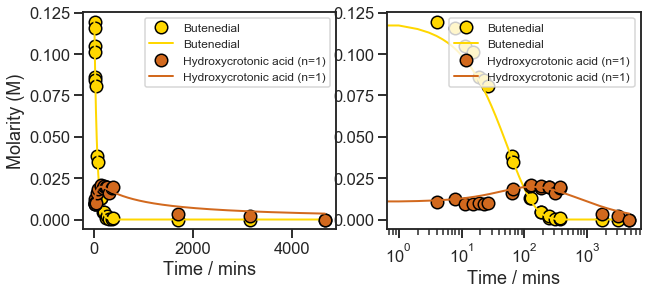

In [94]:
fig, ax = plt.subplots(1,2, figsize=(10,4))

ax[0].plot(df_processed.MINS_ELAPSED, df_processed.M_BUTENEDIAL, 
        '.', label='Butenedial',
        markersize=25, color='Gold', markeredgecolor='black', markeredgewidth=1.5)

ax[0].plot(df_modeled.MINS_ELAPSED, df_modeled.M_BUTENEDIAL, 
        label='Butenedial', lw=2, color='Gold')

ax[0].plot(df_processed.MINS_ELAPSED, df_processed.M_THCA_MONOMER, 
        '.', label='Hydroxycrotonic acid (n=1)',
        markersize=25, color='Chocolate', markeredgecolor='black', markeredgewidth=1.5)

ax[0].plot(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_MONOMER, 
        label='Hydroxycrotonic acid (n=1)', lw=2, color='Chocolate')

ax[0].set_xlabel('Time / mins')
ax[0].set_ylabel('Molarity (M)')
ax[0].legend(fontsize='large')


ax[1].semilogx(df_processed.MINS_ELAPSED, df_processed.M_BUTENEDIAL, 
        '.', label='Butenedial',
        markersize=25, color='Gold', markeredgecolor='black', markeredgewidth=1.5)

ax[1].semilogx(df_modeled.MINS_ELAPSED, df_modeled.M_BUTENEDIAL, 
        label='Butenedial', lw=2, color='Gold')

ax[1].semilogx(df_processed.MINS_ELAPSED, df_processed.M_THCA_MONOMER, 
        '.', label='Hydroxycrotonic acid (n=1)',
        markersize=25, color='Chocolate', markeredgecolor='black', markeredgewidth=1.5)

ax[1].semilogx(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_MONOMER, 
        label='Hydroxycrotonic acid (n=1)', lw=2, color='Chocolate')

ax[1].set_xlabel('Time / mins')
ax[1].legend(fontsize='large');

seems like the trend is captured decently if there is an alpha applied (so that not all the butenedial turns into the hydroxycrotonic acid) and some of it therefore becomes something else (what is that something else?). Not a big difference in the model when there is an additional source of HCA added or not added to the system.

$$ \frac{d[BD]}{dt} = - k_{1} [BD] $$ 
$$ \frac{d[HCA_{n=1}]}{dt} = (1 - \alpha) k_{1} [BD] - 2 k_{2} [HCA_{n=1}]^2 ( + k_{3}) $$ 

Try again, but keeping the source of PCA simple...

$$ \frac{d[BD]}{dt} = - k_{1} [BD] $$ 
$$ \frac{d[HCA_{n=1}]}{dt} = \alpha k_{1} [BD] - 2 k_{2} [HCA_{n=1}]^2 $$ 
$$ \frac{d[HCA_{n>1}]}{dt} = k_{2} [HCA_{n=1}]^2 $$

In [45]:
from src.d02_extraction.extract_least_sq_fit import *


def g(t, y0, coefs):
    """
    Solution to the ODE y'(t) = f(t,y,k) with initial condition y0
    """

    y = odeint(f, y0, t, args=(coefs,))

    return y


def f_residual(coefs, t, data):
    """
    compute the residual between actual data and fitted data
    """

    y0 = coefs['BD_0'].value, coefs['HCA_0'].value, coefs['PHCA_0'].value
    model = g(t, y0, coefs).T

    return (model - data).ravel()


def f(y, t, coefs):
    """
    Your system of differential equations
    """

    BD = y[0]
    HCA = y[1]
    PHCA = y[2]

    k1 = coefs['k1'].value
    k2 = coefs['k2'].value
    alpha = coefs['alpha'].value

    # the model equations
    dBDdt = - k1 * BD
    dHCAdt = (1 - alpha) * k1 * BD - 2 * k2 * HCA * HCA
    dPHCAdt = k2 * HCA * HCA

    return [dBDdt, dHCAdt, dPHCAdt]

In [46]:
BD_0 = df_processed.M_BUTENEDIAL[df_processed.MINS_ELAPSED == df_processed.MINS_ELAPSED.min()].values[0]
HCA_0 = df_processed.M_THCA_MONOMER[df_processed.MINS_ELAPSED == df_processed.MINS_ELAPSED.min()].values[0]
PHCA_0 = df_processed.M_THCA_NMER[df_processed.MINS_ELAPSED == df_processed.MINS_ELAPSED.min()].values[0]
X_0 = [BD_0, HCA_0, PHCA_0]

params = Parameters()
params.add('BD_0', value=BD_0, vary=False)
params.add('HCA_0', value=HCA_0, vary=False)
params.add('PHCA_0', value=PHCA_0, vary=False)
params.add('k1', value=0.001, min=0, max=10.)
params.add('k2', value=0.001, min=0, max=10.)
params.add('alpha', value=0.001, min=0, max=1.)

t_max = int(np.max(df_processed.MINS_ELAPSED) + 5)
ts = np.linspace(0, t_max, t_max + 1)
df_modeled = model_data_with_odes(g_function=g, residual_function=f_residual, params=params,
                                  experiments_dict=bd_decay_params, x_col_name='MINS_ELAPSED',
                                  y_col_names=['M_BUTENEDIAL', 'M_THCA_MONOMER', 'M_THCA_NMER'], ts=ts,
                                  vars_init=X_0, save_data=False)

df_modeled.head()

,MINS_ELAPSED,M_BUTENEDIAL,M_THCA_MONOMER,M_THCA_NMER
0,0.0,0.119431,0.010717,0.009999
1,1.0,0.117409,0.011746,0.010058
2,2.0,0.115422,0.012734,0.010129
3,3.0,0.113469,0.013679,0.010211
4,4.0,0.111548,0.014581,0.010306


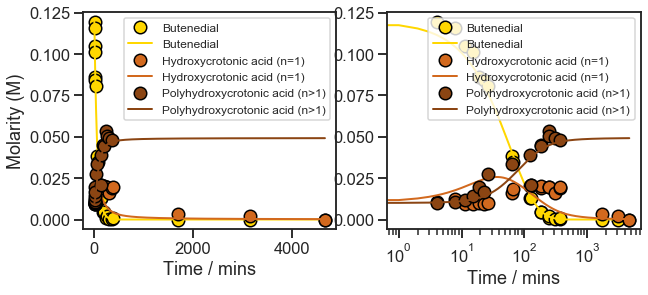

In [53]:
fig, ax = plt.subplots(1,2, figsize=(10,4))

ax[0].plot(df_processed.MINS_ELAPSED, df_processed.M_BUTENEDIAL, 
        '.', label='Butenedial',
        markersize=25, color='Gold', markeredgecolor='black', markeredgewidth=1.5)

ax[0].plot(df_modeled.MINS_ELAPSED, df_modeled.M_BUTENEDIAL, 
        label='Butenedial', lw=2, color='Gold')

ax[0].plot(df_processed.MINS_ELAPSED, df_processed.M_THCA_MONOMER, 
        '.', label='Hydroxycrotonic acid (n=1)',
        markersize=25, color='Chocolate', markeredgecolor='black', markeredgewidth=1.5)

ax[0].plot(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_MONOMER, 
        label='Hydroxycrotonic acid (n=1)', lw=2, color='Chocolate')

ax[0].plot(df_processed.MINS_ELAPSED, df_processed.M_THCA_NMER, 
        '.', label='Polyhydroxycrotonic acid (n>1)',
        markersize=25, color='SaddleBrown', markeredgecolor='black', markeredgewidth=1.5)

ax[0].plot(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_NMER, 
        label='Polyhydroxycrotonic acid (n>1)', lw=2, color='SaddleBrown')

ax[0].set_xlabel('Time / mins')
ax[0].set_ylabel('Molarity (M)')
ax[0].legend(fontsize='large')


ax[1].semilogx(df_processed.MINS_ELAPSED, df_processed.M_BUTENEDIAL, 
        '.', label='Butenedial',
        markersize=25, color='Gold', markeredgecolor='black', markeredgewidth=1.5)

ax[1].semilogx(df_modeled.MINS_ELAPSED, df_modeled.M_BUTENEDIAL, 
        label='Butenedial', lw=2, color='Gold')

ax[1].semilogx(df_processed.MINS_ELAPSED, df_processed.M_THCA_MONOMER, 
        '.', label='Hydroxycrotonic acid (n=1)',
        markersize=25, color='Chocolate', markeredgecolor='black', markeredgewidth=1.5)

ax[1].semilogx(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_MONOMER, 
        label='Hydroxycrotonic acid (n=1)', lw=2, color='Chocolate')

ax[1].semilogx(df_processed.MINS_ELAPSED, df_processed.M_THCA_NMER, 
        '.', label='Polyhydroxycrotonic acid (n>1)',
        markersize=25, color='SaddleBrown', markeredgecolor='black', markeredgewidth=1.5)

ax[1].semilogx(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_NMER, 
        label='Polyhydroxycrotonic acid (n>1)', lw=2, color='SaddleBrown')

ax[1].set_xlabel('Time / mins')
ax[1].legend(fontsize='large');

it looks close, except the hydroxycrotonic acid increases too rapidly, and the decays too rapidly, as if there is a sort of lag or something? i wonder if it makes sense to force an equilibrium between the polymer and the monomer.

seems again like the polyhydroxycrotonic acid cannot be accounted for by simply the source from hydroxycrotonic acid polymerization. Or maybe there's a fast equilibrium between polyhydroxycrotonic acid and monomer?

$$ \frac{d[BD]}{dt} = - k_{1} [BD] $$ 
$$ \frac{d[HCA_{n=1}]}{dt} = \alpha k_{1} [BD] - 2 k_{2} [HCA_{n=1}]^2 + 2 k_{3} [HCA_{n>1}] $$ 
$$ \frac{d[HCA_{n>1}]}{dt} = k_{2} [HCA_{n=1}]^2 - k_{3} [HCA_{n>1}] $$

In [125]:
from src.d02_extraction.extract_least_sq_fit import *


def g(t, y0, coefs):
    """
    Solution to the ODE y'(t) = f(t,y,k) with initial condition y0
    """

    y = odeint(f, y0, t, args=(coefs,))

    return y


def f_residual(coefs, t, data):
    """
    compute the residual between actual data and fitted data
    """

    y0 = coefs['BD_0'].value, coefs['HCA_0'].value, coefs['PHCA_0'].value
    model = g(t, y0, coefs).T

    return (model - data).ravel()


def f(y, t, coefs):
    """
    Your system of differential equations
    """

    BD = y[0]
    HCA = y[1]
    PHCA = y[2]

    k1 = coefs['k1'].value
    k2 = coefs['k2'].value
    k3 = coefs['k3'].value
    alpha = coefs['alpha'].value

    # the model equations
    dBDdt = - k1 * BD
    dHCAdt = alpha * k1 * BD - 2 * k2 * HCA * HCA + 2 * k3 * PHCA
    dPHCAdt = k2 * HCA * HCA - k3 * PHCA

    return [dBDdt, dHCAdt, dPHCAdt]

In [126]:
BD_0 = df_processed.M_BUTENEDIAL[df_processed.MINS_ELAPSED == df_processed.MINS_ELAPSED.min()].values[0]
HCA_0 = df_processed.M_THCA_MONOMER[df_processed.MINS_ELAPSED == df_processed.MINS_ELAPSED.min()].values[0]
PHCA_0 = df_processed.M_THCA_NMER[df_processed.MINS_ELAPSED == df_processed.MINS_ELAPSED.min()].values[0]
X_0 = [BD_0, HCA_0, PHCA_0]

params = Parameters()
params.add('BD_0', value=BD_0, vary=False)
params.add('HCA_0', value=HCA_0, vary=False)
params.add('PHCA_0', value=PHCA_0, vary=False)
params.add('k1', value=0.001, min=0, max=100.)
params.add('k2', value=0.001, min=0, max=100.)
params.add('k3', value=0.001, min=0, max=100.)
params.add('alpha', value=0.001, min=0, max=1.)

t_max = int(np.max(df_processed.MINS_ELAPSED) + 5)
ts = np.linspace(0, t_max, t_max + 1)
df_modeled = model_data_with_odes(g_function=g, residual_function=f_residual, params=params,
                                  experiments_dict=bd_decay_params, x_col_name='MINS_ELAPSED',
                                  y_col_names=['M_BUTENEDIAL', 'M_THCA_MONOMER', 'M_THCA_NMER'], ts=ts,
                                  vars_init=X_0, save_data=False)

df_modeled.head()

,MINS_ELAPSED,M_BUTENEDIAL,M_THCA_MONOMER,M_THCA_NMER
0,0.0,0.119431,0.010717,0.009999
1,1.0,0.117260,0.011067,0.010513
2,2.0,0.115129,0.011330,0.011057
3,3.0,0.113036,0.011531,0.011620
4,4.0,0.110982,0.011690,0.012193


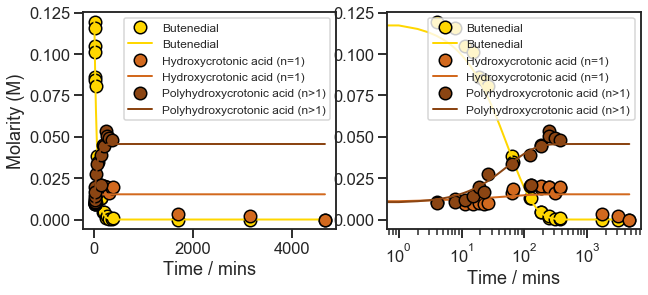

In [127]:
fig, ax = plt.subplots(1,2, figsize=(10,4))

ax[0].plot(df_processed.MINS_ELAPSED, df_processed.M_BUTENEDIAL, 
        '.', label='Butenedial',
        markersize=25, color='Gold', markeredgecolor='black', markeredgewidth=1.5)

ax[0].plot(df_modeled.MINS_ELAPSED, df_modeled.M_BUTENEDIAL, 
        label='Butenedial', lw=2, color='Gold')

ax[0].plot(df_processed.MINS_ELAPSED, df_processed.M_THCA_MONOMER, 
        '.', label='Hydroxycrotonic acid (n=1)',
        markersize=25, color='Chocolate', markeredgecolor='black', markeredgewidth=1.5)

ax[0].plot(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_MONOMER, 
        label='Hydroxycrotonic acid (n=1)', lw=2, color='Chocolate')

ax[0].plot(df_processed.MINS_ELAPSED, df_processed.M_THCA_NMER, 
        '.', label='Polyhydroxycrotonic acid (n>1)',
        markersize=25, color='SaddleBrown', markeredgecolor='black', markeredgewidth=1.5)

ax[0].plot(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_NMER, 
        label='Polyhydroxycrotonic acid (n>1)', lw=2, color='SaddleBrown')

ax[0].set_xlabel('Time / mins')
ax[0].set_ylabel('Molarity (M)')
ax[0].legend(fontsize='large')


ax[1].semilogx(df_processed.MINS_ELAPSED, df_processed.M_BUTENEDIAL, 
        '.', label='Butenedial',
        markersize=25, color='Gold', markeredgecolor='black', markeredgewidth=1.5)

ax[1].semilogx(df_modeled.MINS_ELAPSED, df_modeled.M_BUTENEDIAL, 
        label='Butenedial', lw=2, color='Gold')

ax[1].semilogx(df_processed.MINS_ELAPSED, df_processed.M_THCA_MONOMER, 
        '.', label='Hydroxycrotonic acid (n=1)',
        markersize=25, color='Chocolate', markeredgecolor='black', markeredgewidth=1.5)

ax[1].semilogx(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_MONOMER, 
        label='Hydroxycrotonic acid (n=1)', lw=2, color='Chocolate')

ax[1].semilogx(df_processed.MINS_ELAPSED, df_processed.M_THCA_NMER, 
        '.', label='Polyhydroxycrotonic acid (n>1)',
        markersize=25, color='SaddleBrown', markeredgecolor='black', markeredgewidth=1.5)

ax[1].semilogx(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_NMER, 
        label='Polyhydroxycrotonic acid (n>1)', lw=2, color='SaddleBrown')

ax[1].set_xlabel('Time / mins')
ax[1].legend(fontsize='large');

this time, the growth of hydroxycrotonic acid is captured well, but not its ultimate loss... try adding a sink term for the addition of HCA to PCA to form PCA (sink of HCA, no change in PCA).

$$ \frac{d[BD]}{dt} = - k_{1} [BD] $$ 
$$ \frac{d[HCA_{n=1}]}{dt} = \alpha k_{1} [BD] - 2 k_{2} [HCA_{n=1}]^2 + 2 k_{3} [HCA_{n>1}] - k_4 [HCA_{n=1}][HCA_{n>1}] $$ 
$$ \frac{d[HCA_{n>1}]}{dt} = k_{2} [HCA_{n=1}]^2 - k_{3} [HCA_{n>1}] $$

In [132]:
from src.d02_extraction.extract_least_sq_fit import *


def g(t, y0, coefs):
    """
    Solution to the ODE y'(t) = f(t,y,k) with initial condition y0
    """

    y = odeint(f, y0, t, args=(coefs,))

    return y


def f_residual(coefs, t, data):
    """
    compute the residual between actual data and fitted data
    """

    y0 = coefs['BD_0'].value, coefs['HCA_0'].value, coefs['PHCA_0'].value
    model = g(t, y0, coefs).T

    return (model - data).ravel()


def f(y, t, coefs):
    """
    Your system of differential equations
    """

    BD = y[0]
    HCA = y[1]
    PHCA = y[2]

    k1 = coefs['k1'].value
    k2 = coefs['k2'].value
    k3 = coefs['k3'].value
    k4 = coefs['k4'].value
    alpha = coefs['alpha'].value

    # the model equations
    dBDdt = - k1 * BD
    dHCAdt = alpha * k1 * BD - 2 * k2 * HCA * HCA + 2 * k3 * PHCA - k4 * HCA * PHCA
    dPHCAdt = k2 * HCA * HCA - k3 * PHCA
    
    print(alpha, k1, k2, k3, k4)

    return [dBDdt, dHCAdt, dPHCAdt]

In [133]:
BD_0 = df_processed.M_BUTENEDIAL[df_processed.MINS_ELAPSED == df_processed.MINS_ELAPSED.min()].values[0]
HCA_0 = df_processed.M_THCA_MONOMER[df_processed.MINS_ELAPSED == df_processed.MINS_ELAPSED.min()].values[0]
PHCA_0 = df_processed.M_THCA_NMER[df_processed.MINS_ELAPSED == df_processed.MINS_ELAPSED.min()].values[0]
X_0 = [BD_0, HCA_0, PHCA_0]

params = Parameters()
params.add('BD_0', value=BD_0, vary=False)
params.add('HCA_0', value=HCA_0, vary=False)
params.add('PHCA_0', value=PHCA_0, vary=False)
params.add('k1', value=0.001, min=0, max=100.)
params.add('k2', value=0.001, min=0, max=100.)
params.add('k3', value=0.001, min=0, max=100.)
params.add('k4', value=0.001, min=0, max=100.)
params.add('alpha', value=0.001, min=0, max=1.)

t_max = int(np.max(df_processed.MINS_ELAPSED) + 5)
ts = np.linspace(0, t_max, t_max + 1)
df_modeled = model_data_with_odes(g_function=g, residual_function=f_residual, params=params,
                                  experiments_dict=bd_decay_params, x_col_name='MINS_ELAPSED',
                                  y_col_names=['M_BUTENEDIAL', 'M_THCA_MONOMER', 'M_THCA_NMER'], ts=ts,
                                  vars_init=X_0, save_data=False)

df_modeled.head()

0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.

0.001000000710022042 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.001000000710022042 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.001000000710022042 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.001000000710022042 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.001000000710022042 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.001000000710022042 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.001000000710022042 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.001000000710022042 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.001000000710022042 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.001000000710022042 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.001000000710022042 0.001000000000001 0.001000000000001 0.00100000000

0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0

0.9813362711270106 0.006479457314251258 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479457314251258 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479457314251258 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479457314251258 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479457314251258 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479457314251258 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479457314251258 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479457314251258 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479457314251258 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479457314251258 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0

0.9813362711270106 0.006479438666739945 20.798197847350863 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197847350863 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197847350863 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197847350863 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197847350863 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197847350863 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197847350863 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197847350863 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197847350863 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197847350863 0.037241520234804204 99.85970894407845
0.9813362711270106 0

0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438

0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970921108522
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970921108522
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970921108522
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970921108522
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970921108522
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970921108522
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970921108522
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970921108522
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970921108522
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970921108522
0.9813362711270106 0

0.9813361533680914 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813361533680914 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813361533680914 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813361533680914 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813361533680914 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813361533680914 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813361533680914 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813361533680914 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813361533680914 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813361533680914 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813361533680914 0

0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589600406923035


0.04252743927837749 0.013053938214130367 10.797569197222973 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053938214130367 10.797569197222973 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053938214130367 10.797569197222973 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053938214130367 10.797569197222973 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053938214130367 10.797569197222973 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053938214130367 10.797569197222973 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053938214130367 10.797569197222973 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053938214130367 10.797569197222973 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053938214130367 10.797569197222973 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053938214130367 10.797569197222973 0.05397167559685334 0.18589600406923035


0.04252743927837749 0.013053911861865553 10.797569613971692 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569613971692 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569613971692 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569613971692 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569613971692 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569613971692 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569613971692 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569613971692 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569613971692 0.05397167559685334 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569613971692 0.05397167559685334 0.18589600406923035


0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397172835195918 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397172835195918 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397172835195918 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397172835195918 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397172835195918 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397172835195918 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397172835195918 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397172835195918 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397172835195918 0.18589600406923035
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397172835195918 0.18589600406923035


0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589468780157437
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589468780157437
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589468780157437
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589468780157437
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589468780157437
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589468780157437
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589468780157437
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589468780157437
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589468780157437
0.04252743927837749 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589468780157437


0.042527605840217364 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589600406923035
0.042527605840217364 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589600406923035
0.042527605840217364 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589600406923035
0.042527605840217364 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589600406923035
0.042527605840217364 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589600406923035
0.042527605840217364 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589600406923035
0.042527605840217364 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589600406923035
0.042527605840217364 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589600406923035
0.042527605840217364 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589600406923035
0.042527605840217364 0.013053911861865553 10.797569197222973 0.05397167559685334 0.18589600

0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155


0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155


0.9983019306334991 0.017803003467925516 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017803003467925516 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017803003467925516 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017803003467925516 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017803003467925516 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017803003467925516 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017803003467925516 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017803003467925516 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017803003467925516 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017803003467925516 2.3651543509401796 0.016192938294773418 0.44949646325199155


0.9983019306334991 0.017802972770208925 2.3651539253237375 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651539253237375 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651539253237375 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651539253237375 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651539253237375 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651539253237375 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651539253237375 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651539253237375 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651539253237375 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651539253237375 0.016192938294773418 0.44949646325199155


0.9983019306334991 0.017802972770208925 2.3651539253237375 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651539253237375 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651539253237375 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651539253237375 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651539253237375 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651539253237375 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651539253237375 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651539253237375 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651539253237375 0.016192938294773418 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651539253237375 0.016192938294773418 0.44949646325199155


0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192908029277753 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192908029277753 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192908029277753 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192908029277753 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192908029277753 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192908029277753 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192908029277753 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192908029277753 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192908029277753 0.44949646325199155
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192908029277753 0.44949646325199155


0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949848536475767
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949848536475767
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949848536475767
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949848536475767
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949848536475767
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949848536475767
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949848536475767
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949848536475767
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949848536475767
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949848536475767


0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949848536475767
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949848536475767
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949848536475767
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949848536475767
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949848536475767
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949848536475767
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949848536475767
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949848536475767
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949848536475767
0.9983019306334991 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949848536475767


0.9983019662401933 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019662401933 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019662401933 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019662401933 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019662401933 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019662401933 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019662401933 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019662401933 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019662401933 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155
0.9983019662401933 0.017802972770208925 2.3651543509401796 0.016192938294773418 0.44949646325199155


0.9934131654184397 0.018807370536638723 5.254672483146116 0.035959791300071986 0.00251653277824615
0.9934131654184397 0.018807370536638723 5.254672483146116 0.035959791300071986 0.00251653277824615
0.9934131654184397 0.018807370536638723 5.254672483146116 0.035959791300071986 0.00251653277824615
0.9934131654184397 0.018807370536638723 5.254672483146116 0.035959791300071986 0.00251653277824615
0.9934131654184397 0.018807370536638723 5.254672483146116 0.035959791300071986 0.00251653277824615
0.9934131654184397 0.018807370536638723 5.254672483146116 0.035959791300071986 0.00251653277824615
0.9934131654184397 0.018807370536638723 5.254672483146116 0.035959791300071986 0.00251653277824615
0.9934131654184397 0.018807370536638723 5.254672483146116 0.035959791300071986 0.00251653277824615
0.9934131654184397 0.018807370536638723 5.254672483146116 0.035959791300071986 0.00251653277824615
0.9934131654184397 0.018807370536638723 5.254672483146116 0.035959791300071986 0.00251653277824615
0.99341316

0.9550159219330101 0.018240558008508767 5.283916405098582 0.03665503610039145 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283916405098582 0.03665503610039145 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283916405098582 0.03665503610039145 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283916405098582 0.03665503610039145 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283916405098582 0.03665503610039145 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283916405098582 0.03665503610039145 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283916405098582 0.03665503610039145 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283916405098582 0.03665503610039145 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283916405098582 0.03665503610039145 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283916405098582 0.03665503610039145 0.028973429176631926
0.95501592

0.9550159219330101 0.018240558008508767 5.283915726823263 0.03665503610039145 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283915726823263 0.03665503610039145 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283915726823263 0.03665503610039145 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283915726823263 0.03665503610039145 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283915726823263 0.03665503610039145 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283915726823263 0.03665503610039145 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283915726823263 0.03665503610039145 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283915726823263 0.03665503610039145 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283915726823263 0.03665503610039145 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283915726823263 0.03665503610039145 0.028973429176631926
0.95501592

0.9550159219330101 0.018240558008508767 5.283916405098582 0.036654990203055515 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283916405098582 0.036654990203055515 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283916405098582 0.036654990203055515 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283916405098582 0.036654990203055515 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283916405098582 0.036654990203055515 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283916405098582 0.036654990203055515 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283916405098582 0.036654990203055515 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283916405098582 0.036654990203055515 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283916405098582 0.036654990203055515 0.028973429176631926
0.9550159219330101 0.018240558008508767 5.283916405098582 0.036654990203055515 0.028973429176631926


0.9550160613058207 0.018240558008508767 5.283916405098582 0.03665503610039145 0.028973429176631926
0.9550160613058207 0.018240558008508767 5.283916405098582 0.03665503610039145 0.028973429176631926
0.9550160613058207 0.018240558008508767 5.283916405098582 0.03665503610039145 0.028973429176631926
0.9550160613058207 0.018240558008508767 5.283916405098582 0.03665503610039145 0.028973429176631926
0.9550160613058207 0.018240558008508767 5.283916405098582 0.03665503610039145 0.028973429176631926
0.9550160613058207 0.018240558008508767 5.283916405098582 0.03665503610039145 0.028973429176631926
0.9550160613058207 0.018240558008508767 5.283916405098582 0.03665503610039145 0.028973429176631926
0.9550160613058207 0.018240558008508767 5.283916405098582 0.03665503610039145 0.028973429176631926
0.9550160613058207 0.018240558008508767 5.283916405098582 0.03665503610039145 0.028973429176631926
0.9550160613058207 0.018240558008508767 5.283916405098582 0.03665503610039145 0.028973429176631926
0.95501606

0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599580112889083
0.59610149

0.5961014971136638 0.01776827528296998 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961014971136638 0.01776827528296998 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961014971136638 0.01776827528296998 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961014971136638 0.01776827528296998 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961014971136638 0.01776827528296998 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961014971136638 0.01776827528296998 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961014971136638 0.01776827528296998 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961014971136638 0.01776827528296998 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961014971136638 0.01776827528296998 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961014971136638 0.01776827528296998 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961014971136638 0

0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958720867288234 0.08599580112889083
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958720867288234 0.08599580112889083
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958720867288234 0.08599580112889083
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958720867288234 0.08599580112889083
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958720867288234 0.08599580112889083
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958720867288234 0.08599580112889083
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958720867288234 0.08599580112889083
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958720867288234 0.08599580112889083
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958720867288234 0.08599580112889083
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958720867288234 0.08599580112889083
0.59610149

0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599669050803893
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599669050803893
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599669050803893
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599669050803893
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599669050803893
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599669050803893
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599669050803893
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599669050803893
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599669050803893
0.5961014971136638 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599669050803893
0.59610149

0.5961018201116297 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961018201116297 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961018201116297 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961018201116297 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961018201116297 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961018201116297 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961018201116297 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961018201116297 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961018201116297 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599580112889083
0.5961018201116297 0.017768244614685402 4.375419617068543 0.027958760832991203 0.08599580112889083
0.59610182

0.6413535431677453 0.01831754905758931 5.86304560694591 0.03789656365935645 0.011403683409910714
0.6413535431677453 0.01831754905758931 5.86304560694591 0.03789656365935645 0.011403683409910714
0.6413535431677453 0.01831754905758931 5.86304560694591 0.03789656365935645 0.011403683409910714
0.6413535431677453 0.01831754905758931 5.86304560694591 0.03789656365935645 0.011403683409910714
0.6413535431677453 0.01831754905758931 5.86304560694591 0.03789656365935645 0.011403683409910714
0.6413535431677453 0.01831754905758931 5.86304560694591 0.03789656365935645 0.011403683409910714
0.6413535431677453 0.01831754905758931 5.86304560694591 0.03789656365935645 0.011403683409910714
0.6413535431677453 0.01831754905758931 5.86304560694591 0.03789656365935645 0.011403683409910714
0.6413535431677453 0.01831754905758931 5.86304560694591 0.03789656365935645 0.011403683409910714
0.6413535431677453 0.01831754905758931 5.86304560694591 0.03789656365935645 0.011403683409910714
0.6413535431677453 0.018317549

0.6413535431677453 0.018317517927213256 5.863044885813867 0.03789656365935645 0.011403683409910714
0.6413535431677453 0.018317517927213256 5.863044885813867 0.03789656365935645 0.011403683409910714
0.6413535431677453 0.018317517927213256 5.863044885813867 0.03789656365935645 0.011403683409910714
0.6413535431677453 0.018317517927213256 5.863044885813867 0.03789656365935645 0.011403683409910714
0.6413535431677453 0.018317517927213256 5.863044885813867 0.03789656365935645 0.011403683409910714
0.6413535431677453 0.018317517927213256 5.863044885813867 0.03789656365935645 0.011403683409910714
0.6413535431677453 0.018317517927213256 5.863044885813867 0.03789656365935645 0.011403683409910714
0.6413535431677453 0.018317517927213256 5.863044885813867 0.03789656365935645 0.011403683409910714
0.6413535431677453 0.018317517927213256 5.863044885813867 0.03789656365935645 0.011403683409910714
0.6413535431677453 0.018317517927213256 5.863044885813867 0.03789656365935645 0.011403683409910714
0.64135354

0.6413535431677453 0.018317517927213256 5.86304560694591 0.03789651697284624 0.011403683409910714
0.6413535431677453 0.018317517927213256 5.86304560694591 0.03789651697284624 0.011403683409910714
0.6413535431677453 0.018317517927213256 5.86304560694591 0.03789651697284624 0.011403683409910714
0.6413535431677453 0.018317517927213256 5.86304560694591 0.03789651697284624 0.011403683409910714
0.6413535431677453 0.018317517927213256 5.86304560694591 0.03789651697284624 0.011403683409910714
0.6413535431677453 0.018317517927213256 5.86304560694591 0.03789651697284624 0.011403683409910714
0.6413535431677453 0.018317517927213256 5.86304560694591 0.03789651697284624 0.011403683409910714
0.6413535431677453 0.018317517927213256 5.86304560694591 0.03789651697284624 0.011403683409910714
0.6413535431677453 0.018317517927213256 5.86304560694591 0.03789651697284624 0.011403683409910714
0.6413535431677453 0.018317517927213256 5.86304560694591 0.03789651697284624 0.011403683409910714
0.6413535431677453 0

0.6413535431677453 0.018317517927213256 5.86304560694591 0.03789656365935645 0.011404007995902132
0.6413535431677453 0.018317517927213256 5.86304560694591 0.03789656365935645 0.011404007995902132
0.6413535431677453 0.018317517927213256 5.86304560694591 0.03789656365935645 0.011404007995902132
0.6413535431677453 0.018317517927213256 5.86304560694591 0.03789656365935645 0.011404007995902132
0.6413535431677453 0.018317517927213256 5.86304560694591 0.03789656365935645 0.011404007995902132
0.6413535431677453 0.018317517927213256 5.86304560694591 0.03789656365935645 0.011404007995902132
0.6413535431677453 0.018317517927213256 5.86304560694591 0.03789656365935645 0.011404007995902132
0.6413535431677453 0.018317517927213256 5.86304560694591 0.03789656365935645 0.011404007995902132
0.6413535431677453 0.018317517927213256 5.86304560694591 0.03789656365935645 0.011404007995902132
0.6413535431677453 0.018317517927213256 5.86304560694591 0.03789656365935645 0.011404007995902132
0.6413535431677453 0

0.6413538595418605 0.018317517927213256 5.86304560694591 0.03789656365935645 0.011403683409910714
0.6413538595418605 0.018317517927213256 5.86304560694591 0.03789656365935645 0.011403683409910714
0.6413538595418605 0.018317517927213256 5.86304560694591 0.03789656365935645 0.011403683409910714
0.6413538595418605 0.018317517927213256 5.86304560694591 0.03789656365935645 0.011403683409910714
0.6413538595418605 0.018317517927213256 5.86304560694591 0.03789656365935645 0.011403683409910714
0.6413538595418605 0.018317517927213256 5.86304560694591 0.03789656365935645 0.011403683409910714
0.6413538595418605 0.018317517927213256 5.86304560694591 0.03789656365935645 0.011403683409910714
0.6413538595418605 0.018317517927213256 5.86304560694591 0.03789656365935645 0.011403683409910714
0.6413538595418605 0.018317517927213256 5.86304560694591 0.03789656365935645 0.011403683409910714
0.6413538595418605 0.018317517927213256 5.86304560694591 0.03789656365935645 0.011403683409910714
0.6413538595418605 0

0.7231099459289072 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148047

0.7231099459289072 0.018148078107077525 9.778145532404492 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148078107077525 9.778145532404492 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148078107077525 9.778145532404492 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148078107077525 9.778145532404492 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148078107077525 9.778145532404492 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148078107077525 9.778145532404492 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148078107077525 9.778145532404492 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148078107077525 9.778145532404492 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148078107077525 9.778145532404492 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148078107077525 9.778145532404492 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148078

0.7231099459289072 0.018148047118499155 9.778144555662022 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778144555662022 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778144555662022 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778144555662022 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778144555662022 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778144555662022 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778144555662022 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778144555662022 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778144555662022 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778144555662022 0.0661245781883868 0.13925170142312648
0.7231099459289072 0.018148047

0.7231099459289072 0.018148047118499155 9.778145532404492 0.06612451604847691 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778145532404492 0.06612451604847691 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778145532404492 0.06612451604847691 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778145532404492 0.06612451604847691 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778145532404492 0.06612451604847691 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778145532404492 0.06612451604847691 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778145532404492 0.06612451604847691 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778145532404492 0.06612451604847691 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778145532404492 0.06612451604847691 0.13925170142312648
0.7231099459289072 0.018148047118499155 9.778145532404492 0.06612451604847691 0.13925170142312648
0.7231099459289072 0

0.7231099459289072 0.018148047118499155 9.778145532404492 0.0661245781883868 0.1392528319771824
0.7231099459289072 0.018148047118499155 9.778145532404492 0.0661245781883868 0.1392528319771824
0.7231099459289072 0.018148047118499155 9.778145532404492 0.0661245781883868 0.1392528319771824
0.7231099459289072 0.018148047118499155 9.778145532404492 0.0661245781883868 0.1392528319771824
0.7231099459289072 0.018148047118499155 9.778145532404492 0.0661245781883868 0.1392528319771824
0.7231099459289072 0.018148047118499155 9.778145532404492 0.0661245781883868 0.1392528319771824
0.7231099459289072 0.018148047118499155 9.778145532404492 0.0661245781883868 0.1392528319771824
0.7231099459289072 0.018148047118499155 9.778145532404492 0.0661245781883868 0.1392528319771824
0.7231099459289072 0.018148047118499155 9.778145532404492 0.0661245781883868 0.1392528319771824
0.7231099459289072 0.018148047118499155 9.778145532404492 0.0661245781883868 0.1392528319771824
0.7231099459289072 0.018148047118499155 

0.723110242273616 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.723110242273616 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.723110242273616 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.723110242273616 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.723110242273616 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.723110242273616 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.723110242273616 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.723110242273616 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.723110242273616 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.723110242273616 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.723110242273616 0.018148047118499155 9

0.723110242273616 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.723110242273616 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.723110242273616 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.723110242273616 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.723110242273616 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.723110242273616 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.723110242273616 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.723110242273616 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.723110242273616 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.723110242273616 0.018148047118499155 9.778145532404492 0.0661245781883868 0.13925170142312648
0.723110242273616 0.018148047118499155 9

0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723236635231045 0.02402329176275364
0.62516666

0.6251666683807083 0.01868955999324573 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.01868955999324573 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.01868955999324573 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.01868955999324573 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.01868955999324573 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.01868955999324573 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.01868955999324573 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.01868955999324573 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.01868955999324573 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.01868955999324573 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251666683807083 0

0.6251666683807083 0.018689528553977874 9.230816904277583 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230816904277583 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230816904277583 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230816904277583 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230816904277583 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230816904277583 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230816904277583 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230816904277583 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230816904277583 0.056723236635231045 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230816904277583 0.056723236635231045 0.02402329176275364
0.62516666

0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723179214018815 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723179214018815 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723179214018815 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723179214018815 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723179214018815 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723179214018815 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723179214018815 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723179214018815 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723179214018815 0.02402329176275364
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723179214018815 0.02402329176275364
0.62516666

0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723236635231045 0.024023762620534184
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723236635231045 0.024023762620534184
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723236635231045 0.024023762620534184
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723236635231045 0.024023762620534184
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723236635231045 0.024023762620534184
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723236635231045 0.024023762620534184
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723236635231045 0.024023762620534184
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723236635231045 0.024023762620534184
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723236635231045 0.024023762620534184
0.6251666683807083 0.018689528553977874 9.230817848113782 0.056723236635231045 0.024023762620534184


0.6251669874656234 0.018689528553977874 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251669874656234 0.018689528553977874 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251669874656234 0.018689528553977874 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251669874656234 0.018689528553977874 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251669874656234 0.018689528553977874 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251669874656234 0.018689528553977874 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251669874656234 0.018689528553977874 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251669874656234 0.018689528553977874 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251669874656234 0.018689528553977874 9.230817848113782 0.056723236635231045 0.02402329176275364
0.6251669874656234 0.018689528553977874 9.230817848113782 0.056723236635231045 0.02402329176275364
0.62516698

0.7000350395244663 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000350395244663 0

0.7000350395244663 0.018387138285380633 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387138285380633 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387138285380633 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387138285380633 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387138285380633 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387138285380633 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387138285380633 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387138285380633 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387138285380633 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387138285380633 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000350395244663 0

0.7000350395244663 0.018387107096978772 10.127593048550304 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387107096978772 10.127593048550304 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387107096978772 10.127593048550304 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387107096978772 10.127593048550304 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387107096978772 10.127593048550304 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387107096978772 10.127593048550304 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387107096978772 10.127593048550304 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387107096978772 10.127593048550304 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387107096978772 10.127593048550304 0.0638412946088518 0.06421454877626465
0.7000350395244663 0.018387107096978772 10.127593048550304 0.0638412946088518 0.06421454877626465
0.7000350395244663 0

0.7000350395244663 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421531769871813
0.7000350395244663 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421531769871813
0.7000350395244663 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421531769871813
0.7000350395244663 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421531769871813
0.7000350395244663 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421531769871813
0.7000350395244663 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421531769871813
0.7000350395244663 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421531769871813
0.7000350395244663 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421531769871813
0.7000350395244663 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421531769871813
0.7000350395244663 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421531769871813
0.7000350395244663 0

0.7000353426610892 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000353426610892 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000353426610892 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000353426610892 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000353426610892 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000353426610892 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000353426610892 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000353426610892 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000353426610892 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000353426610892 0.018387107096978772 10.127594045913673 0.0638412946088518 0.06421454877626465
0.7000353426610892 0

0.7087422183191752 0.018140034626834556 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095288781079875 0.0613628099589536 0.061051418563873305
0.70874221

0.7087422183191752 0.018140065608690525 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140065608690525 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140065608690525 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140065608690525 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140065608690525 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140065608690525 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140065608690525 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140065608690525 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140065608690525 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140065608690525 10.095288781079875 0.0613628099589536 0.061051418563873305
0.70874221

0.7087422183191752 0.018140034626834556 10.095287785610568 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095287785610568 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095287785610568 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095287785610568 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095287785610568 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095287785610568 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095287785610568 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095287785610568 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095287785610568 0.0613628099589536 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095287785610568 0.0613628099589536 0.061051418563873305
0.70874221

0.7087422183191752 0.018140034626834556 10.095288781079875 0.06136275016645487 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095288781079875 0.06136275016645487 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095288781079875 0.06136275016645487 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095288781079875 0.06136275016645487 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095288781079875 0.06136275016645487 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095288781079875 0.06136275016645487 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095288781079875 0.06136275016645487 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095288781079875 0.06136275016645487 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095288781079875 0.06136275016645487 0.061051418563873305
0.7087422183191752 0.018140034626834556 10.095288781079875 0.06136275016645487 0.061051418563873305


0.7087422183191752 0.018140034626834556 10.095288781079875 0.0613628099589536 0.06105216836755911
0.7087422183191752 0.018140034626834556 10.095288781079875 0.0613628099589536 0.06105216836755911
0.7087422183191752 0.018140034626834556 10.095288781079875 0.0613628099589536 0.06105216836755911
0.7087422183191752 0.018140034626834556 10.095288781079875 0.0613628099589536 0.06105216836755911
0.7087422183191752 0.018140034626834556 10.095288781079875 0.0613628099589536 0.06105216836755911
0.7087422183191752 0.018140034626834556 10.095288781079875 0.0613628099589536 0.06105216836755911
0.7087422183191752 0.018140034626834556 10.095288781079875 0.0613628099589536 0.06105216836755911
0.7087422183191752 0.018140034626834556 10.095288781079875 0.0613628099589536 0.06105216836755911
0.7087422183191752 0.018140034626834556 10.095288781079875 0.0613628099589536 0.06105216836755911
0.7087422183191752 0.018140034626834556 10.095288781079875 0.0613628099589536 0.06105216836755911
0.7087422183191752 0

0.7087425190048982 0.018140034626834556 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087425190048982 0.018140034626834556 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087425190048982 0.018140034626834556 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087425190048982 0.018140034626834556 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087425190048982 0.018140034626834556 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087425190048982 0.018140034626834556 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087425190048982 0.018140034626834556 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087425190048982 0.018140034626834556 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087425190048982 0.018140034626834556 10.095288781079875 0.0613628099589536 0.061051418563873305
0.7087425190048982 0.018140034626834556 10.095288781079875 0.0613628099589536 0.061051418563873305
0.70874251

0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.018117029

0.7190324033061924 0.01811706029031801 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811706029031801 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811706029031801 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811706029031801 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811706029031801 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811706029031801 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811706029031801 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811706029031801 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811706029031801 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811706029031801 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.018117060

0.7190324033061924 0.01811702932776882 10.030433964296364 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030433964296364 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030433964296364 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030433964296364 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030433964296364 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030433964296364 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030433964296364 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030433964296364 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030433964296364 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030433964296364 0.06953418146752322 0.0603944324724881
0.7190324033061924 0.018117029

0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953411769531903 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953411769531903 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953411769531903 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953411769531903 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953411769531903 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953411769531903 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953411769531903 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953411769531903 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953411769531903 0.0603944324724881
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953411769531903 0.0603944324724881
0.7190324033061924 0.018117029

0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953418146752322 0.06039517824309448
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953418146752322 0.06039517824309448
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953418146752322 0.06039517824309448
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953418146752322 0.06039517824309448
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953418146752322 0.06039517824309448
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953418146752322 0.06039517824309448
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953418146752322 0.06039517824309448
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953418146752322 0.06039517824309448
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953418146752322 0.06039517824309448
0.7190324033061924 0.01811702932776882 10.030434955955808 0.06953418146752322 0.06039517824309448
0.7190324033061924 0

0.7190327009212003 0.01811702932776882 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190327009212003 0.01811702932776882 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190327009212003 0.01811702932776882 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190327009212003 0.01811702932776882 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190327009212003 0.01811702932776882 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190327009212003 0.01811702932776882 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190327009212003 0.01811702932776882 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190327009212003 0.01811702932776882 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190327009212003 0.01811702932776882 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190327009212003 0.01811702932776882 10.030434955955808 0.06953418146752322 0.0603944324724881
0.7190327009212003 0.018117029

0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200560906702876 0

0.7200560906702876 0.01801114166738449 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.01801114166738449 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.01801114166738449 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.01801114166738449 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.01801114166738449 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.01801114166738449 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.01801114166738449 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.01801114166738449 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.01801114166738449 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.01801114166738449 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.018011141

0.7200560906702876 0.018011110793880736 10.054710710166525 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054710710166525 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054710710166525 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054710710166525 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054710710166525 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054710710166525 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054710710166525 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054710710166525 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054710710166525 0.06651088663884308 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054710710166525 0.06651088663884308 0.0685841214379701
0.7200560906702876 0

0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651082431203825 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651082431203825 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651082431203825 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651082431203825 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651082431203825 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651082431203825 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651082431203825 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651082431203825 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651082431203825 0.0685841214379701
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651082431203825 0.0685841214379701
0.7200560906702876 0

0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651088663884308 0.06858491600749694
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651088663884308 0.06858491600749694
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651088663884308 0.06858491600749694
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651088663884308 0.06858491600749694
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651088663884308 0.06858491600749694
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651088663884308 0.06858491600749694
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651088663884308 0.06858491600749694
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651088663884308 0.06858491600749694
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651088663884308 0.06858491600749694
0.7200560906702876 0.018011110793880736 10.054711703253288 0.06651088663884308 0.06858491600749694
0.72005609

0.7200563879692716 0.018011110793880736 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200563879692716 0.018011110793880736 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200563879692716 0.018011110793880736 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200563879692716 0.018011110793880736 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200563879692716 0.018011110793880736 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200563879692716 0.018011110793880736 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200563879692716 0.018011110793880736 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200563879692716 0.018011110793880736 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200563879692716 0.018011110793880736 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200563879692716 0.018011110793880736 10.054711703253288 0.06651088663884308 0.0685841214379701
0.7200563879692716 0

0.7305805869820332 0.018224043497711007 10.134435129028896 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134435129028896 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134435129028896 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134435129028896 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134435129028896 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134435129028896 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134435129028896 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134435129028896 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134435129028896 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134435129028896 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224043

0.7305805869820332 0.018224074549960667 10.134435129028896 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224074549960667 10.134435129028896 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224074549960667 10.134435129028896 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224074549960667 10.134435129028896 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224074549960667 10.134435129028896 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224074549960667 10.134435129028896 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224074549960667 10.134435129028896 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224074549960667 10.134435129028896 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224074549960667 10.134435129028896 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224074549960667 10.134435129028896 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224074

0.7305805869820332 0.018224043497711007 10.134434131264737 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134434131264737 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134434131264737 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134434131264737 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134434131264737 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134434131264737 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134434131264737 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134434131264737 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134434131264737 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134434131264737 0.0673198583188983 0.0703766079981516
0.7305805869820332 0.018224043

0.7305805869820332 0.018224043497711007 10.134435129028896 0.06731979560235524 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134435129028896 0.06731979560235524 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134435129028896 0.06731979560235524 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134435129028896 0.06731979560235524 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134435129028896 0.06731979560235524 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134435129028896 0.06731979560235524 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134435129028896 0.06731979560235524 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134435129028896 0.06731979560235524 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134435129028896 0.06731979560235524 0.0703766079981516
0.7305805869820332 0.018224043497711007 10.134435129028896 0.06731979560235524 0.0703766079981516
0.7305805869820332 0

0.7305805869820332 0.018224043497711007 10.134435129028896 0.0673198583188983 0.07037741284985355
0.7305805869820332 0.018224043497711007 10.134435129028896 0.0673198583188983 0.07037741284985355
0.7305805869820332 0.018224043497711007 10.134435129028896 0.0673198583188983 0.07037741284985355
0.7305805869820332 0.018224043497711007 10.134435129028896 0.0673198583188983 0.07037741284985355
0.7305805869820332 0.018224043497711007 10.134435129028896 0.0673198583188983 0.07037741284985355
0.7305805869820332 0.018224043497711007 10.134435129028896 0.0673198583188983 0.07037741284985355
0.7305805869820332 0.018224043497711007 10.134435129028896 0.0673198583188983 0.07037741284985355
0.7305805869820332 0.018224043497711007 10.134435129028896 0.0673198583188983 0.07037741284985355
0.7305805869820332 0.018224043497711007 10.134435129028896 0.0673198583188983 0.07037741284985355
0.7305805869820332 0.018224043497711007 10.134435129028896 0.0673198583188983 0.07037741284985355
0.7305805869820332 0

0.730580880918612 0.018224043497711007 10.134435129028896 0.0673198583188983 0.0703766079981516
0.730580880918612 0.018224043497711007 10.134435129028896 0.0673198583188983 0.0703766079981516
0.730580880918612 0.018224043497711007 10.134435129028896 0.0673198583188983 0.0703766079981516
0.730580880918612 0.018224043497711007 10.134435129028896 0.0673198583188983 0.0703766079981516
0.730580880918612 0.018224043497711007 10.134435129028896 0.0673198583188983 0.0703766079981516
0.730580880918612 0.018224043497711007 10.134435129028896 0.0673198583188983 0.0703766079981516
0.730580880918612 0.018224043497711007 10.134435129028896 0.0673198583188983 0.0703766079981516
0.730580880918612 0.018224043497711007 10.134435129028896 0.0673198583188983 0.0703766079981516
0.730580880918612 0.018224043497711007 10.134435129028896 0.0673198583188983 0.0703766079981516
0.730580880918612 0.018224043497711007 10.134435129028896 0.0673198583188983 0.0703766079981516
0.730580880918612 0.018224043497711007 1

0.7360074666532166 0.018158922479005746 10.166232095424999 0.0680338656542323 0.07317024197711075
0.7360074666532166 0.018158922479005746 10.166232095424999 0.0680338656542323 0.07317024197711075
0.7360074666532166 0.018158922479005746 10.166232095424999 0.0680338656542323 0.07317024197711075
0.7360074666532166 0.018158922479005746 10.166232095424999 0.0680338656542323 0.07317024197711075
0.7360074666532166 0.018158922479005746 10.166232095424999 0.0680338656542323 0.07317024197711075
0.7360074666532166 0.018158922479005746 10.166232095424999 0.0680338656542323 0.07317024197711075
0.7360074666532166 0.018158922479005746 10.166232095424999 0.0680338656542323 0.07317024197711075
0.7360074666532166 0.018158922479005746 10.166232095424999 0.0680338656542323 0.07317024197711075
0.7360074666532166 0.018158922479005746 10.166232095424999 0.0680338656542323 0.07317024197711075
0.7360074666532166 0.018158922479005746 10.166232095424999 0.0680338656542323 0.07317024197711075
0.7360074666532166 0

0.7322445156688955 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.01820426538403641 1

0.7322445156688955 0.018204296419732646 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.018204296419732646 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.018204296419732646 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.018204296419732646 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.018204296419732646 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.018204296419732646 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.018204296419732646 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.018204296419732646 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.018204296419732646 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.018204296419732646 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.018204296

0.7322445156688955 0.01820426538403641 10.15754199551841 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754199551841 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754199551841 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754199551841 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754199551841 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754199551841 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754199551841 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754199551841 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754199551841 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754199551841 0.0676966836557713 0.07089902202946918
0.7322445156688955 0.01820426538403641 1

0.7322445156688955 0.01820426538403641 10.15754299463551 0.06769662075844507 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754299463551 0.06769662075844507 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754299463551 0.06769662075844507 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754299463551 0.06769662075844507 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754299463551 0.06769662075844507 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754299463551 0.06769662075844507 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754299463551 0.06769662075844507 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754299463551 0.06769662075844507 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754299463551 0.06769662075844507 0.07089902202946918
0.7322445156688955 0.01820426538403641 10.15754299463551 0.06769662075844507 0.07089902202946918
0.7322445156688955 0.018204265

0.7322445156688955 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089982985298282
0.7322445156688955 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089982985298282
0.7322445156688955 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089982985298282
0.7322445156688955 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089982985298282
0.7322445156688955 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089982985298282
0.7322445156688955 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089982985298282
0.7322445156688955 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089982985298282
0.7322445156688955 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089982985298282
0.7322445156688955 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089982985298282
0.7322445156688955 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089982985298282
0.7322445156688955 0.01820426538403641 1

0.7322448090546697 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322448090546697 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322448090546697 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322448090546697 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322448090546697 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322448090546697 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322448090546697 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322448090546697 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322448090546697 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322448090546697 0.01820426538403641 10.15754299463551 0.0676966836557713 0.07089902202946918
0.7322448090546697 0.01820426538403641 1

0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314835789470667 0.018196875

0.7314835789470667 0.01819690624018655 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314835789470667 0.01819690624018655 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314835789470667 0.01819690624018655 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314835789470667 0.01819690624018655 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314835789470667 0.01819690624018655 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314835789470667 0.01819690624018655 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314835789470667 0.01819690624018655 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314835789470667 0.01819690624018655 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314835789470667 0.01819690624018655 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314835789470667 0.01819690624018655 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314835789470667 0.018196906

0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783421933843625 0.07050732000216664
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783421933843625 0.07050732000216664
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783421933843625 0.07050732000216664
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783421933843625 0.07050732000216664
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783421933843625 0.07050732000216664
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783421933843625 0.07050732000216664
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783421933843625 0.07050732000216664
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783421933843625 0.07050732000216664
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783421933843625 0.07050732000216664
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783421933843625 0.07050732000216664
0.7314835789470667 0.018196875

0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050812559847297
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050812559847297
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050812559847297
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050812559847297
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050812559847297
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050812559847297
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050812559847297
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050812559847297
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050812559847297
0.7314835789470667 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050812559847297
0.7314835789470667 0.018196875

0.7314838725853902 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314838725853902 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314838725853902 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314838725853902 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314838725853902 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314838725853902 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314838725853902 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314838725853902 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314838725853902 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314838725853902 0.01819687521068536 10.16722094916292 0.06783428230166533 0.07050732000216664
0.7314838725853902 0.018196875

0.7307079979440289 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307079979440289 0

0.7307079979440289 0.018196054397956463 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196054397956463 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196054397956463 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196054397956463 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196054397956463 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196054397956463 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196054397956463 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196054397956463 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196054397956463 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196054397956463 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307079979440289 0

0.7307079979440289 0.018196023369165815 10.171647839157671 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171647839157671 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171647839157671 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171647839157671 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171647839157671 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171647839157671 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171647839157671 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171647839157671 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171647839157671 0.0678815203880967 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171647839157671 0.0678815203880967 0.07032430271581291
0.7307079979440289 0

0.7307079979440289 0.018196023369165815 10.171648839100033 0.06788145740226348 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171648839100033 0.06788145740226348 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171648839100033 0.06788145740226348 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171648839100033 0.06788145740226348 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171648839100033 0.06788145740226348 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171648839100033 0.06788145740226348 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171648839100033 0.06788145740226348 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171648839100033 0.06788145740226348 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171648839100033 0.06788145740226348 0.07032430271581291
0.7307079979440289 0.018196023369165815 10.171648839100033 0.06788145740226348 0.07032430271581291
0.73070799

0.7307079979440289 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032510726936447
0.7307079979440289 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032510726936447
0.7307079979440289 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032510726936447
0.7307079979440289 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032510726936447
0.7307079979440289 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032510726936447
0.7307079979440289 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032510726936447
0.7307079979440289 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032510726936447
0.7307079979440289 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032510726936447
0.7307079979440289 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032510726936447
0.7307079979440289 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032510726936447
0.7307079979440289 0

0.7307082918386208 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307082918386208 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307082918386208 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307082918386208 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307082918386208 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307082918386208 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307082918386208 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307082918386208 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307082918386208 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307082918386208 0.018196023369165815 10.171648839100033 0.0678815203880967 0.07032430271581291
0.7307082918386208 0

0.7301999661382467 0.018195097251033632 10.17118123914456 0.06792154750646096 0.07005007874476554
0.7301999661382467 0.018195097251033632 10.17118123914456 0.06792154750646096 0.07005007874476554
0.7301999661382467 0.018195097251033632 10.17118123914456 0.06792154750646096 0.07005007874476554
0.7301999661382467 0.018195097251033632 10.17118123914456 0.06792154750646096 0.07005007874476554
0.7301999661382467 0.018195097251033632 10.17118123914456 0.06792154750646096 0.07005007874476554
0.7301999661382467 0.018195097251033632 10.17118123914456 0.06792154750646096 0.07005007874476554
0.7301999661382467 0.018195097251033632 10.17118123914456 0.06792154750646096 0.07005007874476554
0.7301999661382467 0.018195097251033632 10.17118123914456 0.06792154750646096 0.07005007874476554
0.7301999661382467 0.018195097251033632 10.17118123914456 0.06792154750646096 0.07005007874476554
0.7301999661382467 0.018195097251033632 10.17118123914456 0.06792154750646096 0.07005007874476554
0.7301999661382467 0

0.7301999661382467 0.018195066223047895 10.171180239229544 0.06792154750646096 0.07005007874476554
0.7301999661382467 0.018195066223047895 10.171180239229544 0.06792154750646096 0.07005007874476554
0.7301999661382467 0.018195066223047895 10.171180239229544 0.06792154750646096 0.07005007874476554
0.7301999661382467 0.018195066223047895 10.171180239229544 0.06792154750646096 0.07005007874476554
0.7301999661382467 0.018195066223047895 10.171180239229544 0.06792154750646096 0.07005007874476554
0.7301999661382467 0.018195066223047895 10.171180239229544 0.06792154750646096 0.07005007874476554
0.7301999661382467 0.018195066223047895 10.171180239229544 0.06792154750646096 0.07005007874476554
0.7301999661382467 0.018195066223047895 10.171180239229544 0.06792154750646096 0.07005007874476554
0.7301999661382467 0.018195066223047895 10.171180239229544 0.06792154750646096 0.07005007874476554
0.7301999661382467 0.018195066223047895 10.171180239229544 0.06792154750646096 0.07005007874476554
0.73019996

0.7301999661382467 0.018195066223047895 10.17118123914456 0.06792148450147639 0.07005007874476554
0.7301999661382467 0.018195066223047895 10.17118123914456 0.06792148450147639 0.07005007874476554
0.7301999661382467 0.018195066223047895 10.17118123914456 0.06792148450147639 0.07005007874476554
0.7301999661382467 0.018195066223047895 10.17118123914456 0.06792148450147639 0.07005007874476554
0.7301999661382467 0.018195066223047895 10.17118123914456 0.06792148450147639 0.07005007874476554
0.7301999661382467 0.018195066223047895 10.17118123914456 0.06792148450147639 0.07005007874476554
0.7301999661382467 0.018195066223047895 10.17118123914456 0.06792148450147639 0.07005007874476554
0.7301999661382467 0.018195066223047895 10.17118123914456 0.06792148450147639 0.07005007874476554
0.7301999661382467 0.018195066223047895 10.17118123914456 0.06792148450147639 0.07005007874476554
0.7301999661382467 0.018195066223047895 10.17118123914456 0.06792148450147639 0.07005007874476554
0.7301999661382467 0

0.7301999661382467 0.018195066223047895 10.17118123914456 0.06792154750646096 0.07005088173332452
0.7301999661382467 0.018195066223047895 10.17118123914456 0.06792154750646096 0.07005088173332452
0.7301999661382467 0.018195066223047895 10.17118123914456 0.06792154750646096 0.07005088173332452
0.7301999661382467 0.018195066223047895 10.17118123914456 0.06792154750646096 0.07005088173332452
0.7301999661382467 0.018195066223047895 10.17118123914456 0.06792154750646096 0.07005088173332452
0.7301999661382467 0.018195066223047895 10.17118123914456 0.06792154750646096 0.07005088173332452
0.7301999661382467 0.018195066223047895 10.17118123914456 0.06792154750646096 0.07005088173332452
0.7301999661382467 0.018195066223047895 10.17118123914456 0.06792154750646096 0.07005088173332452
0.7301999661382467 0.018195066223047895 10.17118123914456 0.06792154750646096 0.07005088173332452
0.7301999661382467 0.018195066223047895 10.17118123914456 0.06792154750646096 0.07005088173332452
0.7301999661382467 0

0.7302002602000782 0.018195066223047895 10.17118123914456 0.06792154750646096 0.07005007874476554
0.7302002602000782 0.018195066223047895 10.17118123914456 0.06792154750646096 0.07005007874476554
0.7302002602000782 0.018195066223047895 10.17118123914456 0.06792154750646096 0.07005007874476554
0.7302002602000782 0.018195066223047895 10.17118123914456 0.06792154750646096 0.07005007874476554
0.7302002602000782 0.018195066223047895 10.17118123914456 0.06792154750646096 0.07005007874476554
0.7302002602000782 0.018195066223047895 10.17118123914456 0.06792154750646096 0.07005007874476554
0.7302002602000782 0.018195066223047895 10.17118123914456 0.06792154750646096 0.07005007874476554
0.7302002602000782 0.018195066223047895 10.17118123914456 0.06792154750646096 0.07005007874476554
0.7302002602000782 0.018195066223047895 10.17118123914456 0.06792154750646096 0.07005007874476554
0.7302002602000782 0.018195066223047895 10.17118123914456 0.06792154750646096 0.07005007874476554
0.7302002602000782 0

0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.73004702

0.7300470211937775 0.018194449231156984 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194449231156984 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194449231156984 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194449231156984 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194449231156984 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194449231156984 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194449231156984 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194449231156984 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194449231156984 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194449231156984 10.172373883593167 0.06792768249727077 0.07003326549391287
0.73004702

0.7300470211937775 0.018194418203715257 10.172372883608388 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172372883608388 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172372883608388 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172372883608388 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172372883608388 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172372883608388 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172372883608388 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172372883608388 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172372883608388 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172372883608388 0.06792768249727077 0.07003326549391287
0.73004702

0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.0700340683864209
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.0700340683864209
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.0700340683864209
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.0700340683864209
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.0700340683864209
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.0700340683864209
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.0700340683864209
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.0700340683864209
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.0700340683864209
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.0700340683864209
0.7300470211937775 0

0.7300473153058591 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300473153058591 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300473153058591 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300473153058591 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300473153058591 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300473153058591 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300473153058591 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300473153058591 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300473153058591 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300473153058591 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.73004731

0.7300673035452151 0.01819415376943523 10.171677231947102 0.06792915037622804 0.07004062629351604
0.7300673035452151 0.01819415376943523 10.171677231947102 0.06792915037622804 0.07004062629351604
0.7300673035452151 0.01819415376943523 10.171677231947102 0.06792915037622804 0.07004062629351604
0.7300673035452151 0.01819415376943523 10.171677231947102 0.06792915037622804 0.07004062629351604
0.7300673035452151 0.01819415376943523 10.171677231947102 0.06792915037622804 0.07004062629351604
0.7300673035452151 0.01819415376943523 10.171677231947102 0.06792915037622804 0.07004062629351604
0.7300673035452151 0.01819415376943523 10.171677231947102 0.06792915037622804 0.07004062629351604
0.7300673035452151 0.01819415376943523 10.171677231947102 0.06792915037622804 0.07004062629351604
0.7300673035452151 0.01819415376943523 10.171677231947102 0.06792915037622804 0.07004062629351604
0.7300673035452151 0.01819415376943523 10.171677231947102 0.06792915037622804 0.07004062629351604
0.7300673035452151 0

0.7300569378740789 0.018194288920908575 10.17203345926987 0.06792840104212772 0.07003690198202905
0.7300569378740789 0.018194288920908575 10.17203345926987 0.06792840104212772 0.07003690198202905
0.7300569378740789 0.018194288920908575 10.17203345926987 0.06792840104212772 0.07003690198202905
0.7300569378740789 0.018194288920908575 10.17203345926987 0.06792840104212772 0.07003690198202905
0.7300569378740789 0.018194288920908575 10.17203345926987 0.06792840104212772 0.07003690198202905
0.7300569378740789 0.018194288920908575 10.17203345926987 0.06792840104212772 0.07003690198202905
0.7300569378740789 0.018194288920908575 10.17203345926987 0.06792840104212772 0.07003690198202905
0.7300569378740789 0.018194288920908575 10.17203345926987 0.06792840104212772 0.07003690198202905
0.7300569378740789 0.018194288920908575 10.17203345926987 0.06792840104212772 0.07003690198202905
0.7300569378740789 0.018194288920908575 10.17203345926987 0.06792840104212772 0.07003690198202905
0.7300569378740789 0

0.73005184755618 0.01819435528352953 10.172208244562153 0.06792803241762457 0.0700350444449882
0.73005184755618 0.01819435528352953 10.172208244562153 0.06792803241762457 0.0700350444449882
0.73005184755618 0.01819435528352953 10.172208244562153 0.06792803241762457 0.0700350444449882
0.73005184755618 0.01819435528352953 10.172208244562153 0.06792803241762457 0.0700350444449882
0.73005184755618 0.01819435528352953 10.172208244562153 0.06792803241762457 0.0700350444449882
0.73005184755618 0.01819435528352953 10.172208244562153 0.06792803241762457 0.0700350444449882
0.73005184755618 0.01819435528352953 10.172208244562153 0.06792803241762457 0.0700350444449882
0.73005184755618 0.01819435528352953 10.172208244562153 0.06792803241762457 0.0700350444449882
0.73005184755618 0.01819435528352953 10.172208244562153 0.06792803241762457 0.0700350444449882
0.73005184755618 0.01819435528352953 10.172208244562153 0.06792803241762457 0.0700350444449882
0.73005184755618 0.01819435528352953 10.1722082445

0.7300493481967711 0.01819438786712091 10.172294031395895 0.06792785126010226 0.07003412537532339
0.7300493481967711 0.01819438786712091 10.172294031395895 0.06792785126010226 0.07003412537532339
0.7300493481967711 0.01819438786712091 10.172294031395895 0.06792785126010226 0.07003412537532339
0.7300493481967711 0.01819438786712091 10.172294031395895 0.06792785126010226 0.07003412537532339
0.7300493481967711 0.01819438786712091 10.172294031395895 0.06792785126010226 0.07003412537532339
0.7300493481967711 0.01819438786712091 10.172294031395895 0.06792785126010226 0.07003412537532339
0.7300493481967711 0.01819438786712091 10.172294031395895 0.06792785126010226 0.07003412537532339
0.7300493481967711 0.01819438786712091 10.172294031395895 0.06792785126010226 0.07003412537532339
0.7300493481967711 0.01819438786712091 10.172294031395895 0.06792785126010226 0.07003412537532339
0.7300493481967711 0.01819438786712091 10.172294031395895 0.06792785126010226 0.07003412537532339
0.7300493481967711 0

0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.73004702

0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.7300470211937775 0.018194418203715257 10.172373883593167 0.06792768249727077 0.07003326549391287
0.73004702

,MINS_ELAPSED,M_BUTENEDIAL,M_THCA_MONOMER,M_THCA_NMER
0,0.0,0.119431,0.010717,0.009999
1,1.0,0.117278,0.011220,0.010530
2,2.0,0.115163,0.011577,0.011119
3,3.0,0.113087,0.011843,0.011739
4,4.0,0.111048,0.012053,0.012373


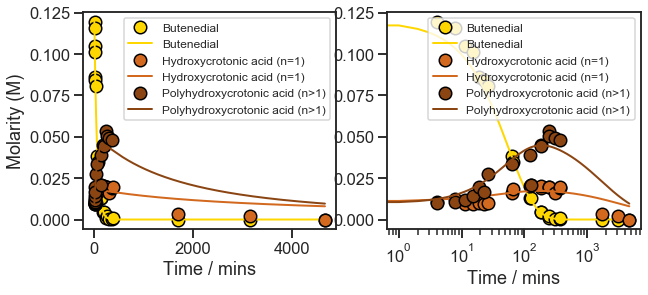

In [134]:
fig, ax = plt.subplots(1,2, figsize=(10,4))

ax[0].plot(df_processed.MINS_ELAPSED, df_processed.M_BUTENEDIAL, 
        '.', label='Butenedial',
        markersize=25, color='Gold', markeredgecolor='black', markeredgewidth=1.5)

ax[0].plot(df_modeled.MINS_ELAPSED, df_modeled.M_BUTENEDIAL, 
        label='Butenedial', lw=2, color='Gold')

ax[0].plot(df_processed.MINS_ELAPSED, df_processed.M_THCA_MONOMER, 
        '.', label='Hydroxycrotonic acid (n=1)',
        markersize=25, color='Chocolate', markeredgecolor='black', markeredgewidth=1.5)

ax[0].plot(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_MONOMER, 
        label='Hydroxycrotonic acid (n=1)', lw=2, color='Chocolate')

ax[0].plot(df_processed.MINS_ELAPSED, df_processed.M_THCA_NMER, 
        '.', label='Polyhydroxycrotonic acid (n>1)',
        markersize=25, color='SaddleBrown', markeredgecolor='black', markeredgewidth=1.5)

ax[0].plot(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_NMER, 
        label='Polyhydroxycrotonic acid (n>1)', lw=2, color='SaddleBrown')

ax[0].set_xlabel('Time / mins')
ax[0].set_ylabel('Molarity (M)')
ax[0].legend(fontsize='large')


ax[1].semilogx(df_processed.MINS_ELAPSED, df_processed.M_BUTENEDIAL, 
        '.', label='Butenedial',
        markersize=25, color='Gold', markeredgecolor='black', markeredgewidth=1.5)

ax[1].semilogx(df_modeled.MINS_ELAPSED, df_modeled.M_BUTENEDIAL, 
        label='Butenedial', lw=2, color='Gold')

ax[1].semilogx(df_processed.MINS_ELAPSED, df_processed.M_THCA_MONOMER, 
        '.', label='Hydroxycrotonic acid (n=1)',
        markersize=25, color='Chocolate', markeredgecolor='black', markeredgewidth=1.5)

ax[1].semilogx(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_MONOMER, 
        label='Hydroxycrotonic acid (n=1)', lw=2, color='Chocolate')

ax[1].semilogx(df_processed.MINS_ELAPSED, df_processed.M_THCA_NMER, 
        '.', label='Polyhydroxycrotonic acid (n>1)',
        markersize=25, color='SaddleBrown', markeredgecolor='black', markeredgewidth=1.5)

ax[1].semilogx(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_NMER, 
        label='Polyhydroxycrotonic acid (n>1)', lw=2, color='SaddleBrown')

ax[1].set_xlabel('Time / mins')
ax[1].legend(fontsize='large');

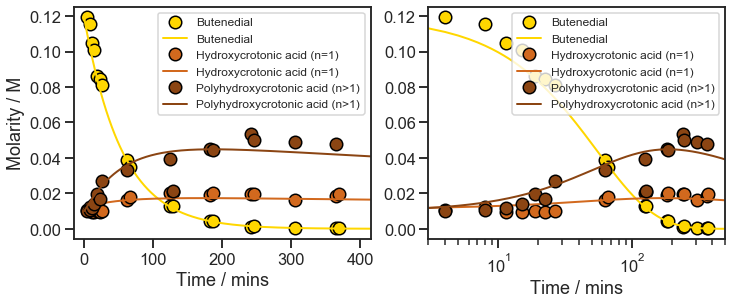

In [150]:
fig, ax = plt.subplots(1,2, figsize=(10,4))
plt.tight_layout()

ax[0].plot(df_processed.MINS_ELAPSED, df_processed.M_BUTENEDIAL, 
        '.', label='Butenedial',
        markersize=25, color='Gold', markeredgecolor='black', markeredgewidth=1.5)

ax[0].plot(df_modeled.MINS_ELAPSED, df_modeled.M_BUTENEDIAL, 
        label='Butenedial', lw=2, color='Gold')

ax[0].plot(df_processed.MINS_ELAPSED, df_processed.M_THCA_MONOMER, 
        '.', label='Hydroxycrotonic acid (n=1)',
        markersize=25, color='Chocolate', markeredgecolor='black', markeredgewidth=1.5)

ax[0].plot(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_MONOMER, 
        label='Hydroxycrotonic acid (n=1)', lw=2, color='Chocolate')

ax[0].plot(df_processed.MINS_ELAPSED, df_processed.M_THCA_NMER, 
        '.', label='Polyhydroxycrotonic acid (n>1)',
        markersize=25, color='SaddleBrown', markeredgecolor='black', markeredgewidth=1.5)

ax[0].plot(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_NMER, 
        label='Polyhydroxycrotonic acid (n>1)', lw=2, color='SaddleBrown')

ax[0].set_xlabel('Time / mins')
ax[0].set_xlim(-15, 415)
ax[0].set_ylabel('Molarity / M')
ax[0].legend(fontsize='large')


ax[1].semilogx(df_processed.MINS_ELAPSED, df_processed.M_BUTENEDIAL, 
        '.', label='Butenedial',
        markersize=25, color='Gold', markeredgecolor='black', markeredgewidth=1.5)

ax[1].semilogx(df_modeled.MINS_ELAPSED, df_modeled.M_BUTENEDIAL, 
        label='Butenedial', lw=2, color='Gold')

ax[1].semilogx(df_processed.MINS_ELAPSED, df_processed.M_THCA_MONOMER, 
        '.', label='Hydroxycrotonic acid (n=1)',
        markersize=25, color='Chocolate', markeredgecolor='black', markeredgewidth=1.5)

ax[1].semilogx(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_MONOMER, 
        label='Hydroxycrotonic acid (n=1)', lw=2, color='Chocolate')

ax[1].semilogx(df_processed.MINS_ELAPSED, df_processed.M_THCA_NMER, 
        '.', label='Polyhydroxycrotonic acid (n>1)',
        markersize=25, color='SaddleBrown', markeredgecolor='black', markeredgewidth=1.5)

ax[1].semilogx(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_NMER, 
        label='Polyhydroxycrotonic acid (n>1)', lw=2, color='SaddleBrown')

ax[1].set_xlabel('Time / mins')
ax[1].set_xlim(3, 500)
ax[1].legend(fontsize='large');

seems like it's getting there. Though what seems potentially unrealistic is the ultimate, and substantial, decrease in the amount of PHCA, while the amount of HCA should still be decreasing more. Throw in an additional sink for the HCA?


$$ \frac{d[BD]}{dt} = - k_{1} [BD] $$ 
$$ \frac{d[HCA_{n=1}]}{dt} = \alpha k_{1} [BD] - 2 k_{2} [HCA_{n=1}]^2 + 2 k_{3} [HCA_{n>1}] - k_4 [HCA_{n=1}][HCA_{n>1}] - k_5 [HCA_{n=1}]$$ 
$$ \frac{d[HCA_{n>1}]}{dt} = k_{2} [HCA_{n=1}]^2 - k_{3} [HCA_{n>1}] $$

In [68]:
from src.d02_extraction.extract_least_sq_fit import *


def g(t, y0, coefs):
    """
    Solution to the ODE y'(t) = f(t,y,k) with initial condition y0
    """

    y = odeint(f, y0, t, args=(coefs,))

    return y


def f_residual(coefs, t, data):
    """
    compute the residual between actual data and fitted data
    """

    y0 = coefs['BD_0'].value, coefs['HCA_0'].value, coefs['PHCA_0'].value
    model = g(t, y0, coefs).T

    return (model - data).ravel()


def f(y, t, coefs):
    """
    Your system of differential equations
    """

    BD = y[0]
    HCA = y[1]
    PHCA = y[2]

    k1 = coefs['k1'].value
    k2 = coefs['k2'].value
    k3 = coefs['k3'].value
    k4 = coefs['k4'].value
    k5 = coefs['k5'].value
    alpha = coefs['alpha'].value

    # the model equations
    dBDdt = - k1 * BD
    dHCAdt = alpha * k1 * BD - 2 * k2 * HCA * HCA + 2 * k3 * PHCA - k4 * HCA * PHCA - k5 * HCA
    dPHCAdt = k2 * HCA * HCA - k3 * PHCA

    return [dBDdt, dHCAdt, dPHCAdt]

In [70]:
BD_0 = df_processed.M_BUTENEDIAL[df_processed.MINS_ELAPSED == df_processed.MINS_ELAPSED.min()].values[0]
HCA_0 = df_processed.M_THCA_MONOMER[df_processed.MINS_ELAPSED == df_processed.MINS_ELAPSED.min()].values[0]
PHCA_0 = df_processed.M_THCA_NMER[df_processed.MINS_ELAPSED == df_processed.MINS_ELAPSED.min()].values[0]
X_0 = [BD_0, HCA_0, PHCA_0]

params = Parameters()
params.add('BD_0', value=BD_0, vary=False)
params.add('HCA_0', value=HCA_0, vary=False)
params.add('PHCA_0', value=PHCA_0, vary=False)
params.add('k1', value=0.001, min=0, max=100.)
params.add('k2', value=0.001, min=0, max=100.)
params.add('k3', value=0.001, min=0, max=100.)
params.add('k4', value=0.001, min=0, max=100.)
params.add('k5', value=0.001, min=0, max=100.)
params.add('alpha', value=0.001, min=0, max=1.)

t_max = int(np.max(df_processed.MINS_ELAPSED) + 5)
ts = np.linspace(0, t_max, t_max + 1)
df_modeled = model_data_with_odes(g_function=g, residual_function=f_residual, params=params,
                                  experiments_dict=bd_decay_params, x_col_name='MINS_ELAPSED',
                                  y_col_names=['M_BUTENEDIAL', 'M_THCA_MONOMER', 'M_THCA_NMER'], ts=ts,
                                  vars_init=X_0, save_data=False)

df_modeled.head()

KeyboardInterrupt: 

shut down because the model was unhappy with me.

this time, try adding a loss term to PCA with the simple model used above (only 3 ks).

$$ \frac{d[BD]}{dt} = - k_{1} [BD] $$ 
$$ \frac{d[HCA_{n=1}]}{dt} = \alpha k_{1} [BD] - 2 k_{2} [HCA_{n=1}]^2 $$ 
$$ \frac{d[HCA_{n>1}]}{dt} = k_{2} [HCA_{n=1}]^2 - k_{3} [HCA_{n>1}] $$

In [121]:
from src.d02_extraction.extract_least_sq_fit import *


def g(t, y0, coefs):
    """
    Solution to the ODE y'(t) = f(t,y,k) with initial condition y0
    """

    y = odeint(f, y0, t, args=(coefs,))

    return y


def f_residual(coefs, t, data):
    """
    compute the residual between actual data and fitted data
    """

    y0 = coefs['BD_0'].value, coefs['HCA_0'].value, coefs['PHCA_0'].value
    model = g(t, y0, coefs).T

    return (model - data).ravel()


def f(y, t, coefs):
    """
    Your system of differential equations
    """

    BD = y[0]
    HCA = y[1]
    PHCA = y[2]

    k1 = coefs['k1'].value
    k2 = coefs['k2'].value
    k3 = coefs['k3'].value
    k4 = coefs['k4'].value
    alpha = coefs['alpha'].value

    # the model equations
    dBDdt = - k1 * BD
    dHCAdt = alpha * k1 * BD - 2 * k2 * HCA * HCA #- k3 * HCA
    dPHCAdt = k2 * HCA * HCA - k4 * PHCA
    
    print(alpha, k1, k2, k3, k4)

    return [dBDdt, dHCAdt, dPHCAdt]

In [122]:
BD_0 = df_processed.M_BUTENEDIAL[df_processed.MINS_ELAPSED == df_processed.MINS_ELAPSED.min()].values[0]
HCA_0 = df_processed.M_THCA_MONOMER[df_processed.MINS_ELAPSED == df_processed.MINS_ELAPSED.min()].values[0]
PHCA_0 = df_processed.M_THCA_NMER[df_processed.MINS_ELAPSED == df_processed.MINS_ELAPSED.min()].values[0]
X_0 = [BD_0, HCA_0, PHCA_0]

params = Parameters()
params.add('BD_0', value=BD_0, vary=False)
params.add('HCA_0', value=HCA_0, vary=False)
params.add('PHCA_0', value=PHCA_0, vary=False)
params.add('k1', value=0.001, min=0, max=100.)
params.add('k2', value=0.001, min=0, max=100.)
params.add('k3', value=0.001, min=0, max=100.)
params.add('k4', value=0.001, min=0, max=100.)
params.add('alpha', value=0.001, min=0, max=1.)

t_max = int(np.max(df_processed.MINS_ELAPSED) + 5)
ts = np.linspace(0, t_max, t_max + 1)
df_modeled = model_data_with_odes(g_function=g, residual_function=f_residual, params=params,
                                  experiments_dict=bd_decay_params, x_col_name='MINS_ELAPSED',
                                  y_col_names=['M_BUTENEDIAL', 'M_THCA_MONOMER', 'M_THCA_NMER'], ts=ts,
                                  vars_init=X_0, save_data=False)

df_modeled.head()

0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.

0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.0010000073720206615
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.0010000073720206615
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.0010000073720206615
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.0010000073720206615
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.0010000073720206615
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.0010000073720206615
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.0010000073720206615
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.0010000073720206615
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.0010000073720206615
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.0010000073720206615
0.001000000000000000

0.40708810987907634 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320026344671994
0.40708810987907634 

0.40708810987907634 0.006479643806772684 0.5438325053615634 0.001000000000001 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438325053615634 0.001000000000001 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438325053615634 0.001000000000001 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438325053615634 0.001000000000001 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438325053615634 0.001000000000001 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438325053615634 0.001000000000001 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438325053615634 0.001000000000001 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438325053615634 0.001000000000001 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438325053615634 0.001000000000001 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438325053615634 0.001000000000001 0.08320026344671994
0.40708810987907634 

0.40708810987907634 0.006479643806772684 0.5438323493969666 0.0010000073720206615 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.0010000073720206615 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.0010000073720206615 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.0010000073720206615 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.0010000073720206615 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.0010000073720206615 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.0010000073720206615 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.0010000073720206615 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.0010000073720206615 0.08320026344671994
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.0010000073720206615 

0.40708810987907634 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320019348063701
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320019348063701
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320019348063701
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320019348063701
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320019348063701
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320019348063701
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320019348063701
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320019348063701
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320019348063701
0.40708810987907634 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320019348063701
0.40708810987907634 

0.4070881545087761 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320026344671994
0.4070881545087761 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320026344671994
0.4070881545087761 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320026344671994
0.4070881545087761 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320026344671994
0.4070881545087761 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320026344671994
0.4070881545087761 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320026344671994
0.4070881545087761 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320026344671994
0.4070881545087761 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320026344671994
0.4070881545087761 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320026344671994
0.4070881545087761 0.006479643806772684 0.5438323493969666 0.001000000000001 0.08320026344671994
0.4070881545087761 0.006479643

0.48382224963311143 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382224963311143 

0.48382224963311143 0.012868236346519346 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868236346519346 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868236346519346 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868236346519346 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868236346519346 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868236346519346 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868236346519346 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868236346519346 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868236346519346 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868236346519346 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382224963311143 

0.48382224963311143 0.012868210179589612 0.12990363040107367 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990363040107367 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990363040107367 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990363040107367 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990363040107367 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990363040107367 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990363040107367 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990363040107367 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990363040107367 0.001000000000001 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990363040107367 0.001000000000001 0.4628780393190701
0.48382224963311143 

0.48382224963311143 0.012868210179589612 0.12990354996292308 0.0010000073720206615 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.0010000073720206615 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.0010000073720206615 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.0010000073720206615 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.0010000073720206615 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.0010000073720206615 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.0010000073720206615 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.0010000073720206615 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.0010000073720206615 0.4628780393190701
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.0010000073720206615

0.48382224963311143 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628781844243146
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628781844243146
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628781844243146
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628781844243146
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628781844243146
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628781844243146
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628781844243146
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628781844243146
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628781844243146
0.48382224963311143 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628781844243146
0.48382224963311143 

0.48382229618099654 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382229618099654 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382229618099654 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382229618099654 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382229618099654 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382229618099654 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382229618099654 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382229618099654 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382229618099654 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382229618099654 0.012868210179589612 0.12990354996292308 0.001000000000001 0.4628780393190701
0.48382229618099654 

0.009065095437761184 0.01753318812445226 0.031963995672112944 0.001000000000001 2.082212096765251
0.009065095437761184 0.01753318812445226 0.031963995672112944 0.001000000000001 2.082212096765251
0.009065095437761184 0.01753318812445226 0.031963995672112944 0.001000000000001 2.082212096765251
0.009065095437761184 0.01753318812445226 0.031963995672112944 0.001000000000001 2.082212096765251
0.009065095437761184 0.01753318812445226 0.031963995672112944 0.001000000000001 2.082212096765251
0.009065095437761184 0.01753318812445226 0.031963995672112944 0.001000000000001 2.082212096765251
0.009065095437761184 0.01753318812445226 0.031963995672112944 0.001000000000001 2.082212096765251
0.009065095437761184 0.01753318812445226 0.031963995672112944 0.001000000000001 2.082212096765251
0.009065095437761184 0.01753318812445226 0.031963995672112944 0.001000000000001 2.082212096765251
0.009065095437761184 0.01753318812445226 0.031963995672112944 0.001000000000001 2.082212096765251
0.009065095437761184

0.009065095437761184 0.017533157656191012 0.031963995672112944 0.0010000073720206615 2.082212096765251
0.009065095437761184 0.017533157656191012 0.031963995672112944 0.0010000073720206615 2.082212096765251
0.009065095437761184 0.017533157656191012 0.031963995672112944 0.0010000073720206615 2.082212096765251
0.009065095437761184 0.017533157656191012 0.031963995672112944 0.0010000073720206615 2.082212096765251
0.009065095437761184 0.017533157656191012 0.031963995672112944 0.0010000073720206615 2.082212096765251
0.009065095437761184 0.017533157656191012 0.031963995672112944 0.0010000073720206615 2.082212096765251
0.009065095437761184 0.017533157656191012 0.031963995672112944 0.0010000073720206615 2.082212096765251
0.009065095437761184 0.017533157656191012 0.031963995672112944 0.0010000073720206615 2.082212096765251
0.009065095437761184 0.017533157656191012 0.031963995672112944 0.0010000073720206615 2.082212096765251
0.009065095437761184 0.017533157656191012 0.031963995672112944 0.00100000

0.009065102362440292 0.017533157656191012 0.031963995672112944 0.001000000000001 2.082212096765251
0.009065102362440292 0.017533157656191012 0.031963995672112944 0.001000000000001 2.082212096765251
0.009065102362440292 0.017533157656191012 0.031963995672112944 0.001000000000001 2.082212096765251
0.009065102362440292 0.017533157656191012 0.031963995672112944 0.001000000000001 2.082212096765251
0.009065102362440292 0.017533157656191012 0.031963995672112944 0.001000000000001 2.082212096765251
0.009065102362440292 0.017533157656191012 0.031963995672112944 0.001000000000001 2.082212096765251
0.009065102362440292 0.017533157656191012 0.031963995672112944 0.001000000000001 2.082212096765251
0.009065102362440292 0.017533157656191012 0.031963995672112944 0.001000000000001 2.082212096765251
0.009065102362440292 0.017533157656191012 0.031963995672112944 0.001000000000001 2.082212096765251
0.009065102362440292 0.017533157656191012 0.031963995672112944 0.001000000000001 2.082212096765251
0.00906510

0.36144692014981344 0.018646146378470396 0.060006586972727316 0.001000000000001 0.5893126103688306
0.36144692014981344 0.018646146378470396 0.060006586972727316 0.001000000000001 0.5893126103688306
0.36144692014981344 0.018646146378470396 0.060006586972727316 0.001000000000001 0.5893126103688306
0.36144692014981344 0.018646146378470396 0.060006586972727316 0.001000000000001 0.5893126103688306
0.36144692014981344 0.018646146378470396 0.060006586972727316 0.001000000000001 0.5893126103688306
0.36144692014981344 0.018646146378470396 0.060006586972727316 0.001000000000001 0.5893126103688306
0.36144692014981344 0.018646146378470396 0.060006586972727316 0.001000000000001 0.5893126103688306
0.36144692014981344 0.018646146378470396 0.060006586972727316 0.001000000000001 0.5893126103688306
0.36144692014981344 0.018646146378470396 0.060006586972727316 0.001000000000001 0.5893126103688306
0.36144692014981344 0.018646146378470396 0.060006586972727316 0.001000000000001 0.5893126103688306
0.36144692

0.36173249629320414 0.018646636654218174 0.06024154789841529 0.001000000000001 0.7957428006061862
0.36173249629320414 0.018646636654218174 0.06024154789841529 0.001000000000001 0.7957428006061862
0.36173249629320414 0.018646636654218174 0.06024154789841529 0.001000000000001 0.7957428006061862
0.36173249629320414 0.018646636654218174 0.06024154789841529 0.001000000000001 0.7957428006061862
0.36173249629320414 0.018646636654218174 0.06024154789841529 0.001000000000001 0.7957428006061862
0.36173249629320414 0.018646636654218174 0.06024154789841529 0.001000000000001 0.7957428006061862
0.36173249629320414 0.018646636654218174 0.06024154789841529 0.001000000000001 0.7957428006061862
0.36173249629320414 0.018646636654218174 0.06024154789841529 0.001000000000001 0.7957428006061862
0.36173249629320414 0.018646636654218174 0.06024154789841529 0.001000000000001 0.7957428006061862
0.36173249629320414 0.018646636654218174 0.06024154789841529 0.001000000000001 0.7957428006061862
0.36173249629320414 

0.1204704232492228 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081444096899504
0.1204704232492228 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081444096899504
0.1204704232492228 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081444096899504
0.1204704232492228 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081444096899504
0.1204704232492228 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081444096899504
0.1204704232492228 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081444096899504
0.1204704232492228 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081444096899504
0.1204704232492228 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081444096899504
0.1204704232492228 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081444096899504
0.1204704232492228 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081444096899504
0.1204704232492228 0.0183616811781806 0.0096303695

0.1204704232492228 0.0183616811781806 0.009630392189824422 0.001000000000001 2.081444096899504
0.1204704232492228 0.0183616811781806 0.009630392189824422 0.001000000000001 2.081444096899504
0.1204704232492228 0.0183616811781806 0.009630392189824422 0.001000000000001 2.081444096899504
0.1204704232492228 0.0183616811781806 0.009630392189824422 0.001000000000001 2.081444096899504
0.1204704232492228 0.0183616811781806 0.009630392189824422 0.001000000000001 2.081444096899504
0.1204704232492228 0.0183616811781806 0.009630392189824422 0.001000000000001 2.081444096899504
0.1204704232492228 0.0183616811781806 0.009630392189824422 0.001000000000001 2.081444096899504
0.1204704232492228 0.0183616811781806 0.009630392189824422 0.001000000000001 2.081444096899504
0.1204704232492228 0.0183616811781806 0.009630392189824422 0.001000000000001 2.081444096899504
0.1204704232492228 0.0183616811781806 0.009630392189824422 0.001000000000001 2.081444096899504
0.1204704232492228 0.0183616811781806 0.0096303921

0.1204704232492228 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081443701141361
0.1204704232492228 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081443701141361
0.1204704232492228 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081443701141361
0.1204704232492228 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081443701141361
0.1204704232492228 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081443701141361
0.1204704232492228 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081443701141361
0.1204704232492228 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081443701141361
0.1204704232492228 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081443701141361
0.1204704232492228 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081443701141361
0.1204704232492228 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081443701141361
0.1204704232492228 0.0183616811781806 0.0096303695

0.12047044954527208 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081444096899504
0.12047044954527208 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081444096899504
0.12047044954527208 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081444096899504
0.12047044954527208 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081444096899504
0.12047044954527208 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081444096899504
0.12047044954527208 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081444096899504
0.12047044954527208 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081444096899504
0.12047044954527208 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081444096899504
0.12047044954527208 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081444096899504
0.12047044954527208 0.0183616811781806 0.009630369507890313 0.001000000000001 2.081444096899504
0.12047044954527208 0.0183616811781806 0

0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 

0.10266010999379566 0.018547859448359016 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.018547859448359016 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.018547859448359016 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.018547859448359016 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.018547859448359016 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.018547859448359016 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.018547859448359016 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.018547859448359016 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.018547859448359016 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.018547859448359016 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854785

0.10266010999379566 0.01854782812636957 0.02567717572872774 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567717572872774 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567717572872774 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567717572872774 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567717572872774 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567717572872774 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567717572872774 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567717572872774 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567717572872774 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567717572872774 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 

0.10266010999379566 0.01854782812636957 0.02567713899161994 0.0010000073720206615 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.0010000073720206615 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.0010000073720206615 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.0010000073720206615 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.0010000073720206615 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.0010000073720206615 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.5327910229147645
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.5327910229147645
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.5327910229147645
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.5327910229147645
0.1026601099

0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.5327910229147645
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.5327910229147645
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.5327910229147645
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.5327910229147645
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.5327910229147645
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.5327910229147645
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.5327910229147645
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.5327910229147645
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.5327910229147645
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.5327910229147645
0.10266010999379566 0.01854782

0.10266013425684417 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266013425684417 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266013425684417 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266013425684417 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266013425684417 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266013425684417 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266013425684417 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266013425684417 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266013425684417 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266013425684417 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266013425684417 0.01854782812636957 

0.07182262809774881 0.018655690440921857 0.00684481910197543 0.001000000000001 1.5481827775754076
0.07182262809774881 0.018655690440921857 0.00684481910197543 0.001000000000001 1.5481827775754076
0.07182262809774881 0.018655690440921857 0.00684481910197543 0.001000000000001 1.5481827775754076
0.07182262809774881 0.018655690440921857 0.00684481910197543 0.001000000000001 1.5481827775754076
0.07182262809774881 0.018655690440921857 0.00684481910197543 0.001000000000001 1.5481827775754076
0.07182262809774881 0.018655690440921857 0.00684481910197543 0.001000000000001 1.5481827775754076
0.07182262809774881 0.018655690440921857 0.00684481910197543 0.001000000000001 1.5481827775754076
0.07182262809774881 0.018655690440921857 0.00684481910197543 0.001000000000001 1.5481827775754076
0.07182262809774881 0.018655690440921857 0.00684481910197543 0.001000000000001 1.5481827775754076
0.07182262809774881 0.018655690440921857 0.00684481910197543 0.001000000000001 1.5481827775754076
0.07182262809774881 

0.0989746731092459 0.018547353142478462 0.023094898164932598 0.001000000000001 1.5491947705286724
0.0989746731092459 0.018547353142478462 0.023094898164932598 0.001000000000001 1.5491947705286724
0.0989746731092459 0.018547353142478462 0.023094898164932598 0.001000000000001 1.5491947705286724
0.0989746731092459 0.018547353142478462 0.023094898164932598 0.001000000000001 1.5491947705286724
0.0989746731092459 0.018547353142478462 0.023094898164932598 0.001000000000001 1.5491947705286724
0.0989746731092459 0.018547353142478462 0.023094898164932598 0.001000000000001 1.5491947705286724
0.0989746731092459 0.018547353142478462 0.023094898164932598 0.001000000000001 1.5491947705286724
0.0989746731092459 0.018547353142478462 0.023094898164932598 0.001000000000001 1.5491947705286724
0.0989746731092459 0.018547353142478462 0.023094898164932598 0.001000000000001 1.5491947705286724
0.0989746731092459 0.018547353142478462 0.023094898164932598 0.001000000000001 1.5491947705286724
0.0989746731092459 0

0.0989746731092459 0.018547353142478462 0.023094898164932598 0.001000000000001 1.5491947705286724
0.0989746731092459 0.018547353142478462 0.023094898164932598 0.001000000000001 1.5491947705286724
0.0989746731092459 0.018547353142478462 0.023094898164932598 0.001000000000001 1.5491947705286724
0.0989746731092459 0.018547353142478462 0.023094898164932598 0.001000000000001 1.5491947705286724
0.0989746731092459 0.018547353142478462 0.023094898164932598 0.001000000000001 1.5491947705286724
0.0989746731092459 0.018547353142478462 0.023094898164932598 0.001000000000001 1.5491947705286724
0.0989746731092459 0.018547353142478462 0.023094898164932598 0.001000000000001 1.5491947705286724
0.0989746731092459 0.018547353142478462 0.023094898164932598 0.001000000000001 1.5491947705286724
0.0989746731092459 0.018547353142478462 0.023094898164932598 0.001000000000001 1.5491947705286724
0.0989746731092459 0.018547353142478462 0.023094898164932598 0.001000000000001 1.5491947705286724
0.0989746731092459 0

0.10137370543974183 0.018545770738331857 0.024906477919489634 0.001000000000001 1.5409728259211497
0.10137370543974183 0.018545770738331857 0.024906477919489634 0.001000000000001 1.5409728259211497
0.10137370543974183 0.018545770738331857 0.024906477919489634 0.001000000000001 1.5409728259211497
0.10137370543974183 0.018545770738331857 0.024906477919489634 0.001000000000001 1.5409728259211497
0.10137370543974183 0.018545770738331857 0.024906477919489634 0.001000000000001 1.5409728259211497
0.10137370543974183 0.018545770738331857 0.024906477919489634 0.001000000000001 1.5409728259211497
0.10137370543974183 0.018545770738331857 0.024906477919489634 0.001000000000001 1.5409728259211497
0.10137370543974183 0.018545770738331857 0.024906477919489634 0.001000000000001 1.5409728259211497
0.10137370543974183 0.018545770738331857 0.024906477919489634 0.001000000000001 1.5409728259211497
0.10137370543974183 0.018545770738331857 0.024906477919489634 0.001000000000001 1.5409728259211497
0.10137370

0.10239610613104189 0.01854721511263535 0.025544458605686327 0.001000000000001 1.5346832815358147
0.10239610613104189 0.01854721511263535 0.025544458605686327 0.001000000000001 1.5346832815358147
0.10239610613104189 0.01854721511263535 0.025544458605686327 0.001000000000001 1.5346832815358147
0.10239610613104189 0.01854721511263535 0.025544458605686327 0.001000000000001 1.5346832815358147
0.10239610613104189 0.01854721511263535 0.025544458605686327 0.001000000000001 1.5346832815358147
0.10239610613104189 0.01854721511263535 0.025544458605686327 0.001000000000001 1.5346832815358147
0.10239610613104189 0.01854721511263535 0.025544458605686327 0.001000000000001 1.5346832815358147
0.10239610613104189 0.01854721511263535 0.025544458605686327 0.001000000000001 1.5346832815358147
0.10239610613104189 0.01854721511263535 0.025544458605686327 0.001000000000001 1.5346832815358147
0.10239610613104189 0.01854721511263535 0.025544458605686327 0.001000000000001 1.5346832815358147
0.10239610613104189 

0.10253445409388184 0.01854752512719937 0.025615919397053988 0.001000000000001 1.5337028607910863
0.10253445409388184 0.01854752512719937 0.025615919397053988 0.001000000000001 1.5337028607910863
0.10253445409388184 0.01854752512719937 0.025615919397053988 0.001000000000001 1.5337028607910863
0.10253445409388184 0.01854752512719937 0.025615919397053988 0.001000000000001 1.5337028607910863
0.10253445409388184 0.01854752512719937 0.025615919397053988 0.001000000000001 1.5337028607910863
0.10253445409388184 0.01854752512719937 0.025615919397053988 0.001000000000001 1.5337028607910863
0.10253445409388184 0.01854752512719937 0.025615919397053988 0.001000000000001 1.5337028607910863
0.10253445409388184 0.01854752512719937 0.025615919397053988 0.001000000000001 1.5337028607910863
0.10253445409388184 0.01854752512719937 0.025615919397053988 0.001000000000001 1.5337028607910863
0.10253445409388184 0.01854752512719937 0.025615919397053988 0.001000000000001 1.5337028607910863
0.10253445409388184 

0.10260687290084164 0.018547697336851465 0.025651637948087558 0.001000000000001 1.53317983389879
0.10260687290084164 0.018547697336851465 0.025651637948087558 0.001000000000001 1.53317983389879
0.10260687290084164 0.018547697336851465 0.025651637948087558 0.001000000000001 1.53317983389879
0.10260687290084164 0.018547697336851465 0.025651637948087558 0.001000000000001 1.53317983389879
0.10260687290084164 0.018547697336851465 0.025651637948087558 0.001000000000001 1.53317983389879
0.10260687290084164 0.018547697336851465 0.025651637948087558 0.001000000000001 1.53317983389879
0.10260687290084164 0.018547697336851465 0.025651637948087558 0.001000000000001 1.53317983389879
0.10260687290084164 0.018547697336851465 0.025651637948087558 0.001000000000001 1.53317983389879
0.10260687290084164 0.018547697336851465 0.025651637948087558 0.001000000000001 1.53317983389879
0.10260687290084164 0.018547697336851465 0.025651637948087558 0.001000000000001 1.53317983389879
0.10260687290084164 0.01854769

0.10263509135614612 0.018547766226439943 0.025665235288779842 0.001000000000001 1.5329743276425
0.10263509135614612 0.018547766226439943 0.025665235288779842 0.001000000000001 1.5329743276425
0.10263509135614612 0.018547766226439943 0.025665235288779842 0.001000000000001 1.5329743276425
0.10263509135614612 0.018547766226439943 0.025665235288779842 0.001000000000001 1.5329743276425
0.10263509135614612 0.018547766226439943 0.025665235288779842 0.001000000000001 1.5329743276425
0.10263509135614612 0.018547766226439943 0.025665235288779842 0.001000000000001 1.5329743276425
0.10263509135614612 0.018547766226439943 0.025665235288779842 0.001000000000001 1.5329743276425
0.10263509135614612 0.018547766226439943 0.025665235288779842 0.001000000000001 1.5329743276425
0.10263509135614612 0.018547766226439943 0.025665235288779842 0.001000000000001 1.5329743276425
0.10263509135614612 0.018547766226439943 0.025665235288779842 0.001000000000001 1.5329743276425
0.10263509135614612 0.018547766226439943

0.10264846566006747 0.018547799221035888 0.02567161649082439 0.001000000000001 1.5328766044500897
0.10264846566006747 0.018547799221035888 0.02567161649082439 0.001000000000001 1.5328766044500897
0.10264846566006747 0.018547799221035888 0.02567161649082439 0.001000000000001 1.5328766044500897
0.10264846566006747 0.018547799221035888 0.02567161649082439 0.001000000000001 1.5328766044500897
0.10264846566006747 0.018547799221035888 0.02567161649082439 0.001000000000001 1.5328766044500897
0.10264846566006747 0.018547799221035888 0.02567161649082439 0.001000000000001 1.5328766044500897
0.10264846566006747 0.018547799221035888 0.02567161649082439 0.001000000000001 1.5328766044500897
0.10264846566006747 0.018547799221035888 0.02567161649082439 0.001000000000001 1.5328766044500897
0.10264846566006747 0.018547799221035888 0.02567161649082439 0.001000000000001 1.5328766044500897
0.10264846566006747 0.018547799221035888 0.02567161649082439 0.001000000000001 1.5328766044500897
0.10264846566006747 

0.102654606529609 0.018547814444180855 0.025674532757719026 0.001000000000001 1.5328316660691899
0.102654606529609 0.018547814444180855 0.025674532757719026 0.001000000000001 1.5328316660691899
0.102654606529609 0.018547814444180855 0.025674532757719026 0.001000000000001 1.5328316660691899
0.102654606529609 0.018547814444180855 0.025674532757719026 0.001000000000001 1.5328316660691899
0.102654606529609 0.018547814444180855 0.025674532757719026 0.001000000000001 1.5328316660691899
0.102654606529609 0.018547814444180855 0.025674532757719026 0.001000000000001 1.5328316660691899
0.102654606529609 0.018547814444180855 0.025674532757719026 0.001000000000001 1.5328316660691899
0.102654606529609 0.018547814444180855 0.025674532757719026 0.001000000000001 1.5328316660691899
0.102654606529609 0.018547814444180855 0.025674532757719026 0.001000000000001 1.5328316660691899
0.102654606529609 0.018547814444180855 0.025674532757719026 0.001000000000001 1.5328316660691899
0.102654606529609 0.0185478144

0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 

0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 0.02567713899161994 0.001000000000001 1.532791355919888
0.10266010999379566 0.01854782812636957 

,MINS_ELAPSED,M_BUTENEDIAL,M_THCA_MONOMER,M_THCA_NMER
0,0.0,0.119431,0.010717,0.009999
1,1.0,0.117236,0.010936,0.002161
2,2.0,0.115082,0.011151,0.000468
3,3.0,0.112967,0.011362,0.000103
4,4.0,0.110891,0.011568,0.000024


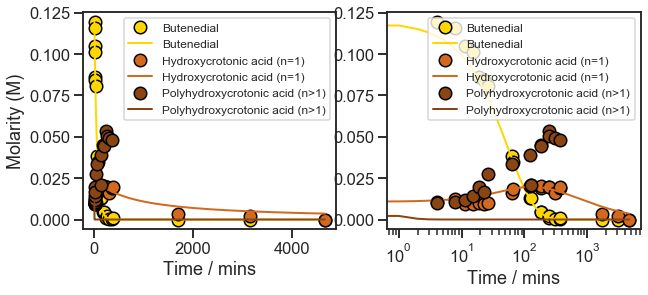

In [120]:
fig, ax = plt.subplots(1,2, figsize=(10,4))

ax[0].plot(df_processed.MINS_ELAPSED, df_processed.M_BUTENEDIAL, 
        '.', label='Butenedial',
        markersize=25, color='Gold', markeredgecolor='black', markeredgewidth=1.5)

ax[0].plot(df_modeled.MINS_ELAPSED, df_modeled.M_BUTENEDIAL, 
        label='Butenedial', lw=2, color='Gold')

ax[0].plot(df_processed.MINS_ELAPSED, df_processed.M_THCA_MONOMER, 
        '.', label='Hydroxycrotonic acid (n=1)',
        markersize=25, color='Chocolate', markeredgecolor='black', markeredgewidth=1.5)

ax[0].plot(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_MONOMER, 
        label='Hydroxycrotonic acid (n=1)', lw=2, color='Chocolate')

ax[0].plot(df_processed.MINS_ELAPSED, df_processed.M_THCA_NMER, 
        '.', label='Polyhydroxycrotonic acid (n>1)',
        markersize=25, color='SaddleBrown', markeredgecolor='black', markeredgewidth=1.5)

ax[0].plot(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_NMER, 
        label='Polyhydroxycrotonic acid (n>1)', lw=2, color='SaddleBrown')

ax[0].set_xlabel('Time / mins')
ax[0].set_ylabel('Molarity (M)')
ax[0].legend(fontsize='large')


ax[1].semilogx(df_processed.MINS_ELAPSED, df_processed.M_BUTENEDIAL, 
        '.', label='Butenedial',
        markersize=25, color='Gold', markeredgecolor='black', markeredgewidth=1.5)

ax[1].semilogx(df_modeled.MINS_ELAPSED, df_modeled.M_BUTENEDIAL, 
        label='Butenedial', lw=2, color='Gold')

ax[1].semilogx(df_processed.MINS_ELAPSED, df_processed.M_THCA_MONOMER, 
        '.', label='Hydroxycrotonic acid (n=1)',
        markersize=25, color='Chocolate', markeredgecolor='black', markeredgewidth=1.5)

ax[1].semilogx(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_MONOMER, 
        label='Hydroxycrotonic acid (n=1)', lw=2, color='Chocolate')

ax[1].semilogx(df_processed.MINS_ELAPSED, df_processed.M_THCA_NMER, 
        '.', label='Polyhydroxycrotonic acid (n>1)',
        markersize=25, color='SaddleBrown', markeredgecolor='black', markeredgewidth=1.5)

ax[1].semilogx(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_NMER, 
        label='Polyhydroxycrotonic acid (n>1)', lw=2, color='SaddleBrown')

ax[1].set_xlabel('Time / mins')
ax[1].legend(fontsize='large');

the monomer is matched really well, but the polymer is not at all. It's probably because alpha is being fit to be so small, so then the polymer can't actually build up...

In [129]:
from src.d02_extraction.extract_least_sq_fit import *


def g(t, y0, coefs):
    """
    Solution to the ODE y'(t) = f(t,y,k) with initial condition y0
    """

    y = odeint(f, y0, t, args=(coefs,))

    return y


def f_residual(coefs, t, data):
    """
    compute the residual between actual data and fitted data
    """

    y0 = coefs['BD_0'].value, coefs['HCA_0'].value, coefs['PHCA_0'].value
    model = g(t, y0, coefs).T

    return (model - data).ravel()


def f(y, t, coefs):
    """
    Your system of differential equations
    """

    BD = y[0]
    HCA = y[1]
    PHCA = y[2]

    k1 = coefs['k1'].value
    k2 = coefs['k2'].value
    k3 = coefs['k3'].value
    k4 = coefs['k4'].value
    alpha = coefs['alpha'].value

    # the model equations
    dBDdt = - k1 * BD
    dHCAdt = alpha * k1 * BD - 2 * k2 * HCA * HCA + 2 * k3 * PHCA - k4 * HCA * PHCA
    dPHCAdt = k2 * HCA * HCA - k3 * PHCA
    
    print(alpha, k1, k2, k3, k4)

    return [dBDdt, dHCAdt, dPHCAdt]

In [130]:
BD_0 = df_processed.M_BUTENEDIAL[df_processed.MINS_ELAPSED == df_processed.MINS_ELAPSED.min()].values[0]
HCA_0 = df_processed.M_THCA_MONOMER[df_processed.MINS_ELAPSED == df_processed.MINS_ELAPSED.min()].values[0]
PHCA_0 = df_processed.M_THCA_NMER[df_processed.MINS_ELAPSED == df_processed.MINS_ELAPSED.min()].values[0]
X_0 = [BD_0, HCA_0, PHCA_0]

params = Parameters()
params.add('BD_0', value=BD_0, vary=False)
params.add('HCA_0', value=HCA_0, vary=False)
params.add('PHCA_0', value=PHCA_0, vary=False)
params.add('k1', value=0.001, min=0, max=100.)
params.add('k2', value=0.001, min=0, max=100.)
params.add('k3', value=0.001, min=0, max=100.)
params.add('k4', value=0.001, min=0, max=100.)
params.add('k5', value=0.001, min=0, max=100.)
params.add('alpha', value=0.001, min=0, max=1.)

t_max = int(np.max(df_processed.MINS_ELAPSED) + 5)
ts = np.linspace(0, t_max, t_max + 1)
df_modeled = model_data_with_odes(g_function=g, residual_function=f_residual, params=params,
                                  experiments_dict=bd_decay_params, x_col_name='MINS_ELAPSED',
                                  y_col_names=['M_BUTENEDIAL', 'M_THCA_MONOMER', 'M_THCA_NMER'], ts=ts,
                                  vars_init=X_0, save_data=False)

df_modeled.head()

0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.001000000000001
0.0010000000000000009 0.001000000000001 0.001000000000001 0.

0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.0010000073720206615
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.0010000073720206615
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.0010000073720206615
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.0010000073720206615
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.0010000073720206615
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.0010000073720206615
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.0010000073720206615
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.0010000073720206615
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.0010000073720206615
0.0010000000000000009 0.001000000000001 0.001000000000001 0.001000000000001 0.0010000073720206615
0.001000000000000000

0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0

0.9813362711270106 0.006479457314251258 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479457314251258 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479457314251258 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479457314251258 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479457314251258 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479457314251258 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479457314251258 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479457314251258 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479457314251258 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479457314251258 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0

0.9813362711270106 0.006479438666739945 20.798197847350863 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197847350863 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197847350863 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197847350863 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197847350863 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197847350863 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197847350863 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197847350863 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197847350863 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197847350863 0.037241520234804204 99.85970894407845
0.9813362711270106 0

0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438

0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.03724147396310662 99.85970894407845
0.9813362711270106 0.006479438

0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970921108522
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970921108522
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970921108522
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970921108522
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970921108522
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970921108522
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970921108522
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970921108522
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970921108522
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970921108522
0.9813362711270106 0

0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813362711270106 0

0.9813361533680914 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813361533680914 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813361533680914 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813361533680914 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813361533680914 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813361533680914 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813361533680914 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813361533680914 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813361533680914 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813361533680914 0.006479438666739945 20.798197470151734 0.037241520234804204 99.85970894407845
0.9813361533680914 0

0.042552033792489286 0.013053938022367095 10.804256659456346 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053938022367095 10.804256659456346 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053938022367095 10.804256659456346 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053938022367095 10.804256659456346 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053938022367095 10.804256659456346 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053938022367095 10.804256659456346 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053938022367095 10.804256659456346 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053938022367095 10.804256659456346 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053938022367095 10.804256659456346 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053938022367095 10.804256659456346 0.053966826109602684 

0.042552033792489286 0.013053911670107832 10.804257076218809 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804257076218809 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804257076218809 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804257076218809 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804257076218809 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804257076218809 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804257076218809 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804257076218809 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804257076218809 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804257076218809 0.053966826109602684 

0.042552033792489286 0.013053911670107832 10.804256659456346 0.05396687886241591 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804256659456346 0.05396687886241591 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804256659456346 0.05396687886241591 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804256659456346 0.05396687886241591 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804256659456346 0.05396687886241591 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804256659456346 0.05396687886241591 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804256659456346 0.05396687886241591 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804256659456346 0.05396687886241591 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804256659456346 0.05396687886241591 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804256659456346 0.05396687886241591 0.16522835

0.042552033792489286 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522711863470874
0.042552033792489286 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522711863470874
0.042552033792489286 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522711863470874
0.042552033792489286 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522711863470874
0.042552033792489286 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522711863470874
0.042552033792489286 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522711863470874
0.042552033792489286 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522711863470874
0.042552033792489286 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522711863470874
0.042552033792489286 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522711863470874
0.042552033792489286 0.013053911670107832 10.804256659456346 0.053966826109602684 

0.042552033792489286 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522835940611103
0.042552033792489286 0.013053911670107832 10.804256659456346 0.053966826109602684 

0.0425522004007125 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522835940611103
0.0425522004007125 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522835940611103
0.0425522004007125 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522835940611103
0.0425522004007125 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522835940611103
0.0425522004007125 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522835940611103
0.0425522004007125 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522835940611103
0.0425522004007125 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522835940611103
0.0425522004007125 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522835940611103
0.0425522004007125 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522835940611103
0.0425522004007125 0.013053911670107832 10.804256659456346 0.053966826109602684 0.16522835940611103


0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 

0.8547275969147645 0.017901615116605596 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901615116605596 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901615116605596 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901615116605596 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901615116605596 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901615116605596 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901615116605596 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901615116605596 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901615116605596 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901615116605596 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901615116605596 

0.8547275969147645 0.017901615116605596 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901615116605596 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901615116605596 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901615116605596 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901615116605596 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901615116605596 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901615116605596 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901615116605596 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901615116605596 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901615116605596 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901615116605596 

0.8547275969147645 0.017901584335472398 89.88199079847183 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88199079847183 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88199079847183 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88199079847183 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88199079847183 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88199079847183 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88199079847183 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88199079847183 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88199079847183 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88199079847183 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 

0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250468896596594 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250468896596594 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250468896596594 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250468896596594 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250468896596594 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250468896596594 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250468896596594 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250468896596594 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250468896596594 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250468896596594 1.6923636810881215
0.8547275969147645 0.017901584335472398 

0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250468896596594 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250468896596594 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250468896596594 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250468896596594 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250468896596594 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250468896596594 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250468896596594 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250468896596594 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250468896596594 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250468896596594 1.6923636810881215
0.8547275969147645 0.017901584335472398 

0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.692367555797214
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.692367555797214
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.692367555797214
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.692367555797214
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.692367555797214
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.692367555797214
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.692367555797214
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.692367555797214
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.692367555797214
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.692367555797214
0.8547275969147645 0.017901584335472398 89.8819883

0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 

0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547275969147645 0.017901584335472398 

0.8547278979818584 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547278979818584 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547278979818584 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547278979818584 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547278979818584 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547278979818584 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547278979818584 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547278979818584 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547278979818584 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547278979818584 0.017901584335472398 89.88198838993277 1.8250472570292275 1.6923636810881215
0.8547278979818584 0.017901584335472398 

0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836

0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836

0.561043648311487 0.01734842810030557 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734842810030557 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734842810030557 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734842810030557 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734842810030557 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734842810030557 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734842810030557 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734842810030557 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734842810030557 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734842810030557 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734842810030557 93.741447092268 2.051151198491885 0.1028305584857836

0.561043648311487 0.01734839779023445 93.74144897563734 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.74144897563734 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.74144897563734 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.74144897563734 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.74144897563734 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.74144897563734 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.74144897563734 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.74144897563734 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.74144897563734 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.74144897563734 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.74144897563734 2.051151198491

0.561043648311487 0.01734839779023445 93.741447092268 2.0511508060131964 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.0511508060131964 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.0511508060131964 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.0511508060131964 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.0511508060131964 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.0511508060131964 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.0511508060131964 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.0511508060131964 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.0511508060131964 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.0511508060131964 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.0511508060131964 0.10283

0.561043648311487 0.01734839779023445 93.741447092268 2.0511508060131964 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.0511508060131964 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.0511508060131964 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.0511508060131964 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.0511508060131964 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.0511508060131964 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.0511508060131964 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.0511508060131964 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.0511508060131964 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.0511508060131964 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.0511508060131964 0.10283

0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.10282958016318844
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.10282958016318844
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.10282958016318844
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.10282958016318844
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.10282958016318844
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.10282958016318844
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.10282958016318844
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.10282958016318844
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.10282958016318844
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.10282958016318844
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.102829

0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836

0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.561043648311487 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836

0.5610440673852042 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.5610440673852042 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.5610440673852042 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.5610440673852042 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.5610440673852042 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.5610440673852042 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.5610440673852042 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.5610440673852042 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.5610440673852042 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.5610440673852042 0.01734839779023445 93.741447092268 2.051151198491885 0.1028305584857836
0.5610440673852042 0.01734839779023445 93.741447092268 2.051151198491885 0.10283

0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780

0.43577918457239145 0.018917836091608686 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.018917836091608686 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.018917836091608686 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.018917836091608686 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.018917836091608686 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.018917836091608686 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.018917836091608686 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.018917836091608686 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.018917836091608686 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.018917836091608686 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 

0.43577918457239145 0.01891780446436897 93.9275209456041 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.9275209456041 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.9275209456041 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.9275209456041 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.9275209456041 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.9275209456041 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.9275209456041 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.9275209456041 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.9275209456041 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.9275209456041 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 

0.43577918457239145 0.01891780446436897 93.9275209456041 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.9275209456041 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.9275209456041 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.9275209456041 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.9275209456041 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.9275209456041 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.9275209456041 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.9275209456041 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.9275209456041 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.9275209456041 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 

0.43577918457239145 0.01891780446436897 93.92751909135593 1.3793787555841597 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.3793787555841597 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.3793787555841597 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.3793787555841597 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.3793787555841597 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.3793787555841597 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.3793787555841597 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.3793787555841597 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.3793787555841597 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.3793787555841597 0.022212240311769715
0.43577918457239145 

0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212693104112224
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212693104112224
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212693104112224
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212693104112224
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212693104112224
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212693104112224
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212693104112224
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212693104112224
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212693104112224
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212693104112224
0.43577918457239145 0.01891780

0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.43577918457239145 0.01891780

0.4357796014513867 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.4357796014513867 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.4357796014513867 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.4357796014513867 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.4357796014513867 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.4357796014513867 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.4357796014513867 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.4357796014513867 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.4357796014513867 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.4357796014513867 0.01891780446436897 93.92751909135593 1.379379069504677 0.022212240311769715
0.4357796014513867 0.01891780446436897 9

0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 

0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 

0.7810267987791792 0.01828131231789709 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.01828131231789709 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.01828131231789709 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.01828131231789709 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.01828131231789709 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.01828131231789709 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.01828131231789709 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.01828131231789709 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.01828131231789709 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.01828131231789709 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.01828131231789709 96.54518042

0.7810267987791792 0.01828131231789709 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.01828131231789709 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.01828131231789709 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.01828131231789709 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.01828131231789709 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.01828131231789709 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.01828131231789709 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.01828131231789709 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.01828131231789709 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.01828131231789709 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.01828131231789709 96.54518042

0.7810267987791792 0.018281281217785716 96.54518180839983 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518180839983 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518180839983 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518180839983 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518180839983 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518180839983 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518180839983 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518180839983 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518180839983 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518180839983 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 

0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819487907327507 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819487907327507 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819487907327507 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819487907327507 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819487907327507 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819487907327507 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819487907327507 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819487907327507 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819487907327507 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819487907327507 0.2891155615939722
0.7810267987791792 0.018281281217785716 

0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819487907327507 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819487907327507 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819487907327507 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819487907327507 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819487907327507 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819487907327507 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819487907327507 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819487907327507 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819487907327507 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819487907327507 0.2891155615939722
0.7810267987791792 0.018281281217785716 

0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891171867561604
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891171867561604
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891171867561604
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891171867561604
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891171867561604
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891171867561604
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891171867561604
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891171867561604
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891171867561604
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891171867561604
0.7810267987791792 0.018281281217785716 

0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810267987791792 0.018281281217785716 

0.7810271509316484 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810271509316484 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810271509316484 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810271509316484 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810271509316484 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810271509316484 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810271509316484 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810271509316484 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810271509316484 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810271509316484 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810271509316484 0.018281281217785716 

0.7810271509316484 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810271509316484 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810271509316484 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810271509316484 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810271509316484 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810271509316484 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810271509316484 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810271509316484 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810271509316484 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810271509316484 0.018281281217785716 96.54518042419433 0.9819490507040396 0.2891155615939722
0.7810271509316484 0.018281281217785716 

0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 9

0.7308794774698487 0.018985943639848735 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.018985943639848735 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.018985943639848735 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.018985943639848735 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.018985943639848735 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.018985943639848735 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.018985943639848735 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.018985943639848735 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.018985943639848735 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.018985943639848735 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.018985943

0.7308794774698487 0.01898591195675925 96.83684968823444 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684968823444 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684968823444 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684968823444 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684968823444 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684968823444 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684968823444 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684968823444 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684968823444 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684968823444 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 9

0.7308794774698487 0.01898591195675925 96.83684968823444 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684968823444 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684968823444 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684968823444 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684968823444 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684968823444 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684968823444 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684968823444 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684968823444 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684968823444 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 9

0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697765529115553 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697765529115553 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697765529115553 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697765529115553 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697765529115553 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697765529115553 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697765529115553 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697765529115553 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697765529115553 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697765529115553 0.06207441413476067
0.7308794774698487 0.01898591195675925 9

0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.062075170175118766
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.062075170175118766
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.062075170175118766
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.062075170175118766
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.062075170175118766
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.062075170175118766
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.062075170175118766
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.062075170175118766
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.062075170175118766
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.062075170175118766
0.7308794774698487 0.018985911

0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.062075170175118766
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.062075170175118766
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.062075170175118766
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.062075170175118766
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.062075170175118766
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.062075170175118766
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.062075170175118766
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.062075170175118766
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.062075170175118766
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.062075170175118766
0.7308794774698487 0.018985911

0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308794774698487 0.01898591195675925 9

0.7308798543552908 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308798543552908 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308798543552908 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308798543552908 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308798543552908 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308798543552908 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308798543552908 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308798543552908 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308798543552908 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308798543552908 0.01898591195675925 96.83684836600123 0.8697767961011349 0.06207441413476067
0.7308798543552908 0.01898591195675925 9

0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444

0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444

0.7476109037547282 0.01805180517665539 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805180517665539 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805180517665539 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805180517665539 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805180517665539 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805180517665539 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805180517665539 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805180517665539 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805180517665539 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805180517665539 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805180517665539 97.05165444

0.7476109037547282 0.01805177426893456 97.05165571610054 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165571610054 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165571610054 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165571610054 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165571610054 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165571610054 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165571610054 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165571610054 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165571610054 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165571610054 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165571

0.7476109037547282 0.01805177426893456 97.05165571610054 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165571610054 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165571610054 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165571610054 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165571610054 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165571610054 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165571610054 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165571610054 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165571610054 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165571610054 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165571

0.7476109037547282 0.01805177426893456 97.05165444128355 0.7288398629068382 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.7288398629068382 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.7288398629068382 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.7288398629068382 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.7288398629068382 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.7288398629068382 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.7288398629068382 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.7288398629068382 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.7288398629068382 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.7288398629068382 0.08667934579820735
0.7476109037547282 0.01805177426893456 9

0.7476109037547282 0.01805177426893456 97.05165444128355 0.7288398629068382 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.7288398629068382 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.7288398629068382 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.7288398629068382 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.7288398629068382 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.7288398629068382 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.7288398629068382 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.7288398629068382 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.7288398629068382 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.7288398629068382 0.08667934579820735
0.7476109037547282 0.01805177426893456 9

0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08668023869173314
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08668023869173314
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08668023869173314
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08668023869173314
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08668023869173314
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08668023869173314
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08668023869173314
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08668023869173314
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08668023869173314
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08668023869173314
0.7476109037547282 0.01805177426893456 97.05165444

0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444

0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476109037547282 0.01805177426893456 97.05165444

0.7476112731372258 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476112731372258 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476112731372258 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476112731372258 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476112731372258 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476112731372258 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476112731372258 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476112731372258 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476112731372258 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476112731372258 0.01805177426893456 97.05165444128355 0.728840083673371 0.08667934579820735
0.7476112731372258 0.01805177426893456 97.05165444

0.6047690198484192 0.018299003720967377 95.4318950673112 0.5666494323894211 0.011806777439515859
0.6047690198484192 0.018299003720967377 95.4318950673112 0.5666494323894211 0.011806777439515859
0.6047690198484192 0.018299003720967377 95.4318950673112 0.5666494323894211 0.011806777439515859
0.6047690198484192 0.018299003720967377 95.4318950673112 0.5666494323894211 0.011806777439515859
0.6047690198484192 0.018299003720967377 95.4318950673112 0.5666494323894211 0.011806777439515859
0.6047690198484192 0.018299003720967377 95.4318950673112 0.5666494323894211 0.011806777439515859
0.6047690198484192 0.018299003720967377 95.4318950673112 0.5666494323894211 0.011806777439515859
0.6047690198484192 0.018299003720967377 95.4318950673112 0.5666494323894211 0.011806777439515859
0.6047690198484192 0.018299003720967377 95.4318950673112 0.5666494323894211 0.011806777439515859
0.6047690198484192 0.018299003720967377 95.4318950673112 0.5666494323894211 0.011806777439515859
0.6047690198484192 0.018299003

0.7022432719439523 0.01797311430482562 96.49488430596499 0.68258866358471 0.046209207710279365
0.7022432719439523 0.01797311430482562 96.49488430596499 0.68258866358471 0.046209207710279365
0.7022432719439523 0.01797311430482562 96.49488430596499 0.68258866358471 0.046209207710279365
0.7022432719439523 0.01797311430482562 96.49488430596499 0.68258866358471 0.046209207710279365
0.7022432719439523 0.01797311430482562 96.49488430596499 0.68258866358471 0.046209207710279365
0.7022432719439523 0.01797311430482562 96.49488430596499 0.68258866358471 0.046209207710279365
0.7022432719439523 0.01797311430482562 96.49488430596499 0.68258866358471 0.046209207710279365
0.7022432719439523 0.01797311430482562 96.49488430596499 0.68258866358471 0.046209207710279365
0.7022432719439523 0.01797311430482562 96.49488430596499 0.68258866358471 0.046209207710279365
0.7022432719439523 0.01797311430482562 96.49488430596499 0.68258866358471 0.046209207710279365
0.7022432719439523 0.01797311430482562 96.49488430

0.7022432719439523 0.01797311430482562 96.49488430596499 0.68258866358471 0.046209207710279365
0.7022432719439523 0.01797311430482562 96.49488430596499 0.68258866358471 0.046209207710279365
0.7022432719439523 0.01797311430482562 96.49488430596499 0.68258866358471 0.046209207710279365
0.7022432719439523 0.01797311430482562 96.49488430596499 0.68258866358471 0.046209207710279365
0.7022432719439523 0.01797311430482562 96.49488430596499 0.68258866358471 0.046209207710279365
0.7022432719439523 0.01797311430482562 96.49488430596499 0.68258866358471 0.046209207710279365
0.7022432719439523 0.01797311430482562 96.49488430596499 0.68258866358471 0.046209207710279365
0.7022432719439523 0.01797311430482562 96.49488430596499 0.68258866358471 0.046209207710279365
0.7022432719439523 0.01797311430482562 96.49488430596499 0.68258866358471 0.046209207710279365
0.7022432719439523 0.01797311430482562 96.49488430596499 0.68258866358471 0.046209207710279365
0.7022432719439523 0.01797311430482562 96.49488430

0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673

0.7258630308167321 0.01793670429154348 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.01793670429154348 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.01793670429154348 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.01793670429154348 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.01793670429154348 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.01793670429154348 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.01793670429154348 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.01793670429154348 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.01793670429154348 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.01793670429154348 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.01793670429154348 9

0.7258630308167321 0.01793670429154348 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.01793670429154348 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.01793670429154348 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.01793670429154348 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.01793670429154348 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.01793670429154348 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.01793670429154348 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.01793670429154348 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.01793670429154348 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.01793670429154348 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.01793670429154348 9

0.7258630308167321 0.017936673480783982 96.78853164210682 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853164210682 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853164210682 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853164210682 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853164210682 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853164210682 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853164210682 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853164210682 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853164210682 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853164210682 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673

0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090411154156429 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090411154156429 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090411154156429 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090411154156429 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090411154156429 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090411154156429 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090411154156429 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090411154156429 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090411154156429 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090411154156429 0.05963642277608816
0.7258630308167321 0.017936673

0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090411154156429 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090411154156429 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090411154156429 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090411154156429 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090411154156429 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090411154156429 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090411154156429 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090411154156429 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090411154156429 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090411154156429 0.05963642277608816
0.7258630308167321 0.017936673

0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.059637163865922105
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.059637163865922105
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.059637163865922105
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.059637163865922105
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.059637163865922105
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.059637163865922105
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.059637163865922105
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.059637163865922105
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.059637163865922105
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.059637163865922105
0.7258630308167321 0

0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.059637163865922105
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.059637163865922105
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.059637163865922105
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.059637163865922105
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.059637163865922105
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.059637163865922105
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.059637163865922105
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.059637163865922105
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.059637163865922105
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.059637163865922105
0.7258630308167321 0

0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673

0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258630308167321 0.017936673

0.7258634098159547 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258634098159547 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258634098159547 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258634098159547 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258634098159547 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258634098159547 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258634098159547 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258634098159547 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258634098159547 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258634098159547 0.017936673480783982 96.78853030942295 0.7090413328917022 0.05963642277608816
0.7258634098159547 0.017936673

0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 9

0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 9

0.7153136646181817 0.018038231462519372 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.018038231462519372 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.018038231462519372 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.018038231462519372 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.018038231462519372 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.018038231462519372 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.018038231462519372 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.018038231462519372 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.018038231462519372 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.018038231462519372 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.018038231

0.7153136646181817 0.018038231462519372 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.018038231462519372 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.018038231462519372 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.018038231462519372 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.018038231462519372 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.018038231462519372 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.018038231462519372 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.018038231462519372 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.018038231462519372 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.018038231462519372 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.018038231

0.7153136646181817 0.01803820056621719 96.68727774956365 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727774956365 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727774956365 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727774956365 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727774956365 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727774956365 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727774956365 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727774956365 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727774956365 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727774956365 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 9

0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928555682861437 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928555682861437 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928555682861437 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928555682861437 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928555682861437 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928555682861437 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928555682861437 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928555682861437 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928555682861437 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928555682861437 0.06426873455591675
0.7153136646181817 0.01803820056621719 9

0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426950380170604
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426950380170604
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426950380170604
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426950380170604
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426950380170604
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426950380170604
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426950380170604
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426950380170604
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426950380170604
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426950380170604
0.7153136646181817 0.01803820056621719 9

0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426950380170604
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426950380170604
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426950380170604
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426950380170604
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426950380170604
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426950380170604
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426950380170604
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426950380170604
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426950380170604
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426950380170604
0.7153136646181817 0.01803820056621719 9

0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153136646181817 0.01803820056621719 9

0.7153140478659488 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153140478659488 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153140478659488 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153140478659488 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153140478659488 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153140478659488 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153140478659488 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153140478659488 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153140478659488 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153140478659488 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153140478659488 0.01803820056621719 9

0.7153140478659488 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153140478659488 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153140478659488 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153140478659488 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153140478659488 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153140478659488 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153140478659488 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153140478659488 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153140478659488 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153140478659488 0.01803820056621719 96.68727639522189 0.6928557830433946 0.06426873455591675
0.7153140478659488 0.01803820056621719 9

0.7095019890941247 0.018075708746739805 96.62522237673078 0.6988518213641437 0.05885297523290367
0.7095019890941247 0.018075708746739805 96.62522237673078 0.6988518213641437 0.05885297523290367
0.7095019890941247 0.018075708746739805 96.62522237673078 0.6988518213641437 0.05885297523290367
0.7095019890941247 0.018075708746739805 96.62522237673078 0.6988518213641437 0.05885297523290367
0.7095019890941247 0.018075708746739805 96.62522237673078 0.6988518213641437 0.05885297523290367
0.7095019890941247 0.018075708746739805 96.62522237673078 0.6988518213641437 0.05885297523290367
0.7095019890941247 0.018075708746739805 96.62522237673078 0.6988518213641437 0.05885297523290367
0.7095019890941247 0.018075708746739805 96.62522237673078 0.6988518213641437 0.05885297523290367
0.7095019890941247 0.018075708746739805 96.62522237673078 0.6988518213641437 0.05885297523290367
0.7095019890941247 0.018075708746739805 96.62522237673078 0.6988518213641437 0.05885297523290367
0.7095019890941247 0.018075708

0.7125312533618358 0.018056609746830432 96.65788052030223 0.6957091638908453 0.061888119534386776
0.7125312533618358 0.018056609746830432 96.65788052030223 0.6957091638908453 0.061888119534386776
0.7125312533618358 0.018056609746830432 96.65788052030223 0.6957091638908453 0.061888119534386776
0.7125312533618358 0.018056609746830432 96.65788052030223 0.6957091638908453 0.061888119534386776
0.7125312533618358 0.018056609746830432 96.65788052030223 0.6957091638908453 0.061888119534386776
0.7125312533618358 0.018056609746830432 96.65788052030223 0.6957091638908453 0.061888119534386776
0.7125312533618358 0.018056609746830432 96.65788052030223 0.6957091638908453 0.061888119534386776
0.7125312533618358 0.018056609746830432 96.65788052030223 0.6957091638908453 0.061888119534386776
0.7125312533618358 0.018056609746830432 96.65788052030223 0.6957091638908453 0.061888119534386776
0.7125312533618358 0.018056609746830432 96.65788052030223 0.6957091638908453 0.061888119534386776
0.7125312533618358 0

0.7125312533618358 0.018056609746830432 96.65788052030223 0.6957091638908453 0.061888119534386776
0.7125312533618358 0.018056609746830432 96.65788052030223 0.6957091638908453 0.061888119534386776
0.7125312533618358 0.018056609746830432 96.65788052030223 0.6957091638908453 0.061888119534386776
0.7125312533618358 0.018056609746830432 96.65788052030223 0.6957091638908453 0.061888119534386776
0.7125312533618358 0.018056609746830432 96.65788052030223 0.6957091638908453 0.061888119534386776
0.7125312533618358 0.018056609746830432 96.65788052030223 0.6957091638908453 0.061888119534386776
0.7125312533618358 0.018056609746830432 96.65788052030223 0.6957091638908453 0.061888119534386776
0.7125312533618358 0.018056609746830432 96.65788052030223 0.6957091638908453 0.061888119534386776
0.7125312533618358 0.018056609746830432 96.65788052030223 0.6957091638908453 0.061888119534386776
0.7125312533618358 0.018056609746830432 96.65788052030223 0.6957091638908453 0.061888119534386776
0.7125312533618358 0

KeyboardInterrupt: 

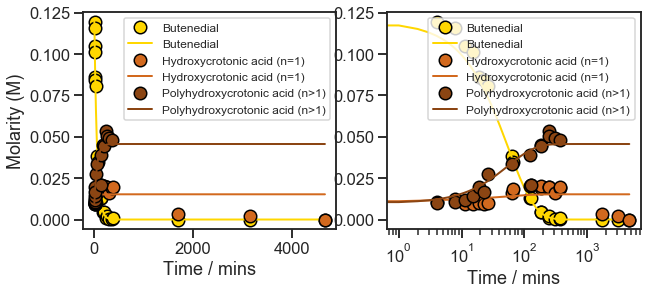

In [131]:
fig, ax = plt.subplots(1,2, figsize=(10,4))

ax[0].plot(df_processed.MINS_ELAPSED, df_processed.M_BUTENEDIAL, 
        '.', label='Butenedial',
        markersize=25, color='Gold', markeredgecolor='black', markeredgewidth=1.5)

ax[0].plot(df_modeled.MINS_ELAPSED, df_modeled.M_BUTENEDIAL, 
        label='Butenedial', lw=2, color='Gold')

ax[0].plot(df_processed.MINS_ELAPSED, df_processed.M_THCA_MONOMER, 
        '.', label='Hydroxycrotonic acid (n=1)',
        markersize=25, color='Chocolate', markeredgecolor='black', markeredgewidth=1.5)

ax[0].plot(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_MONOMER, 
        label='Hydroxycrotonic acid (n=1)', lw=2, color='Chocolate')

ax[0].plot(df_processed.MINS_ELAPSED, df_processed.M_THCA_NMER, 
        '.', label='Polyhydroxycrotonic acid (n>1)',
        markersize=25, color='SaddleBrown', markeredgecolor='black', markeredgewidth=1.5)

ax[0].plot(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_NMER, 
        label='Polyhydroxycrotonic acid (n>1)', lw=2, color='SaddleBrown')

ax[0].set_xlabel('Time / mins')
ax[0].set_ylabel('Molarity (M)')
ax[0].legend(fontsize='large')


ax[1].semilogx(df_processed.MINS_ELAPSED, df_processed.M_BUTENEDIAL, 
        '.', label='Butenedial',
        markersize=25, color='Gold', markeredgecolor='black', markeredgewidth=1.5)

ax[1].semilogx(df_modeled.MINS_ELAPSED, df_modeled.M_BUTENEDIAL, 
        label='Butenedial', lw=2, color='Gold')

ax[1].semilogx(df_processed.MINS_ELAPSED, df_processed.M_THCA_MONOMER, 
        '.', label='Hydroxycrotonic acid (n=1)',
        markersize=25, color='Chocolate', markeredgecolor='black', markeredgewidth=1.5)

ax[1].semilogx(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_MONOMER, 
        label='Hydroxycrotonic acid (n=1)', lw=2, color='Chocolate')

ax[1].semilogx(df_processed.MINS_ELAPSED, df_processed.M_THCA_NMER, 
        '.', label='Polyhydroxycrotonic acid (n>1)',
        markersize=25, color='SaddleBrown', markeredgecolor='black', markeredgewidth=1.5)

ax[1].semilogx(df_modeled.MINS_ELAPSED, df_modeled.M_THCA_NMER, 
        label='Polyhydroxycrotonic acid (n>1)', lw=2, color='SaddleBrown')

ax[1].set_xlabel('Time / mins')
ax[1].legend(fontsize='large');